# Start

In [509]:
import matplotlib.pyplot as plt

In [2]:
from itertools import combinations, permutations, product
from typing import Dict, Tuple, List, Any, NamedTuple, Callable
import jax
# If you want to perform simulations in float64 you have to call this before any JAX compuation
# jax.config.update('jax_enable_x64', True)

import jax
import jax.numpy as jnp
from jax import Array
import os

# os.environ["CHARMM_HOME"] = "/pchem-data/meuwly/boittier/home/charmm"
# os.environ["CHARMM_LIB_DIR"] = "/pchem-data/meuwly/boittier/home/charmm/build/cmake"
# # Set environment variables
# os.environ["XLA_PYTHON_CLIENT_MEM_FRACTION"] = ".99"
# os.environ["CUDA_VISIBLE_DEVICES"] = "1"

import jax
from jax import jit
import jax.numpy as jnp
import ase.calculators.calculator as ase_calc
# from jax import config
# config.update('jax_enable_x64', True)

# Check JAX configuration
devices = jax.local_devices()
print(devices)
print(jax.default_backend())
print(jax.devices())

import sys
import e3x
import jax
import numpy as np
import optax
import orbax
from pathlib import Path
import pandas as pd

# # Add custom path
sys.path.append("/home/boittier/github/JaxPychamm")
import physnetjax

# sys.path.append("/pchem-data/meuwly/boittier/home/dcm-lj-data")
# from pycharmm_lingo_scripts import script1, script2, script3, load_dcm
import physnetjax
# from physnetjax.data.data import prepare_datasets
# from physnetjax.training.loss import dipole_calc
from physnetjax.models.model import EF
# from physnetjax.training.training import train_model  # from model import dipole_calc
# from physnetjax.data.batches import (
#     _prepare_batches as prepare_batches,
# )  # prepare_batches, prepare_datasets

# orbax_checkpointer = orbax.checkpoint.PyTreeCheckpointer()

data_key, train_key = jax.random.split(jax.random.PRNGKey(42), 2)

from pathlib import Path

# from physnetjax.calc.helper_mlp import get_ase_calc


def parse_non_int(s):
    return "".join([_ for _ in s if _.isalpha()]).lower().capitalize()


read_parameter_card = """
read parameter card
* methanol
*
NONBONDED
CG321    0.0       {CG321EP:.4f}     {CG321RM:.4f}   0.0 -0.01 1.9 ! alkane (CT2), 4/98, yin, adm jr, also used by viv
CLGA1    0.0       {CLGA1EP:.4f}    {CLGA1RM:.4f} ! CLET, DCLE, chloroethane, 1,1-dichloroethane
HGA2     0.0       {HGA2EP:.4f}    {HGA2RM:.4f} ! alkane, yin and mackerell, 4/98
END
"""
# HGA2     0.0       -0.0200     1.3400 ! alkane, yin and mackerell, 4/98


NATOMS = 10

model = EF(
    # attributes
    features=128,
    max_degree=0,
    num_iterations=5,
    num_basis_functions=64,
    cutoff=10.0,
    max_atomic_number=18,
    charges=True,
    natoms=NATOMS,
    total_charge=0,
    n_res=3,
    zbl=False,
    debug=False,
)

from mmml.pycharmmInterface.import_pycharmm import *




import ase
from ase.io import read as read_ase
from ase import visualize
from ase.visualize import view


from scipy.optimize import minimize

ev2kcalmol = 1 / (ase.units.kcal / ase.units.mol)

CG321EP = -0.0560
CG321RM = 2.0100
CLGA1EP = -0.3430
CLGA1RM = 1.9100
HGA2EP =  -0.0200  
HGA2RM = 1.3400 

def set_pycharmm_xyz(atom_positions):
    xyz = pd.DataFrame(atom_positions, columns=["x", "y", "z"])
    coor.set_positions(xyz)


def capture_neighbour_list():
    # Print something
    distance_command = """
    open unit 1 write form name total.dmat
    
    COOR DMAT SINGLE UNIT 1 SELE ALL END SELE ALL END
    
    close unit 1"""
    _ = pycharmm.lingo.charmm_script(distance_command)

    with open("total.dmat") as f:
        output_dmat = f.read()

    atom_number_type_dict = {}
    atom_number_resid_dict = {}

    pair_distance_dict = {}
    pair_resid_dict = {}

    for _ in output_dmat.split("\n"):
        if _.startswith("*** "):
            _, n, resid, resname, at, _ = _.split()

            n = int(n.split("=")[0]) - 1
            atom_number_type_dict[n] = at
            atom_number_resid_dict[n] = int(resid) - 1

    for _ in output_dmat.split("\n"):
        if _.startswith("  "):
            a, b, dist = _.split()
            a = int(a) - 1
            b = int(b) - 1
            dist = float(dist)
            if atom_number_resid_dict[a] < atom_number_resid_dict[b]:
                pair_distance_dict[(a, b)] = dist
                pair_resid_dict[(a, b)] = (
                    atom_number_resid_dict[a],
                    atom_number_resid_dict[b],
                )

    return {
        "atom_number_type_dict": atom_number_type_dict,
        "atom_number_resid_dict": atom_number_resid_dict,
        "pair_distance_dict": pair_distance_dict,
        "pair_resid_dict": pair_resid_dict,
    }


def get_forces_pycharmm():
    positions = coor.get_positions()
    force_command = """coor force sele all end"""
    _ = pycharmm.lingo.charmm_script(force_command)
    forces = coor.get_positions()
    coor.set_positions(positions)
    return forces


def view_atoms(atoms):
    return view(atoms, viewer="x3d")


from itertools import combinations


def dimer_permutations(n_mol):
    dimer_permutations = list(combinations(range(n_mol), 2))
    return dimer_permutations


def calc_pycharmm_dimers(n_mol=20, n_atoms=5, forces=False):
    RANGE = len(dimer_permutations(n_mol))

    ele_energies = np.zeros(RANGE)
    evdw_energies = np.zeros(RANGE)
    mm_forces = np.zeros((RANGE, n_atoms * n_mol, 3))

    for i, (a, b) in enumerate(dimer_permutations(20)):
        reset_block_no_internal()
        a += 1
        b += 1
        block = f"""BLOCK
CALL 1 SELE .NOT. (RESID {a} .OR. RESID {b}) END
CALL 2 SELE (RESID {a} .OR. RESID {b}) END
COEFF 1 1 0.0
COEFF 2 2 1.0 BOND 0.0 ANGL 0.0 DIHEdral 0.0
COEFF 1 2 0.0
END
        """
        _ = pycharmm.lingo.charmm_script(block)
        # print(_)
        energy.show()
        if forces:
            f = get_forces_pycharmm().to_numpy()
            mm_forces[i] = f

        evdw = energy.get_vdw()
        evdw_energies[i] = evdw
        e = energy.get_elec()
        ele_energies[i] = e

    return {
        "ele_energies": ele_energies,
        "evdw_energies": evdw_energies,
        "mm_forces": mm_forces,
    }


def reset_block():
    block = f"""BLOCK 
        CALL 1 SELE ALL END
          COEFF 1 1 1.0 
        END
        """
    _ = pycharmm.lingo.charmm_script(block)


def reset_block_no_internal():
    block = f"""BLOCK 
        CALL 1 SELE ALL END
          COEFF 1 1 1.0 BOND 0.0 ANGL 0.0 DIHEdral 0.0 
        END
        """
    _ = pycharmm.lingo.charmm_script(block)


# reset_block_no_internal()


import MDAnalysis as mda


def load_pdb_data(pdb_file):
    # loaded_pdb = mda.coordinates.PDB.PDBReader(pdb_file)
    # loaded_pdb = mda.topology.PDBParser.PDBParser(pdb_file)
    
    atypes = psf.get_atype()
    atc = pycharmm.param.get_atc()
    residues = psf.get_res()
    psf.get_natom()
    # nl_info = capture_neighbour_list()

    # TODO: this assumes a pure system, need to update
    atoms_per_res = int(len(atypes) / len(residues))
    n_res = len(residues)
    resids = np.array([[i] * atoms_per_res for i in range(n_res)]).flatten()
    u = mda.Universe(pdb_file)
    atom_names = [s for s in list(u.atoms.names)]
    atom_positions = list(u.atoms.positions)
    atomic_numbers = np.array(
        [ase.data.atomic_numbers[parse_non_int(s)] for s in atom_names]
    )
    mda_resids = [s for s in list(u.atoms.resids)]
    mda_res_at_dict = {
        (a - 1, b): i for i, (a, b) in enumerate(zip(mda_resids, atom_names))
    }
    charmm_res_at_dict = {(a, b): i for i, (a, b) in enumerate(zip(resids, atypes))}
    an_charmm_res_at_dict = {v: k for k, v in charmm_res_at_dict.items()}
    an_mda_res_at_dict = {v: k for k, v in mda_res_at_dict.items()}
    atom_positions = np.array(atom_positions)
    reorder = np.array(
        [charmm_res_at_dict[an_mda_res_at_dict[i]] for i in range(len(atom_positions))]
    )
    atom_positions = atom_positions[reorder]
    atomic_numbers = atomic_numbers[reorder]

    return {
        "atom_names": atom_names,
        "atom_positions": atom_positions,
        "atomic_numbers": atomic_numbers,
        "mda_resids": mda_resids,
        "mda_res_at_dict": mda_res_at_dict,
        "charmm_res_at_dict": charmm_res_at_dict,
        "an_charmm_res_at_dict": an_charmm_res_at_dict,
        "an_mda_res_at_dict": an_mda_res_at_dict,
        "atom_positions": atom_positions,
        "reorder": reorder,
        "atom_positions": atom_positions,
        "atomic_numbers": atomic_numbers,
    }


def get_data_mda(fn):
    pdb_file = data_path / "dcmk" / fn
    pdb_data_mda = load_pdb_data(pdb_file)
    return pdb_data_mda


epsilon = 10 ** (-6)
from e3x.nn import smooth_switch, smooth_cutoff


def combine_with_sigmoid(
    r,
    mm_energy,
    ml_energy,
    dif=10 ** (-6),
    MM_CUTON=5.0,
    MM_CUTOFF=10.0,
    BUFFER=0.1,
    debug=False,
):
    ML_CUTOFF = MM_CUTON - dif
    charmm_on_scale = smooth_switch(r, x0=ML_CUTOFF, x1=MM_CUTON)
    charmm_off_scale = smooth_cutoff(r - MM_CUTON, cutoff=MM_CUTOFF - MM_CUTON)
    # remove any sigularities
    charmm_off_scale = jax.numpy.nan_to_num(charmm_off_scale, posinf=1)

    ml_scale = 1 - abs(smooth_switch(r, x0=ML_CUTOFF - BUFFER, x1=ML_CUTOFF))
    ml_contrib = ml_scale * ml_energy

    mm_contrib = charmm_on_scale * mm_energy
    mm_contrib = mm_contrib * charmm_off_scale

    return mm_contrib, ml_contrib, charmm_off_scale, charmm_on_scale, ml_scale


def indices_of_pairs(a, b, n_atoms=5, n_mol=20):
    assert a < b, "by convention, res a must have a smaller index than res b"
    assert a >= 1, "res indices can't start from 1"
    assert b >= 1, "res indices can't start from 1"
    assert a != b, "pairs can't contain same residue"
    return np.concatenate(
        [
            np.arange(0, n_atoms, 1) + (a - 1) * n_atoms,
            np.arange(0, n_atoms, 1) + (b - 1) * n_atoms,
        ]
    )


def indices_of_monomer(a, n_atoms=5, n_mol=20):
    assert a < (n_mol + 1), "monomer index outside total n molecules"
    return np.arange(0, n_atoms, 1) + (a - 1) * n_atoms


def calc_physnet_via_idx_list(all_coordinates, all_idxs, calculator):
    RANGE = len(all_idxs)
    ml_energies = np.zeros(RANGE)
    ml_forces = np.zeros((RANGE, len(all_idxs[0]), 3))

    for i, idxs in enumerate(all_idxs):
        # set positions
        calculator.set_positions(all_coordinates[idxs])

        ml_energies[i] = calculator.get_potential_energy()
        ml_forces[i] = calculator.get_forces()

    return {"ml_energies": ml_energies, "ml_forces": ml_forces}


def get_dimer_distances(dimer_idxs, all_monomer_idxs, R):
    out_dists = np.zeros(len(dimer_idxs))
    for i, (a, b) in enumerate(dimer_idxs):
        a = all_monomer_idxs[a][0]  # just distance to first atom in the molecule...
        b = all_monomer_idxs[b][0]  # TODO: generalize...
        out_dists[i] = np.linalg.norm(R[a] - R[b])

    return out_dists


def setup_ase_atoms(atomic_numbers, positions, n_atoms):
    """Create and setup ASE Atoms object with centered positions"""
    Z = [_ for i, _ in enumerate(atomic_numbers) if i < n_atoms]
    R = np.array([_ for i, _ in enumerate(positions) if i < n_atoms])
    atoms = ase.Atoms(Z, R)
    # translate to center of mass
    # atoms.set_positions(R - R.T.mean(axis=1))
    return atoms


def create_physnet_calculator(params, model, atoms, ev2kcalmol):
    """Create PhysNet calculator with specified parameters"""
    calc = get_ase_calc(
        params,
        model,
        atoms,
        conversion={"energy": ev2kcalmol, "dipole": 1, "forces": ev2kcalmol},
    )
    atoms.calc = calc
    return atoms


def initialize_models(restart_path, N_ATOMS_MONOMER):
    """Initialize monomer and dimer models from restart"""
    restart = get_last(restart_path)

    # Setup monomer model
    params, monomer_model = get_params_model(restart)
    monomer_model.natoms = N_ATOMS_MONOMER

    # Setup dimer model
    params, dimer_model = get_params_model(restart)
    dimer_model.natoms = N_ATOMS_MONOMER * 2

    return params, monomer_model, dimer_model


def get_rmse_mae(energy, ref_energy):
    rmse = np.sqrt(np.mean((energy - ref_energy) ** 2))
    mae = np.mean(np.abs(energy - ref_energy))
    return rmse, mae


def print_energy_comparison(mmml_energy, charmm, ref_energy):
    """Print comparison of energies with reference data"""

    print("comb")
    print(mmml_energy, ref_energy, abs(mmml_energy - ref_energy))

    print("charmm")
    print(charmm, ref_energy, abs(charmm - ref_energy))


def calculate_E_pair(dimer_results, monomer_results, dimer_idxs, result):
    """Calculate and combine ML and MM energies"""
    summed_ml_intE = dimer_results["ml_energies"] - monomer_results["ml_energies"][
        np.array(dimer_idxs)
    ].sum(axis=1)
    summed_mm_intE = result["ele_energies"] + result["evdw_energies"]
    return summed_ml_intE, summed_mm_intE

def calculate_F_pair(dimer_results, monomer_results, dimer_idxs, result):
    """Calculate and combine ML and MM forces"""
    mono = monomer_results["ml_forces"][
        np.array(dimer_idxs)
    ]
    print(mono.shape)
    a,b,c,d = mono.shape
    mono = mono.reshape(a, b*c, d)
    summed_ml_intF = dimer_results["ml_forces"] - mono
    summed_mm_intF = result["mm_forces"]
    return summed_ml_intF, summed_mm_intF

def get_fnkey(fn):
    fnkey = str(fn).split("/")[-1].split(".")[0].upper()
    fnkey = "_".join(fnkey.split("_")[:3])
    return fnkey

def calc_energies_forces(
    fn, DO_ML=True, DO_MM=True, MM_CUTON=6.0, MM_CUTOFF=10.0, BUFFER=0.1
):
    pdb_data_mda = get_data_mda(fn)
    atomic_numbers, atom_positions = (
        pdb_data_mda["atomic_numbers"],
        pdb_data_mda["atom_positions"],
    )
    set_pycharmm_xyz(atom_positions)
    energy.show()

    ase_atom_full_system = ase.Atoms(atomic_numbers, atom_positions)
    
    result = None
    summed_2body = None
    mmml_energy = None
    charmm = None

    if DO_MM:
        # Calculate CHARMM energies and forces first
        result = calc_pycharmm_dimers(forces=True)
        summed_2body = result["mm_forces"].sum(axis=0)
        mm_forces = result["mm_forces"]

    all_coordinates = ase_atom_full_system.get_positions()
    dimer_idxs = dimer_permutations(20)

    dimer_pair_c_c_distances = get_dimer_distances(
        dimer_idxs, all_monomer_idxs, all_coordinates
    )

    if DO_ML:
        dimer_results = calc_physnet_via_idx_list(
            all_coordinates, all_dimer_idxs, ase_atoms_dimer
        )

        monomer_results = calc_physnet_via_idx_list(
            all_coordinates, all_monomer_idxs, ase_atoms_monomer
        )

        # Calculate ML and MM energies
        summed_ml_intE, summed_mm_intE = calculate_E_pair(
            dimer_results, monomer_results, dimer_idxs, result
        )

        summed_ml_intF, summed_mm_intF = calculate_F_pair(
            dimer_results, monomer_results, dimer_idxs, result
        )

    if DO_MM and DO_ML:
        combined_with_switches = combine_with_sigmoid(
            dimer_pair_c_c_distances,
            summed_mm_intE,
            summed_ml_intE,
            MM_CUTON=MM_CUTON,
            MM_CUTOFF=MM_CUTOFF,
            BUFFER=BUFFER,
        )
        (
            mm_contrib,
            ml_contrib,
            charmm_off_scale,
            charmm_on_scale,
            ml_scale,
        ) = combined_with_switches

        mmml_energy = float(ml_contrib.sum() + mm_contrib.sum())
        charmm = float(summed_mm_intE.sum())
    else:
        mmml_energy = float(summed_ml_intE.sum())
        charmm = float(summed_mm_intE.sum())

    print(summed_ml_intE.shape, summed_mm_intE.shape)

    mm_forces = summed_mm_intF
    ml_forces = summed_ml_intF


    indices = np.array(all_dimer_idxs).flatten()[:, None].repeat(3, axis=1) + np.array([0, mm_forces.shape[1],  2*mm_forces.shape[1]])
    flattened_ml_dimers = ml_forces.reshape(-1, 3).flatten()
    # indices = np.repeat(np.array(all_dimer_idxs).flatten(), 3)
    mmml_forces = jax.ops.segment_sum(flattened_ml_dimers, indices.flatten()).reshape(mm_forces.shape[1], 3)
    
    # mmml_forces = (mm_forces, ml_forces)


    output_dict = {
        "mmml_energy": mmml_energy,
        "charmm": charmm,
        "mm_forces": mm_forces,
        "ml_forces": ml_forces,
        "mmml_forces": mmml_forces,
    }

    return output_dict

def compare_energies(
    fn,  df, DO_ML=True, DO_MM=True, MM_CUTON=6.0, MM_CUTOFF=10.0, BUFFER=0.1
):
    energy_forces_dict = calc_energies_forces(fn, DO_ML=DO_ML, DO_MM=DO_MM, MM_CUTON=MM_CUTON, MM_CUTOFF=MM_CUTOFF, BUFFER=BUFFER)
    mmml_energy = energy_forces_dict["mmml_energy"]
    charmm = energy_forces_dict["charmm"]
    mm_forces = energy_forces_dict["mm_forces"]
    ml_forces = energy_forces_dict["ml_forces"]
    mmml_forces = energy_forces_dict["mmml_forces"]

    # print(fn)
    fnkey = get_fnkey(fn)
    # print(fnkey)
    # print(df)
    if fnkey in df["key"].values:
        df = df[df["key"] == fnkey]
        # print(df)
        ref_energy = df.iloc[0]["Formation Energy (kcal/mol)"]
        if DO_MM:
            err_mmml = mmml_energy - ref_energy
            err_charmm = charmm - ref_energy
        else:
            err_mmml = mmml_energy - ref_energy
            err_charmm = None
    else:
        ref_energy = None
        err_mmml = None
        err_charmm = None

    results_dict = {
        "ref_energy": ref_energy,
        "mmml_energy": mmml_energy,
        "charmm": charmm,
        "err_mmml": err_mmml,
        "err_charmm": err_charmm,
        "mm_forces": mm_forces,
        "ml_forces": ml_forces,
        "mmml_forces": mmml_forces,
    }
    return results_dict


def set_param_card(CG321EP=CG321EP, CG321RM=CG321RM, CLGA1EP=CLGA1EP, CLGA1RM=CLGA1RM, HGA2EP=HGA2EP, HGA2RM=HGA2RM):
    cmd = "PRNLev 5\nWRNLev 5"
    param_card = read_parameter_card.format(
        CG321EP=CG321EP, CG321RM=CG321RM, CLGA1EP=CLGA1EP, CLGA1RM=CLGA1RM, HGA2EP=HGA2EP, HGA2RM=HGA2RM
    )
    print(param_card)
    pycharmm.lingo.charmm_script(param_card)
    cmd = "PRNLev 0\nWRNLev 0"
    pycharmm.lingo.charmm_script(cmd)


def get_loss_terms(fns, MM_CUTON=6.0, MM_CUTOFF=10.0, BUFFER=0.01, MM_lambda=1.0, ML_lambda=0.0, DO_MM=True, DO_ML=True):
    import time

    start = time.time()
    err_mmml_list = []
    err_charmm_list = []
    for fn in fns:
        results_dict = compare_energies(fn, df, DO_MM=DO_MM, DO_ML=DO_ML, MM_CUTON=MM_CUTON, MM_CUTOFF=MM_CUTOFF, BUFFER=BUFFER)
        err_mmml_list.append(results_dict["err_mmml"])
        err_charmm_list.append(results_dict["err_charmm"])
        print(
            "{} {:.1f} {:.1f} {:.1f} {:.1f} {:.1f}".format(
                fn.stem,
                results_dict["ref_energy"],
                results_dict["mmml_energy"],
                results_dict["charmm"],
                results_dict["err_mmml"],
                results_dict["err_charmm"],
            )
        )

    end = time.time()
    print("Finished")
    print("Time taken", end - start)
    print("--------------------------------")
    err_mmml_list = np.array(err_mmml_list)
    err_charmm_list = np.array(err_charmm_list)

    print("RMSE MMML", np.sqrt(np.mean(err_mmml_list**2)))
    print("MAE MMML", np.mean(np.abs(err_mmml_list)))
    print("RMSE Charmm", np.sqrt(np.mean(err_charmm_list**2)))
    print("MAE Charmm", np.mean(np.abs(err_charmm_list)))

    loss = MM_lambda * np.mean(err_mmml_list**2) + ML_lambda * np.mean(err_charmm_list**2)
    return loss, err_mmml_list, err_charmm_list

def get_loss_fn(train_filenames, DO_ML=True, DO_MM=True, NTRAIN=20, MM_CUTON=6.0, MM_lambda=1.0, ML_lambda=0.0):
    def loss_fn(x0):
        print("Starting")
        # random_indices = np.random.randint(0, len(train_filenames),6)
        fns = [train_filenames[i] for i in range(NTRAIN)]
        CG321EP, CG321RM, CLGA1EP, CLGA1RM = x0[:4]
        set_param_card(CG321EP, CG321RM, CLGA1EP, CLGA1RM)
        loss, _, _ = get_loss_terms(fns, MM_CUTON=MM_CUTON, MM_lambda=MM_lambda, ML_lambda=ML_lambda, DO_MM=DO_MM, DO_ML=DO_ML)
        print("Loss", loss)
        return loss
    return loss_fn


def ep_scale_loss(x0):
    print("Starting")
    random_indices = np.random.randint(0, len(train_filenames), 4)
    fns = [train_filenames[i] for i in random_indices]
    ep_scale = float(x0)
    set_param_card(CG321EP * ep_scale, CG321RM, CLGA1EP * ep_scale, CLGA1RM)
    loss, _, _ = get_loss_terms(fns)
    print("Loss", loss)
    return loss

def create_initial_simplex(x0, delta=0.0001):
    initial_simplex = np.zeros((len(x0) + 1, len(x0)))
    initial_simplex[0] = x0  # First point is x0
    for i in range(len(x0)):
        initial_simplex[i + 1] = x0.copy()
        initial_simplex[i + 1, i] += delta  # Add small step in dimension i
    return initial_simplex


def optimize_params_simplex(x0, bounds, 
loss, method="Nelder-Mead", maxiter=100, xatol=0.0001, fatol=0.0001):
    initial_simplex = create_initial_simplex(x0)
    res = minimize(
        loss,
        x0=x0,
        method="Nelder-Mead",
        bounds=bounds,
        options={
            "xatol": 0.0001,  # Absolute tolerance on x
            "fatol": 0.0001,  # Absolute tolerance on function value
            "initial_simplex": initial_simplex,
            "maxiter": 100,
        },
    )  # Initial simplex with steps of 0.0001

    print(res)
    return res
    
def get_bounds(x0, scale=0.1):
    b= [(x0[i] * (1-scale), x0[i] * (1+scale)) if x0[i] > 0 else (x0[i] * (1+scale), x0[i] * (1-scale)) 
    for i in range(len(x0)) ]
    return b

from physnetjax.restart.restart import get_last, get_files, get_params_model
from physnetjax.analysis.analysis import plot_stats

def get_block(a,b):
    block = f"""BLOCK
CALL 1 SELE .NOT. (RESID {a} .OR. RESID {b}) END
CALL 2 SELE (RESID {a} .OR. RESID {b}) END
COEFF 1 1 0.0
COEFF 2 2 1.0 BOND 0.0 ANGL 0.0 DIHEdral 0.0
COEFF 1 2 0.0
END
"""
    return block


[CudaDevice(id=0), CudaDevice(id=1)]
gpu
[CudaDevice(id=0), CudaDevice(id=1)]
/home/boittier/mmml/mmml/data/top_all36_cgenff.rtf
/home/boittier/mmml/mmml/data/par_all36_cgenff.prm
CHARMM_HOME /home/boittier/mmml/setup/charmm
CHARMM_LIB_DIR /home/boittier/mmml/setup/charmm


In [3]:
# dir(physnetjax)

In [4]:
reset_block()

  
 CHARMM>     BLOCK
 WARNING from DECODI -- Zero length string being converted to 0
 Block structure initialized with   3 blocks.
 All atoms have been assigned to block 1.
 All interaction coefficients have been set to unity.
  Setting number of block exclusions nblock_excldPairs=0
  
  BLOCK>            CALL 1 SELE ALL END
 SELRPN>      0 atoms have been selected out of      0
 The selected atoms have been reassigned to block   1
  
  BLOCK>              COEFF 1 1 1.0
  
  BLOCK>            END
 Matrix of Interaction Coefficients
 
    1.00000
    1.00000   1.00000
    1.00000   1.00000   1.00000
 Matrix of BOND Interaction Coefficients
 
    1.00000
    1.00000   1.00000
    1.00000   1.00000   1.00000
 Matrix of ANGLE Interaction Coefficients
 
    1.00000
    1.00000   1.00000
    1.00000   1.00000   1.00000
 Matrix of DIHE Interaction Coefficients
 
    1.00000
    1.00000   1.00000
    1.00000   1.00000   1.00000
 Matrix of CROSS Interaction Coefficients
 
    1.00000
    1.000

# ...

In [5]:
# R = coor.get_positions().to_numpy()

# # System constants
# ATOMS_PER_MONOMER: int = 5  # Number of atoms in each monomer
# MAX_ATOMS_PER_SYSTEM: int = 10  # Maximum atoms in monomer/dimer system
# SPATIAL_DIMS: int = 3  # Number of spatial dimensions (x, y, z)



# def get_MM_energy_forces_fns(R, ATOMS_PER_MONOMER=5, N_MONOMERS=2):
#     """Creates functions for calculating MM energies and forces with switching.
    
#     Returns:
#         Tuple[Callable, Callable]: Functions for energy and force calculations
#     """
#     # CG321EP = -0.0560
#     # CG321RM = 2.0100
#     # CLGA1EP = -0.3430
#     # CLGA1RM = 1.9100
#     # HGA2EP =  -0.0200  
#     # HGA2RM = 1.3400 
#     # params =  [75, 76, 77]
#     # params.sort()
#     # at_ep = {75: CG321EP, 76:CLGA1EP , 77: HGA2EP}
#     # at_rm = {75: CG321RM, 76: CLGA1RM , 77: HGA2RM}
#     # at_q = {75: -0.018, 76: -0.081 , 77: 0.09}
#     # at_flat_rm = np.zeros(100)
#     # at_flat_rm[75] = CG321RM
#     # at_flat_rm[76] = CLGA1RM
#     # at_flat_rm[77] = HGA2RM
#     # at_flat_ep = np.zeros(100)
#     # at_flat_ep[75] = CG321EP
#     # at_flat_ep[76] = CLGA1EP
#     # at_flat_ep[77] = HGA2EP
#     # at_flat_q = np.zeros(100)
#     # at_flat_q[75] =  -0.018
#     # at_flat_q[76] =  -0.081
#     # at_flat_q[77] =  0.09

#     ############################################################################################


#     read.rtf('/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf')
#     bl =settings.set_bomb_level(-2)
#     wl =settings.set_warn_level(-2)
#     read.prm('/pchem-data/meuwly/boittier/home/charmm/toppar/par_all36_cgenff.prm')

#     # pycharmm.lingo.charmm_script(script1)
    
#     settings.set_bomb_level(bl)
#     settings.set_warn_level(wl)
#     pycharmm.lingo.charmm_script('bomlev 0')
    
#     cgenff_params = open("/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf").readlines()

#     atc = pycharmm.param.get_atc()

    
#     cgenff_params_dict_q = {}
#     atom_name_to_param = {k: [] for k in atc}
    
#     for _ in cgenff_params:
#         if _.startswith("ATOM"):
#             _, atomname, at, q = _.split()[:4]
#             try:
#                 cgenff_params_dict_q[at] = float(q)
#             except:
#                 cgenff_params_dict_q[at] = float(q.split("!")[0])
#             atom_name_to_param[atomname] = at
    
#     cgenff_params = open("/pchem-data/meuwly/boittier/home/charmm/toppar/par_all36_cgenff.prm").readlines()
#     cgenff_params_dict = {}
    
#     for _ in cgenff_params:
#         if len(_) > 5 and len(_.split()) > 4 and _.split()[1] == "0.0":
#             res, _, ep, sig = _.split()[:4]
#             if res in atc:
#                 cgenff_params_dict[res] = (float(ep), float(sig))

#     for i, _ in enumerate(atc):
#         print(i, _)

#     params = list(range(len(atc)))
#     print(params)
    
#     atc_epsilons = [cgenff_params_dict[_][0] if _ in cgenff_params_dict.keys() else 0.0 for _ in atc ]
#     atc_rmins = [cgenff_params_dict[_][1] if _ in cgenff_params_dict.keys() else 0.0 for _ in atc ]
#     atc_qs = [cgenff_params_dict_q[_] if _ in cgenff_params_dict_q.keys() else 0.0 for _ in atc  ]
#     at_ep = -1 * abs( np.array(atc_epsilons))
#     at_rm = np.array(atc_rmins)
#     at_q = np.array(atc_qs)

#     print(at_ep[::10], np.array(at_ep).shape)
#     print(at_rm[::10], np.array(at_rm).shape)
#     print(at_q[::10], np.array(at_q).shape)
#     # at_ep = {_: cgenff_params_dict[_][0] for _ in atc if _ in cgenff_params_dict.keys()]
#     # atc_rmins = [cgenff_params_dict[_][1] for _ in atc if _ in cgenff_params_dict.keys()]
#     # atc_qs = [cgenff_params_dict_q[_] for _ in atc if _ in cgenff_params_dict_q.keys()]
#     ############################################################################################

#     at_flat_q = np.array(atc_qs)
#     at_flat_ep =  np.array(atc_epsilons)
#     at_flat_rm =  np.array(atc_rmins)
    
#     pair_idxs_product = jnp.array([(a,b) for a,b in list(product(np.arange(ATOMS_PER_MONOMER), repeat=2))])
#     dimer_perms = jnp.array(dimer_permutations(N_MONOMERS))
    
#     pair_idxs_np = dimer_perms * ATOMS_PER_MONOMER
#     pair_idx_atom_atom = pair_idxs_np[:, None, :] + pair_idxs_product[None,...]
#     pair_idx_atom_atom = pair_idx_atom_atom.reshape(-1, 2)
    
#     displacements = R[pair_idx_atom_atom[:,0]] - R[pair_idx_atom_atom[:,1]]
#     distances = jnp.linalg.norm(displacements, axis=1)
#     at_perms = [_ for _ in list(product(params, repeat=2)) if _[0] <= _[1]]
#     print("at_perms", at_perms)
#     charges = np.array(psf.get_charges())[:N_MONOMERS*ATOMS_PER_MONOMER]
#     masses = np.array(psf.get_amass())[:N_MONOMERS*ATOMS_PER_MONOMER]
#     at_codes = np.array(psf.get_iac())[:N_MONOMERS*ATOMS_PER_MONOMER]
#     atomtype_codes = np.array(psf.get_atype())[:N_MONOMERS*ATOMS_PER_MONOMER]

#     print("at_codes", at_codes)
#     print(list(set(at_codes)))
#     print([len(_) for _ in [at_ep, at_rm, at_q] ])
#     print(at_ep[list(set(at_codes))])
#     print(at_rm[list(set(at_codes))])
#     print(at_q[list(set(at_codes))])
    
#     at_perms_ep = [ (at_ep[a] * at_ep[b])**0.5 for a,b in at_perms]
#     at_perms_rm = [ (at_rm[a] + at_rm[b]) for a,b in at_perms]
#     at_perms_qq = [ (at_q[a] * at_q[b]) for a,b in at_perms]

#     rmins_per_system = jnp.take(at_flat_rm, at_codes) #jnp.array([ NBL["pair_rm"][k] for k in atom_keys ])
#     epsilons_per_system = jnp.take(at_flat_ep, at_codes) #jnp.array([ NBL["pair_ep"][k] for k in atom_keys ])

#     rs = distances
#     q_per_system = jnp.take(at_flat_q, at_codes)


#     q_a = jnp.take(q_per_system, pair_idx_atom_atom[:, 0])
#     q_b = jnp.take(q_per_system, pair_idx_atom_atom[:, 1])
    
#     rm_a = jnp.take(rmins_per_system, pair_idx_atom_atom[:, 0])
#     rm_b = jnp.take(rmins_per_system, pair_idx_atom_atom[:, 1])
    
#     ep_a = jnp.take(epsilons_per_system, pair_idx_atom_atom[:, 0])
#     ep_b = jnp.take(epsilons_per_system, pair_idx_atom_atom[:, 1])

#     pair_qq = q_a * q_b
#     pair_rm = (rm_a + rm_b)
#     pair_ep = (ep_a * ep_b)**0.5

#     print("q", pair_qq)
#     print("rm", pair_rm)
#     print("ep", pair_ep)

    
#     def lennard_jones(r, sig, ep):
#         """
#         rmin = 2^(1/6) * sigma
#             https://de.wikipedia.org/wiki/Lennard-Jones-Potential
#         Lennard-Jones potential for a pair of atoms
#         """
#         a = 6
#         b = 2
#         # sig = sig / (2 ** (1 / 6))
#         r6 = (sig / r) ** a
#         return ep * (r6 ** b - 2 * r6)
    
#     coulombs_constant = 3.32063711e2 #Coulomb's constant kappa = 1/(4*pi*e0) in kcal-Angstroms/e^2.
#     def coulomb(r, qq, constant = coulombs_constant):
#         return constant * qq/r
    

    
#     @jax.jit
#     def apply_switching_function(
#         positions: Array,  # Shape: (n_atoms, 3)
#         pair_energies: Array,  # Shape: (n_pairs,)
#         ml_cutoff_distance: float = 2.0,
#         mm_switch_on: float = 5.0,
#         mm_cutoff: float = 1.0,
#         buffer_distance: float = 0.001,
#     ) -> Array:
#         """Applies smooth switching function to MM energies based on distances.
        
#         Args:
#             positions: Atomic positions
#             pair_energies: Per-pair MM energies to be scaled
#             ml_cutoff_distance: Distance where ML potential is cut off
#             mm_switch_on: Distance where MM potential starts switching on
#             mm_cutoff: Final cutoff for MM potential
#             buffer_distance: Small buffer to avoid discontinuities
            
#         Returns:
#             Array: Scaled MM energies after applying switching function
#         """
#         # Calculate pairwise distances
#         pair_positions = positions[pair_idx_atom_atom[:,0]] - positions[pair_idx_atom_atom[:,1]]
#         distances = jnp.linalg.norm(pair_positions, axis=1)
        
#         # Calculate switching functions
#         ml_cutoff = mm_switch_on - ml_cutoff_distance
#         switch_on = smooth_switch(distances, x0=ml_cutoff, x1=mm_switch_on)
#         switch_off = 1 - smooth_switch(distances - mm_cutoff - mm_switch_on, 
#                                      x0=ml_cutoff, 
#                                      x1=mm_switch_on)
#         cutoff = 1 - smooth_cutoff(distances, cutoff=2)
        
#         # Combine switching functions and apply to energies
#         switching_factor = switch_on * switch_off * cutoff
#         scaled_energies = pair_energies * switching_factor
        
#         return scaled_energies.sum()

#     @jax.jit
#     def calculate_mm_energy(positions: Array) -> Array:
#         """Calculates MM energies including both VDW and electrostatic terms.
        
#         Args:
#             positions: Atomic positions (Shape: (n_atoms, 3))
            
#         Returns:
#             Array: Total MM energy
#         """
#         # Calculate pairwise distances
#         displacements = positions[pair_idx_atom_atom[:,0]] - positions[pair_idx_atom_atom[:,1]]
#         distances = jnp.linalg.norm(displacements, axis=1)
        
#         # Only include interactions between unique pairs
#         pair_mask = (pair_idx_atom_atom[:, 0] < pair_idx_atom_atom[:, 1])

#         # Calculate VDW (Lennard-Jones) energies
#         vdw_energies = lennard_jones(distances, pair_rm, pair_ep) * pair_mask
#         vdw_total = vdw_energies.sum()
        
#         # Calculate electrostatic energies
#         electrostatic_energies = coulomb(distances, pair_qq) * pair_mask    
#         electrostatic_total = electrostatic_energies.sum()
              
#         return vdw_total + electrostatic_total

#     @jax.jit
#     def calculate_mm_pair_energies(positions: Array) -> Array:
#         """Calculates per-pair MM energies for switching calculations.
        
#         Args:
#             positions: Atomic positions (Shape: (n_atoms, 3))
            
#         Returns:
#             Array: Per-pair energies (Shape: (n_pairs,))
#         """
#         displacements = positions[pair_idx_atom_atom[:,0]] - positions[pair_idx_atom_atom[:,1]]
#         distances = jnp.linalg.norm(displacements, axis=1)
#         pair_mask = (pair_idx_atom_atom[:, 0] < pair_idx_atom_atom[:, 1])
        
#         vdw_energies = lennard_jones(distances, pair_rm, pair_ep) * pair_mask
#         electrostatic_energies = coulomb(distances, pair_qq) * pair_mask    
              
#         return vdw_energies + electrostatic_energies
    
#     # Calculate gradients
#     mm_energy_grad = jax.grad(calculate_mm_energy)
#     switching_grad = jax.grad(apply_switching_function)

#     @jax.jit 
#     def calculate_mm_energy_and_forces(
#         positions: Array,  # Shape: (n_atoms, 3)
#     ) -> Tuple[Array, Array]:
#         """Calculates MM energy and forces with switching.
        
#         Args:
#             positions: Atomic positions
            
#         Returns:
#             Tuple[Array, Array]: (Total energy, Forces per atom)
#         """
#         # Calculate base MM energies
#         # mm_energy = calculate_mm_energy(positions)
#         pair_energies = calculate_mm_pair_energies(positions)
#         # Apply switching function
#         switched_energy = apply_switching_function(positions, pair_energies)
        
#         # Calculate forces with switching
#         mm_forces = mm_energy_grad(positions)
#         switching_forces = switching_grad(positions, pair_energies)
#         total_forces = mm_forces * switching_forces

#         return switched_energy, total_forces

#     return calculate_mm_energy_and_forces


# def prepare_batches_md(
#     data,
#     batch_size: int,
#     data_keys = None,
#     num_atoms: int = 60,
#     dst_idx = None,
#     src_idx= None,
#     include_id: bool = False,
#     debug_mode: bool = False,
# ) :
#     """
#     Efficiently prepare batches for training.

#     Args:
#         key: JAX random key for shuffling.
#         data (dict): Dictionary containing the dataset.
#             Expected keys: 'R', 'N', 'Z', 'F', 'E', and optionally others.
#         batch_size (int): Size of each batch.
#         data_keys (list, optional): List of keys to include in the output.
#             If None, all keys in `data` are included.
#         num_atoms (int, optional): Number of atoms per example. Default is 60.
#         dst_idx (jax.numpy.ndarray, optional): Precomputed destination indices for atom pairs.
#         src_idx (jax.numpy.ndarray, optional): Precomputed source indices for atom pairs.
#         include_id (bool, optional): Whether to include 'id' key if present in data.
#         debug_mode (bool, optional): If True, run assertions and extra checks.

#     Returns:
#         list: A list of dictionaries, each representing a batch.
#     """

#     # -------------------------------------------------------------------------
#     # Validation and Setup
#     # -------------------------------------------------------------------------

#     # Check for mandatory keys
#     required_keys = ["R", "N", "Z"]
#     for req_key in required_keys:
#         if req_key not in data:
#             raise ValueError(f"Data dictionary must contain '{req_key}' key.")

#     # Default to all keys in data if none provided
#     if data_keys is None:
#         data_keys = list(data.keys())

#     # Verify data sizes
#     data_size = len(data["R"])
#     steps_per_epoch = data_size // batch_size
#     if steps_per_epoch == 0:
#         raise ValueError(
#             "Batch size is larger than the dataset size or no full batch available."
#         )

#     # -------------------------------------------------------------------------
#     # Compute Random Permutation for Batches
#     # -------------------------------------------------------------------------
#     # perms = jax.random.permutation(key, data_size)
#     perms = jnp.arange(0, data_size)
#     perms = perms[: steps_per_epoch * batch_size]
#     perms = perms.reshape((steps_per_epoch, batch_size))

#     # -------------------------------------------------------------------------
#     # Precompute Batch Segments and Indices
#     # -------------------------------------------------------------------------
#     batch_segments = jnp.repeat(jnp.arange(batch_size), num_atoms)
#     offsets = jnp.arange(batch_size) * num_atoms

#     # Compute pairwise indices only if not provided
#     # E3x: e3x.ops.sparse_pairwise_indices(num_atoms) -> returns (dst_idx, src_idx)
#     if dst_idx is None or src_idx is None:
#         dst_idx, src_idx = e3x.ops.sparse_pairwise_indices(num_atoms)

#     # Adjust indices for batching
#     dst_idx = dst_idx + offsets[:, None]
#     src_idx = src_idx + offsets[:, None]

#     # Centralize reshape logic
#     # For keys not listed here, we default to their original shape after indexing.
#     reshape_rules = {
#         "R": (batch_size * num_atoms, 3),
#         "F": (batch_size * num_atoms, 3),
#         "E": (batch_size, 1),
#         "Z": (batch_size * num_atoms,),
#         "D": (batch_size,3),
#         "N": (batch_size,),
#         "mono": (batch_size * num_atoms,),
#     }

#     output = []

#     # -------------------------------------------------------------------------
#     # Batch Preparation Loop
#     # -------------------------------------------------------------------------
#     for perm in perms:
#         # Build the batch dictionary
#         batch = {}
#         for k in data_keys:
#             if k not in data:
#                 continue
#             v = data[k][jnp.array(perm)]
#             new_shape = reshape_rules.get(k, None)
#             if new_shape is not None:
#                 batch[k] = v.reshape(new_shape)
#             else:
#                 batch[k] = v

#         # Optionally include 'id' if requested and present
#         if include_id and "id" in data and "id" in data_keys:
#             batch["id"] = data["id"][jnp.array(perm)]

#         # Compute good_indices (mask for valid atom pairs)
#         # Vectorized approach: We know N is shape (batch_size,)
#         # Expand N to compare with dst_idx/src_idx
#         # dst_idx[i], src_idx[i] range over atom pairs within the ith example
#         # Condition: (dst_idx[i] < N[i]+i*num_atoms) & (src_idx[i] < N[i]+i*num_atoms)
#         # We'll compute this for all i and concatenate.
#         N = batch["N"]
#         # Expand N and offsets for comparison
#         expanded_n = N[:, None] + offsets[:, None]
#         valid_dst = dst_idx < expanded_n
#         valid_src = src_idx < expanded_n
#         good_pairs = (valid_dst & valid_src).astype(jnp.int32)
#         good_indices = good_pairs.reshape(-1)

#         # Add metadata to the batch
#         atom_mask = jnp.where(batch["Z"] > 0, 1, 0)
#         batch.update(
#             {
#                 "dst_idx": dst_idx.flatten(),
#                 "src_idx": src_idx.flatten(),
#                 "batch_mask": good_indices,
#                 "batch_segments": batch_segments,
#                 "atom_mask": atom_mask,
#             }
#         )

#         # Debug checks
#         if debug_mode:
#             # Check expected shapes
#             assert batch["R"].shape == (
#                 batch_size * num_atoms,
#                 3,
#             ), f"R shape mismatch: {batch['R'].shape}"
#             assert batch["F"].shape == (
#                 batch_size * num_atoms,
#                 3,
#             ), f"F shape mismatch: {batch['F'].shape}"
#             assert batch["E"].shape == (
#                 batch_size,
#                 1,
#             ), f"E shape mismatch: {batch['E'].shape}"
#             assert batch["Z"].shape == (
#                 batch_size * num_atoms,
#             ), f"Z shape mismatch: {batch['Z'].shape}"
#             assert batch["N"].shape == (
#                 batch_size,
#             ), f"N shape mismatch: {batch['N'].shape}"
#             # Optional: print or log if needed

#         output.append(batch)

#     return output



# # switch_MM_grad = jax.grad(switch_MM)


# class ModelOutput(NamedTuple):
#     energy: Array  # Shape: (,), total energy in kcal/mol
#     forces: Array  # Shape: (n_atoms, 3), forces in kcal/mol/Å
#     dH: Array # Shape: (,), total interaction energy in kcal/mol
#     internal_E: Array # Shape: (,) total internal energy in kcal/mol
#     internal_F: Array
#     mm_E: Array
#     mm_F: Array
#     ml_2b_E: Array
#     ml_2b_F: Array

# def get_spherical_cutoff_calculator(
#     atomic_numbers: Array,  # Shape: (n_atoms,)
#     atomic_positions: Array,  # Shape: (n_atoms, 3)
#     n_monomers: int,
#     restart_path: str = "/path/to/default",
#     doML: bool = True,
#     doMM: bool = True,
#     doML_dimer: bool = True,
#     backprop: bool = False,
#     debug: bool = False


# ) -> Any:  # Returns ASE calculator
#     """Creates a calculator that combines ML and MM potentials with spherical cutoffs.
    
#     This calculator handles:
#     1. ML predictions for close-range interactions
#     2. MM calculations for long-range interactions
#     3. Smooth switching between the two regimes
    
#     Args:
#         atomic_numbers: Array of atomic numbers for each atom
#         atomic_positions: Initial positions of atoms in Angstroms
#         restart_path: Path to model checkpoint for ML component
        
#     Returns:
#         ASE-compatible calculator that computes energies and forces
#     """

#     all_dimer_idxs = []
#     for a, b in dimer_permutations(n_monomers):
#         all_dimer_idxs.append(indices_of_pairs(a + 1, b + 1))

#     all_monomer_idxs = []
#     for a in range(1, n_monomers + 1):
#         all_monomer_idxs.append(indices_of_monomer(a))
        
#     unique_res_ids = []
#     collect_monomers = []
#     dimer_perms = dimer_permutations(n_monomers)
#     for i, _ in enumerate(dimer_perms):
#         a,b = _
#         if a not in unique_res_ids and b not in unique_res_ids:
#             unique_res_ids.append(a)
#             unique_res_ids.append(b)
#             collect_monomers.append(1)
#             print(a,b)
#         else:
#             collect_monomers.append(0)

#     N_MONOMERS = n_monomers
#     # Batch processing constants
#     BATCH_SIZE: int = N_MONOMERS + len(dimer_perms) #MAX_ATOMS_PER_SYSTEM * N_MONOMERS + (MAX_ATOMS_PER_SYSTEM) * len(dimer_perms) # Number of systems per batch
#     print(BATCH_SIZE)
#     restart_path = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/dichloromethane-7c36e6f9-6f10-4d21-bf6d-693df9b8cd40")
    
#     """Initialize monomer and dimer models from restart"""
#     restart = get_last(restart_path)
    
#     # Setup monomer model
#     params, MODEL = get_params_model(restart)
#     MODEL.natoms = 10
#     # MODEL.charges = False

#     def calc_dimer_energy_forces(R, Z, i, ml_e, ml_f):
#         a,b = dimer_perms[i]
#         a,b = all_monomer_idxs[a], all_monomer_idxs[b]
#         idxs = np.array([a, b], dtype=int).flatten()
#         # print(idxs)
#         _R = R[idxs]
#         # print(_R)
#         final_energy = ml_e
#         val_ml_s = switch_ML(_R, final_energy)  # ML switching value
#         grad_ml_s = switch_ML_grad(_R, final_energy)  # ML switching gradient
#         # Combine forces with switching functions
#         ml_forces_out = ml_f * -grad_ml_s #ml_f * val_ml_s + grad_ml_s * final_energy 
#         # final_forces = ml_f + grad_ml_s
#         # Combine all force contributions for final forces
#         # final_forces = ml_f + grad_ml_s #ml_forces_out #+ mm_forces_out #+ ase_dimers_1body_forces
        
#         outdict = {
#             "energy": val_ml_s,
#             "forces": ml_forces_out,
#         }
#         return outdict

    # MM_energy_and_gradient = get_MM_energy_forces_fns(atomic_positions, ATOMS_PER_MONOMER, n_monomers)


#     def get_energy_fn(
#         atomic_numbers: Array,  # Shape: (n_atoms,)
#         positions: Array,  # Shape: (n_atoms, 3)
#         BATCH_SIZE,
#     ) -> Tuple[Any, Dict[str, Array]]:
#         """Prepares the ML model and batching for energy calculations.
        
#         Args:
#             atomic_numbers: Array of atomic numbers
#             positions: Atomic positions in Angstroms
            
#         Returns:
#             Tuple of (model_apply_fn, batched_inputs)
#         """
#         batch_data: Dict[str, Array] = {}
        
#         # Prepare monomer data
#         n_monomers = len(all_monomer_idxs)
#         # Position of the atoms in the monomer
#         monomer_positions = jnp.zeros((n_monomers, MAX_ATOMS_PER_SYSTEM, SPATIAL_DIMS))
#         monomer_positions = monomer_positions.at[:, :ATOMS_PER_MONOMER].set(
#             positions[jnp.array(all_monomer_idxs)]
#         )
#         # Atomic numbers of the atoms in the monomer
#         monomer_atomic = jnp.zeros((n_monomers, MAX_ATOMS_PER_SYSTEM), dtype=jnp.int32)
#         monomer_atomic = monomer_atomic.at[:, :ATOMS_PER_MONOMER].set(
#             atomic_numbers[jnp.array(all_monomer_idxs)]
#         )
        
#         # Prepare dimer data
#         n_dimers = len(all_dimer_idxs)
#         # Position of the atoms in the dimer
#         dimer_positions = jnp.zeros((n_dimers, MAX_ATOMS_PER_SYSTEM, SPATIAL_DIMS))
#         dimer_positions = dimer_positions.at[:].set(
#             positions[jnp.array(all_dimer_idxs)]
#         )
#         # Atomic numbers of the atoms in the dimer
#         dimer_atomic = jnp.zeros((n_dimers, MAX_ATOMS_PER_SYSTEM), dtype=jnp.int32)
#         dimer_atomic = dimer_atomic.at[:].set(
#             atomic_numbers[jnp.array(all_dimer_idxs)]
#         )
        
#         # Combine monomer and dimer data
#         batch_data["R"] = jnp.concatenate([monomer_positions, dimer_positions])
#         batch_data["Z"] = jnp.concatenate([monomer_atomic, dimer_atomic])
#         batch_data["N"] = jnp.concatenate([
#             jnp.full((n_monomers,), ATOMS_PER_MONOMER),
#             jnp.full((n_dimers,), MAX_ATOMS_PER_SYSTEM)
#         ])
        
#         batches = prepare_batches_md(batch_data, batch_size=BATCH_SIZE, num_atoms=MAX_ATOMS_PER_SYSTEM)[0]
        
#         @jax.jit
#         def apply_model(
#             atomic_numbers: Array,  # Shape: (batch_size * num_atoms,)
#             positions: Array,  # Shape: (batch_size * num_atoms, 3)
#         ) -> Dict[str, Array]:
#             """Applies the ML model to batched inputs.
            
#             Args:
#                 atomic_numbers: Batched atomic numbers
#                 positions: Batched atomic positions
                
#             Returns:
#                 Dictionary containing 'energy' and 'forces'
#             """
#             return MODEL.apply(
#                 params,
#                 atomic_numbers=atomic_numbers,
#                 positions=positions,
#                 dst_idx=batches["dst_idx"],
#                 src_idx=batches["src_idx"],
#                 batch_segments=batches["batch_segments"],
#                 batch_size=BATCH_SIZE,
#                 batch_mask=batches["batch_mask"],
#                 atom_mask=batches["atom_mask"]
#             )
    
#         return apply_model, batches

#     @jax.jit
#     def spherical_cutoff_calculator(
#         positions: Array,  # Shape: (n_atoms, 3)
#         atomic_numbers: Array,  # Shape: (n_atoms,)
#     ) -> ModelOutput:
#         """Calculates energy and forces using combined ML/MM potential.
        
#         Handles:
#         1. ML predictions for each monomer and dimer
#         2. MM long-range interactions
#         3. Smooth switching between regimes
        
#         Args:
#             positions: Atomic positions in Angstroms
#             atomic_numbers: Atomic numbers of each atom
            
#         Returns:
#             ModelOutput containing total energy and forces
#         """
#         # n_monomers = 20
#         n_dimers = len(dimer_permutations(n_monomers))
#         output_list: List[Dict[str, Array]] = []
#         out_E = 0
#         out_F = 0
#         dH = 0
#         internal_E = 0
#         internal_F = 0
#         ml_2b_E = 0
#         ml_2b_F = 0
        
#         if doML:
#             # print("doML")
#             apply_model, batches = get_energy_fn(atomic_numbers, positions, BATCH_SIZE)
            
#             output = apply_model(batches["Z"], batches["R"])

#             # convert to kcal/mol bc electrostatics use CHARMM 
#             f = output["forces"] / (ase.units.kcal/ase.units.mol)
#             e = output["energy"] / (ase.units.kcal/ase.units.mol)
           
#             # energies from a batch of monomers and dimers
#             ml_monomer_energy = jnp.array(e[:n_monomers]).flatten()

#             # forces from a batch of monomers and dimers
#             monomer_idx_max = MAX_ATOMS_PER_SYSTEM * n_monomers
#             dimer_idx_max = MAX_ATOMS_PER_SYSTEM * n_dimers + monomer_idx_max


#             ml_monomer_forces = f[:monomer_idx_max]
#             ml_dimer_forces = f[monomer_idx_max:dimer_idx_max]


#             monomer_segment_idxs = jnp.concatenate([
#                 jnp.arange(ATOMS_PER_MONOMER) + i * ATOMS_PER_MONOMER 
#                 for i in range(n_monomers)
#             ])
 
            
#             # Ensure monomer forces are properly shaped and masked
#             monomer_forces = ml_monomer_forces.reshape(n_monomers, MAX_ATOMS_PER_SYSTEM, 3)
#             atom_mask = jnp.arange(MAX_ATOMS_PER_SYSTEM)[None, :] < ATOMS_PER_MONOMER
 
#             # Apply mask and reshape
#             monomer_forces = jnp.where(
#                 atom_mask[..., None],
#                 monomer_forces,
#                 0.0
#             )
            
#             # Sum forces for valid atoms only
#             monomer_forces = jax.ops.segment_sum(
#                 monomer_forces[:, :ATOMS_PER_MONOMER].reshape(-1, 3),
#                 monomer_segment_idxs,
#                 num_segments=n_monomers * ATOMS_PER_MONOMER
#             )

            
#             out_F +=monomer_forces
#             out_E += ml_monomer_energy.sum()
#             internal_E += ml_monomer_energy.sum()
#             internal_F += monomer_forces
            
#             if debug:
#                 print("doML")
#                 # print("monomer_segment_idxs", monomer_segment_idxs)
#                 # jax.debug.print("monomer_segment_idxs\n{x}", x=monomer_segment_idxs)
#                 # print("atom_mask", atom_mask)
#                 # jax.debug.print("atom_mask\n{x}", x=atom_mask)
#                 # print("monomer_forces", monomer_forces)
#                 # jax.debug.print("monomer_forces\n{x}", x=monomer_forces)
#                 # print("f", f.shape)
#                 # print("e", e.shape)
#                 # print("n_monomers", n_monomers)
#                 # print("N_ATOMS_MONOMER", ATOMS_PER_MONOMER)
#                 # print("ml_monomer_energy", ml_monomer_energy.shape)
#                 # print("ml_dimer_energy", ml_dimer_energy.shape)
#                 # print("monomer_segment_idxs", monomer_segment_idxs.shape)
#                 # jax.debug.print("monomer_segment_idxs\n{x}", x=monomer_segment_idxs)
#                 # print("ml_monomer_forces", ml_monomer_forces.shape)
#                 # print("ml_dimer_forces", ml_dimer_forces.shape)
#                 # jax.debug.print("ml_monomer_forces\n{x}", x=ml_monomer_forces)
#                 # jax.debug.print("ml_dimer_forces\n{x}", x=ml_dimer_forces)
#                 # print("monomer_idx_max", monomer_idx_max)
#                 # print("dimer_idx_max", dimer_idx_max)
#                 # print("ml_monomer_forces_sum", out_F.shape)
#                 # jax.debug.print("out_F\n{x}", x=out_F)


#             if doML_dimer:
                
#                 ml_dimer_energy = jnp.array(e[n_monomers:]).flatten() # shape (n_dimers)
#                 # Create segment indices for dimers
#                 dimer_pairs = jnp.array(dimer_perms)
#                 # Calculate base indices for each monomer in the dimers
#                 first_monomer_indices = ATOMS_PER_MONOMER * dimer_pairs[:, 0:1]  # Shape: (n_dimers, 1)
#                 second_monomer_indices = ATOMS_PER_MONOMER * dimer_pairs[:, 1:2]  # Shape: (n_dimers, 1)
#                 # Create atom offsets for each monomer
#                 atom_offsets = jnp.arange(ATOMS_PER_MONOMER)  # Shape: (ATOMS_PER_MONOMER,)
#                 # Combine indices for both monomers in each dimer
#                 force_segments = jnp.concatenate([
#                     first_monomer_indices + atom_offsets[None, :],   # Add offsets to first monomer
#                     second_monomer_indices + atom_offsets[None, :]   # Add offsets to second monomer
#                 ], axis=1)  # Shape: (n_dimers, 2*ATOMS_PER_MONOMER)
#                 # Flatten the segments
#                 force_segments = force_segments.reshape(-1)  # Shape: (n_dimers * 2*ATOMS_PER_MONOMER)
#                 # # Create validity mask for the segments
#                 # valid_segments = (force_segments >= 0) & (force_segments < n_monomers * ATOMS_PER_MONOMER)
#                 # # Zero out invalid segments
#                 # force_segments = jnp.where(valid_segments, force_segments, 0)
                
#                 monomer_contrib_to_dimer_energy = ml_monomer_energy[dimer_pairs[:, 0]] + ml_monomer_energy[dimer_pairs[:, 1]]
#                 dimer_int_energies = ml_dimer_energy - monomer_contrib_to_dimer_energy

#                 # Calculate interaction forces
#                 dimer_int_forces = ml_dimer_forces.reshape(n_dimers, MAX_ATOMS_PER_SYSTEM, 3) 
                
#                 summed_dimer_int_forces = jax.ops.segment_sum(
#                     dimer_int_forces.reshape(-1, 3),
#                     force_segments,
#                     num_segments=n_monomers * ATOMS_PER_MONOMER
#                 ) 
                
#                 switched_energy = jax.vmap(lambda x, f: switch_ML(x.reshape(MAX_ATOMS_PER_SYSTEM, 3), f))(
#                     positions[jnp.array(all_dimer_idxs)],
#                     dimer_int_energies
#                 )
#                 summed_switched_dimer_int_energies = switched_energy.sum()

                
#                 switched_energy_grad = jax.vmap(lambda x, f: switch_ML_grad(x.reshape(MAX_ATOMS_PER_SYSTEM, 3), f))(
#                     positions[jnp.array(all_dimer_idxs)],
#                     dimer_int_energies
#                 )
#                 # Perform segmented sum with validated indices and forces
#                 summed_switched_dimer_int_grad = jax.ops.segment_sum(
#                     switched_energy_grad.reshape(-1, 3),
#                     force_segments,
#                     num_segments=n_monomers * ATOMS_PER_MONOMER
#                 ) 
#                 # Create atom existence mask
#                 atom_mask = jnp.arange(MAX_ATOMS_PER_SYSTEM)[None, :] < ATOMS_PER_MONOMER
                
#                 original_dimer_int_energies = dimer_int_energies.sum()

#                 # combine with product rule
#                 # d(f1*f2)/dx = f1*df2/dx + f2*df1/dx
#                 dudx_v = original_dimer_int_energies*summed_switched_dimer_int_grad 
#                 dvdx_u = summed_dimer_int_forces /summed_switched_dimer_int_energies
#                 combined_forces =  -1 * (dudx_v + dvdx_u)
               
#                 out_E += summed_switched_dimer_int_energies.sum()
#                 out_F += combined_forces
                
#                 dH += summed_switched_dimer_int_energies 
#                 ml_2b_E += summed_switched_dimer_int_energies.sum()
#                 ml_2b_F += combined_forces
                
#                 if debug:
#                     print("doML_dimer")
#                     print("switched_forces", summed_switched_dimer_int_grad.shape) 
#                     jax.debug.print("switched_forces\n{x}", x=summed_switched_dimer_int_grad)
#                     print("switched_energies", summed_switched_dimer_int_energies.sum().shape)
#                     jax.debug.print("switched_energies\n{x}", x=summed_switched_dimer_int_energies.sum())
#                     print("dudx_v", dudx_v.shape)
#                     jax.debug.print("dudx_v\n{x}", x=dudx_v)
#                     print("dvdx_u", dvdx_u.shape)
#                     print("dvdx_u", dvdx_u.shape)
#                     jax.debug.print("dvdx_u\n{x}", x=dvdx_u)
#                     # jax.debug.print("ml_monomer_forces\n{x}", x=ml_monomer_forces)
#                     # print("force_segments", force_segments.shape)
#                     # jax.debug.print("force_segments\n{x}", x=force_segments)
#                     # print("dimer_int_energies", dimer_int_energies.shape)
#                     # jax.debug.print("dimer_int_energies\n{x}", x=dimer_int_energies)

#         if doMM:
#             # print("doMM")
#             # MM energy and forces
#             mm_E, mm_grad = MM_energy_and_gradient(positions)
#             out_E += mm_E
#             out_F += -1 * mm_grad
#             dH += mm_E
            
#             if debug:
#                 print("doMM")
#                 print("mm_E", mm_E.shape)
#                 jax.debug.print("mm_E\n{x}", x=mm_E)
#                 print("mm_grad", mm_grad.shape)
#                 jax.debug.print("mm_grad\n{x}", x=mm_grad)


#         return ModelOutput(energy=out_E.sum() * (ase.units.kcal/ase.units.mol),
#                            forces=out_F  * (ase.units.kcal/ase.units.mol), 
#                            dH=dH * (ase.units.kcal/ase.units.mol), 
#                            ml_2b_E=ml_2b_E * (ase.units.kcal/ase.units.mol),
#                            ml_2b_F=ml_2b_F * (ase.units.kcal/ase.units.mol),
#                            internal_E=internal_E * (ase.units.kcal/ase.units.mol),   
#                            internal_F=internal_F * (ase.units.kcal/ase.units.mol),
#                            mm_E = mm_E * (ase.units.kcal/ase.units.mol),
#                            mm_F = mm_grad * (ase.units.kcal/ase.units.mol))

#     def just_E(R, Z):
#         return spherical_cutoff_calculator(R, Z).energy

#     just_E_grad = jax.grad(just_E)

#     class AseDimerCalculator(ase_calc.Calculator):
#         implemented_properties = ["energy", "forces", "out"]

#         def calculate(
#             self, atoms, properties, system_changes=ase.calculators.calculator.all_changes
#         ):
#             ase_calc.Calculator.calculate(self, atoms, properties, system_changes)
#             R = atoms.get_positions()
#             Z = atoms.get_atomic_numbers()
#             out = spherical_cutoff_calculator(R, Z)
#             if backprop:
#                 E = out.energy
#                 F = -just_E_grad(R, Z)
#             else:
#                 E = out.energy
#                 F = out.forces
#                 self.results["out"] = out
#             self.results["energy"] = E 
#             self.results["forces"] = F
            

#     return AseDimerCalculator(), spherical_cutoff_calculator


# import matplotlib.pyplot as plt

# # def validate_forces(forces):
# #     """Validate forces and replace NaNs with zeros."""
# #     is_valid = jnp.isfinite(forces).all()
# #     if not is_valid:
# #         print("Warning: Found invalid forces")
# #         forces = jnp.nan_to_num(forces, 0.0)
# #     return forces

# # # Use in spherical_cutoff_calculator
# # out_F = validate_forces(out_F)

# Eref = np.zeros([20], dtype=float)
# Eref[1] = -0.498232909223
# Eref[6] = -37.731440432799
# Eref[8] = -74.878159582108
# Eref[17] = -459.549260062932

In [6]:
Eref = np.zeros([20], dtype=float)
Eref[1] = -0.498232909223
Eref[6] = -37.731440432799
Eref[8] = -74.878159582108
Eref[17] = -459.549260062932

from functools import partial
@partial(jax.jit, static_argnames=['dif', 'ml_cutoff', 'mm_switch_on', 'debug'])
def switch_ML(X,
    ml_energy,
    dif=10 ** (-6),
    ml_cutoff=0.01,
    mm_switch_on=5.0,
    debug=False,
):
    # Calculate center-of-mass distance between monomers
    r = jnp.linalg.norm(X[:5].T.mean(axis=1) - X[5:10].T.mean(axis=1))
    
    # Add small epsilon to avoid division by zero
    eps = 1e-10
    r = r + eps

    ml_cutoff_region = mm_switch_on - ml_cutoff   
    ml_cutoff_region = mm_switch_on - ml_cutoff
    ml_cutoff_fn = 1 - smooth_cutoff(r+3, cutoff=ml_cutoff_region)
    switch_off_ml = 1 - smooth_switch(r, x0=mm_switch_on-0.01, x1=mm_switch_on)
    ml_scale = switch_off_ml
    
    # Ensure scale is between 0 and 1
    ml_scale = jnp.clip(ml_scale, 0.0, 1.0)
    
    ml_contrib = ml_scale * ml_energy
    return ml_contrib

switch_ML_grad = jax.grad(switch_ML)

def debug_print(debug: bool, msg: str, *args, **kwargs):
    """Helper function for conditional debug printing"""
    if debug:
        print(msg)
        for arg in args:
            jax.debug.print(f"{msg}\n{{x}}", x=arg)
        for name, value in kwargs.items():
            print(f"{name}: {value.shape}")


def prepare_batches_md(
    data,
    batch_size: int,
    data_keys = None,
    num_atoms: int = 60,
    dst_idx = None,
    src_idx= None,
    include_id: bool = False,
    debug_mode: bool = False,
) :
    """
    Efficiently prepare batches for training.

    Args:
        key: JAX random key for shuffling.
        data (dict): Dictionary containing the dataset.
            Expected keys: 'R', 'N', 'Z', 'F', 'E', and optionally others.
        batch_size (int): Size of each batch.
        data_keys (list, optional): List of keys to include in the output.
            If None, all keys in `data` are included.
        num_atoms (int, optional): Number of atoms per example. Default is 60.
        dst_idx (jax.numpy.ndarray, optional): Precomputed destination indices for atom pairs.
        src_idx (jax.numpy.ndarray, optional): Precomputed source indices for atom pairs.
        include_id (bool, optional): Whether to include 'id' key if present in data.
        debug_mode (bool, optional): If True, run assertions and extra checks.

    Returns:
        list: A list of dictionaries, each representing a batch.
    """

    # -------------------------------------------------------------------------
    # Validation and Setup
    # -------------------------------------------------------------------------

    # Check for mandatory keys
    required_keys = ["R", "N", "Z"]
    for req_key in required_keys:
        if req_key not in data:
            raise ValueError(f"Data dictionary must contain '{req_key}' key.")

    # Default to all keys in data if none provided
    if data_keys is None:
        data_keys = list(data.keys())

    # Verify data sizes
    data_size = len(data["R"])
    steps_per_epoch = data_size // batch_size
    if steps_per_epoch == 0:
        raise ValueError(
            "Batch size is larger than the dataset size or no full batch available."
        )

    # -------------------------------------------------------------------------
    # Compute Random Permutation for Batches
    # -------------------------------------------------------------------------
    # perms = jax.random.permutation(key, data_size)
    perms = jnp.arange(0, data_size)
    perms = perms[: steps_per_epoch * batch_size]
    perms = perms.reshape((steps_per_epoch, batch_size))

    # -------------------------------------------------------------------------
    # Precompute Batch Segments and Indices
    # -------------------------------------------------------------------------
    batch_segments = jnp.repeat(jnp.arange(batch_size), num_atoms)
    offsets = jnp.arange(batch_size) * num_atoms

    # Compute pairwise indices only if not provided
    # E3x: e3x.ops.sparse_pairwise_indices(num_atoms) -> returns (dst_idx, src_idx)
    if dst_idx is None or src_idx is None:
        dst_idx, src_idx = e3x.ops.sparse_pairwise_indices(num_atoms)

    # Adjust indices for batching
    dst_idx = dst_idx + offsets[:, None]
    src_idx = src_idx + offsets[:, None]

    # Centralize reshape logic
    # For keys not listed here, we default to their original shape after indexing.
    reshape_rules = {
        "R": (batch_size * num_atoms, 3),
        "F": (batch_size * num_atoms, 3),
        "E": (batch_size, 1),
        "Z": (batch_size * num_atoms,),
        "D": (batch_size,3),
        "N": (batch_size,),
        "mono": (batch_size * num_atoms,),
    }

    output = []

    # -------------------------------------------------------------------------
    # Batch Preparation Loop
    # -------------------------------------------------------------------------
    for perm in perms:
        # Build the batch dictionary
        batch = {}
        for k in data_keys:
            if k not in data:
                continue
            v = data[k][jnp.array(perm)]
            new_shape = reshape_rules.get(k, None)
            if new_shape is not None:
                batch[k] = v.reshape(new_shape)
            else:
                batch[k] = v

        # Optionally include 'id' if requested and present
        if include_id and "id" in data and "id" in data_keys:
            batch["id"] = data["id"][jnp.array(perm)]

        # Compute good_indices (mask for valid atom pairs)
        # Vectorized approach: We know N is shape (batch_size,)
        # Expand N to compare with dst_idx/src_idx
        # dst_idx[i], src_idx[i] range over atom pairs within the ith example
        # Condition: (dst_idx[i] < N[i]+i*num_atoms) & (src_idx[i] < N[i]+i*num_atoms)
        # We'll compute this for all i and concatenate.
        N = batch["N"]
        # Expand N and offsets for comparison
        expanded_n = N[:, None] + offsets[:, None]
        valid_dst = dst_idx < expanded_n
        valid_src = src_idx < expanded_n
        good_pairs = (valid_dst & valid_src).astype(jnp.int32)
        good_indices = good_pairs.reshape(-1)

        # Add metadata to the batch
        atom_mask = jnp.where(batch["Z"] > 0, 1, 0)
        batch.update(
            {
                "dst_idx": dst_idx.flatten(),
                "src_idx": src_idx.flatten(),
                "batch_mask": good_indices,
                "batch_segments": batch_segments,
                "atom_mask": atom_mask,
            }
        )

        # Debug checks
        if debug_mode:
            # Check expected shapes
            assert batch["R"].shape == (
                batch_size * num_atoms,
                3,
            ), f"R shape mismatch: {batch['R'].shape}"
            assert batch["F"].shape == (
                batch_size * num_atoms,
                3,
            ), f"F shape mismatch: {batch['F'].shape}"
            assert batch["E"].shape == (
                batch_size,
                1,
            ), f"E shape mismatch: {batch['E'].shape}"
            assert batch["Z"].shape == (
                batch_size * num_atoms,
            ), f"Z shape mismatch: {batch['Z'].shape}"
            assert batch["N"].shape == (
                batch_size,
            ), f"N shape mismatch: {batch['N'].shape}"
            # Optional: print or log if needed

        output.append(batch)

    return output

In [7]:
get_params_model?

Signature: get_params_model(restart: str, natoms: int = None)
Docstring: Load parameters and model from checkpoint.
File:      ~/github/JaxPycharmm/physnetjax/restart/restart.py
Type:      function

In [8]:
# System constants
ATOMS_PER_MONOMER: int = 5  # Number of atoms in each monomer
MAX_ATOMS_PER_SYSTEM: int = 10  # Maximum atoms in monomer/dimer system
SPATIAL_DIMS: int = 3  # Number of spatial dimensions (x, y, z)

class CutoffParameters:
    """Parameters for ML and MM cutoffs and switching functions"""
    def __init__(
        self,
        ml_cutoff: float = 2.0,
        mm_switch_on: float = 5.0,
        mm_cutoff: float = 1.0
    ):
        """
        Args:
            ml_cutoff: Distance where ML potential is cut off
            mm_switch_on: Distance where MM potential starts switching on
            mm_cutoff: Final cutoff for MM potential
        """
        self.ml_cutoff = ml_cutoff
        self.mm_switch_on = mm_switch_on
        self.mm_cutoff = mm_cutoff


class ModelOutput(NamedTuple):
    energy: Array  # Shape: (,), total energy in kcal/mol
    forces: Array  # Shape: (n_atoms, 3), forces in kcal/mol/Å
    dH: Array # Shape: (,), total interaction energy in kcal/mol
    internal_E: Array # Shape: (,) total internal energy in kcal/mol
    internal_F: Array
    mm_E: Array
    mm_F: Array
    ml_2b_E: Array
    ml_2b_F: Array

def setup_calculator(
    ATOMS_PER_MONOMER: int = 5,
    N_MONOMERS: int = 2,
    ml_cutoff_distance: float = 2.0,
    mm_switch_on: float = 5.0,
    mm_cutoff: float = 1.0,
    doML: bool = True,
    doMM: bool = True,
    doML_dimer: bool = True,
    debug: bool = False,
    ep_scale = None,
    sig_scale = None
):
    n_monomers = N_MONOMERS

    cutoffparameters = CutoffParameters(ml_cutoff_distance, mm_switch_on, mm_cutoff)
    
    all_dimer_idxs = []
    for a, b in dimer_permutations(n_monomers):
        all_dimer_idxs.append(indices_of_pairs(a + 1, b + 1))

    all_monomer_idxs = []
    for a in range(1, n_monomers + 1):
        all_monomer_idxs.append(indices_of_monomer(a))
        
    unique_res_ids = []
    collect_monomers = []
    dimer_perms = dimer_permutations(n_monomers)
    for i, _ in enumerate(dimer_perms):
        a,b = _
        if a not in unique_res_ids and b not in unique_res_ids:
            unique_res_ids.append(a)
            unique_res_ids.append(b)
            collect_monomers.append(1)
            print(a,b)
        else:
            collect_monomers.append(0)

    N_MONOMERS = n_monomers
    # Batch processing constants
    BATCH_SIZE: int = N_MONOMERS + len(dimer_perms)  # Number of systems per batch
    # print(BATCH_SIZE)
    restart_path = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/dichloromethane-7c36e6f9-6f10-4d21-bf6d-693df9b8cd40")
    restart = get_last(restart_path)
    # Setup monomer model
    params, MODEL = get_params_model(restart)
    MODEL.natoms = MAX_ATOMS_PER_SYSTEM 
    
    def get_MM_energy_forces_fns(
        R, 
        ATOMS_PER_MONOMER=5, 
        N_MONOMERS=2, 
        ml_cutoff_distance=2.0, 
        mm_switch_on=5.0, 
        mm_cutoff=1.0,
        sig_scale = sig_scale,
        ep_scale = ep_scale
    ):
        """Creates functions for calculating MM energies and forces with switching."""
        read.rtf('/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf')
        bl =settings.set_bomb_level(-2)
        wl =settings.set_warn_level(-2)
        read.prm('/pchem-data/meuwly/boittier/home/charmm/toppar/par_all36_cgenff.prm')
        settings.set_bomb_level(bl)
        settings.set_warn_level(wl)
        pycharmm.lingo.charmm_script('bomlev 0')
        cgenff_params = open("/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf").readlines()
        atc = pycharmm.param.get_atc()
        cgenff_params_dict_q = {}
        atom_name_to_param = {k: [] for k in atc}
        
        for _ in cgenff_params:
            if _.startswith("ATOM"):
                _, atomname, at, q = _.split()[:4]
                try:
                    cgenff_params_dict_q[at] = float(q)
                except:
                    cgenff_params_dict_q[at] = float(q.split("!")[0])
                atom_name_to_param[atomname] = at
        
        cgenff_params = open("/pchem-data/meuwly/boittier/home/charmm/toppar/par_all36_cgenff.prm").readlines()
        cgenff_params_dict = {}
        for _ in cgenff_params:
            if len(_) > 5 and len(_.split()) > 4 and _.split()[1] == "0.0":
                res, _, ep, sig = _.split()[:4]
                if res in atc:
                    cgenff_params_dict[res] = (float(ep), float(sig))

        # for i, _ in enumerate(atc):
        #     print(i, _)

        params = list(range(len(atc)))
        # print(params)
        
        atc_epsilons = [cgenff_params_dict[_][0] if _ in cgenff_params_dict.keys() else 0.0 for _ in atc ]
        atc_rmins = [cgenff_params_dict[_][1] if _ in cgenff_params_dict.keys() else 0.0 for _ in atc ]
        atc_qs = [cgenff_params_dict_q[_] if _ in cgenff_params_dict_q.keys() else 0.0 for _ in atc  ]

        if ep_scale is None:
            ep_scale = np.ones_like(np.array(atc_epsilons))
        if sig_scale is None:
            sig_scale = np.ones_like(np.array(atc_epsilons))
        
        at_ep = -1 * abs( np.array(atc_epsilons)) * ep_scale
        at_rm = np.array(atc_rmins) * sig_scale
        
        at_q = np.array(atc_qs)

        # print(at_ep[::10], np.array(at_ep).shape)
        # print(at_rm[::10], np.array(at_rm).shape)
        # print(at_q[::10], np.array(at_q).shape)
        # at_ep = {_: cgenff_params_dict[_][0] for _ in atc if _ in cgenff_params_dict.keys()]
        # atc_rmins = [cgenff_params_dict[_][1] for _ in atc if _ in cgenff_params_dict.keys()]
        # atc_qs = [cgenff_params_dict_q[_] for _ in atc if _ in cgenff_params_dict_q.keys()]
        ############################################################################################

        at_flat_q = np.array(at_q)
        at_flat_ep =  np.array(at_ep)
        at_flat_rm =  np.array(at_rm)
        
        pair_idxs_product = jnp.array([(a,b) for a,b in list(product(np.arange(ATOMS_PER_MONOMER), repeat=2))])
        dimer_perms = jnp.array(dimer_permutations(N_MONOMERS))
        
        pair_idxs_np = dimer_perms * ATOMS_PER_MONOMER
        pair_idx_atom_atom = pair_idxs_np[:, None, :] + pair_idxs_product[None,...]
        pair_idx_atom_atom = pair_idx_atom_atom.reshape(-1, 2)
        
        displacements = R[pair_idx_atom_atom[:,0]] - R[pair_idx_atom_atom[:,1]]
        distances = jnp.linalg.norm(displacements, axis=1)
        at_perms = [_ for _ in list(product(params, repeat=2)) if _[0] <= _[1]]
        # print("at_perms", at_perms)
        charges = np.array(psf.get_charges())[:N_MONOMERS*ATOMS_PER_MONOMER]
        masses = np.array(psf.get_amass())[:N_MONOMERS*ATOMS_PER_MONOMER]
        at_codes = np.array(psf.get_iac())[:N_MONOMERS*ATOMS_PER_MONOMER]
        atomtype_codes = np.array(psf.get_atype())[:N_MONOMERS*ATOMS_PER_MONOMER]

        # # print("at_codes", at_codes)
        # print(list(set(at_codes)))
        # # print([len(_) for _ in [at_ep, at_rm, at_q] ])
        # print(at_ep[list(set(at_codes))])
        # print(at_rm[list(set(at_codes))])
        # print(at_q[list(set(at_codes))])
        
        # at_perms_ep = [ (at_ep[a] * at_ep[b])**0.5 for a,b in at_perms]
        # at_perms_rm = [ (at_rm[a] + at_rm[b]) for a,b in at_perms]
        # at_perms_qq = [ (at_q[a] * at_q[b]) for a,b in at_perms]

        rmins_per_system = jnp.take(at_flat_rm, at_codes) #jnp.array([ NBL["pair_rm"][k] for k in atom_keys ])
        epsilons_per_system = jnp.take(at_flat_ep, at_codes) #jnp.array([ NBL["pair_ep"][k] for k in atom_keys ])

        rs = distances
        q_per_system = jnp.take(at_flat_q, at_codes)


        q_a = jnp.take(q_per_system, pair_idx_atom_atom[:, 0])
        q_b = jnp.take(q_per_system, pair_idx_atom_atom[:, 1])
        
        rm_a = jnp.take(rmins_per_system, pair_idx_atom_atom[:, 0])
        rm_b = jnp.take(rmins_per_system, pair_idx_atom_atom[:, 1])
        
        ep_a = jnp.take(epsilons_per_system, pair_idx_atom_atom[:, 0])
        ep_b = jnp.take(epsilons_per_system, pair_idx_atom_atom[:, 1])

        pair_qq = q_a * q_b
        pair_rm = (rm_a + rm_b)
        pair_ep = (ep_a * ep_b)**0.5

        # print("q", pair_qq)
        # print("rm", pair_rm)
        # print("ep", pair_ep)

        
        def lennard_jones(r, sig, ep):
            """
            rmin = 2^(1/6) * sigma
                https://de.wikipedia.org/wiki/Lennard-Jones-Potential
            Lennard-Jones potential for a pair of atoms
            """
            a = 6
            b = 2
            # sig = sig / (2 ** (1 / 6))
            r6 = (sig / r) ** a
            return ep * (r6 ** b - 2 * r6)
        
        coulombs_constant = 3.32063711e2 #Coulomb's constant kappa = 1/(4*pi*e0) in kcal-Angstroms/e^2.
        def coulomb(r, qq, constant = coulombs_constant):
            return -constant * qq/r
        

        def get_switching_function(
            ml_cutoff_distance: float = 2.0,
            mm_switch_on: float = 5.0,
            mm_cutoff: float = 1.0,
        ):
            @jax.jit
            def apply_switching_function(
                positions: Array,  # Shape: (n_atoms, 3)
                pair_energies: Array,  # Shape: (n_pairs,)
            ) -> Array:
                """Applies smooth switching function to MM energies based on distances.
                
                Args:
                    positions: Atomic positions
                    pair_energies: Per-pair MM energies to be scaled
                    
                Returns:
                    Array: Scaled MM energies after applying switching function
                """
                # Calculate pairwise distances
                # r = jnp.linalg.norm(X[:5].T.mean(axis=1) - X[5:10].T.mean(axis=1))
                pair_positions = positions[pair_idx_atom_atom[:,0]].T.mean(axis=1) - positions[pair_idx_atom_atom[:,1]].T.mean(axis=1)
                distances = jnp.linalg.norm(pair_positions)
                
                # Calculate switching functions
                ml_cutoff = mm_switch_on - ml_cutoff_distance
                switch_on = smooth_switch(distances, x0=ml_cutoff, x1=mm_switch_on)
                switch_off = 1 - smooth_switch(distances - mm_cutoff - mm_switch_on, 
                                            x0=ml_cutoff, 
                                            x1=mm_switch_on)
                cutoff = 1 - smooth_cutoff(distances, cutoff=ml_cutoff_distance)
                
                # Combine switching functions and apply to energies
                switching_factor = switch_on * switch_off * cutoff
                scaled_energies = pair_energies * switching_factor
                
                return scaled_energies.sum()
                
            return apply_switching_function

        # Create the switching function with specified parameters
        apply_switching_function = get_switching_function(
            ml_cutoff_distance=ml_cutoff_distance,
            mm_switch_on=mm_switch_on,
            mm_cutoff=mm_cutoff
        )

        @jax.jit
        def calculate_mm_energy(positions: Array) -> Array:
            """Calculates MM energies including both VDW and electrostatic terms."""
            # Calculate pairwise distances
            displacements = positions[pair_idx_atom_atom[:,0]] - positions[pair_idx_atom_atom[:,1]]
            distances = jnp.linalg.norm(displacements, axis=1)
            
            # Only include interactions between unique pairs
            pair_mask = 1 #(pair_idx_atom_atom[:, 0] < pair_idx_atom_atom[:, 1])

            # Calculate VDW (Lennard-Jones) energies
            vdw_energies = lennard_jones(distances, pair_rm, pair_ep) * pair_mask
            vdw_total = vdw_energies.sum()
            
            # Calculate electrostatic energies
            electrostatic_energies = coulomb(distances, pair_qq) * pair_mask    
            electrostatic_total = electrostatic_energies.sum()
                
            return vdw_total + electrostatic_total

        @jax.jit
        def calculate_mm_pair_energies(positions: Array) -> Array:
            """Calculates per-pair MM energies for switching calculations."""
            displacements = positions[pair_idx_atom_atom[:,0]] - positions[pair_idx_atom_atom[:,1]]
            distances = jnp.linalg.norm(displacements, axis=1)
            pair_mask = (pair_idx_atom_atom[:, 0] < pair_idx_atom_atom[:, 1])
            
            vdw_energies = lennard_jones(distances, pair_rm, pair_ep) * pair_mask
            electrostatic_energies = coulomb(distances, pair_qq) * pair_mask    
                
            return vdw_energies + electrostatic_energies
        
        # Calculate gradients
        mm_energy_grad = jax.grad(calculate_mm_energy)
        switching_grad = jax.grad(apply_switching_function)

        @jax.jit 
        def calculate_mm_energy_and_forces(
            positions: Array,  # Shape: (n_atoms, 3)
        ) -> Tuple[Array, Array]:
            """Calculates MM energy and forces with switching."""
            # Calculate base MM energies
            pair_energies = calculate_mm_pair_energies(positions)
            
            # Apply switching function
            switched_energy = apply_switching_function(positions, pair_energies)
            
            # Calculate forces with switching
            forces = -(mm_energy_grad(positions) + 
                    switching_grad(positions, pair_energies))

            return switched_energy, forces

        return calculate_mm_energy_and_forces


    from functools import partial
    @partial(jax.jit, static_argnames=['n_monomers', 'cutoff_params', 'doML', 'doMM', 'doML_dimer', 'debug'])
    def spherical_cutoff_calculator(
        positions: Array,  # Shape: (n_atoms, 3)
        atomic_numbers: Array,  # Shape: (n_atoms,)
        n_monomers: int,
        cutoff_params: CutoffParameters,
        doML: bool = True,
        doMM: bool = True,
        doML_dimer: bool = True,
        debug: bool = False
    ) -> ModelOutput:
        """Calculates energy and forces using combined ML/MM potential.
        
        Args:
            positions: Atomic positions in Angstroms
            atomic_numbers: Atomic numbers of each atom
            n_monomers: Number of monomers in system
            cutoff_params: Parameters for cutoffs and switching
            doML: Whether to include ML potential
            doMM: Whether to include MM potential
            doML_dimer: Whether to include ML dimer interactions
            debug: Whether to enable debug output
            
        Returns:
            ModelOutput containing total energy and forces
        """
        n_dimers = len(dimer_permutations(n_monomers))
        
        outputs = {
            "out_E": 0,
            "out_F": 0,
            "dH": 0,
            "internal_E": 0, 
            "internal_F": 0,
            "ml_2b_E": 0,
            "ml_2b_F": 0
        }

        if doML:
            outputs.update(calculate_ml_contributions(
                positions, atomic_numbers, n_dimers, n_monomers,
                cutoff_params=cutoff_params,
                debug=debug
            ))

        if doMM:
            outputs.update(calculate_mm_contributions(
                positions,
                cutoff_params=cutoff_params,
                debug=debug
            ))

        return ModelOutput(
            energy=(outputs["out_E"].sum() + outputs["internal_E"] + outputs.get("mm_E", 0)) * (ase.units.kcal/ase.units.mol),
            forces=outputs["out_F"] * (ase.units.kcal/ase.units.mol),
            dH=outputs["dH"] * (ase.units.kcal/ase.units.mol),
            ml_2b_E=outputs["ml_2b_E"] * (ase.units.kcal/ase.units.mol),
            ml_2b_F=outputs["ml_2b_F"] * (ase.units.kcal/ase.units.mol),
            internal_E=outputs["internal_E"] * (ase.units.kcal/ase.units.mol),
            internal_F=outputs["internal_F"] * (ase.units.kcal/ase.units.mol),
            mm_E=outputs.get("mm_E", 0) * (ase.units.kcal/ase.units.mol),
            mm_F=outputs.get("mm_F", 0) * (ase.units.kcal/ase.units.mol)
        )

    def get_ML_energy_fn(
        atomic_numbers: Array,  # Shape: (n_atoms,)
        positions: Array,  # Shape: (n_atoms, 3)
        BATCH_SIZE,
    ) -> Tuple[Any, Dict[str, Array]]:
        """Prepares the ML model and batching for energy calculations.
        
        Args:
            atomic_numbers: Array of atomic numbers
            positions: Atomic positions in Angstroms
            
        Returns:
            Tuple of (model_apply_fn, batched_inputs)
        """
        batch_data: Dict[str, Array] = {}
        
        # Prepare monomer data
        # n_monomers = len(all_monomer_idxs)
        # Position of the atoms in the monomer
        monomer_positions = jnp.zeros((n_monomers, MAX_ATOMS_PER_SYSTEM, SPATIAL_DIMS))
        monomer_positions = monomer_positions.at[:, :ATOMS_PER_MONOMER].set(
            positions[jnp.array(all_monomer_idxs)]
        )
        # Atomic numbers of the atoms in the monomer
        monomer_atomic = jnp.zeros((n_monomers, MAX_ATOMS_PER_SYSTEM), dtype=jnp.int32)
        monomer_atomic = monomer_atomic.at[:, :ATOMS_PER_MONOMER].set(
            atomic_numbers[jnp.array(all_monomer_idxs)]
        )
        
        # Prepare dimer data
        n_dimers = len(all_dimer_idxs)
        # Position of the atoms in the dimer
        dimer_positions = jnp.zeros((n_dimers, MAX_ATOMS_PER_SYSTEM, SPATIAL_DIMS))
        dimer_positions = dimer_positions.at[:].set(
            positions[jnp.array(all_dimer_idxs)]
        )
        # Atomic numbers of the atoms in the dimer
        dimer_atomic = jnp.zeros((n_dimers, MAX_ATOMS_PER_SYSTEM), dtype=jnp.int32)
        dimer_atomic = dimer_atomic.at[:].set(
            atomic_numbers[jnp.array(all_dimer_idxs)]
        )
        
        # Combine monomer and dimer data
        batch_data["R"] = jnp.concatenate([monomer_positions, dimer_positions])
        batch_data["Z"] = jnp.concatenate([monomer_atomic, dimer_atomic])
        batch_data["N"] = jnp.concatenate([
            jnp.full((n_monomers,), ATOMS_PER_MONOMER),
            jnp.full((n_dimers,), MAX_ATOMS_PER_SYSTEM)
        ])
        BATCH_SIZE = n_monomers + n_dimers
        batches = prepare_batches_md(batch_data, batch_size=BATCH_SIZE, num_atoms=MAX_ATOMS_PER_SYSTEM)[0]
        
        @jax.jit
        def apply_model(
            atomic_numbers: Array,  # Shape: (batch_size * num_atoms,)
            positions: Array,  # Shape: (batch_size * num_atoms, 3)
        ) -> Dict[str, Array]:
            """Applies the ML model to batched inputs.
            
            Args:
                atomic_numbers: Batched atomic numbers
                positions: Batched atomic positions
                
            Returns:
                Dictionary containing 'energy' and 'forces'
            """
            return MODEL.apply(
                params,
                atomic_numbers=atomic_numbers,
                positions=positions,
                dst_idx=batches["dst_idx"],
                src_idx=batches["src_idx"],
                batch_segments=batches["batch_segments"],
                batch_size=BATCH_SIZE,
                batch_mask=batches["batch_mask"],
                atom_mask=batches["atom_mask"]
            )
    
        return apply_model, batches

    def calculate_ml_contributions(
        positions: Array,
        atomic_numbers: Array, 
        n_dimers: int,
        n_monomers: int,
        cutoff_params: CutoffParameters,
        debug: bool = False
    ) -> Dict[str, Array]:
        """Calculate ML energy and force contributions"""
        # Get model predictions
        apply_model, batches = get_ML_energy_fn(atomic_numbers, positions, n_dimers+n_monomers)
        output = apply_model(batches["Z"], batches["R"])
        
        # Convert units
        f = output["forces"] / (ase.units.kcal/ase.units.mol)
        e = output["energy"] / (ase.units.kcal/ase.units.mol)
        
        # Calculate monomer contributions
        monomer_contribs = calculate_monomer_contributions(e, f, n_monomers, debug)
        
        if not doML_dimer:
            return monomer_contribs
            
        # Calculate dimer contributions
        dimer_contribs = calculate_dimer_contributions(
            positions, e, f, n_dimers, 
            monomer_contribs["monomer_energy"],
            debug
        )
        
        # Combine contributions
        return {
            "out_E": monomer_contribs["out_E"] + dimer_contribs["out_E"],
            "out_F": monomer_contribs["out_F"] + dimer_contribs["out_F"],
            "dH": dimer_contribs["dH"],
            "internal_E": monomer_contribs["internal_E"],
            "internal_F": monomer_contribs["internal_F"],
            "ml_2b_E": dimer_contribs["ml_2b_E"],
            "ml_2b_F": dimer_contribs["ml_2b_F"]
        }

    def calculate_monomer_contributions(
        e: Array, 
        f: Array,
        n_monomers: int,
        debug: bool
    ) -> Dict[str, Array]:
        """Calculate energy and force contributions from monomers"""
        ml_monomer_energy = jnp.array(e[:n_monomers]).flatten()
        
        monomer_idx_max = MAX_ATOMS_PER_SYSTEM * n_monomers
        ml_monomer_forces = f[:monomer_idx_max]
        
        # Calculate segment indices for force summation
        monomer_segment_idxs = jnp.concatenate([
            jnp.arange(ATOMS_PER_MONOMER) + i * ATOMS_PER_MONOMER 
            for i in range(n_monomers)
        ])
        
        # Process forces
        monomer_forces = process_monomer_forces(
            ml_monomer_forces, monomer_segment_idxs, debug
        )
        
        debug_print(debug, "Monomer Contributions:",
            ml_monomer_energy=ml_monomer_energy,
            monomer_forces=monomer_forces
        )
        
        return {
            "out_E": ml_monomer_energy.sum(),
            "out_F": monomer_forces,
            "internal_E": ml_monomer_energy.sum(),
            "internal_F": monomer_forces,
            "monomer_energy": ml_monomer_energy  # Used for dimer calculations
        }

    def calculate_mm_contributions(
        positions: Array,
        cutoff_params: CutoffParameters,
        debug: bool
    ) -> Dict[str, Array]:
        """Calculate MM energy and force contributions"""

        MM_energy_and_gradient = get_MM_energy_forces_fns(
            positions, 
            ATOMS_PER_MONOMER=ATOMS_PER_MONOMER , 
            N_MONOMERS=n_monomers, 
            ml_cutoff_distance=cutoff_params.ml_cutoff, 
            mm_switch_on=cutoff_params.mm_switch_on, 
            mm_cutoff=cutoff_params.mm_cutoff
        )
        
        
        mm_E, mm_grad = MM_energy_and_gradient(positions)
        
        debug_print(debug, "MM Contributions:", 
            mm_E=mm_E,
            mm_grad=mm_grad
        )
        
        return {
            "out_E": mm_E,
            "out_F": mm_grad,
            "dH": mm_E,
            "mm_E": mm_E,
            "mm_F": mm_grad
        }



    class AseDimerCalculator(ase_calc.Calculator):
        """ASE calculator implementation for dimer calculations"""
        implemented_properties = ["energy", "forces", "out"]
        
        def __init__(
            self,
            n_monomers: int,
            cutoff_params: CutoffParameters = None,
            doML: bool = True,
            doMM: bool = True,
            doML_dimer: bool = True,
            backprop: bool = False,
            debug: bool = False
        ):
            """Initialize calculator with configuration parameters"""
            super().__init__()
            self.n_monomers = n_monomers
            self.cutoff_params = cutoff_params or CutoffParameters()
            self.doML = doML
            self.doMM = doMM
            self.doML_dimer = doML_dimer
            self.backprop = backprop
            self.debug = debug
            self.ep_scale = None
            self.sig_scale = None

        def calculate(
            self, 
            atoms, 
            properties, 
            system_changes=ase.calculators.calculator.all_changes
        ):
            """Calculate energy and forces for given atomic configuration"""
            ase_calc.Calculator.calculate(self, atoms, properties, system_changes)
            R = atoms.get_positions()
            Z = atoms.get_atomic_numbers()

            # spherical_cutoff_calculator_grad = jax.grad(spherical_cutoff_calculator)

            out = {}
            if not self.backprop:
                out = spherical_cutoff_calculator(
                    positions=R,
                    atomic_numbers=Z,
                    n_monomers=self.n_monomers,
                    cutoff_params=self.cutoff_params,
                    doML=self.doML,
                    doMM=self.doMM,
                    doML_dimer=self.doML_dimer,
                    debug=self.debug
                )
    
                E = out.energy
                F = out.forces 
            
            if self.backprop:
                def Efn(R):
                    return spherical_cutoff_calculator(
                    positions=R,
                    atomic_numbers=Z,
                    n_monomers=self.n_monomers,
                    cutoff_params=self.cutoff_params,
                    doML=self.doML,
                    doMM=self.doMM,
                    doML_dimer=self.doML_dimer,
                    debug=self.debug
                ).energy
                    
                E, F  = jax.value_and_grad(Efn)(R)
                F = -F
                           
            self.results["out"] = out
            self.results["energy"] = E
            self.results["forces"] = F

    def get_spherical_cutoff_calculator(
        atomic_numbers: Array,
        atomic_positions: Array,
        n_monomers: int,
        cutoff_params: CutoffParameters = None,
        doML: bool = True,
        doMM: bool = True,
        doML_dimer: bool = True,
        backprop: bool = False,
        debug: bool = False
    ) -> Tuple[AseDimerCalculator, Callable]:
        """Factory function to create calculator instances"""
        calculator = AseDimerCalculator(
            n_monomers=n_monomers,
            cutoff_params=cutoff_params,
            doML=doML,
            doMM=doMM,
            doML_dimer=doML_dimer,
            backprop=backprop,
            debug=debug
        )
        
        return calculator, spherical_cutoff_calculator



        
    import matplotlib.pyplot as plt



    def process_monomer_forces(
        ml_monomer_forces: Array,
        monomer_segment_idxs: Array,
        debug: bool = False
    ) -> Array:
        """Process and reshape monomer forces with proper masking.
        
        Args:
            ml_monomer_forces: Raw forces from ML model
            monomer_segment_idxs: Indices for force segmentation
            debug: Enable debug printing
            
        Returns:
            Array: Processed monomer forces
        """
        # Reshape forces to (n_monomers, atoms_per_system, 3)
        monomer_forces = ml_monomer_forces.reshape(-1, MAX_ATOMS_PER_SYSTEM, 3)
        
        # Create mask for valid atoms
        atom_mask = jnp.arange(MAX_ATOMS_PER_SYSTEM)[None, :] < ATOMS_PER_MONOMER
        
        # Apply mask
        monomer_forces = jnp.where(
            atom_mask[..., None],
            monomer_forces,
            0.0
        )
        
        # Sum forces for valid atoms
        processed_forces = jax.ops.segment_sum(
            monomer_forces[:, :ATOMS_PER_MONOMER].reshape(-1, 3),
            monomer_segment_idxs,
            num_segments=n_monomers * ATOMS_PER_MONOMER
        )
        
        debug_print(debug, "Process Monomer Forces:",
            raw_forces=ml_monomer_forces,
            processed_forces=processed_forces
        )
        
        return processed_forces

    def calculate_dimer_contributions(
        positions: Array,
        e: Array,
        f: Array,
        n_dimers: int,
        monomer_energies: Array,
        debug: bool = False
    ) -> Dict[str, Array]:
        """Calculate energy and force contributions from dimers.
        
        Args:
            positions: Atomic positions
            e: ML energies
            f: ML forces
            n_dimers: Number of dimers
            monomer_energies: Pre-calculated monomer energies
            debug: Enable debug printing
            
        Returns:
            Dict containing dimer energy and force contributions
        """
        # Get dimer energies and forces
        ml_dimer_energy = jnp.array(e[n_monomers:]).flatten()
        ml_dimer_forces = f[n_monomers * MAX_ATOMS_PER_SYSTEM:]
        
        # Calculate force segments for dimers
        force_segments = calculate_dimer_force_segments(n_dimers)
        
        # Calculate interaction energies
        monomer_contrib = calculate_monomer_contribution_to_dimers(
            monomer_energies, jnp.array(dimer_perms)
        )
        dimer_int_energies = ml_dimer_energy - monomer_contrib
        
        # Process dimer forces
        dimer_forces = process_dimer_forces(
            ml_dimer_forces, force_segments, n_dimers, debug
        )
        
        # Apply switching functions
        switched_results = apply_dimer_switching(
            positions, dimer_int_energies, dimer_forces, cutoffparameters, debug
        )
        
        debug_print(debug, "Dimer Contributions:",
            dimer_energies=switched_results["energies"],
            dimer_forces=switched_results["forces"]
        )
        
        return {
            "out_E": switched_results["energies"].sum(),
            "out_F": switched_results["forces"],
            "dH": switched_results["energies"].sum(),
            "ml_2b_E": switched_results["energies"].sum(),
            "ml_2b_F": switched_results["forces"]
        }

    def calculate_dimer_force_segments(n_dimers: int) -> Array:
        """Calculate force segments for dimer force summation."""
        dimer_pairs = jnp.array(dimer_perms)
        
        # Calculate base indices for each monomer
        first_indices = ATOMS_PER_MONOMER * dimer_pairs[:, 0:1]
        second_indices = ATOMS_PER_MONOMER * dimer_pairs[:, 1:2]
        
        # Create atom offsets
        atom_offsets = jnp.arange(ATOMS_PER_MONOMER)
        
        # Combine indices for both monomers
        force_segments = jnp.concatenate([
            first_indices + atom_offsets[None, :],
            second_indices + atom_offsets[None, :]
        ], axis=1)
        
        return force_segments.reshape(-1)

    def calculate_monomer_contribution_to_dimers(
        monomer_energies: Array,
        dimer_pairs: Array
    ) -> Array:
        """Calculate monomer energy contributions to dimer energies."""
        return (monomer_energies[dimer_pairs[:, 0]] + 
                monomer_energies[dimer_pairs[:, 1]])

    def process_dimer_forces(
        dimer_forces: Array,
        force_segments: Array,
        n_dimers: int,
        debug: bool
    ) -> Array:
        """Process and reshape dimer forces."""
        forces = dimer_forces.reshape(n_dimers, MAX_ATOMS_PER_SYSTEM, 3)
        
        return jax.ops.segment_sum(
            forces.reshape(-1, 3),
            force_segments,
            num_segments=n_monomers * ATOMS_PER_MONOMER
        )

    def apply_dimer_switching(
        positions: Array,
        dimer_energies: Array,
        dimer_forces: Array,
        cutoff_params: CutoffParameters,
        debug: bool
    ) -> Dict[str, Array]:
        """Apply switching functions to dimer energies and forces."""
        # Calculate switched energies using cutoff parameters
        switched_energy = jax.vmap(lambda x, f: switch_ML(
            x.reshape(MAX_ATOMS_PER_SYSTEM, 3), 
            f,
            ml_cutoff=cutoff_params.ml_cutoff,
            mm_switch_on=cutoff_params.mm_switch_on,
        ))(positions[jnp.array(all_dimer_idxs)], dimer_energies)
        
        # Calculate switched energy gradients
        switched_grad = jax.vmap(lambda x, f: switch_ML_grad(
            x.reshape(MAX_ATOMS_PER_SYSTEM, 3),
            f,
            ml_cutoff=cutoff_params.ml_cutoff,
            mm_switch_on=cutoff_params.mm_switch_on,
        ))(positions[jnp.array(all_dimer_idxs)], dimer_energies)
        
        # Combine forces using product rule
        dudx_v = dimer_energies.sum() * switched_grad
        dvdx_u = dimer_forces / switched_energy.sum()
        combined_forces = 0 #-1 * (dudx_v + dvdx_u)
        
        return {
            "energies": switched_energy,
            "forces": combined_forces
        }

    return get_spherical_cutoff_calculator



# Load pycharmm

In [9]:
resid = "CPEN"


In [10]:
from mmml.pycharmmInterface import setupRes
res_atoms = setupRes.main(resid)
energy.get_energy()
reset_block()
energy.get_energy()
res_atoms = setupRes.main(resid)

CHARMM_HOME:  /home/boittier/mmml/setup/charmm
CHARMM_LIB_DIR:  /home/boittier/mmml/setup/charmm
***** Generating residue from residue name (CPEN) *****
***** Generating residue *****
  
 CHARMM>     DELETE ATOM SELE ALL END
  
  
 CHARMM>     read rtf card -
 CHARMM>     name /home/boittier/mmml/mmml/data/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/home/boittier/mmml/mmml/data/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, def

In [11]:
setupRes.mini(nbxmod=1)

***** Minimizing *****
  
 CHARMM>     nbonds cutnb 18.0 -
 CHARMM>     ctonnb 13.0 -
 CHARMM>     ctofnb 17.0 -
 CHARMM>     eps 1.0 -
 CHARMM>     cdie -
 CHARMM>     atom -
 CHARMM>     vatom -
 CHARMM>     fswitch -
 CHARMM>     vfswitch -
 CHARMM>     nbxmod 1

 NONBOND OPTION FLAGS: 
     ELEC     VDW      ATOMs    CDIElec  FSWItch  VATOm    VFSWIt  
     BYGRoup  NOEXtnd  NOEWald 
 CUTNB  = 18.000 CTEXNB =999.000 CTONNB = 13.000 CTOFNB = 17.000
 CGONNB =  0.000 CGOFNB = 10.000
 WMIN   =  1.500 WRNMXD =  0.500 E14FAC =  1.000 EPS    =  1.000
 NBXMOD =      1
 There are       60 atom  pairs and       85 atom  exclusions.
 There are        0 group pairs and       10 group exclusions.
 <MAKINB> with mode   1 found      0 exclusions and      0 interactions(1-4)
 <MAKGRP> found      0 group exclusions.
 Generating nonbond list with Exclusion mode = 1
 == PRIMARY == SPACE FOR      106 ATOM PAIRS AND        0 GROUP PAIRS

 General atom nonbond list generation found:
      105 ATOM PAIRS

In [12]:
# setupRes.generate_residue(resid)

In [13]:
setupRes.mini()

***** Minimizing *****
  
 CHARMM>     nbonds cutnb 18.0 -
 CHARMM>     ctonnb 13.0 -
 CHARMM>     ctofnb 17.0 -
 CHARMM>     eps 1.0 -
 CHARMM>     cdie -
 CHARMM>     atom -
 CHARMM>     vatom -
 CHARMM>     fswitch -
 CHARMM>     vfswitch -
 CHARMM>     nbxmod 5

 NONBOND OPTION FLAGS: 
     ELEC     VDW      ATOMs    CDIElec  FSWItch  VATOm    VFSWIt  
     BYGRoup  NOEXtnd  NOEWald 
 CUTNB  = 18.000 CTEXNB =999.000 CTONNB = 13.000 CTOFNB = 17.000
 CGONNB =  0.000 CGOFNB = 10.000
 WMIN   =  1.500 WRNMXD =  0.500 E14FAC =  1.000 EPS    =  1.000
 NBXMOD =      5
 There are      105 atom  pairs and        0 atom  exclusions.
 There are        0 group pairs and        0 group exclusions.
 <MAKINB> with mode   5 found     45 exclusions and     40 interactions(1-4)
 <MAKGRP> found     10 group exclusions.
 Generating nonbond list with Exclusion mode = 5
 == PRIMARY == SPACE FOR      106 ATOM PAIRS AND        0 GROUP PAIRS

 General atom nonbond list generation found:
       60 ATOM PAIRS

In [14]:
res_atoms

Atoms(symbols='CH2CH2CH2CH2CH2', pbc=False)

In [15]:
res_atoms.set_positions(coor.get_positions())


In [16]:
psf.get_atype(), psf.get_iac(), psf.get_charges(), psf.get_resid()

(['C1',
  'H11',
  'H12',
  'C2',
  'H21',
  'H22',
  'C3',
  'H31',
  'H32',
  'C4',
  'H41',
  'H42',
  'C5',
  'H51',
  'H52'],
 [79, 1, 1, 79, 1, 1, 79, 1, 1, 79, 1, 1, 79, 1, 1],
 [-0.18,
  0.09,
  0.09,
  -0.18,
  0.09,
  0.09,
  -0.18,
  0.09,
  0.09,
  -0.18,
  0.09,
  0.09,
  -0.18,
  0.09,
  0.09],
 ['1'])

In [17]:
energy.get_energy()


 NONBOND OPTION FLAGS: 
     ELEC     VDW      ATOMs    CDIElec  FSWItch  VATOm    VFSWIt  
     BYGRoup  NOEXtnd  NOEWald 
 CUTNB  = 18.000 CTEXNB =999.000 CTONNB = 13.000 CTOFNB = 17.000
 CGONNB =  0.000 CGOFNB = 10.000
 WMIN   =  1.500 WRNMXD =  0.500 E14FAC =  1.000 EPS    =  1.000
 NBXMOD =      5
 There are       60 atom  pairs and       85 atom  exclusions.
 There are        0 group pairs and       10 group exclusions.
 Generating nonbond list with Exclusion mode = 5
 == PRIMARY == SPACE FOR      106 ATOM PAIRS AND        0 GROUP PAIRS

 General atom nonbond list generation found:
       60 ATOM PAIRS WERE FOUND FOR ATOM LIST
        0 GROUP PAIRS REQUIRED ATOM SEARCHES

 PRNHBD: CUToff Hydrogen Bond  distance =    0.5000   Angle =   90.0000
         CuT switching ON HB dist. =     3.5000  OFf HB dist. =    4.0000
         CuT switching ON Hb Angle =    50.0000  OFf Hb Angle =   70.0000
         ACCEptor antecedents included
         All hydrogen bonds for each hydrogen will be

,ENER,GRMS,DELTA,BOND,ANGL,UREY,DIHE,IMPR,VDW,ELEC,...,MBDE,STRS,BNDB,BNDT,EBST,MBST,BBT,SST,GBEN,HMCM
0,12.978649,0.771472,0.0,0.086599,2.425226,1.115742,9.485232,0.0,-0.725933,0.591784,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [18]:
view_atoms(res_atoms)

In [19]:
from xtb_ase import XTB

res_atoms.calc =  XTB()
res_atoms.get_potential_energy()

print(res_atoms.calc.results)

{'attributes': {'atomcharges': {'mulliken': [-0.053, 0.028, 0.026, -0.053, 0.029, 0.026, -0.053, 0.026, 0.028, -0.054, 0.026, 0.026, -0.054, 0.026, 0.026]}, 'atomcoords': [[]], 'atomnos': [6, 1, 1, 6, 1, 1, 6, 1, 1, 6, 1, 1, 6, 1, 1], 'charge': 0, 'coreelectrons': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 'grads': [[[0.0022775526903793, 0.0020817034522939, 0.0068103455450932], [-0.0016903610565264, -0.0031621464704405, -0.0051741762575721], [0.0037578414626587, -0.0042311730142682, -0.0014614583166493], [-0.0044390790777661, -0.0010524509660055, -0.006240004444319], [0.0053964699642181, 0.0022238686774795, 0.003834240139281], [0.0038742889162027, 0.0019067010457985, -0.0023394479319444], [0.0035915840102698, -0.00076242624705596, 0.0068663786259091], [-0.00085279186338596, 0.005851312499128, -0.00083942568472558], [-0.0038118681361335, 0.0012812930237892, -0.0050955733439222], [0.00094308215895481, -0.0037384525538289, -0.0059251719254595], [-0.00015242424103514, 0.002236381840343

normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


In [20]:
from ase.optimize import BFGS
bfgs = BFGS(res_atoms)
bfgs.run(fmax=0.01)
print(res_atoms.calc.results)

      Step     Time          Energy          fmax
BFGS:    0 17:07:17     -430.297595        0.400392
BFGS:    1 17:07:17     -430.312629        0.209634


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    2 17:07:18     -430.317763        0.150287


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    3 17:07:18     -430.324140        0.113890


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    4 17:07:18     -430.325520        0.092997


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    5 17:07:19     -430.326876        0.068278


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    6 17:07:19     -430.327505        0.056677


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    7 17:07:19     -430.327707        0.020891


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    8 17:07:20     -430.327761        0.018781


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:    9 17:07:20     -430.327824        0.021374


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   10 17:07:20     -430.327912        0.030258


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   11 17:07:21     -430.328015        0.026256


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   12 17:07:21     -430.328122        0.027916


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   13 17:07:21     -430.328249        0.025573


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   14 17:07:21     -430.328414        0.037089


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   15 17:07:22     -430.328587        0.037916


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   16 17:07:22     -430.328719        0.030218


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   17 17:07:22     -430.328820        0.025106


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   18 17:07:23     -430.328935        0.030039


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   19 17:07:23     -430.329086        0.045202


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   20 17:07:23     -430.329224        0.038308


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   21 17:07:24     -430.329292        0.015958


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   22 17:07:24     -430.329314        0.011989


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   23 17:07:24     -430.329327        0.011281


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   24 17:07:25     -430.329340        0.010534


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


BFGS:   25 17:07:25     -430.329348        0.006835
{'attributes': {'atomcharges': {'mulliken': [-0.056, 0.03, 0.026, -0.055, 0.031, 0.026, -0.056, 0.026, 0.03, -0.057, 0.028, 0.027, -0.057, 0.027, 0.028]}, 'atomcoords': [[]], 'atomnos': [6, 1, 1, 6, 1, 1, 6, 1, 1, 6, 1, 1, 6, 1, 1], 'charge': 0, 'coreelectrons': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 'grads': [[[1.6174623921427e-05, 3.564467713148e-05, 3.2491510709147e-05], [-4.2628876811799e-05, -8.6578499681808e-05, -6.0703865323313e-06], [3.8958948611249e-05, -3.7701197138607e-06, 2.0384340585377e-05], [-4.9635972158657e-05, 1.2272871573081e-05, -3.6126514080004e-05], [-2.7502594732596e-05, -3.0296656394033e-05, 9.3843169295257e-05], [1.6088177915661e-05, 5.4820872150514e-07, -2.0359753363634e-05], [7.0586499416726e-06, -1.8607458688295e-05, 5.1544676751794e-05], [3.9217652851665e-05, 2.8537144202222e-05, 1.1962743734456e-05], [-8.5438964456576e-05, 1.8344761252917e-05, -5.7343083614853e-06], [6.7531187015922e-05, -7.398582

normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


In [21]:
view_atoms(res_atoms)

In [22]:
from ase.vibrations import Vibrations

In [23]:
vib = Vibrations(res_atoms)
vib.run()
vib.summary()

---------------------
  #    meV     cm^-1
---------------------
  0    3.8i     30.5i
  1    1.2i      9.4i
  2    0.9i      7.0i
  3    0.5i      4.0i
  4    0.0i      0.0i
  5    0.0       0.2
  6    0.1       0.7
  7   31.3     252.3
  8   69.1     557.0
  9   76.0     613.3
 10   99.5     802.3
 11  104.2     840.8
 12  108.6     876.1
 13  118.4     954.9
 14  119.7     965.4
 15  121.6     980.4
 16  124.0    1000.4
 17  127.7    1030.4
 18  136.5    1101.0
 19  139.7    1126.7
 20  144.2    1163.4
 21  147.8    1192.4
 22  149.1    1202.9
 23  151.4    1220.9
 24  153.6    1238.9
 25  160.8    1296.6
 26  162.1    1307.4
 27  164.1    1323.6
 28  164.2    1324.1
 29  164.3    1325.3
 30  184.0    1483.8
 31  184.5    1487.8
 32  185.7    1497.9
 33  185.8    1498.9
 34  188.0    1516.3
 35  368.5    2972.2
 36  368.6    2972.6
 37  370.1    2985.2
 38  370.4    2987.2
 39  371.8    2999.1
 40  372.1    3001.4
 41  372.6    3005.5
 42  373.1    3009.3
 43  373.1    3009.4
 44  3

In [24]:
v = vib.get_frequencies()
v

array([0.00000000e+00+30.54904346j, 0.00000000e+00 +9.3787251j ,
       0.00000000e+00 +7.0248301j , 0.00000000e+00 +3.97305192j,
       0.00000000e+00 +0.03108765j, 1.70335755e-01 +0.j        ,
       7.26506972e-01 +0.j        , 2.52293006e+02 +0.j        ,
       5.56971392e+02 +0.j        , 6.13322886e+02 +0.j        ,
       8.02291553e+02 +0.j        , 8.40778983e+02 +0.j        ,
       8.76149992e+02 +0.j        , 9.54935979e+02 +0.j        ,
       9.65394664e+02 +0.j        , 9.80397950e+02 +0.j        ,
       1.00040190e+03 +0.j        , 1.03036710e+03 +0.j        ,
       1.10099567e+03 +0.j        , 1.12671708e+03 +0.j        ,
       1.16343089e+03 +0.j        , 1.19240133e+03 +0.j        ,
       1.20286450e+03 +0.j        , 1.22094046e+03 +0.j        ,
       1.23892309e+03 +0.j        , 1.29657222e+03 +0.j        ,
       1.30735054e+03 +0.j        , 1.32359192e+03 +0.j        ,
       1.32410475e+03 +0.j        , 1.32532670e+03 +0.j        ,
       1.48379272e+03 +0.

/home/boittier/mmml/.venv/lib/python3.12/site-packages/matplotlib/cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


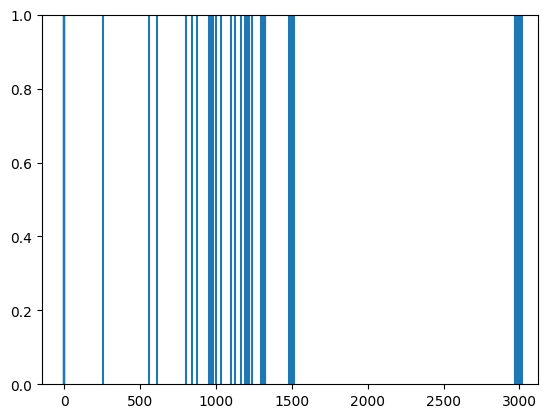

In [25]:
for a,b in zip(v, np.ones_like(v)):
    plt.axvline(a)

In [26]:
# Write Molden file
with open('output.molden', 'w') as f:
    header(mol, f)
    orbital_coeff(mol, f, atoms.calc.mf.mo_coeff[0], ignore_h=False)

NameError: name 'header' is not defined

In [30]:
def to_chemcord(Z, R):
    x,y,z = R.T
    df = pd.DataFrame({"atom": Z, "x": x.flatten(), "y":y.flatten(), "z": z.flatten()})
    cart = cc.Cartesian(df)
    zmat = cart.get_zmat()
    return cart, zmat

In [31]:
def ase_to_chemcord(atoms):
    return to_chemcord(atoms.get_chemical_symbols(), atoms.get_positions())

In [32]:
# def chemcord_to_ase(cart):
#     return cart.

In [33]:
import re
from collections import defaultdict

def parse_cp_output(text):
    blocks = re.split(r'-{10,}\s+CP\s+\d+,\s+Type\s+\([^)]+\)\s+-{10,}', text)
    headers = re.findall(r'-{10,}\s+CP\s+(\d+),\s+Type\s+\(([^)]+)\)\s+-{10,}', text)

    data = []

    for header, block in zip(headers, blocks[1:]):  # blocks[0] is before first CP
        cp_index, cp_type = header
        cp_data = {
            "CP_index": int(cp_index),
            "Type": cp_type.strip(),
            "Scalars": {},
            "Vectors": {},
            "Matrices": {},
            "Eigenvalues": {},
            "Eigenvectors": {}
        }

        lines = block.strip().split('\n')

        # Helper functions
        def extract_vector(label, line):
            values = re.findall(r'[-+]?\d*\.\d+E[+-]\d+|\d+\.\d+', line)
            return list(map(float, values)) if values else None

        def extract_scalar(label, line):
            match = re.search(rf'{re.escape(label)}.*?:\s+([-\d.E+]+)', line)
            return float(match.group(1)) if match else None

        # Parsing logic
        i = 0
        while i < len(lines):
            line = lines[i]

            if "Corresponding nucleus" in line:
                match = re.search(r'Corresponding nucleus:\s+(\d+)\((.*?)\)', line)
                if match:
                    cp_data["Nucleus"] = {"Index": int(match.group(1)), "Element": match.group(2).strip()}

            elif "Position (Bohr)" in line:
                cp_data["Vectors"]["Position_Bohr"] = extract_vector("Position (Bohr)", line)

            elif "Position (Angstrom)" in line:
                cp_data["Vectors"]["Position_Angstrom"] = extract_vector("Position (Angstrom)", line)

            elif "Density of all electrons" in line:
                cp_data["Scalars"]["Density_all"] = extract_scalar("Density of all electrons", line)

            elif "G(r) in X,Y,Z" in line:
                cp_data["Vectors"]["G_r_components"] = extract_vector("G(r) in X,Y,Z", line)

            elif "Components of gradient" in line:
                cp_data["Vectors"]["Gradient"] = extract_vector("Components of gradient", lines[i+1])
                i += 1

            elif "Components of Laplacian" in line:
                cp_data["Vectors"]["Laplacian_components"] = extract_vector("Components of Laplacian", lines[i+1])
                i += 1

            elif "Hessian matrix:" in line:
                matrix = []
                for j in range(1, 4):
                    matrix.append(extract_vector("", lines[i + j]))
                cp_data["Matrices"]["Hessian"] = matrix
                i += 3

            elif "Eigenvalues of Hessian" in line:
                cp_data["Eigenvalues"]["Hessian"] = extract_vector("Eigenvalues of Hessian", line)

            elif "Eigenvectors (columns) of Hessian" in line:
                eigenvectors = []
                for j in range(1, 4):
                    eigenvectors.append(extract_vector("", lines[i + j]))
                cp_data["Eigenvectors"]["Hessian"] = eigenvectors
                i += 3

            elif "Stress tensor:" in line:
                matrix = []
                for j in range(1, 4):
                    matrix.append(extract_vector("", lines[i + j]))
                cp_data["Matrices"]["Stress_tensor"] = matrix
                i += 3

            elif "Eigenvalues of stress tensor" in line:
                cp_data["Eigenvalues"]["Stress_tensor"] = extract_vector("Eigenvalues of stress tensor", line)

            elif "Eigenvectors (columns) of stress tensor" in line:
                eigenvectors = []
                for j in range(1, 4):
                    eigenvectors.append(extract_vector("", lines[i + j]))
                cp_data["Eigenvectors"]["Stress_tensor"] = eigenvectors
                i += 3

            else:
                scalar_match = re.search(r'^(.*?)\s*:\s*([-\d.E+]+)$', line.strip())
                if scalar_match:
                    label = scalar_match.group(1).strip()
                    value = float(scalar_match.group(2))
                    cp_data["Scalars"][label] = value

            i += 1

        data.append(cp_data)

    return data

In [34]:
import numpy
from ase.calculators.calculator import Calculator, all_changes
from ase.units import Ha, Bohr, Debye
# from pyscf.prop.polarizability.uhf import polarizability, Polarizability
from pyscf.pbc.tools.pyscf_ase import atoms_from_ase
import jsonpickle

class parameters():
    # holds the calculation mode and user-chosen attributes of post-HF objects
    def __init__(self):
        self.mode = 'hf'
    def show(self):
        print('------------------------')
        print('calculation-specific parameters set by the user')
        print('------------------------')
        for v in vars(self):
            print('{}:  {}'.format(v,vars(self)[v]))
        print('\n\n')
                                                         


def todict(x):
    return jsonpickle.encode(x, unpicklable=False)


def init_geo(mf, atoms):
    # convert ASE structural information to PySCF information
    if atoms.pbc.any():
        cell = mf.cell.copy()
        cell.atom = atoms_from_ase(atoms)
        cell.a = atoms.cell.copy()
        cell.build()
        mf.reset(cell=cell.copy())
    else:
        mol = mf.mol.copy()
        mol.atom = atoms_from_ase(atoms)
        mol.build()
        mf.reset(mol=mol.copy())

class PYSCF(Calculator):
    # PySCF ASE calculator
    # by Jakob Kraus
    # units:  ase         -> units [eV,Angstroem,eV/Angstroem,e*A,A**3]
    #         pyscf       -> units [Ha,Bohr,Ha/Bohr,Debye,Bohr**3]

    implemented_properties = ['energy','forces','dipole',
                              # 'polarizability'
                             ]
    
    
    def __init__(self, restart=None, ignore_bad_restart_file=False,
                 label='PySCF', atoms=None, directory='.', **kwargs):
        # constructor
        Calculator.__init__(self, restart, ignore_bad_restart_file,
                            label, atoms, directory, **kwargs)
        self.initialize(**kwargs)


    def initialize(self, mf=None, p=None):
        # attach the mf object to the calculator
        # add the todict functionality to enable ASE trajectories:
        # https://github.com/pyscf/pyscf/issues/624
        self.mf = mf
        self.p = p
        self.mf.todict = lambda: todict(self.mf)
        self.p.todict = lambda: todict(self.p)

    def set(self, **kwargs):
        # allow for a calculator reset
        changed_parameters = Calculator.set(self, **kwargs)
        if changed_parameters:
            self.reset()
    
    def get_polarizability(self,atoms=None):
        return self.get_property('polarizability',atoms)
    
    def calculate(self,atoms=None,properties=['energy'],system_changes=all_changes):
        
        Calculator.calculate(self,atoms=atoms,properties=properties,system_changes=system_changes)
        
        # update your mf object with new structural information
        init_geo(self.mf, atoms)

        # further update your mf object for post-HF methods
        if hasattr(self.mf,'_scf'):
            self.mf._scf.kernel()
            self.mf.__init__(self.mf._scf)
            for v in vars(self.p):
                if v != 'mode':
                    setattr(self.mf,v,vars(self.p)[v])
        self.mf.kernel()
        e = self.mf.e_tot
        
        if self.p.mode.lower() == 'ccsd(t)':
            e += self.mf.ccsd_t()
        
        self.results['energy'] = e * Ha
        
        if 'forces' in properties:
            gf = self.mf.nuc_grad_method()
            gf.verbose = self.mf.verbose
            if self.p.mode.lower() == 'dft':
                gf.grid_response = True
            forces = -1. * gf.kernel() * (Ha / Bohr)
            totalforces = []
            totalforces.extend(forces)
            totalforces = numpy.array(totalforces)
            self.results['forces'] = totalforces
        
        if hasattr(self.mf,'_scf'):
            self.results['dipole'] = self.mf._scf.dip_moment(verbose=self.mf._scf.verbose) * Debye
            # self.results['polarizability'] = Polarizability(self.mf._scf).polarizability() * (Bohr**3)
        else:
            self.results['dipole'] = self.mf.dip_moment(verbose=self.mf.verbose) * Debye
            # self.results['polarizability'] = Polarizability(self.mf).polarizability() * (Bohr**3)

In [35]:
import chemcoord as cc
import time

In [36]:
def sym_to_ase(eq):
    test = ase.io.extxyz.read_xyz(StringIO(eq["sym_mol"].to_xyz()))
    test = next(test)
    return test

In [37]:
def set_up_pyscf_cpu_calc(atoms, 
                          sym=False, 
                          index = 0,
                         basis='cc-pvdz',
                         spin=0,
                         charge=0):
    atoms = res_atoms.copy()
    mol = pyscf.M(atom=atoms_from_ase(atoms),
                  basis=basis,
                  spin=spin,charge=charge
                 )
    mf = mol.UHF()
    mf.verbose = 3
    # mf.kernel() 
    
    mf = [mf,mf.MP2(),mf.CISD(),mf.CCSD(),mf.CCSD()][index]
    p = parameters()
    p.mode = ['hf','mp2','cisd','ccsd','ccsd(t)'][index]
    p.verbose = 5
    p.show()
    if sym:
        mf.mol.symmetry = True
        mf.mol.symmetry = sym
    return PYSCF(mf=mf,p=p)
    


In [38]:
res_atoms

Atoms(symbols='CH2CH2CH2CH2CH2', pbc=False, calculator=XTB(...))

In [39]:
import pyscf
from ase import Atoms
from ase.optimize import LBFGS

atoms = res_atoms.copy()


In [40]:
atoms.calc = set_up_pyscf_cpu_calc(atoms, sym="D2")

------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5





/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


In [41]:
atoms.calc.mf #.ccsd()

In [42]:
atoms.calc.mf.kernel()

<class 'pyscf.scf.uhf.UHF'> does not have attributes  todict


converged SCF energy = -195.175814983023  <S^2> = 2.2915003e-11  2S+1 = 1


-195.1758149830231

In [43]:
view_atoms(atoms)

In [44]:
cart, zmat = ase_to_chemcord(atoms)
eq = cart.symmetrize(max_n=25, tolerance=0.3, epsilon=1e-5)
eq['sym_mol'].get_pointgroup(tolerance=0.1)

Cs

In [45]:
atoms.calc.mf.mol.symmetry, eq['sym_mol'].get_pointgroup(tolerance=0.1)

('D2', Cs)

In [46]:
eq

{'sym_mol':    atom         x         y         z
 0     C  0.687492 -0.960181 -0.487928
 1     H  0.249348 -1.262535 -1.440658
 2     H  1.559707 -1.585383 -0.301178
 3     C  1.026850  0.526395 -0.532611
 4     H  1.685665  0.783677  0.298657
 5     H  1.510644  0.820836 -1.463101
 6     C -0.335796  1.184888 -0.340512
 7     H -0.259844  2.228854 -0.039050
 8     H -0.896901  1.140291 -1.275528
 9     C -1.018180  0.319925  0.726057
 10    H -0.854930  0.747137  1.715736
 11    H -2.094029  0.266362  0.564370
 12    C -0.355793 -1.068605  0.630632
 13    H -1.084358 -1.850161  0.418915
 14    H  0.130583 -1.318747  1.573761,
 'eq_sets': {0: {0, 6},
  3: {3},
  9: {9, 12},
  1: {1, 8},
  2: {2, 7},
  4: {4},
  5: {5},
  10: {10, 14},
  11: {11, 13}},
 'sym_ops': {0: {6: array([[ 0.63065702,  0.77423551,  0.05320818],
          [ 0.77423551, -0.62299175, -0.11153768],
          [ 0.05320818, -0.11153768,  0.99233474]]),
   0: array([[1., 0., 0.],
          [0., 1., 0.],
          [0.,

In [47]:
# atoms.set_positions(sym_to_ase(eq).get_positions())

In [48]:
# from ase.constraints import FixSymmetry
# atoms.set_constraint([FixSymmetry(atoms)])

In [49]:
from ase.optimize import BFGS
atoms.calc = set_up_pyscf_cpu_calc(atoms, sym="C1")
bfgs = BFGS(atoms)
bfgs.run(fmax=0.01)
print(atoms.calc.results)

------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5





/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


converged SCF energy = -195.175814983023  <S^2> = 2.2925661e-11  2S+1 = 1
--------------- UHF gradients ---------------
         x                y                z
0 C    -0.0032222905     0.0001323233    -0.0020150540
1 H    -0.0004816473     0.0010330432     0.0019087645
2 H    -0.0009065475     0.0023650284     0.0019006515
3 C     0.0020037349     0.0006688067     0.0046562157
4 H    -0.0024358064    -0.0011204411    -0.0009858190
5 H    -0.0029089160    -0.0014164533     0.0003339339
6 C    -0.0021000786    -0.0023247064    -0.0022623512
7 H     0.0013879357    -0.0023911333     0.0015628227
8 H     0.0006298887    -0.0012206068     0.0017778246
9 C     0.0032763261    -0.0015253781    -0.0004226117
10 H     0.0014193406    -0.0007372826    -0.0014041700
11 H     0.0018364838    -0.0009828949    -0.0019495409
12 C     0.0009065959     0.0035136636    -0.0002044278
13 H     0.0003020219     0.0022582348    -0.0016767721
14 H     0.0002929584     0.0017477965    -0.0012194663
-----

In [50]:
from pyscf.tools.molden import orbital_coeff, header, order_ao_index

mol = atoms.calc.mf.mol

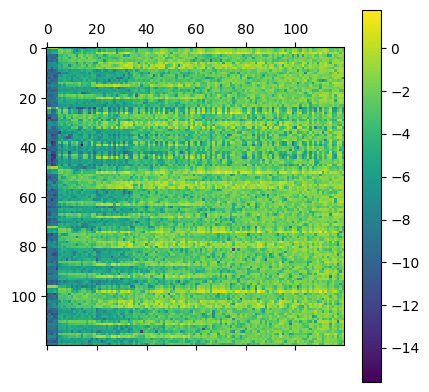

In [51]:
plt.matshow(np.log((atoms.calc.mf.mo_coeff[0]**2)**0.5))
plt.colorbar()

In [52]:
view_atoms(atoms)

In [53]:
atoms.calc.mf.mo_coeff.shape

(2, 120, 120)

In [54]:
text = open("/home/boittier/Multiwfn_3.8_dev_bin_Linux/CPprop.txt").read()
data = parse_cp_output(text)

In [55]:
text

' ----------------   CP     1,     Type (3,-3)   ----------------\n Corresponding nucleus:     9(H )\n Position (Bohr):       -1.382010038416   -3.571434319866    1.669184460334\n Position (Angstrom):   -0.731328217569   -1.889921652310    0.883294377202\n Density of all electrons:  0.1968369560E+00\n Density of Alpha electrons:  0.1968369560E+00\n Density of Beta electrons:  0.0000000000E+00\n Spin density of electrons:  0.1968369560E+00\n Lagrangian kinetic energy G(r):  0.3525008882E-02\n G(r) in X,Y,Z:  0.1321212051E-02  0.1119972344E-02  0.1083824487E-02\n Hamiltonian kinetic energy K(r):  0.1574922838E+01\n Potential energy density V(r): -0.1578447847E+01\n Energy density E(r) or H(r): -0.1574922838E+01\n Laplacian of electron density: -0.6285591315E+01\n Electron localization function (ELF):  0.9998644219E+00\n Localized orbital locator (LOL):  0.9885216338E+00\n Local information entropy:  0.4548027902E-01\n Interaction region indicator (IRI):  0.1932490245E-14\n Reduced densit

In [56]:
import pandas as pd

In [57]:
pd.DataFrame(data)

,CP_index,Type,Scalars,Vectors,Matrices,Eigenvalues,Eigenvectors,Nucleus
0,1,"3,-3","{'Density_all': 0.196836956, 'Density of Alpha...","{'Position_Bohr': [1.382010038416, 3.571434319...","{'Hessian': [[-2.161274808, 0.0593622878, -0.0...","{'Hessian': [-2.191849495, -2.191477399, -1.90...","{'Hessian': [[0.4946133414, 0.8066056124, -0.3...","{'Index': 9, 'Element': 'H'}"
1,2,"3,-3","{'Density_all': 0.1975064778, 'Density of Alph...","{'Position_Bohr': [0.676706845952, 3.356441045...","{'Hessian': [[-2.20174233, -0.003473719999, -0...","{'Hessian': [-2.202097879, -2.201264528, -1.91...","{'Hessian': [[-0.8858856917, 0.4632405954, -0....","{'Index': 8, 'Element': 'H'}"
2,3,"3,-3","{'Density_all': 60.3260402, 'Density of Alpha ...","{'Position_Bohr': [0.733241045533, 2.314287644...","{'Hessian': [[-111119.4589, 0.0284999049, -0.0...","{'Hessian': [-111119.4813, -111119.437, -11111...","{'Hessian': [[0.7933927967, -0.09217405549, 0....","{'Index': 7, 'Element': 'C'}"
3,4,"3,-3","{'Density_all': 0.1964413085, 'Density of Alph...","{'Position_Bohr': [3.38128159453, 2.5209649119...","{'Hessian': [[-2.028337497, -0.1355470544, -0....","{'Hessian': [-2.186597974, -2.186093232, -1.89...","{'Hessian': [[0.4042360119, 0.5383746569, 0.73...","{'Index': 6, 'Element': 'H'}"
4,5,"3,-3","{'Density_all': 0.1968702885, 'Density of Alph...","{'Position_Bohr': [2.071972644013, 0.817113805...","{'Hessian': [[-2.191042644, 0.005279132213, 0....","{'Hessian': [-2.193835746, -2.193393278, -1.90...","{'Hessian': [[-0.5435981195, -0.8341367451, 0....","{'Index': 5, 'Element': 'H'}"
5,6,"3,-3","{'Density_all': 60.33025752, 'Density of Alpha...","{'Position_Bohr': [1.902906492601, 1.246446700...","{'Hessian': [[-111128.7113, -0.00549270765, 0....","{'Hessian': [-111128.7372, -111128.7142, -1111...","{'Hessian': [[0.4181587895, 0.7084193572, 0.56...","{'Index': 4, 'Element': 'C'}"
6,7,"3,-3","{'Density_all': 0.1973577071, 'Density of Alph...","{'Position_Bohr': [3.696555539463, 0.235070599...","{'Hessian': [[-2.086212784, -0.01839922823, -0...","{'Hessian': [-2.198986656, -2.198431273, -1.90...","{'Hessian': [[-0.1544953127, -0.7663870549, -0...","{'Index': 11, 'Element': 'H'}"
7,8,"3,-3","{'Density_all': 60.32183294, 'Density of Alpha...","{'Position_Bohr': [2.461633330533, 0.028140961...","{'Hessian': [[-111110.1552, -0.001078649562, 3...","{'Hessian': [-111110.2245, -111110.1552, -1111...","{'Hessian': [[0.01539887969, 0.9996577508, -0....","{'Index': 10, 'Element': 'C'}"
8,9,"3,-3","{'Density_all': 0.1973576498, 'Density of Alph...","{'Position_Bohr': [3.62616821622, 0.1513459315...","{'Hessian': [[-2.098403519, 0.01500697349, 0.1...","{'Hessian': [-2.198986112, -2.198430686, -1.90...","{'Hessian': [[-0.1315212098, 0.7975992152, 0.5...","{'Index': 12, 'Element': 'H'}"
9,10,"3,-3","{'Density_all': 60.33025718, 'Density of Alpha...","{'Position_Bohr': [1.966890381856, 1.202220585...","{'Hessian': [[-111128.709, 0.006142980485, -0....","{'Hessian': [-111128.7365, -111128.7134, -1111...","{'Hessian': [[-0.3830195324, 0.6975676751, -0....","{'Index': 1, 'Element': 'C'}"


In [58]:
pd.DataFrame([_["Scalars"] for _ in data])

,Density_all,Density of Alpha electrons,Density of Beta electrons,Spin density of electrons,Lagrangian kinetic energy G(r),Hamiltonian kinetic energy K(r),Potential energy density V(r),Energy density E(r) or H(r),Laplacian of electron density,Electron localization function (ELF),...,User-defined real space function,ESP from nuclear charges,Norm of gradient is,Total,Determinant of Hessian,Ellipticity of electron density,eta index,Stiffness,Stress tensor stiffness,Stress tensor polarizability
0,0.196837,0.196837,0.000000e+00,0.196837,0.003525,1.574923,-1.578448,-1.574923,-6.285591,0.999864,...,1.0,2.679443e+01,3.233215e-16,-6.285591,-9.137315e+00,0.000170,-1.152232,-1.152036,1.155013,0.865791
1,0.197506,0.197506,-1.387779e-17,0.197506,0.003601,1.583093,-1.586694,-1.583093,-6.317969,0.999860,...,1.0,2.733098e+01,2.579257e-16,-6.317969,-9.280865e+00,0.000379,-1.150157,-1.149721,1.152513,0.867669
2,60.326040,60.326040,-7.105427e-15,60.326040,2.658985,83342.243660,-83344.902650,-83342.243660,-333358.338700,1.000000,...,1.0,8.451406e+06,8.386342e-12,-333358.338700,-1.372051e+15,0.000000,-1.000001,-1.000000,1.000001,0.999999
3,0.196441,0.196441,1.387779e-17,0.196441,0.003460,1.570985,-1.574445,-1.570985,-6.270098,0.999868,...,1.0,2.674120e+01,3.536064e-16,-6.270098,-9.069807e+00,0.000231,-1.152414,-1.152148,1.155161,0.865680
4,0.196870,0.196870,-2.775558e-17,0.196870,0.003551,1.577541,-1.581092,-1.577541,-6.295961,0.999863,...,1.0,2.749361e+01,3.597568e-16,-6.295961,-9.184714e+00,0.000202,-1.149368,-1.149136,1.151700,0.868281
5,60.330258,60.330258,7.105427e-15,60.330258,2.662490,83349.198560,-83351.861060,-83349.198560,-333386.144300,1.000000,...,1.0,7.470501e+06,9.353607e-12,-333386.144300,-1.372394e+15,0.000000,-1.000000,-1.000000,1.000001,0.999999
6,0.197358,0.197358,-1.387779e-17,0.197358,0.003600,1.580394,-1.583994,-1.580394,-6.307174,0.999860,...,1.0,2.700187e+01,1.582787e-16,-6.307174,-9.232374e+00,0.000253,-1.151449,-1.151158,1.154032,0.866527
7,60.321833,60.321833,3.552714e-15,60.321833,2.656293,83335.288180,-83337.944480,-83335.288180,-333330.527600,1.000000,...,1.0,9.401451e+06,5.527040e-12,-333330.527600,-1.371707e+15,0.000001,-1.000001,-1.000000,1.000001,0.999999
8,0.197358,0.197358,0.000000e+00,0.197358,0.003600,1.580393,-1.583994,-1.580393,-6.307172,0.999860,...,1.0,2.700187e+01,1.979453e-16,-6.307172,-9.232367e+00,0.000253,-1.151449,-1.151158,1.154032,0.866527
9,60.330257,60.330257,3.552714e-15,60.330257,2.662489,83349.198020,-83351.860510,-83349.198020,-333386.142100,1.000000,...,1.0,7.470517e+06,1.056898e-11,-333386.142100,-1.372394e+15,0.000000,-1.000000,-1.000000,1.000001,0.999999


In [59]:
x,y,z = atoms.calc.mf.mol.atom_coords().T
R2 = atoms.calc.mf.mol.atom_coords()
x2,y2,z2 = R2.T

In [60]:
Z = res_atoms.get_chemical_symbols()
Z

['C', 'H', 'H', 'C', 'H', 'H', 'C', 'H', 'H', 'C', 'H', 'H', 'C', 'H', 'H']

In [61]:
cart.to_xyz()

'15\nCreated by chemcoord http://chemcoord.readthedocs.io/\nC  1.241282 -0.473981  0.017905\nH  0.805805 -0.776926 -0.935854\nH  2.113220 -1.098853  0.207060\nC  1.580579  1.012723 -0.026769\nH  2.239393  1.270005  0.804499\nH  2.064372  1.307164 -0.957259\nC  0.217994  1.671088  0.165322\nH  0.293737  2.715742  0.464449\nH -0.344280  1.623942 -0.768881\nC -0.461915  0.807808  1.234541\nH -0.290942  1.233582  2.223594\nH -1.538927  0.758627  1.079212\nC  0.194991 -0.582977  1.133891\nH -0.536571 -1.360193  0.916415\nH  0.677644 -0.840064  2.077069'

In [62]:
from io import StringIO
# StringIO(cart.to_string())
StringIO?

Init signature: StringIO(initial_value='', newline='\n')
Docstring:     
Text I/O implementation using an in-memory buffer.

The initial_value argument sets the value of object.  The newline
argument is like the one of TextIOWrapper's constructor.
Type:           type
Subclasses:     CUnicodeIO

In [63]:
# view_atoms(test)

In [64]:
cart.get_pointgroup(tolerance=0.1)

Cs

In [65]:
eq = cart.symmetrize(max_n=25, tolerance=0.3, epsilon=1e-5)
eq

{'sym_mol':    atom         x         y         z
 0     C  0.687492 -0.960181 -0.487928
 1     H  0.249348 -1.262535 -1.440658
 2     H  1.559707 -1.585383 -0.301178
 3     C  1.026850  0.526395 -0.532611
 4     H  1.685665  0.783677  0.298657
 5     H  1.510644  0.820836 -1.463101
 6     C -0.335796  1.184888 -0.340512
 7     H -0.259844  2.228854 -0.039050
 8     H -0.896901  1.140291 -1.275528
 9     C -1.018180  0.319925  0.726057
 10    H -0.854930  0.747137  1.715736
 11    H -2.094029  0.266362  0.564370
 12    C -0.355793 -1.068605  0.630632
 13    H -1.084358 -1.850161  0.418915
 14    H  0.130583 -1.318747  1.573761,
 'eq_sets': {0: {0, 6},
  3: {3},
  9: {9, 12},
  1: {1, 8},
  2: {2, 7},
  4: {4},
  5: {5},
  10: {10, 14},
  11: {11, 13}},
 'sym_ops': {0: {6: array([[ 0.63065702,  0.77423551,  0.05320818],
          [ 0.77423551, -0.62299175, -0.11153768],
          [ 0.05320818, -0.11153768,  0.99233474]]),
   0: array([[1., 0., 0.],
          [0., 1., 0.],
          [0.,

In [66]:
eq['sym_mol'].get_pointgroup(tolerance=0.1)

Cs

In [67]:
res_atoms_A = res_atoms.copy()
res_atoms_B = res_atoms.copy()
res_atoms_B.set_positions(np.array([0,10,0])+R2/1.88972)

In [68]:
dimer = res_atoms_A + res_atoms_B
dimer

Atoms(symbols='CH2CH2CH2CH2CH2CH2CH2CH2CH2CH2', pbc=False)

In [69]:
view_atoms(dimer)

In [70]:
dimer_cc, dimer_cz = to_chemcord(dimer.get_chemical_symbols(), dimer.get_positions())

In [71]:
fn = "test.xyz"
ase.io.write(fn, res_atoms_A)

In [72]:
from pyxtal import pyxtal
res_atoms_A

from pyxtal.molecule import pyxtal_molecule
m = pyxtal_molecule(fn)
m

In [73]:
confs = {}

In [74]:
from pyxtal import pyxtal

for r in range(2):
    for d in range(1,4):
        for i in range(1,171):
            try:
                c = pyxtal(molecular=True)
                c.from_random(d, i, [m], [2])
                catoms = c.to_ase()
                ccc, ccz = ase_to_chemcord(catoms)
                eq = ccc.symmetrize(
                    # max_n=200000, 
                                    # tolerance=0.3, 
                                    # epsilon=1e-5
                                   )
                # print(ccc.get_pointgroup(tolerance=0.1),
                #       eq["sym_mol"].get_pointgroup(tolerance=0.1))
                pgs = eq["sym_mol"].get_pointgroup(tolerance=0.1)
                # print(pgs)
                if str(pgs) not in confs.keys():
                    print(pgs)
                    confs[str(pgs)] = []
                confs[str(pgs)].append(eq)
            except:# Symm_CompatibilityError:
                pass

C1
S2
C2
Cs
C2h
Ci
C2v
D2
D2h


In [ ]:
confs.keys()

In [76]:
min_confs = {}
for c in confs.keys():
    print(c, len(confs[c]))
    min_E = 1000
    min_conf = None
    for _ in confs[c]:

        b = sym_to_ase(_)
        b.calc = XTB()
        E = b.get_potential_energy()
        if E < min_E:
            min_E = E
            a = sym_to_ase(_)
            a.calc = set_up_pyscf_cpu_calc(_, sym=c)
            print(a.calc.mf.mol.symmetry, c)
            min_conf = a


    min_confs[c] = min_conf



C1 28


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C1 C1


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C1 C1


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C1 C1


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xt

S2 1


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



S2 S2
C2 15


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2 C2


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2 C2


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2 C2


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xt

Cs 25


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Cs Cs


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Cs Cs


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Cs Cs


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Cs Cs


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xt

C2h 12


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2h C2h


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2h C2h


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2h C2h


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2h C2h


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


Ci 8


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Ci Ci


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Ci Ci


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Ci Ci


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



Ci Ci
C2v 3


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2v C2v


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



C2v C2v
D2 3


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



D2 D2


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



D2 D2


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL


D2h 1
------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5



D2h D2h


normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


In [77]:
min_confs

{'C1': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'S2': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'C2': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'Cs': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'C2h': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'Ci': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'C2v': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'D2': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...)),
 'D2h': Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...))}

In [78]:
view_atoms(min_confs["C2"])

In [79]:
make_rigid_com_scan?

Object `make_rigid_com_scan` not found.


In [80]:
make_rigid_angle_scan?

Object `make_rigid_angle_scan` not found.


In [85]:
separate_monomers_by_distance(min_confs[c])

[Atoms(symbols='H10C5', pbc=False), Atoms(symbols='H10C5', pbc=False)]

In [86]:
make_rigid_angle_scan?

Signature: make_rigid_angle_scan(A, B, n_points=20, distance=3.0, axis='z')
Docstring:
Rotate B around its COM while keeping it at a fixed COM distance from A.

Parameters:
    A (ase.Atoms): First molecule.
    B (ase.Atoms): Second molecule.
    n_points (int): Number of angular steps.
    distance (float): Distance between COMs.
    axis (str or array-like): Axis around which B is rotated.
    
Returns:
    list[ase.Atoms]: List of rotated and combined dimer structures.
File:      /tmp/ipykernel_681973/2334329583.py
Type:      function

In [87]:
make_rigid_com_scan?

Signature: make_rigid_com_scan(A, B, n_points=20, maxdist=20.0, mindist=2.0)
Docstring:
Generate a series of rigid dimer configurations by translating B along the COM vector from A.

Parameters:
    A (ase.Atoms): First molecule.
    B (ase.Atoms): Second molecule.
    n_points (int): Number of translation steps.
    maxdist (float): Maximum separation between COMs.
    mindist (float): Minimum separation between COMs.
    
Returns:
    list[ase.Atoms]: List of combined dimer structures.
File:      /tmp/ipykernel_681973/2334329583.py
Type:      function

In [88]:
com_dist(min_confs[c],15)

1.591593589355892

In [89]:
min_confs[c]

Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...))

In [90]:
sym_scans = {}

for c in min_confs.keys():
    C2_test_atoms_A, C2_test_atoms_B = separate_monomers_by_distance(min_confs[c])
    scan1  = make_rigid_com_scan(C2_test_atoms_A, C2_test_atoms_B, maxdist=7.5, mindist=7.0, n_points=6)
    sym_scans[c] = [make_rigid_angle_scan(
        _[:15], _[15:], n_points=12, distance=com_dist(_,15))
                    for _ in scan1]
    

In [91]:
sym_scans

{'C1': [[Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False)],
  [Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   Atoms(symbols='H10C5H10C5', pbc=False),
   A

In [92]:
import itertools
all_atoms = []
for _ in list(sym_scans.values()):
    for __ in _:
        for ___ in __:
            all_atoms.append(___)
        
len(all_atoms), len(sym_scans.keys())

(648, 9)

In [93]:
all_atoms

[Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='H10C5H10C5', pbc=False),
 Atoms(symbols='

In [94]:
view_atoms(all_atoms[0])

In [95]:
sym_scans.values()

dict_values([[[Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False)], [Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False), Atoms(symbols='H10C5H10C5', pbc=False)], [Atoms(symbols='H10C5H

In [96]:
view_atoms(scan1[0])

In [108]:
# ccc.symmetrize?

In [109]:
ccc, ccz = ase_to_chemcord(scan1[0])
eq = ccc.symmetrize(max_n=25, tolerance=0.3, epsilon=1e-5)
eq["sym_mol"].get_pointgroup()

C2

In [110]:
calc = set_up_pyscf_cpu_calc(sym_to_ase(eq))
calc.mf.mol = calc.mf.mol.build()

# ccc.get_pointgroup()
# cc.

------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5





/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


In [97]:
view_atoms(sym_to_ase(eq))

In [98]:
view_atoms(min_confs["C2"])

In [99]:
view_atoms(min_confs["Ci"])

In [100]:
import numpy as np
from ase import Atoms

def make_rigid_com_scan(A, B, n_points=20, maxdist=20.0, mindist=2.0):
    """
    Generate a series of rigid dimer configurations by translating B along the COM vector from A.
    
    Parameters:
        A (ase.Atoms): First molecule.
        B (ase.Atoms): Second molecule.
        n_points (int): Number of translation steps.
        maxdist (float): Maximum separation between COMs.
        mindist (float): Minimum separation between COMs.
        
    Returns:
        list[ase.Atoms]: List of combined dimer structures.
    """
    com_A = A.get_center_of_mass()
    com_B = B.get_center_of_mass()
    
    # Vector pointing from B to A
    disp_vec = com_A - com_B
    norm = np.linalg.norm(disp_vec)
    if norm == 0:
        raise ValueError("A and B have the same center of mass.")
    
    disp_unit = disp_vec / norm

    # Distances at which to place B
    distances = np.linspace(mindist, maxdist, n_points)
    structures = []

    for d in distances:
        B_translated = B.copy()
        new_com_B = com_A - disp_unit * d
        shift_vec = new_com_B - com_B
        B_translated.translate(shift_vec)

        combined = A + B_translated
        structures.append(combined)

    return structures


# from ase.geometry import rotate

def make_rigid_angle_scan(A, B, n_points=20, distance=3.0, axis='z'):
    """
    Rotate B around its COM while keeping it at a fixed COM distance from A.
    
    Parameters:
        A (ase.Atoms): First molecule.
        B (ase.Atoms): Second molecule.
        n_points (int): Number of angular steps.
        distance (float): Distance between COMs.
        axis (str or array-like): Axis around which B is rotated.
        
    Returns:
        list[ase.Atoms]: List of rotated and combined dimer structures.
    """
    com_A = A.get_center_of_mass()
    com_B = B.get_center_of_mass()
    
    # Translate B so its COM is 'distance' away from A along x-axis
    initial_direction = np.array([1.0, 0.0, 0.0])
    target_com_B = com_A + initial_direction * distance
    shift_vec = target_com_B - com_B

    structures = []
    angles = np.linspace(0, 360, n_points, endpoint=False)

    for angle in angles:
        B_rotated = B.copy()
        B_rotated.rotate(angle, axis, center=com_B)  # rotate around B's COM
        B_rotated.translate(shift_vec)                    # place at correct distance
        combined = A + B_rotated
        structures.append(combined)

    return structures


In [101]:
import numpy as np
from ase import Atoms
from scipy.spatial.distance import pdist, squareform
from scipy.sparse.csgraph import connected_components
from scipy.sparse import csr_matrix

def separate_monomers_by_distance(system: Atoms, threshold: float = 1.8):
    """
    Separates a system of atoms into monomers based on distance threshold.
    
    Parameters:
        system (ase.Atoms): The full atomic system (e.g., dimer or multimer).
        threshold (float): Maximum distance to consider atoms as bonded.
        
    Returns:
        list[ase.Atoms]: List of separate monomer Atoms objects.
    """
    positions = system.get_positions()
    dists = squareform(pdist(positions))
    
    # Build adjacency matrix where atoms within threshold are connected
    adjacency = (dists < threshold).astype(int)
    np.fill_diagonal(adjacency, 0)  # remove self-loops
    
    # Use connected components to group atoms
    graph = csr_matrix(adjacency)
    n_components, labels = connected_components(csgraph=graph, directed=False)
    
    monomers = []
    for i in range(n_components):
        indices = np.where(labels == i)[0]
        monomer = system[indices]
        monomers.append(monomer)
    
    return monomers

import numpy as np
from ase import Atoms

def get_mean_plane(atoms: Atoms):
    """
    Computes the best-fit (mean) plane for a set of atoms.

    Parameters:
        atoms (ase.Atoms): Atoms object to fit the plane to.

    Returns:
        centroid (np.ndarray): A point on the plane (mean position).
        normal (np.ndarray): Unit vector normal to the best-fit plane.
    """
    positions = atoms.get_positions()
    centroid = np.mean(positions, axis=0)

    # Subtract centroid to center the points
    centered = positions - centroid

    # Singular Value Decomposition
    _, _, vh = np.linalg.svd(centered)
    normal = vh[-1]  # Last row corresponds to smallest singular value (normal direction)

    return centroid, normal


import numpy as np

def angle_between_planes(normal1: np.ndarray, normal2: np.ndarray, degrees=True):
    """
    Computes the angle between two planes from their normal vectors.

    Parameters:
        normal1 (np.ndarray): Normal vector of the first plane.
        normal2 (np.ndarray): Normal vector of the second plane.
        degrees (bool): If True, returns angle in degrees. Otherwise, in radians.

    Returns:
        float: Angle between the two planes.
    """
    # Normalize normals
    n1 = normal1 / np.linalg.norm(normal1)
    n2 = normal2 / np.linalg.norm(normal2)

    # Compute angle between normals
    cos_angle = np.clip(np.dot(n1, n2), -1.0, 1.0)
    angle = np.arccos(cos_angle)

    if degrees:
        angle = np.degrees(angle)
    
    return angle


In [102]:
C2_test_atoms_A, C2_test_atoms_B = separate_monomers_by_distance(C2_test_atoms)
scan1  = make_rigid_com_scan(C2_test_atoms_A, C2_test_atoms_B)

NameError: name 'C2_test_atoms' is not defined

In [440]:

# scan1

In [464]:
# for i in range(20):
#     _ = angle_between_planes(get_mean_plane(scan1[i][:15])[1], 
#                              get_mean_plane(scan1[i][15:])[1])
#     print(_)

In [452]:
scan2 = make_rigid_angle_scan(C2_test_atoms_A, C2_test_atoms_B, distance=6)

In [463]:
# for i in range(20):
#     _ = angle_between_planes(get_mean_plane(scan2[i][:15])[1], 
#                              get_mean_plane(scan2[i][15:])[1])
#     print(_)

In [455]:
view_atoms(scan2[-1])

In [351]:
import dscribe
C2_test_atoms = sym_to_ase(confs["C2"][10])
C2_test_atoms

Atoms(symbols='H20C10', pbc=False)

In [397]:
C2_test_atoms.calc = set_up_pyscf_cpu_calc(C2_test_atoms, sym="C2", basis="631+g")
# C2_test_atoms.set_positions(C2_test_atoms.get_positions() * ase.units.Bohr)

------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5





/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


In [398]:
C2_test_atoms.get_potential_energy()


WARN: len(magmom) != natm. Set magmom to zero

converged SCF energy = -390.171100712352  <S^2> = 7.5417006e-11  2S+1 = 1
Dipole moment(X, Y, Z, Debye): -0.00000,  0.00000, -0.01446


-10617.09643703609

In [399]:
view_atoms(C2_test_atoms)

In [392]:
C2_test_atoms_XTB = C2_test_atoms.copy()
C2_test_atoms_XTB.calc = XTB()
C2_test_atoms_XTB.get_potential_energy()

normal termination of xtb
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
Identified logfile to be in XTB format

-748.028296981561

In [393]:
view_atoms(C2_test_atoms_XTB)

In [356]:
C2_test_atoms.get_potential_energy(), C2_test_atoms.get_forces()


WARN: len(magmom) != natm. Set magmom to zero

converged SCF energy = -390.221050845301  <S^2> = 2.6300029e-10  2S+1 = 1
Dipole moment(X, Y, Z, Debye): -0.00000,  0.00000, -0.05185
converged SCF energy = -390.221050845318  <S^2> = 7.9822371e-11  2S+1 = 1
--------------- UHF gradients ---------------
         x                y                z
0 H     0.0161313594     0.0128533943     0.0146165383
1 H     0.0209321047     0.0043947858    -0.0222179470
2 H     0.0154211649     0.0295561862    -0.0105831801
3 H     0.0073391692     0.0035463994     0.0199145296
4 H    -0.0096577973    -0.0052594848     0.0189586674
5 H    -0.0353606369     0.0150907670     0.0436459411
6 H     0.0108587500    -0.0198206101     0.0100466160
7 H    -0.1540227502    -0.0588243714     0.0529232817
8 H     0.0044866071     0.0243155313     0.0265537371
9 H    -0.0162226744     0.0139835107    -0.0007059983
10 H     0.0162226744    -0.0139835107    -0.0007059983
11 H    -0.0161313594    -0.0128533943     0.01

(-10618.45564938571,
 array([[-0.82950785, -0.6609481 , -0.75161261],
        [-1.07637209, -0.22598897,  1.14249276],
        [-0.79298817, -1.51984019,  0.544209  ],
        [-0.37739525, -0.18236319, -1.02404628],
        [ 0.4966239 ,  0.27045358, -0.97489387],
        [ 1.81831704, -0.77599843, -2.24436451],
        [-0.55837937,  1.01921674, -0.51661776],
        [ 7.92016819,  3.02487077, -2.72142454],
        [-0.23071061, -1.25035488, -1.36544805],
        [ 0.83420345, -0.71906103,  0.03630389],
        [-0.83420345,  0.71906103,  0.03630389],
        [ 0.82950785,  0.6609481 , -0.75161261],
        [-1.81831704,  0.77599843, -2.24436451],
        [ 0.79298817,  1.51984019,  0.544209  ],
        [ 0.23071061,  1.25035488, -1.36544805],
        [ 0.37739525,  0.18236319, -1.02404628],
        [-0.4966239 , -0.27045358, -0.97489387],
        [-7.92016819, -3.02487077, -2.72142454],
        [ 1.07637209,  0.22598897,  1.14249276],
        [ 0.55837937, -1.01921674, -0.51661776],

In [404]:
s = """$freeze
rotation 1-16
$scan
rotation 16-30 0.0 1.0 0.0 0.0 175.0 36
"""
with open("constraints.txt","w") as f:
    f.write(s)
    

In [406]:
optimize?

Signature:
optimize(
    method,
    assert_convergence=True,
    include_ghost=True,
    constraints=None,
    callback=None,
    maxsteps=100,
    **kwargs,
)
Docstring:
Optimize geometry with geomeTRIC library for the given method.

To adjust the convergence threshold, parameters can be set in kwargs as
below:

.. code-block:: python
    conv_params = {  # They are default settings
        'convergence_energy': 1e-6,  # Eh
        'convergence_grms': 3e-4,    # Eh/Bohr
        'convergence_gmax': 4.5e-4,  # Eh/Bohr
        'convergence_drms': 1.2e-3,  # Angstrom
        'convergence_dmax': 1.8e-3,  # Angstrom
    }
    from pyscf import geometric_solver
    newmol = geometric_solver.optimize(method, **conv_params)
File:      ~/mmml/.venv/lib/python3.12/site-packages/pyscf/geomopt/geometric_solver.py
Type:      function

In [408]:
# geometric
from pyscf.geomopt.geometric_solver import optimize
params = {"constraints": "constraints.txt",
         "maxsteps": 10}
mol_eq = optimize(C2_test_atoms.calc.mf, **params)
# mol_eq = mf.Gradients().optimizer(solver='geomeTRIC').kernel(params)

geometric-optimize called with the following command line:
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ipykernel_launcher.py -f /home/boittier/.local/share/jupyter/runtime/kernel-262d8417-919a-4b55-989b-853b7ff783c6.json

                                        ())))))))))))))))/                     
                                    ())))))))))))))))))))))))),                
                                *)))))))))))))))))))))))))))))))))             
                        #,    ()))))))))/                .)))))))))),          
                      #%%%%,  ())))))                        .))))))))*        
                      *%%%%%%,  ))              ..              ,))))))).      
                        *%%%%%%,         ***************/.        .)))))))     
                #%%/      (%%%%%%,    /*********************.       )))))))    
              .%%%%%%#      *%%%%%%,  *******/,     **********,      .))))))   
                .%%%%%%/      *%%%%%%,  **     


Geometry optimization cycle 1
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.227359   4.049792   1.975188    0.000000  0.000000  0.000000
   H   1.773698  -4.998977  -0.859194   -0.000000  0.000000  0.000000
   H   0.753710  -5.764645   0.353906    0.000000  0.000000  0.000000
   H  -0.499868  -4.334320  -1.534700    0.000000  0.000000  0.000000
   H  -0.918731  -3.955607   0.134964    0.000000  0.000000  0.000000
   H  -0.234349  -1.768684  -0.750573    0.000000  0.000000  0.000000
   H   1.099313  -2.500221  -1.628223    0.000000  0.000000  0.000000
   H   2.371892  -1.919952   0.263624    0.000000  0.000000  0.000000
   H   0.971412  -1.849346   1.309896   -0.000000  0.000000  0.000000
   H   2.769385  -4.097152   1.144401    0.000000  0.000000  0.000000
   H  -2.769385   4.097152   1.144401    0.000000  0.000000  0.000000
   H   1.227359  -4.049792   1.975188    0.000000  0.000000  0.000000
   H   0.234349   1.768684  -0.7

Step    0 : Gradient = 6.707e-03/9.485e-03 (rms/max) Energy = -390.1711007124
Hessian Eigenvalues: 2.32430e-02 2.35819e-02 2.47138e-02 ... 3.46345e-01 3.46440e-01 3.46473e-01



Geometry optimization cycle 2
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.234845   4.046939   1.970428   -0.007486 -0.002853 -0.004759
   H   1.764485  -5.009084  -0.851496   -0.009214 -0.010107  0.007698
   H   0.748182  -5.758194   0.355899   -0.005528  0.006452  0.001993
   H  -0.498843  -4.328911  -1.530405    0.001025  0.005410  0.004296
   H  -0.918609  -3.954158   0.125316    0.000122  0.001449 -0.009648
   H  -0.229117  -1.770000  -0.744375    0.005232 -0.001316  0.006199
   H   1.091770  -2.492140  -1.623720   -0.007543  0.008081  0.004503
   H   2.370977  -1.925205   0.265369   -0.000915 -0.005253  0.001745
   H   0.981565  -1.850566   1.306085    0.010153 -0.001220 -0.003811
   H   2.764921  -4.098257   1.141030   -0.004464 -0.001105 -0.003371
   H  -2.764764   4.093535   1.142934    0.004621 -0.003617 -0.001467
   H   1.236983  -4.049229   1.972118    0.009624  0.000563 -0.003069
   H   0.233511   1.773473  -0.7

Step    1 : Displace = 7.928e-03/1.526e-02 (rms/max) Trust = 1.000e-01 (=) Grad_T = 6.190e-04/9.345e-04 (rms/max) E (change) = -390.1720056473 (-9.049e-04) Quality = 0.999
Hessian Eigenvalues: 2.32429e-02 2.33611e-02 2.39122e-02 ... 3.46352e-01 3.46459e-01 3.74158e-01



Geometry optimization cycle 3
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.237532   4.045882   1.970776   -0.001618 -0.002203 -0.000497
   H   1.761900  -5.014520  -0.848433   -0.005715 -0.006604  0.002959
   H   0.742189  -5.755840   0.363023   -0.008838  0.002451  0.007482
   H  -0.494799  -4.328618  -1.533856    0.003000  0.002957 -0.003544
   H  -0.921004  -3.952981   0.121733   -0.004025  0.004004 -0.004051
   H  -0.230405  -1.770481  -0.739882    0.000909  0.001255  0.005884
   H   1.090966  -2.490399  -1.624240    0.000562  0.001978  0.000835
   H   2.373628  -1.929180   0.262149    0.004488 -0.006225 -0.001711
   H   0.984059  -1.850380   1.305376    0.004960 -0.000361  0.001071
   H   2.766641  -4.097701   1.136347    0.001798 -0.001805 -0.005634
   H  -2.767039   4.091556   1.137934   -0.002197 -0.004339 -0.004048
   H   1.239643  -4.047292   1.973171    0.003729  0.000792  0.001898
   H   0.237341   1.775081  -0.7

Step    2 : Displace = 4.124e-03/9.503e-03 (rms/max) Trust = 1.414e-01 (+) Grad_T = 3.022e-04/4.804e-04 (rms/max) E (change) = -390.1720605536 (-5.491e-05) Quality = 1.603
Hessian Eigenvalues: 7.88034e-03 2.32431e-02 2.36137e-02 ... 3.46339e-01 3.46485e-01 3.63565e-01



Geometry optimization cycle 4
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.247235   4.044547   1.972972   -0.008648 -0.002040  0.000999
   H   1.753430  -5.032114  -0.839901   -0.013013 -0.020012  0.008729
   H   0.726117  -5.750527   0.381539   -0.020454  0.005722  0.019934
   H  -0.484482  -4.328777  -1.542364    0.009111  0.003132 -0.009217
   H  -0.928362  -3.951104   0.109952   -0.009769  0.006198 -0.013401
   H  -0.233267  -1.771485  -0.730770    0.000605  0.001296  0.010050
   H   1.087152  -2.484577  -1.626805   -0.001387  0.005780 -0.001411
   H   2.379878  -1.936628   0.253881    0.009018 -0.010817 -0.006629
   H   0.993117  -1.847276   1.302808    0.012536  0.002636 -0.000876
   H   2.770324  -4.098282   1.126484    0.003484 -0.003653 -0.010657
   H  -2.772387   4.088511   1.126774   -0.005547 -0.006118 -0.010367
   H   1.249045  -4.042662   1.977287    0.010457  0.003925  0.005314
   H   0.247363   1.778992  -0.7

Step    3 : Displace = 1.105e-02/2.472e-02 (rms/max) Trust = 2.000e-01 (+) Grad_T = 4.146e-04/6.987e-04 (rms/max) E (change) = -390.1721264073 (-6.585e-05) Quality = 1.253
Hessian Eigenvalues: 4.93140e-03 2.32431e-02 2.36108e-02 ... 3.46341e-01 3.46478e-01 3.68706e-01



Geometry optimization cycle 5
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.254129   4.043230   1.974318   -0.005989 -0.000374 -0.000811
   H   1.747215  -5.043847  -0.834307   -0.014756 -0.017876  0.006803
   H   0.716387  -5.747059   0.392383   -0.018425  0.004925  0.015618
   H  -0.479437  -4.328514  -1.546857    0.003417  0.004959 -0.006941
   H  -0.933937  -3.949754   0.101484   -0.010124  0.009886 -0.013449
   H  -0.233936  -1.771804  -0.726345    0.006379  0.003434  0.003692
   H   1.084310  -2.480674  -1.628385    0.002587  0.002857 -0.001353
   H   2.383770  -1.940817   0.249235    0.009298 -0.010697 -0.003005
   H   1.000475  -1.845324   1.301260    0.013673  0.001868 -0.000521
   H   2.772219  -4.099493   1.121722    0.000863 -0.006097 -0.004907
   H  -2.775359   4.086841   1.121311   -0.004004 -0.006555 -0.005317
   H   1.255951  -4.039194   1.979983    0.007811  0.004411  0.004853
   H   0.253243   1.781571  -0.7

Step    4 : Displace = 6.877e-03/1.471e-02 (rms/max) Trust = 2.828e-01 (+) Grad_T = 3.329e-04/5.357e-04 (rms/max) E (change) = -390.1721488141 (-2.241e-05) Quality = 1.428
Hessian Eigenvalues: 3.70674e-03 2.32432e-02 2.36115e-02 ... 3.46340e-01 3.46472e-01 3.67365e-01



Geometry optimization cycle 6
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.259505   4.042340   1.975228   -0.004465  0.001128 -0.001923
   H   1.741647  -5.053182  -0.830074   -0.017158 -0.018095  0.006136
   H   0.709454  -5.744946   0.400232   -0.018781  0.004354  0.014963
   H  -0.476068  -4.328031  -1.549799    0.001282  0.006275 -0.006446
   H  -0.938726  -3.948673   0.094514   -0.010881  0.012727 -0.014133
   H  -0.233599  -1.771167  -0.723842    0.009991  0.005521  0.000704
   H   1.082085  -2.477444  -1.629479    0.005284  0.001441 -0.001477
   H   2.386472  -1.943255   0.245844    0.010097 -0.011273 -0.001785
   H   1.006824  -1.843301   1.300035    0.014867  0.002190 -0.000618
   H   2.773160  -4.101119   1.118892   -0.000629 -0.007952 -0.002624
   H  -2.777205   4.085782   1.117950   -0.003416 -0.007385 -0.003566
   H   1.261382  -4.036565   1.982010    0.006342  0.004648  0.004859
   H   0.257529   1.783019  -0.7

Step    5 : Displace = 5.230e-03/1.145e-02 (rms/max) Trust = 3.000e-01 (+) Grad_T = 8.872e-05/1.660e-04 (rms/max) E (change) = -390.1721587696 (-9.956e-06) Quality = 1.128
Hessian Eigenvalues: 3.92434e-03 2.32410e-02 2.36059e-02 ... 3.46346e-01 3.46472e-01 3.65726e-01



Geometry optimization cycle 7
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.259895   4.042122   1.975299    0.000548  0.002670 -0.003319
   H   1.740806  -5.053573  -0.829974   -0.015179 -0.011387  0.002572
   H   0.709111  -5.744653   0.400573   -0.014969  0.003223  0.009426
   H  -0.476290  -4.327737  -1.549967   -0.002797  0.007097 -0.004480
   H  -0.939616  -3.948362   0.093712   -0.008323  0.014717 -0.009719
   H  -0.233257  -1.770925  -0.724145    0.012307  0.006169 -0.002980
   H   1.081862  -2.477522  -1.629594    0.009057 -0.002541 -0.001018
   H   2.386719  -1.943335   0.245782    0.009443 -0.010987  0.001475
   H   1.007670  -1.843092   1.300066    0.011370  0.000581  0.000279
   H   2.773105  -4.101299   1.119232   -0.002077 -0.007848  0.000810
   H  -2.777299   4.085391   1.118227   -0.002116 -0.008060 -0.000194
   H   1.261778  -4.036079   1.982237    0.001335  0.003373  0.003619
   H   0.258087   1.783218  -0.7

Step    6 : Displace = 5.790e-04/1.208e-03 (rms/max) Trust = 3.000e-01 (=) Grad_T = 2.323e-05/4.239e-05 (rms/max) E (change) = -390.1721593931 (-6.235e-07) Quality = 1.095
Hessian Eigenvalues: 3.92434e-03 2.32410e-02 2.36059e-02 ... 3.46346e-01 3.46472e-01 3.65726e-01
Converged! =D
---=== Scan 2/36 : Constrained Optimization ===---
Constraint                         Current      Target       Diff.
Rotation-A 1-16                    0.00011     0.00011     0.00000
Rotation-B 1-16                    0.00002     0.00002     0.00000
Rotation-C 1-16                    0.00002     0.00002     0.00000
Rotation-A 16-30                  -0.00042     0.00000    -0.00042
Rotation-B 16-30                  -0.00009     5.00000    -5.00009
Rotation-C 16-30                  -0.00002     0.00000    -0.00002



Geometry optimization cycle 8
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.259895   4.042122   1.975299    0.000941  0.003022 -0.003469
   H   1.740806  -5.053573  -0.829974   -0.014871 -0.011396  0.002537
   H   0.709111  -5.744653   0.400573   -0.015153  0.003041  0.009405
   H  -0.476290  -4.327737  -1.549967   -0.002724  0.007028 -0.004400
   H  -0.939616  -3.948362   0.093712   -0.007675  0.014942 -0.009144
   H  -0.233257  -1.770925  -0.724145    0.012415  0.006147 -0.002821
   H   1.081862  -2.477522  -1.629594    0.009568 -0.002611 -0.001004
   H   2.386719  -1.943335   0.245782    0.009567 -0.011305  0.001480
   H   1.007670  -1.843092   1.300066    0.010939  0.000413  0.000168
   H   2.773105  -4.101299   1.119232   -0.002097 -0.007954  0.000502
   H  -2.777299   4.085391   1.118227   -0.002097 -0.007954 -0.000502
   H   1.261778  -4.036079   1.982237    0.000941  0.003022  0.003469
   H   0.258087   1.783218  -0.7

Step    0 : Gradient = 2.320e-05/4.232e-05 (rms/max) Energy = -390.1721593931
Hessian Eigenvalues: 2.32171e-02 2.35535e-02 2.45330e-02 ... 3.55286e-01 3.55456e-01 3.56130e-01



Geometry optimization cycle 9
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.339025   3.954657   1.975291   -0.078189 -0.084444 -0.003478
   H   1.670579  -4.981691  -0.872535   -0.085097  0.060486 -0.040024
   H   0.691583  -5.730282   0.373925   -0.032681  0.017412 -0.017244
   H  -0.552204  -4.238799  -1.473731   -0.078639  0.095965  0.071837
   H  -0.956579  -3.928765   0.202272   -0.024637  0.034540  0.099416
   H  -0.274014  -1.729528  -0.561634   -0.028342  0.047543  0.159690
   H   1.006714  -2.421781  -1.541710   -0.065581  0.053130  0.086880
   H   2.377178  -1.928758   0.287163    0.000025  0.003272  0.042861
   H   1.057647  -1.857798   1.408671    0.060916 -0.014293  0.108773
   H   2.798419  -4.129930   1.082085    0.023217 -0.036585 -0.036644
   H  -2.825991   4.016320   1.043559   -0.050788 -0.077025 -0.075171
   H   1.342498  -4.095357   2.015324    0.081662 -0.056256  0.036555
   H   0.308258   1.780161  -0.7

Step    1 : Displace = 1.096e-01/1.829e-01 (rms/max) Trust = 1.000e-01 (=) Grad_T = 8.879e-03/1.622e-02 (rms/max) E (change) = -390.1681573162 (+4.002e-03) Quality = 0.117
Constraint                         Current      Target       Diff.
Rotation-A 16-30                   0.00333     0.00000     0.00333
Rotation-B 16-30                   3.94712     5.00000    -1.05288
Rotation-C 16-30                   0.04612     0.00000     0.04612
Hessian Eigenvalues: 3.20172e-03 2.32177e-02 2.36321e-02 ... 3.55454e-01 3.55952e-01 5.58089e-01



Geometry optimization cycle 10
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.342860   3.910037   1.940043   -0.002099 -0.114970 -0.055264
   H   1.652991  -4.948518  -0.867692   -0.032090  0.074537  0.051121
   H   0.685686  -5.727043   0.349059   -0.037272 -0.000400 -0.051462
   H  -0.584322  -4.202978  -1.446850   -0.021740  0.100241  0.022906
   H  -0.978347  -3.915561   0.240575   -0.061846  0.026813  0.042701
   H  -0.283283  -1.708111  -0.493543    0.007853  0.046733  0.168724
   H   0.993380  -2.392167  -1.488189    0.039141  0.059561  0.173434
   H   2.386001  -1.930830   0.320212    0.017469 -0.020308  0.175040
   H   1.093360  -1.861572   1.449070    0.063501 -0.033075  0.151413
   H   2.804536  -4.145316   1.038105   -0.007669 -0.072191 -0.024716
   H  -2.833082   3.988564   1.011851   -0.020877 -0.084561 -0.050971
   H   1.364099  -4.121333   1.994402    0.023337 -0.096326 -0.000905
   H   0.327613   1.783600  -0.

Step    2 : Displace = 4.098e-02/7.219e-02 (rms/max) Trust = 5.000e-02 (-) Grad_T = 5.444e-03/1.081e-02 (rms/max) E (change) = -390.1708362066 (-2.679e-03) Quality = 2.126
Constraint                         Current      Target       Diff.
Rotation-A 1-16                    0.00163     0.00011     0.00152
Rotation-C 1-16                    0.00270     0.00002     0.00268
Rotation-A 16-30                   0.00340     0.00000     0.00340
Rotation-B 16-30                   4.77997     5.00000    -0.22003
Rotation-C 16-30                   0.03525     0.00000     0.03525
Hessian Eigenvalues: 1.91641e-03 2.32179e-02 2.34798e-02 ... 3.55392e-01 3.55951e-01 3.88764e-01


Geometry optimization is not converged in 10 iterations


In [410]:
mol_eq.symmetry

'C2'

In [365]:
mol_eq2 = C2_test_atoms.calc.mf.Gradients().optimizer(solver='geomeTRIC').kernel(
    # params
)

geometric-optimize called with the following command line:
/home/boittier/mmml/.venv/lib/python3.12/site-packages/ipykernel_launcher.py -f /home/boittier/.local/share/jupyter/runtime/kernel-262d8417-919a-4b55-989b-853b7ff783c6.json

                                        ())))))))))))))))/                     
                                    ())))))))))))))))))))))))),                
                                *)))))))))))))))))))))))))))))))))             
                        #,    ()))))))))/                .)))))))))),          
                      #%%%%,  ())))))                        .))))))))*        
                      *%%%%%%,  ))              ..              ,))))))).      
                        *%%%%%%,         ***************/.        .)))))))     
                #%%/      (%%%%%%,    /*********************.       )))))))    
              .%%%%%%#      *%%%%%%,  *******/,     **********,      .))))))   
                .%%%%%%/      *%%%%%%,  **     


Geometry optimization cycle 1
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.158978   4.046177   1.836496    0.000000  0.000000 -0.000000
   H   1.660984  -4.705998  -1.090003    0.000000  0.000000  0.000000
   H   0.591178  -5.556797   0.035226    0.000000  0.000000  0.000000
   H  -0.552434  -3.760649  -1.569264    0.000000  0.000000  0.000000
   H  -0.895969  -3.615719   0.159300    0.000000  0.000000  0.000000
   H  -0.121825  -1.502061  -0.003551    0.000000  0.000000  0.000000
   H   1.064137  -2.003713  -1.496270    0.000000  0.000000  0.000000
   H   2.606842  -1.967804   0.326588    0.000000  0.000000  0.000000
   H   1.567194  -1.796255   1.390170   -0.000000  0.000000  0.000000
   H   2.723130  -4.282458   1.055947    0.000000  0.000000  0.000000
   H  -2.723130   4.282458   1.055947    0.000000  0.000000  0.000000
   H   1.158978  -4.046177   1.836496    0.000000  0.000000 -0.000000
   H   0.121825   1.502061  -0.0

Step    0 : Gradient = 7.947e-02/2.015e-01 (rms/max) Energy = -390.2210508453
Hessian Eigenvalues: 2.31436e-02 2.31436e-02 2.42178e-02 ... 4.04625e-01 6.01031e-01 6.01031e-01



Geometry optimization cycle 2
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.226251   4.050758   1.866530   -0.067273  0.004581  0.030034
   H   1.653856  -4.704765  -1.086801   -0.007128  0.001233  0.003202
   H   0.617766  -5.597131   0.013521    0.026588 -0.040334 -0.021705
   H  -0.559070  -3.775904  -1.551291   -0.006636 -0.015255  0.017973
   H  -0.919293  -3.600971   0.157768   -0.023324  0.014748 -0.001532
   H  -0.080341  -1.439428  -0.195471    0.041484  0.062633 -0.191920
   H   1.010865  -1.956158  -1.500011   -0.053272  0.047555 -0.003741
   H   2.691682  -2.011437   0.261075    0.084840 -0.043633 -0.065513
   H   1.492488  -1.828150   1.448036   -0.074706 -0.031895  0.057866
   H   2.749756  -4.333856   1.042484    0.026626 -0.051398 -0.013463
   H  -2.749756   4.333856   1.042484   -0.026626  0.051398 -0.013463
   H   1.226251  -4.050758   1.866530    0.067273 -0.004581  0.030034
   H   0.080341   1.439428  -0.1

Step    1 : Displace = 8.656e-02/2.061e-01 (rms/max) Trust = 1.000e-01 (=) Grad = 1.256e-02/3.321e-02 (rms/max) E (change) = -390.3453086299 (-1.243e-01) Quality = 1.045
Hessian Eigenvalues: 2.31333e-02 2.31436e-02 2.41846e-02 ... 4.05521e-01 6.01031e-01 6.07287e-01



Geometry optimization cycle 3
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.222670   4.080801   1.854061    0.003580  0.030044 -0.012469
   H   1.643710  -4.690136  -1.094365   -0.010146  0.014628 -0.007564
   H   0.612002  -5.588005   0.010402   -0.005764  0.009126 -0.003119
   H  -0.564706  -3.782539  -1.551388   -0.005636 -0.006635 -0.000097
   H  -0.924926  -3.633031   0.162691   -0.005633 -0.032060  0.004923
   H  -0.072720  -1.427416  -0.233047    0.007621  0.012013 -0.037576
   H   1.045661  -1.997102  -1.467853    0.034796 -0.040944  0.032158
   H   2.693653  -2.041753   0.221286    0.001971 -0.030316 -0.039789
   H   1.494473  -1.796188   1.471950    0.001985  0.031963  0.023915
   H   2.750650  -4.303483   1.017335    0.000894  0.030373 -0.025150
   H  -2.750650   4.303483   1.017335   -0.000894 -0.030373 -0.025150
   H   1.222670  -4.080801   1.854061   -0.003580 -0.030044 -0.012469
   H   0.072720   1.427416  -0.2

Step    2 : Displace = 3.671e-02/6.265e-02 (rms/max) Trust = 1.414e-01 (+) Grad = 5.435e-03/1.470e-02 (rms/max) E (change) = -390.3507459327 (-5.437e-03) Quality = 0.797
Hessian Eigenvalues: 2.30330e-02 2.31436e-02 2.39954e-02 ... 4.05647e-01 6.01031e-01 6.11721e-01



Geometry optimization cycle 4
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.228125   4.105510   1.863546   -0.005455  0.024708  0.009485
   H   1.653778  -4.697749  -1.093244    0.010068 -0.007612  0.001120
   H   0.618242  -5.583236   0.024520    0.006240  0.004769  0.014118
   H  -0.567144  -3.765969  -1.551188   -0.002438  0.016570  0.000200
   H  -0.913501  -3.638471   0.169762    0.011426 -0.005440  0.007071
   H  -0.082220  -1.406393  -0.253498   -0.009499  0.021022 -0.020451
   H   1.048444  -1.982179  -1.463587    0.002783  0.014923  0.004267
   H   2.672141  -2.068090   0.195863   -0.021513 -0.026337 -0.025423
   H   1.481102  -1.818395   1.464142   -0.013371 -0.022208 -0.007809
   H   2.765326  -4.297332   1.035610    0.014677  0.006151  0.018275
   H  -2.765326   4.297332   1.035610   -0.014677 -0.006151  0.018275
   H   1.228125  -4.105510   1.863546    0.005455 -0.024708  0.009485
   H   0.082220   1.406393  -0.2

Step    3 : Displace = 2.232e-02/4.238e-02 (rms/max) Trust = 2.000e-01 (+) Grad = 2.527e-03/4.286e-03 (rms/max) E (change) = -390.3521264471 (-1.381e-03) Quality = 0.764
Hessian Eigenvalues: 2.27929e-02 2.31436e-02 2.35118e-02 ... 4.26441e-01 6.01031e-01 6.06151e-01



Geometry optimization cycle 5
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.220100   4.104024   1.857108    0.008025 -0.001486 -0.006438
   H   1.657083  -4.710950  -1.099058    0.003305 -0.013201 -0.005813
   H   0.617198  -5.586791   0.023231   -0.001044 -0.003555 -0.001289
   H  -0.571225  -3.769862  -1.548417   -0.004081 -0.003893  0.002771
   H  -0.906896  -3.644766   0.175341    0.006604 -0.006295  0.005579
   H  -0.083526  -1.417511  -0.255670   -0.001306 -0.011117 -0.002172
   H   1.047921  -1.989780  -1.462788   -0.000523 -0.007601  0.000798
   H   2.672730  -2.062221   0.201080    0.000590  0.005869  0.005217
   H   1.490722  -1.812587   1.472744    0.009620  0.005809  0.008602
   H   2.760456  -4.294440   1.036650   -0.004870  0.002892  0.001040
   H  -2.760456   4.294440   1.036650    0.004870 -0.002892  0.001040
   H   1.220100  -4.104024   1.857108   -0.008025  0.001486 -0.006438
   H   0.083526   1.417511  -0.2

Step    4 : Displace = 8.759e-03/1.478e-02 (rms/max) Trust = 2.828e-01 (+) Grad = 8.373e-04/1.551e-03 (rms/max) E (change) = -390.3524969950 (-3.705e-04) Quality = 1.094
Hessian Eigenvalues: 2.06970e-02 2.31436e-02 2.32031e-02 ... 4.16634e-01 5.98353e-01 6.01031e-01



Geometry optimization cycle 6
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.216004   4.107172   1.852807    0.004096  0.003148 -0.004300
   H   1.659583  -4.717644  -1.100053    0.002499 -0.006694 -0.000995
   H   0.618314  -5.588958   0.023009    0.001116 -0.002167 -0.000222
   H  -0.575041  -3.773756  -1.546462   -0.003816 -0.003894  0.001955
   H  -0.901345  -3.653772   0.179365    0.005552 -0.009007  0.004024
   H  -0.087669  -1.421771  -0.259570   -0.004143 -0.004260 -0.003900
   H   1.049914  -1.997150  -1.461226    0.001993 -0.007371  0.001563
   H   2.669944  -2.063416   0.201077   -0.002786 -0.001195 -0.000003
   H   1.494882  -1.814092   1.472944    0.004160 -0.001505  0.000200
   H   2.760402  -4.293391   1.040185   -0.000054  0.001049  0.003535
   H  -2.760402   4.293391   1.040185    0.000054 -0.001049  0.003535
   H   1.216004  -4.107172   1.852807   -0.004096 -0.003148 -0.004300
   H   0.087669   1.421771  -0.2

Step    5 : Displace = 5.792e-03/1.143e-02 (rms/max) Trust = 3.000e-01 (+) Grad = 2.459e-04/4.527e-04 (rms/max) E (change) = -390.3525637503 (-6.676e-05) Quality = 1.229
Hessian Eigenvalues: 1.38339e-02 2.31436e-02 2.31756e-02 ... 4.39284e-01 5.94641e-01 6.01031e-01



Geometry optimization cycle 7
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.213313   4.111320   1.850963    0.002692  0.004149 -0.001844
   H   1.662690  -4.721706  -1.100978    0.003108 -0.004062 -0.000925
   H   0.621724  -5.592800   0.022694    0.003410 -0.003842 -0.000315
   H  -0.577828  -3.779183  -1.544281   -0.002787 -0.005427  0.002182
   H  -0.897596  -3.662045   0.182987    0.003749 -0.008273  0.003622
   H  -0.090148  -1.425989  -0.263320   -0.002479 -0.004218 -0.003750
   H   1.050760  -2.004406  -1.461180    0.000846 -0.007256  0.000045
   H   2.666817  -2.066615   0.199332   -0.003126 -0.003199 -0.001745
   H   1.494705  -1.816140   1.472899   -0.000177 -0.002048 -0.000045
   H   2.761063  -4.294583   1.043816    0.000661 -0.001192  0.003631
   H  -2.761063   4.294583   1.043816   -0.000661  0.001192  0.003631
   H   1.213313  -4.111320   1.850963   -0.002692 -0.004149 -0.001844
   H   0.090148   1.425989  -0.2

Step    6 : Displace = 5.527e-03/9.899e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 1.496e-04/3.066e-04 (rms/max) E (change) = -390.3525799409 (-1.619e-05) Quality = 1.287
Hessian Eigenvalues: 9.17011e-03 2.31436e-02 2.31730e-02 ... 4.24798e-01 6.01031e-01 6.05757e-01



Geometry optimization cycle 8
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.211341   4.115261   1.850245    0.001971  0.003940 -0.000718
   H   1.665842  -4.724650  -1.101278    0.003152 -0.002944 -0.000301
   H   0.626889  -5.598865   0.021827    0.005165 -0.006065 -0.000868
   H  -0.579745  -3.787270  -1.542165   -0.001917 -0.008087  0.002115
   H  -0.895145  -3.670441   0.185949    0.002451 -0.008396  0.002962
   H  -0.092324  -1.432182  -0.266301   -0.002175 -0.006193 -0.002981
   H   1.050114  -2.012633  -1.462215   -0.000647 -0.008227 -0.001034
   H   2.664636  -2.069982   0.198183   -0.002181 -0.003367 -0.001149
   H   1.493121  -1.819716   1.471671   -0.001583 -0.003576 -0.001228
   H   2.761588  -4.296995   1.047337    0.000525 -0.002412  0.003521
   H  -2.761588   4.296995   1.047337   -0.000525  0.002412  0.003521
   H   1.211341  -4.115261   1.850245   -0.001971 -0.003940 -0.000718
   H   0.092324   1.432182  -0.2

Step    7 : Displace = 6.309e-03/9.357e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 1.284e-04/2.700e-04 (rms/max) E (change) = -390.3525891372 (-9.196e-06) Quality = 1.584
Hessian Eigenvalues: 4.33412e-03 2.31436e-02 2.31631e-02 ... 4.48527e-01 6.01031e-01 6.07071e-01



Geometry optimization cycle 9
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.208220   4.124124   1.849652    0.003122  0.008864 -0.000593
   H   1.672888  -4.731010  -1.101037    0.007046 -0.006360  0.000241
   H   0.639459  -5.614476   0.019969    0.012570 -0.015611 -0.001858
   H  -0.582513  -3.808330  -1.537873   -0.002769 -0.021060  0.004292
   H  -0.890945  -3.689909   0.191505    0.004200 -0.019468  0.005555
   H  -0.097363  -1.448140  -0.272331   -0.005039 -0.015958 -0.006031
   H   1.047437  -2.031877  -1.465244   -0.002677 -0.019244 -0.003029
   H   2.660461  -2.078187   0.195701   -0.004176 -0.008204 -0.002482
   H   1.488160  -1.828492   1.468838   -0.004961 -0.008776 -0.002832
   H   2.762789  -4.303415   1.054142    0.001200 -0.006420  0.006804
   H  -2.762789   4.303415   1.054142   -0.001200  0.006420  0.006804
   H   1.208220  -4.124124   1.849652   -0.003122 -0.008864 -0.000593
   H   0.097363   1.448140  -0.2

Step    8 : Displace = 1.518e-02/2.169e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 1.804e-04/3.807e-04 (rms/max) E (change) = -390.3526035083 (-1.437e-05) Quality = 1.375
Hessian Eigenvalues: 3.08934e-03 2.28582e-02 2.31436e-02 ... 4.60372e-01 6.01031e-01 6.01603e-01



Geometry optimization cycle 10
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.207175   4.131989   1.850229    0.001045  0.007865  0.000577
   H   1.678877  -4.737425  -1.099906    0.005989 -0.006414  0.001130
   H   0.650217  -5.629065   0.019290    0.010758 -0.014589 -0.000679
   H  -0.583199  -3.828589  -1.535123   -0.000685 -0.020259  0.002750
   H  -0.888494  -3.707474   0.194766    0.002451 -0.017564  0.003262
   H  -0.102084  -1.463892  -0.276770   -0.004722 -0.015752 -0.004438
   H   1.043939  -2.048318  -1.468101   -0.003498 -0.016441 -0.002858
   H   2.657181  -2.085540   0.193813   -0.003279 -0.007353 -0.001888
   H   1.483064  -1.836922   1.466049   -0.005096 -0.008429 -0.002789
   H   2.764157  -4.309390   1.058782    0.001369 -0.005974  0.004641
   H  -2.764157   4.309390   1.058782   -0.001369  0.005974  0.004641
   H   1.207175  -4.131989   1.850229   -0.001045 -0.007865  0.000577
   H   0.102084   1.463892  -0.

Step    9 : Displace = 1.386e-02/2.053e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 1.649e-04/3.076e-04 (rms/max) E (change) = -390.3526127185 (-9.210e-06) Quality = 1.447
Hessian Eigenvalues: 2.52781e-03 1.85594e-02 2.31436e-02 ... 4.44543e-01 6.01031e-01 6.02836e-01



Geometry optimization cycle 11
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.208075   4.140822   1.851673   -0.000901  0.008833  0.001444
   H   1.684966  -4.746540  -1.097663    0.006089 -0.009115  0.002244
   H   0.660614  -5.644991   0.020362    0.010397 -0.015926  0.001072
   H  -0.581928  -3.851385  -1.533605    0.001270 -0.022796  0.001518
   H  -0.886895  -3.726963   0.196246    0.001599 -0.019489  0.001480
   H  -0.107936  -1.481929  -0.280541   -0.005852 -0.018037 -0.003771
   H   1.039269  -2.064969  -1.471011   -0.004669 -0.016651 -0.002910
   H   2.653548  -2.093500   0.191931   -0.003633 -0.007960 -0.001882
   H   1.477148  -1.846297   1.463147   -0.005916 -0.009375 -0.002902
   H   2.766305  -4.315708   1.062073    0.002148 -0.006318  0.003291
   H  -2.766305   4.315708   1.062073   -0.002148  0.006318  0.003291
   H   1.208075  -4.140822   1.851673    0.000901 -0.008833  0.001444
   H   0.107936   1.481929  -0.

Step   10 : Displace = 1.524e-02/2.303e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 1.147e-04/1.951e-04 (rms/max) E (change) = -390.3526210530 (-8.335e-06) Quality = 1.471
Hessian Eigenvalues: 2.00201e-03 1.25290e-02 2.31436e-02 ... 4.42044e-01 6.01031e-01 6.10282e-01



Geometry optimization cycle 12
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.211050   4.152804   1.854023   -0.002975  0.011983  0.002350
   H   1.692407  -4.761295  -1.094091    0.007441 -0.014755  0.003572
   H   0.672279  -5.664901   0.024019    0.011665 -0.019910  0.003657
   H  -0.578581  -3.880793  -1.533148    0.003347 -0.029408  0.000458
   H  -0.885581  -3.752801   0.196187    0.001314 -0.025838 -0.000060
   H  -0.116336  -1.505939  -0.284522   -0.008400 -0.024009 -0.003981
   H   1.032822  -2.085160  -1.474236   -0.006447 -0.020191 -0.003225
   H   2.648309  -2.103572   0.189560   -0.005239 -0.010072 -0.002371
   H   1.469515  -1.858537   1.459545   -0.007633 -0.012240 -0.003603
   H   2.769962  -4.323203   1.064834    0.003656 -0.007495  0.002762
   H  -2.769962   4.323203   1.064834   -0.003656  0.007495  0.002762
   H   1.211050  -4.152804   1.854023    0.002975 -0.011983  0.002350
   H   0.116336   1.505939  -0.

Step   11 : Displace = 1.980e-02/2.984e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 1.571e-04/3.656e-04 (rms/max) E (change) = -390.3526307861 (-9.733e-06) Quality = 1.551
Hessian Eigenvalues: 1.29178e-03 8.10013e-03 2.31436e-02 ... 4.58318e-01 6.01031e-01 6.11528e-01



Geometry optimization cycle 13
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.217556   4.175096   1.858082   -0.006505  0.022292  0.004059
   H   1.705373  -4.791352  -1.087325    0.012966 -0.030057  0.006766
   H   0.691559  -5.699694   0.032969    0.019280 -0.034793  0.008950
   H  -0.571225  -3.932993  -1.533517    0.007356 -0.052200 -0.000370
   H  -0.883333  -3.800104   0.194577    0.002248 -0.047304 -0.001609
   H  -0.132450  -1.549261  -0.290980   -0.016113 -0.043323 -0.006457
   H   1.021290  -2.120561  -1.479330   -0.011532 -0.035401 -0.005094
   H   2.637906  -2.121348   0.185141   -0.010403 -0.017776 -0.004420
   H   1.456007  -1.880480   1.453393   -0.013508 -0.021943 -0.006152
   H   2.777345  -4.335804   1.068732    0.007384 -0.012601  0.003898
   H  -2.777345   4.335804   1.068732   -0.007384  0.012601  0.003898
   H   1.217556  -4.175096   1.858082    0.006505 -0.022292  0.004059
   H   0.132450   1.549261  -0.

Step   12 : Displace = 3.568e-02/5.318e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 2.692e-04/6.331e-04 (rms/max) E (change) = -390.3526463881 (-1.560e-05) Quality = 1.525
Hessian Eigenvalues: 7.68985e-04 6.48688e-03 2.31436e-02 ... 4.68447e-01 6.01031e-01 6.07235e-01



Geometry optimization cycle 14
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.227506   4.209396   1.863544   -0.009951  0.034300  0.005462
   H   1.724731  -4.839485  -1.077302    0.019358 -0.048133  0.010022
   H   0.719617  -5.750912   0.048303    0.028058 -0.051218  0.015334
   H  -0.559533  -4.010761  -1.534575    0.011693 -0.077768 -0.001057
   H  -0.879464  -3.872554   0.191584    0.003870 -0.072450 -0.002993
   H  -0.157437  -1.615029  -0.300551   -0.024987 -0.065768 -0.009571
   H   1.004442  -2.174150  -1.486346   -0.016847 -0.053589 -0.007015
   H   2.620985  -2.147945   0.178083   -0.016921 -0.026597 -0.007057
   H   1.435886  -1.913799   1.444349   -0.020121 -0.033319 -0.009043
   H   2.788930  -4.353864   1.074419    0.011584 -0.018060  0.005687
   H  -2.788930   4.353864   1.074419   -0.011584  0.018060  0.005687
   H   1.227506  -4.209396   1.863544    0.009951 -0.034300  0.005462
   H   0.157437   1.615029  -0.

Step   13 : Displace = 5.398e-02/7.936e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 3.060e-04/6.459e-04 (rms/max) E (change) = -390.3526661015 (-1.971e-05) Quality = 1.485
Hessian Eigenvalues: 4.86739e-04 6.14578e-03 2.31240e-02 ... 4.58979e-01 6.01031e-01 6.05906e-01



Geometry optimization cycle 15
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.237564   4.248468   1.868611   -0.010057  0.039072  0.005067
   H   1.746703  -4.894882  -1.066533    0.021972 -0.055397  0.010770
   H   0.751608  -5.808003   0.066122    0.031991 -0.057091  0.017818
   H  -0.546518  -4.097870  -1.535202    0.013015 -0.087109 -0.000627
   H  -0.873916  -3.955245   0.188996    0.005548 -0.082691 -0.002588
   H  -0.185828  -1.689548  -0.311739   -0.028391 -0.074519 -0.011188
   H   0.986233  -2.236051  -1.493950   -0.018210 -0.061901 -0.007604
   H   2.600809  -2.177971   0.169556   -0.020176 -0.030027 -0.008528
   H   1.413201  -1.951784   1.434217   -0.022685 -0.037985 -0.010133
   H   2.801666  -4.373812   1.081550    0.012737 -0.019948  0.007131
   H  -2.801666   4.373812   1.081550   -0.012737  0.019948  0.007131
   H   1.237564  -4.248468   1.868611    0.010057 -0.039072  0.005067
   H   0.185828   1.689548  -0.

Step   14 : Displace = 6.116e-02/8.887e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 1.934e-04/3.706e-04 (rms/max) E (change) = -390.3526812450 (-1.514e-05) Quality = 1.367
Hessian Eigenvalues: 3.50879e-04 6.32208e-03 2.20237e-02 ... 4.48107e-01 6.01031e-01 6.08134e-01



Geometry optimization cycle 16
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.243155   4.274540   1.871428   -0.005591  0.026072  0.002816
   H   1.761572  -4.931192  -1.059818    0.014869 -0.036310  0.006715
   H   0.773937  -5.846082   0.077539    0.022328 -0.038078  0.011418
   H  -0.538397  -4.156141  -1.534863    0.008121 -0.058271  0.000338
   H  -0.869551  -4.010936   0.188260    0.004364 -0.055692 -0.000736
   H  -0.204533  -1.739826  -0.319829   -0.018705 -0.050278 -0.008090
   H   0.974534  -2.278914  -1.499132   -0.011699 -0.042863 -0.005182
   H   2.586986  -2.198203   0.163553   -0.013823 -0.020232 -0.006003
   H   1.397888  -1.977639   1.427367   -0.015314 -0.025855 -0.006850
   H   2.809705  -4.387192   1.087246    0.008038 -0.013379  0.005697
   H  -2.809705   4.387192   1.087246   -0.008038  0.013379  0.005697
   H   1.243155  -4.274540   1.871428    0.005591 -0.026072  0.002816
   H   0.204533   1.739826  -0.

Step   15 : Displace = 4.112e-02/5.934e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 5.366e-05/1.115e-04 (rms/max) E (change) = -390.3526856247 (-4.380e-06) Quality = 1.227
Hessian Eigenvalues: 2.73664e-04 6.43144e-03 2.21683e-02 ... 4.46890e-01 6.01031e-01 6.07684e-01



Geometry optimization cycle 17
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.244949   4.284955   1.872436   -0.001794  0.010415  0.001009
   H   1.767665  -4.945305  -1.057218    0.006093 -0.014113  0.002600
   H   0.783529  -5.861737   0.081787    0.009592 -0.015656  0.004248
   H  -0.535269  -4.179977  -1.534356    0.003128 -0.023836  0.000508
   H  -0.867620  -4.033497   0.188397    0.001931 -0.022561  0.000137
   H  -0.211923  -1.760201  -0.323375   -0.007391 -0.020376 -0.003546
   H   0.969864  -2.296810  -1.501386   -0.004670 -0.017897 -0.002254
   H   2.581403  -2.206405   0.161068   -0.005583 -0.008202 -0.002485
   H   1.391489  -1.988218   1.424504   -0.006399 -0.010579 -0.002864
   H   2.812673  -4.392794   1.089878    0.002968 -0.005602  0.002632
   H  -2.812673   4.392794   1.089878   -0.002968  0.005602  0.002632
   H   1.244949  -4.284955   1.872436    0.001794 -0.010415  0.001009
   H   0.211923   1.760201  -0.

Step   16 : Displace = 1.674e-02/2.424e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 1.754e-05/3.238e-05 (rms/max) E (change) = -390.3526861267 (-5.020e-07) Quality = 1.222
Hessian Eigenvalues: 2.03424e-04 6.17031e-03 2.27647e-02 ... 4.55366e-01 5.98933e-01 6.01031e-01



Geometry optimization cycle 18
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.245707   4.289558   1.872964   -0.000758  0.004603  0.000527
   H   1.770432  -4.951375  -1.056025    0.002767 -0.006070  0.001193
   H   0.788032  -5.868891   0.083600    0.004504 -0.007153  0.001813
   H  -0.533896  -4.190946  -1.534061    0.001372 -0.010970  0.000295
   H  -0.866807  -4.043716   0.188520    0.000813 -0.010219  0.000123
   H  -0.215185  -1.769565  -0.325141   -0.003262 -0.009364 -0.001766
   H   0.967722  -2.305128  -1.502513   -0.002142 -0.008317 -0.001127
   H   2.578915  -2.210127   0.159981   -0.002488 -0.003722 -0.001086
   H   1.388467  -1.993075   1.423168   -0.003022 -0.004857 -0.001336
   H   2.813959  -4.395349   1.091173    0.001286 -0.002555  0.001296
   H  -2.813959   4.395349   1.091173   -0.001286  0.002555  0.001296
   H   1.245707  -4.289558   1.872964    0.000758 -0.004603  0.000527
   H   0.215185   1.769565  -0.

Step   17 : Displace = 7.637e-03/1.115e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 1.822e-05/3.962e-05 (rms/max) E (change) = -390.3526862271 (-1.004e-07) Quality = 1.327
Hessian Eigenvalues: 1.56275e-04 5.80965e-03 2.10762e-02 ... 4.48304e-01 6.00216e-01 6.01031e-01



Geometry optimization cycle 19
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.246166   4.292368   1.873344   -0.000459  0.002810  0.000380
   H   1.772185  -4.955100  -1.055210    0.001753 -0.003725  0.000815
   H   0.790897  -5.873430   0.084739    0.002865 -0.004539  0.001139
   H  -0.532986  -4.197923  -1.533844    0.000910 -0.006977  0.000218
   H  -0.866306  -4.050069   0.188615    0.000501 -0.006353  0.000095
   H  -0.217208  -1.775401  -0.326343   -0.002023 -0.005835 -0.001202
   H   0.966366  -2.310369  -1.503283   -0.001356 -0.005241 -0.000771
   H   2.577338  -2.212415   0.159338   -0.001577 -0.002288 -0.000643
   H   1.386434  -1.996076   1.422277   -0.002032 -0.003001 -0.000890
   H   2.814707  -4.396934   1.091967    0.000748 -0.001585  0.000794
   H  -2.814707   4.396934   1.091967   -0.000748  0.001585  0.000794
   H   1.246166  -4.292368   1.873344    0.000459 -0.002810  0.000380
   H   0.217208   1.775401  -0.

Step   18 : Displace = 4.796e-03/7.095e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 1.155e-05/2.591e-05 (rms/max) E (change) = -390.3526862662 (-3.913e-08) Quality = 1.257
Hessian Eigenvalues: 1.54130e-04 5.82947e-03 1.75181e-02 ... 4.36790e-01 6.01031e-01 6.08767e-01



Geometry optimization cycle 20
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.246311   4.293003   1.873509   -0.000145  0.000635  0.000166
   H   1.772629  -4.955995  -1.054935    0.000444 -0.000895  0.000275
   H   0.791598  -5.874551   0.085077    0.000701 -0.001121  0.000338
   H  -0.532750  -4.199747  -1.533802    0.000237 -0.001823  0.000041
   H  -0.866214  -4.051629   0.188612    0.000092 -0.001560 -0.000003
   H  -0.217719  -1.776892  -0.326770   -0.000511 -0.001492 -0.000427
   H   0.966036  -2.311728  -1.503539   -0.000330 -0.001360 -0.000256
   H   2.576912  -2.212943   0.159229   -0.000426 -0.000527 -0.000109
   H   1.385803  -1.996793   1.422027   -0.000631 -0.000717 -0.000251
   H   2.814888  -4.397253   1.092169    0.000181 -0.000319  0.000202
   H  -2.814888   4.397253   1.092169   -0.000181  0.000319  0.000202
   H   1.246311  -4.293003   1.873509    0.000145 -0.000635  0.000166
   H   0.217719   1.776892  -0.

Step   19 : Displace = 1.213e-03/1.853e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 4.709e-06/9.893e-06 (rms/max) E (change) = -390.3526862777 (-1.149e-08) Quality = 1.463
Hessian Eigenvalues: 1.37573e-04 5.90378e-03 1.07563e-02 ... 4.45649e-01 5.97266e-01 6.01031e-01



Geometry optimization cycle 21
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.246485   4.293723   1.873717   -0.000174  0.000720  0.000208
   H   1.773161  -4.957122  -1.054566    0.000532 -0.001127  0.000369
   H   0.792386  -5.875836   0.085557    0.000788 -0.001285  0.000480
   H  -0.532454  -4.201896  -1.533760    0.000295 -0.002149  0.000042
   H  -0.866089  -4.053433   0.188595    0.000125 -0.001804 -0.000016
   H  -0.218346  -1.778612  -0.327347   -0.000627 -0.001720 -0.000577
   H   0.965685  -2.313322  -1.503858   -0.000351 -0.001593 -0.000319
   H   2.576353  -2.213500   0.159124   -0.000559 -0.000558 -0.000105
   H   1.384975  -1.997578   1.421708   -0.000828 -0.000785 -0.000318
   H   2.815095  -4.397548   1.092393    0.000207 -0.000295  0.000224
   H  -2.815095   4.397548   1.092393   -0.000207  0.000295  0.000224
   H   1.246485  -4.293723   1.873717    0.000174 -0.000720  0.000208
   H   0.218346   1.778612  -0.

Step   20 : Displace = 1.420e-03/2.187e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 5.464e-06/1.102e-05 (rms/max) E (change) = -390.3526862870 (-9.305e-09) Quality = 1.482
Hessian Eigenvalues: 1.37769e-04 4.89168e-03 5.98986e-03 ... 4.64943e-01 5.97647e-01 6.01031e-01



Geometry optimization cycle 22
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.246628   4.294212   1.873962   -0.000143  0.000489  0.000245
   H   1.773623  -4.958112  -1.054142    0.000462 -0.000990  0.000424
   H   0.793020  -5.876858   0.086115    0.000635 -0.001022  0.000557
   H  -0.532207  -4.203792  -1.533730    0.000247 -0.001896  0.000030
   H  -0.865997  -4.054894   0.188562    0.000092 -0.001461 -0.000033
   H  -0.218913  -1.780046  -0.328093   -0.000566 -0.001434 -0.000746
   H   0.965469  -2.314765  -1.504226   -0.000216 -0.001444 -0.000368
   H   2.575773  -2.213816   0.159117   -0.000580 -0.000316 -0.000007
   H   1.384033  -1.998132   1.421391   -0.000942 -0.000554 -0.000317
   H   2.815250  -4.397611   1.092615    0.000155 -0.000064  0.000222
   H  -2.815250   4.397611   1.092615   -0.000155  0.000064  0.000222
   H   1.246628  -4.294212   1.873962    0.000143 -0.000489  0.000245
   H   0.218913   1.780046  -0.

Step   21 : Displace = 1.223e-03/1.926e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 1.112e-05/2.235e-05 (rms/max) E (change) = -390.3526863001 (-1.315e-08) Quality = 1.671
Hessian Eigenvalues: 1.30313e-04 1.63082e-03 5.98067e-03 ... 4.63868e-01 6.01031e-01 6.36694e-01



Geometry optimization cycle 23
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.246857   4.294894   1.874569   -0.000229  0.000682  0.000607
   H   1.774555  -4.960129  -1.053081    0.000932 -0.002016  0.001061
   H   0.794248  -5.878749   0.087544    0.001227 -0.001891  0.001429
   H  -0.531723  -4.207704  -1.533661    0.000484 -0.003912  0.000070
   H  -0.865846  -4.057643   0.188478    0.000151 -0.002749 -0.000085
   H  -0.220089  -1.782811  -0.330152   -0.001176 -0.002765 -0.002059
   H   0.965230  -2.317870  -1.505170   -0.000239 -0.003105 -0.000943
   H   2.574391  -2.214063   0.159268   -0.001382 -0.000247  0.000151
   H   1.381628  -1.998991   1.420654   -0.002405 -0.000860 -0.000737
   H   2.815496  -4.397343   1.093159    0.000246  0.000269  0.000543
   H  -2.815496   4.397343   1.093159   -0.000246 -0.000269  0.000543
   H   1.246857  -4.294894   1.874569    0.000229 -0.000682  0.000607
   H   0.220089   1.782811  -0.

Step   22 : Displace = 2.511e-03/3.967e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 2.112e-05/4.660e-05 (rms/max) E (change) = -390.3526863353 (-3.520e-08) Quality = 1.582
Hessian Eigenvalues: 1.25263e-04 6.81985e-04 6.01204e-03 ... 4.58556e-01 6.01031e-01 6.71996e-01



Geometry optimization cycle 24
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.247013   4.295026   1.875593   -0.000156  0.000133  0.001024
   H   1.775699  -4.962642  -1.051287    0.001145 -0.002514  0.001794
   H   0.795665  -5.880721   0.090007    0.001417 -0.001972  0.002463
   H  -0.531138  -4.212787  -1.533561    0.000585 -0.005083  0.000100
   H  -0.865771  -4.060616   0.188314    0.000074 -0.002973 -0.000164
   H  -0.221619  -1.785974  -0.333974   -0.001530 -0.003162 -0.003822
   H   0.965359  -2.322189  -1.506807    0.000129 -0.004319 -0.001638
   H   2.572201  -2.213481   0.159836   -0.002189  0.000582  0.000568
   H   1.377489  -1.999491   1.419521   -0.004139 -0.000500 -0.001133
   H   2.815649  -4.396121   1.094051    0.000153  0.001222  0.000892
   H  -2.815649   4.396121   1.094051   -0.000153 -0.001222  0.000892
   H   1.247013  -4.295026   1.875593    0.000156 -0.000133  0.001024
   H   0.221619   1.785974  -0.

Step   23 : Displace = 3.374e-03/5.181e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 3.105e-05/6.902e-05 (rms/max) E (change) = -390.3526864044 (-6.913e-08) Quality = 1.699
Hessian Eigenvalues: 1.05809e-04 2.93818e-04 6.02852e-03 ... 4.52344e-01 6.01031e-01 6.79784e-01



Geometry optimization cycle 25
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.246981   4.293540   1.878013    0.000032 -0.001487  0.002419
   H   1.777651  -4.967030  -1.047029    0.001952 -0.004388  0.004258
   H   0.797902  -5.883279   0.095950    0.002237 -0.002558  0.005944
   H  -0.530115  -4.222199  -1.533352    0.001023 -0.009412  0.000208
   H  -0.865950  -4.064782   0.187870   -0.000179 -0.004165 -0.000444
   H  -0.224419  -1.790868  -0.343640   -0.002800 -0.004894 -0.009666
   H   0.966582  -2.330846  -1.510750    0.001223 -0.008657 -0.003943
   H   2.567248  -2.210337   0.161708   -0.004953  0.003144  0.001873
   H   1.367531  -1.999050   1.417015   -0.009958  0.000441 -0.002506
   H   2.815547  -4.391897   1.096118   -0.000102  0.004223  0.002068
   H  -2.815547   4.391897   1.096118    0.000102 -0.004223  0.002068
   H   1.246981  -4.293540   1.878013   -0.000032  0.001487  0.002419
   H   0.224419   1.790868  -0.

Step   24 : Displace = 6.908e-03/1.118e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 4.340e-05/9.352e-05 (rms/max) E (change) = -390.3526865892 (-1.848e-07) Quality = 1.744
Hessian Eigenvalues: 4.77113e-05 1.93372e-04 6.02798e-03 ... 4.49135e-01 6.01031e-01 6.77852e-01



Geometry optimization cycle 26
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.246278   4.286043   1.885716    0.000703 -0.007497  0.007704
   H   1.782776  -4.978843  -1.033277    0.005125 -0.011813  0.013752
   H   0.803490  -5.888388   0.115302    0.005588 -0.005109  0.019351
   H  -0.527188  -4.248688  -1.532650    0.002927 -0.026489  0.000702
   H  -0.867124  -4.074117   0.186280   -0.001174 -0.009336 -0.001590
   H  -0.232052  -1.803139  -0.375545   -0.007633 -0.012271 -0.031904
   H   0.971898  -2.356542  -1.523269    0.005316 -0.025696 -0.012519
   H   2.551465  -2.197634   0.168312   -0.015783  0.012702  0.006603
   H   1.335302  -1.995556   1.409051   -0.032229  0.003494 -0.007964
   H   2.814488  -4.376416   1.102632   -0.001059  0.015481  0.006514
   H  -2.814488   4.376416   1.102632    0.001059 -0.015481  0.006514
   H   1.246278  -4.286043   1.885716   -0.000703  0.007497  0.007704
   H   0.232052   1.803139  -0.

Step   25 : Displace = 2.121e-02/3.499e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 6.729e-05/1.317e-04 (rms/max) E (change) = -390.3526870976 (-5.083e-07) Quality = 1.474
Hessian Eigenvalues: 2.64641e-05 1.77533e-04 6.06535e-03 ... 4.48204e-01 6.01031e-01 6.72767e-01



Geometry optimization cycle 27
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.244233   4.269661   1.896386    0.002044 -0.016382  0.010670
   H   1.787351  -4.990139  -1.013945    0.004574 -0.011296  0.019332
   H   0.807304  -5.888419   0.142582    0.003813 -0.000031  0.027281
   H  -0.523949  -4.276833  -1.531703    0.003239 -0.028144  0.000947
   H  -0.870054  -4.077783   0.183580   -0.002930 -0.003666 -0.002700
   H  -0.239493  -1.812472  -0.421297   -0.007441 -0.009333 -0.045752
   H   0.982304  -2.386870  -1.540031    0.010406 -0.030329 -0.016762
   H   2.529901  -2.174432   0.178753   -0.021563  0.023202  0.010441
   H   1.290311  -1.986012   1.398088   -0.044990  0.009544 -0.010963
   H   2.811458  -4.350695   1.111043   -0.003030  0.025720  0.008411
   H  -2.811458   4.350695   1.111043    0.003030 -0.025720  0.008411
   H   1.244233  -4.269661   1.896386   -0.002044  0.016382  0.010670
   H   0.239493   1.812472  -0.

Step   26 : Displace = 2.821e-02/4.726e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 8.452e-05/1.554e-04 (rms/max) E (change) = -390.3526878761 (-7.786e-07) Quality = 1.620
Hessian Eigenvalues: 1.27188e-05 1.66829e-04 6.44154e-03 ... 4.48198e-01 6.01031e-01 6.43290e-01



Geometry optimization cycle 28
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.237711   4.219347   1.921326    0.006523 -0.050314  0.024939
   H   1.793286  -5.007405  -0.967064    0.005936 -0.017266  0.046881
   H   0.808314  -5.874697   0.208076    0.001011  0.013722  0.065493
   H  -0.517235  -4.327240  -1.529081    0.006713 -0.050407  0.002622
   H  -0.879549  -4.069461   0.175575   -0.009495  0.008323 -0.008006
   H  -0.249673  -1.822643  -0.531136   -0.010180 -0.010171 -0.109839
   H   1.012891  -2.448607  -1.575896    0.030587 -0.061736 -0.035864
   H   2.477939  -2.109351   0.204422   -0.051963  0.065081  0.025669
   H   1.183923  -1.956297   1.370668   -0.106389  0.029715 -0.027420
   H   2.801169  -4.282047   1.128715   -0.010289  0.068649  0.017672
   H  -2.801169   4.282047   1.128715    0.010289 -0.068649  0.017672
   H   1.237711  -4.219347   1.921326   -0.006523  0.050314  0.024939
   H   0.249673   1.822643  -0.

Step   27 : Displace = 6.693e-02/1.137e-01 (rms/max) Trust = 3.000e-01 (=) Grad = 1.178e-04/2.179e-04 (rms/max) E (change) = -390.3526890661 (-1.190e-06) Quality = 0.919
Hessian Eigenvalues: 1.96074e-05 1.59894e-04 7.61479e-03 ... 4.55707e-01 6.01031e-01 6.26423e-01



Geometry optimization cycle 29
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.237242   4.211414   1.920161    0.000469 -0.007933 -0.001165
   H   1.787600  -4.997403  -0.969727   -0.005686  0.010002 -0.002663
   H   0.799879  -5.862081   0.204936   -0.008436  0.012616 -0.003140
   H  -0.519005  -4.306623  -1.530873   -0.001769  0.020617 -0.001792
   H  -0.881869  -4.051618   0.174052   -0.002320  0.017843 -0.001523
   H  -0.243987  -1.805121  -0.525829    0.005686  0.017523  0.005307
   H   1.015658  -2.432532  -1.573332    0.002768  0.016075  0.002564
   H   2.483390  -2.102781   0.206136    0.005451  0.006570  0.001714
   H   1.190673  -1.947748   1.373853    0.006750  0.008549  0.003186
   H   2.799820  -4.278443   1.126104   -0.001349  0.003604 -0.002611
   H  -2.799820   4.278443   1.126104    0.001349 -0.003604 -0.002611
   H   1.237242  -4.211414   1.920161   -0.000469  0.007933 -0.001165
   H   0.243987   1.805121  -0.

Step   28 : Displace = 1.399e-02/2.090e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 6.451e-05/1.110e-04 (rms/max) E (change) = -390.3526909302 (-1.864e-06) Quality = 1.568
Hessian Eigenvalues: 2.00250e-05 1.31370e-04 5.68088e-03 ... 4.67576e-01 6.01031e-01 6.17482e-01



Geometry optimization cycle 30
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.228731   4.132483   1.940699    0.008511 -0.078930  0.020537
   H   1.773838  -4.979363  -0.930497   -0.013763  0.018040  0.039230
   H   0.771272  -5.803385   0.259770   -0.028607  0.058696  0.054834
   H  -0.518008  -4.286595  -1.533025    0.000996  0.020028 -0.002152
   H  -0.899246  -3.982198   0.160208   -0.017377  0.069420 -0.013844
   H  -0.231483  -1.759478  -0.617489    0.012504  0.045642 -0.091661
   H   1.056604  -2.440549  -1.596181    0.040945 -0.008017 -0.022850
   H   2.446712  -2.014342   0.235796   -0.036678  0.088439  0.029660
   H   1.107319  -1.890458   1.353999   -0.083354  0.057290 -0.019855
   H   2.783941  -4.196798   1.133843   -0.015879  0.081645  0.007739
   H  -2.783941   4.196798   1.133843    0.015879 -0.081645  0.007739
   H   1.228731  -4.132483   1.940699   -0.008511  0.078930  0.020537
   H   0.231483   1.759478  -0.

Step   29 : Displace = 7.353e-02/1.034e-01 (rms/max) Trust = 3.000e-01 (=) Grad = 6.406e-05/1.088e-04 (rms/max) E (change) = -390.3526936833 (-2.753e-06) Quality = 1.069
Hessian Eigenvalues: 2.34361e-05 1.26299e-04 4.73269e-03 ... 4.67024e-01 6.01031e-01 6.27095e-01



Geometry optimization cycle 31
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.229685   4.132452   1.939385   -0.000954 -0.000031 -0.001314
   H   1.771438  -4.975754  -0.933528   -0.002400  0.003609 -0.003031
   H   0.767864  -5.799753   0.255982   -0.003408  0.003632 -0.003788
   H  -0.518083  -4.277059  -1.534515   -0.000075  0.009535 -0.001490
   H  -0.900055  -3.976787   0.159246   -0.000809  0.005410 -0.000962
   H  -0.229609  -1.752821  -0.609551    0.001875  0.006657  0.007938
   H   1.055383  -2.431257  -1.593878   -0.001220  0.009292  0.002303
   H   2.451567  -2.015634   0.235200    0.004856 -0.001292 -0.000595
   H   1.115157  -1.888915   1.356871    0.007838  0.001543  0.002873
   H   2.784352  -4.199075   1.131546    0.000411 -0.002277 -0.002297
   H  -2.784352   4.199075   1.131546   -0.000411  0.002277 -0.002297
   H   1.229685  -4.132452   1.939385    0.000954  0.000031 -0.001314
   H   0.229609   1.752821  -0.

Step   30 : Displace = 6.542e-03/1.052e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 4.303e-05/9.519e-05 (rms/max) E (change) = -390.3526940684 (-3.850e-07) Quality = 0.897
Hessian Eigenvalues: 2.67663e-05 1.45750e-04 4.71148e-03 ... 4.73372e-01 6.01031e-01 6.05746e-01



Geometry optimization cycle 32
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.228824   4.115358   1.947010    0.000862 -0.017094  0.007625
   H   1.772110  -4.980686  -0.918211    0.000672 -0.004932  0.015317
   H   0.765795  -5.793148   0.276685   -0.002069  0.006605  0.020702
   H  -0.514634  -4.290012  -1.534404    0.003449 -0.012953  0.000111
   H  -0.903983  -3.972743   0.154706   -0.003928  0.004044 -0.004540
   H  -0.230965  -1.756048  -0.640772   -0.001356 -0.003227 -0.031221
   H   1.064757  -2.447338  -1.602091    0.009373 -0.016081 -0.008213
   H   2.434823  -1.995042   0.241873   -0.016745  0.020592  0.006672
   H   1.083911  -1.880220   1.347358   -0.031246  0.008695 -0.009513
   H   2.781231  -4.177527   1.135039   -0.003121  0.021548  0.003493
   H  -2.781231   4.177527   1.135039    0.003121 -0.021548  0.003493
   H   1.228824  -4.115358   1.947010   -0.000862  0.017094  0.007625
   H   0.230965   1.756048  -0.

Step   31 : Displace = 2.006e-02/3.379e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 2.750e-05/5.702e-05 (rms/max) E (change) = -390.3526945429 (-4.745e-07) Quality = 1.639
Hessian Eigenvalues: 1.17101e-05 1.27072e-04 4.82140e-03 ... 5.09884e-01 5.90617e-01 6.01031e-01



Geometry optimization cycle 33
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.227002   4.073921   1.965207    0.001821 -0.041437  0.018197
   H   1.773896  -4.992779  -0.880450    0.001786 -0.012094  0.037762
   H   0.760152  -5.776752   0.326602   -0.005643  0.016396  0.049917
   H  -0.505803  -4.321523  -1.533702    0.008831 -0.031511  0.000702
   H  -0.913195  -3.963595   0.143286   -0.009212  0.009149 -0.011420
   H  -0.233421  -1.765846  -0.714624   -0.002456 -0.009798 -0.073852
   H   1.087454  -2.485530  -1.620020    0.022697 -0.038191 -0.017929
   H   2.393268  -1.946252   0.256583   -0.041554  0.048790  0.014710
   H   1.009261  -1.860766   1.323050   -0.074650  0.019454 -0.024308
   H   2.773434  -4.125782   1.142450   -0.007798  0.051745  0.007411
   H  -2.773434   4.125782   1.142450    0.007798 -0.051745  0.007411
   H   1.227002  -4.073921   1.965207   -0.001821  0.041437  0.018197
   H   0.233421   1.765846  -0.

Step   32 : Displace = 4.808e-02/8.083e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 7.329e-05/1.755e-04 (rms/max) E (change) = -390.3526950803 (-5.374e-07) Quality = 0.907
Hessian Eigenvalues: 1.53826e-05 1.22476e-04 5.31500e-03 ... 5.27371e-01 6.01031e-01 6.06779e-01



Geometry optimization cycle 34
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.228203   4.077266   1.965399   -0.001201  0.003345  0.000192
   H   1.775374  -4.996455  -0.880076    0.001478 -0.003675  0.000374
   H   0.761844  -5.780696   0.326997    0.001692 -0.003944  0.000396
   H  -0.504421  -4.326641  -1.534029    0.001382 -0.005118 -0.000327
   H  -0.912698  -3.969381   0.142857    0.000497 -0.005786 -0.000428
   H  -0.235571  -1.770856  -0.712851   -0.002150 -0.005009  0.001773
   H   1.085492  -2.487786  -1.620124   -0.001961 -0.002256 -0.000104
   H   2.392935  -1.950029   0.255316   -0.000333 -0.003777 -0.001267
   H   1.009689  -1.864085   1.322781    0.000428 -0.003319 -0.000269
   H   2.774426  -4.128214   1.142098    0.000993 -0.002432 -0.000352
   H  -2.774426   4.128214   1.142098   -0.000993  0.002432 -0.000352
   H   1.228203  -4.077266   1.965399    0.001201 -0.003345  0.000192
   H   0.235571   1.770856  -0.

Step   33 : Displace = 4.214e-03/5.867e-03 (rms/max) Trust = 3.000e-01 (=) Grad = 6.277e-05/1.557e-04 (rms/max) E (change) = -390.3526955226 (-4.423e-07) Quality = 1.305
Hessian Eigenvalues: 1.62911e-05 1.31714e-04 4.56347e-03 ... 4.65498e-01 5.97009e-01 6.01031e-01



Geometry optimization cycle 35
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.227400   4.049911   1.975153    0.000803 -0.027355  0.009754
   H   1.773659  -4.998819  -0.859329   -0.001714 -0.002364  0.020747
   H   0.753737  -5.764722   0.353725   -0.008107  0.015974  0.026728
   H  -0.499876  -4.334347  -1.534647    0.004546 -0.007706 -0.000617
   H  -0.918782  -3.955674   0.135024   -0.006084  0.013707 -0.007834
   H  -0.234204  -1.768723  -0.750603    0.001367  0.002132 -0.037752
   H   1.099315  -2.500368  -1.628178    0.013822 -0.012582 -0.008054
   H   2.371885  -1.919983   0.263745   -0.021050  0.030045  0.008429
   H   0.971544  -1.849293   1.310010   -0.038145  0.014792 -0.012771
   H   2.769352  -4.097271   1.144272   -0.005075  0.030943  0.002174
   H  -2.769352   4.097271   1.144272    0.005075 -0.030943  0.002174
   H   1.227400  -4.049911   1.975153   -0.000803  0.027355  0.009754
   H   0.234204   1.768723  -0.

Step   34 : Displace = 2.669e-02/4.291e-02 (rms/max) Trust = 3.000e-01 (=) Grad = 5.792e-05/1.485e-04 (rms/max) E (change) = -390.3526960923 (-5.698e-07) Quality = 1.681
Eigenvalues below 1.0000e-05 (5.2621e-06) - returning guess
Hessian Eigenvalues: 2.31429e-02 2.31429e-02 2.42139e-02 ... 3.46368e-01 3.46515e-01 3.46515e-01



Geometry optimization cycle 36
Cartesian coordinates (Angstrom)
 Atom        New coordinates             dX        dY        dZ
   H  -1.227359   4.049790   1.975189    0.000041 -0.000121  0.000035
   H   1.773698  -4.998978  -0.859192    0.000039 -0.000159  0.000137
   H   0.753709  -5.764644   0.353909   -0.000028  0.000078  0.000184
   H  -0.499867  -4.334321  -1.534700    0.000008  0.000026 -0.000054
   H  -0.918732  -3.955606   0.134963    0.000051  0.000068 -0.000060
   H  -0.234349  -1.768684  -0.750577   -0.000145  0.000039  0.000026
   H   1.099314  -2.500222  -1.628224   -0.000001  0.000146 -0.000046
   H   2.371890  -1.919949   0.263625    0.000005  0.000034 -0.000120
   H   0.971408  -1.849344   1.309894   -0.000135 -0.000052 -0.000116
   H   2.769385  -4.097149   1.144401    0.000033  0.000122  0.000129
   H  -2.769385   4.097149   1.144401   -0.000033 -0.000122  0.000129
   H   1.227359  -4.049790   1.975189   -0.000041  0.000121  0.000035
   H   0.234349   1.768684  -0.

Step   35 : Displace = 1.454e-04/2.133e-04 (rms/max) Trust = 3.000e-01 (=) Grad = 1.875e-05/4.720e-05 (rms/max) E (change) = -390.3526961628 (-7.046e-08) Quality = 0.875
Hessian Eigenvalues: 2.31429e-02 2.31429e-02 2.42139e-02 ... 3.46368e-01 3.46515e-01 3.46515e-01
Converged! =D

    #==========================================================================#
    #| If this code has benefited your research, please support us by citing: |#
    #|                                                                        |#
    #| Wang, L.-P.; Song, C.C. (2016) "Geometry optimization made simple with |#
    #| translation and rotation coordinates", J. Chem, Phys. 144, 214108.     |#
    #| http://dx.doi.org/10.1063/1.4952956                                    |#
    #==========================================================================#
Time elapsed since start of run_optimizer: 591.207 seconds


In [366]:
R = mol_eq2.atom_coords()
C2_test_atoms.set_positions(R)
view_atoms(C2_test_atoms)

In [382]:
ccc, ccz = ase_to_chemcord(C2_test_atoms)
ccc.get_pointgroup()

D2

In [383]:
D2_test_atoms = C2_test_atoms.copy()
D2_test_atoms.calc = set_up_pyscf_cpu_calc(C2_test_atoms, sym="C2")
D2_test_atoms

------------------------
calculation-specific parameters set by the user
------------------------
mode:  hf
verbose:  5





/home/boittier/mmml/.venv/lib/python3.12/site-packages/ase/calculators/calculator.py:637: FutureWarning: The keyword "ignore_bad_restart_file" is deprecated and will be removed in a future version of ASE.  Passing more than one positional argument to Calculator is also deprecated and will stop functioning in the future.  Please pass arguments by keyword (key=value) except optionally the "restart" keyword.
  warnings.warn(


Atoms(symbols='H20C10', pbc=False, calculator=PYSCF(...))

In [384]:
D2_test_atoms.get_potential_energy()


WARN: len(magmom) != natm. Set magmom to zero

SCF not converged.
SCF energy = -385.869013849132 after 50 cycles  <S^2> = 9.053614e-07  2S+1 = 1.0000018
Dipole moment(X, Y, Z, Debye):  0.00000,  0.00000,  0.03136


-10500.030690690652

In [385]:
R = mol_eq.atom_coords()
C2_test_atoms.set_positions(R)
view_atoms(C2_test_atoms)

In [103]:
from physnetjax.analysis.analysis import *
from physnetjax.analysis.povray_tool import *

In [104]:
# coordinates

In [105]:
from tqdm import tqdm
energies = []
syms = []
for _ in tqdm(all_atoms):
    _.calc = XTB()
    e = _.get_potential_energy()
    energies.append(e)
    ccc, ccz = ase_to_chemcord(_)
    s = ccc.get_pointgroup()
    syms.append(s)

normal termination of xtb                                                                                                                  | 0/648 [00:00<?, ?it/s]
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb                                                                                                          | 1/648 [00:00<10:26,  1.03it/s]
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb                                                                                                          | 2/648 [00:01<09:24,  1.14it/s]
Note: The following floating-point exceptions are signalling: IEEE_UNDERFLOW_FLAG IEEE_DENORMAL
normal termination of xtb                                                                                                          | 3/648 [00:02<08:58,  1.20it/s]
Note: The following floating-point exceptions are signal

In [108]:
len(energies)

648

In [109]:
syms

[C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 D2,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 D2,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 D2,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 D2,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 D2,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 C1,
 D2,
 C1,
 C1,
 C1,
 C1,
 C1,
 C2h,
 C1,
 C1,
 C1,
 C1,
 C1,
 Cs,
 C1,
 C1,
 C1,
 C1,
 C1,
 C2h,
 C1,
 C1,
 C1,
 C1,
 C1,
 Cs,
 C1,
 C1,
 C1,
 C1,
 C1,
 C2h,
 C1,
 C1,
 C1,
 C1,
 C1,
 Cs,
 C1,
 C1,
 C1,
 C1,
 C1,
 C2h,
 C1,
 C1,
 C1,
 C1,
 C1,
 Cs,
 C1,
 C1,
 C1,
 C1,
 C1,
 C2h,
 C1,
 C1,
 C1,
 C1,
 C1,
 Cs,
 C1,
 C1,
 C1,
 C1,
 C1,
 C2h,
 C1,
 C1,
 C1,
 C1,
 C1,
 Cs,
 C1,
 C1,
 C1,
 C1,
 C1,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,
 Cs,

In [110]:
def get_rog(a):
    mi = a.get_masses()
    ri = a.get_positions()
    Rg = np.sqrt(np.sum(mi[:,np.newaxis] * ri**2) / np.sum(mi))
    return Rg

In [111]:
rog = [get_rog(a) for a in all_atoms]
# rog

In [112]:
com_dists = []
for atoms in all_atoms:
    _ = separate_monomers_by_distance(atoms)
    if len(_) == 2:
        a,b = _
        d = np.linalg.norm(a.get_center_of_mass()-b.get_center_of_mass())
        com_dists.append(d)
    else:
        com_dists.append(0)

In [113]:
angles_betw_plane = []
for atoms in all_atoms:
    try:
        a,b = separate_monomers_by_distance(atoms)
        angle = angle_between_planes(get_mean_plane(a)[1],get_mean_plane(b)[1])
        angles_betw_plane.append(angle)
    except:
        angles_betw_plane.append(0)

648it [00:00, 5996.52it/s]


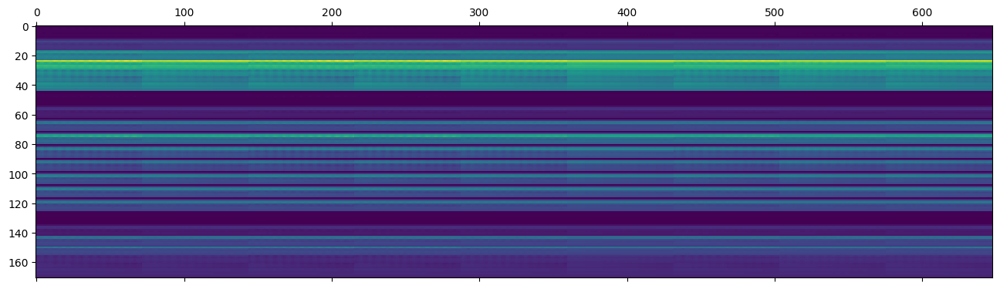

Flattening descriptors...
Scaling data...
Applying apply_pca...


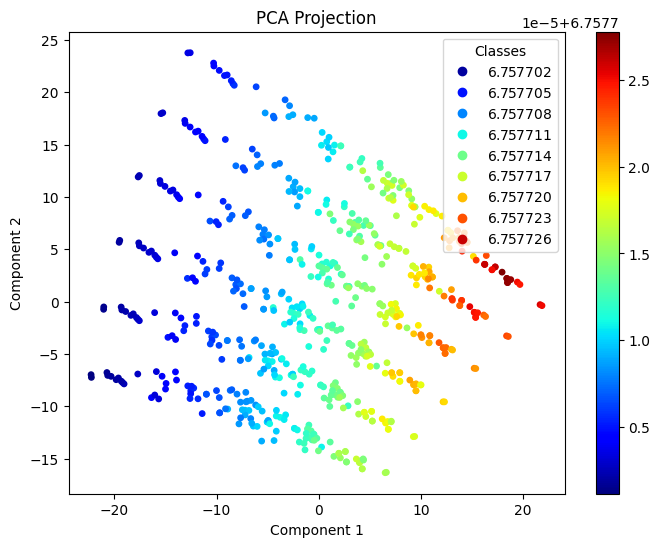

648it [00:00, 4460.23it/s]


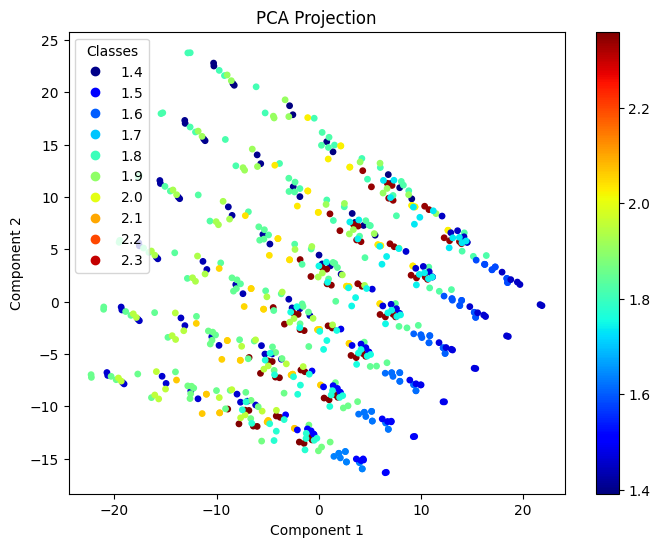

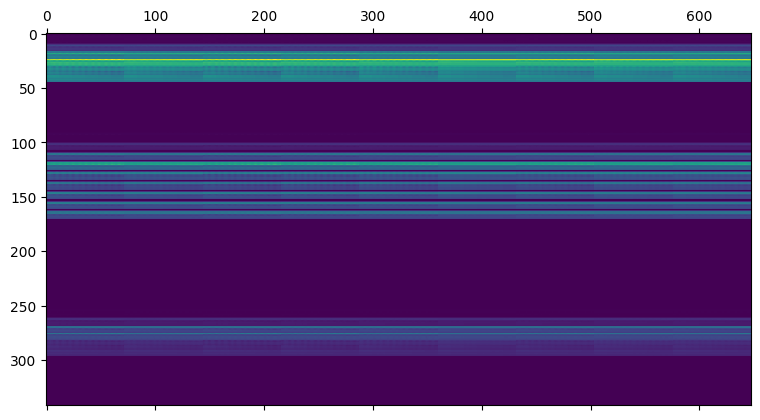

Flattening descriptors...
Scaling data...
Applying apply_pca...


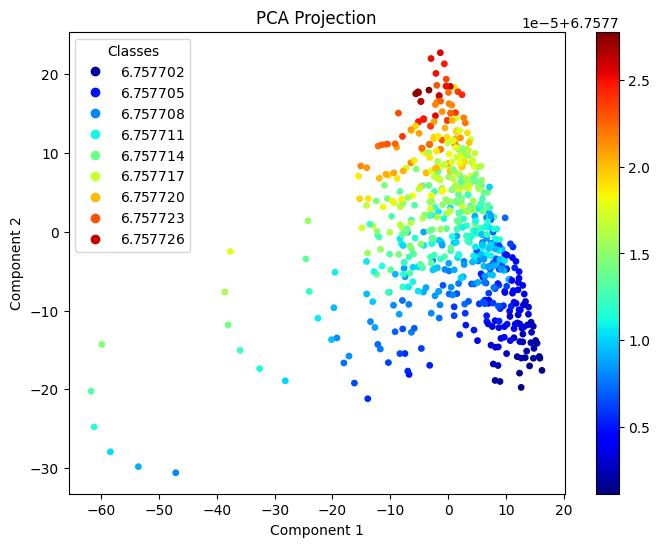

648it [00:00, 3463.71it/s]


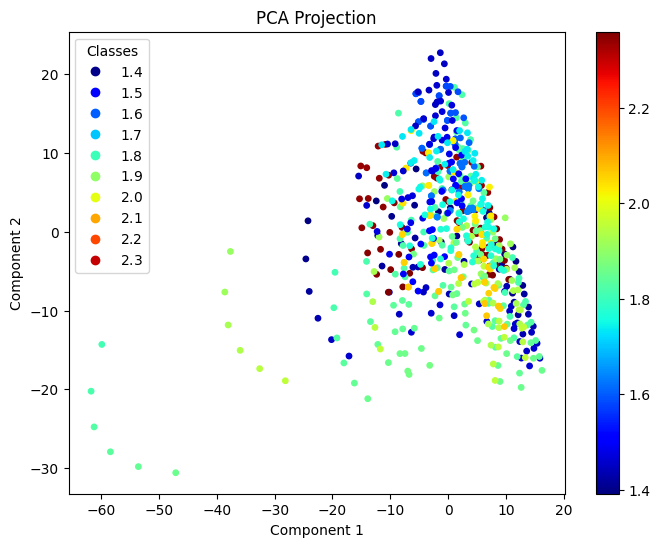

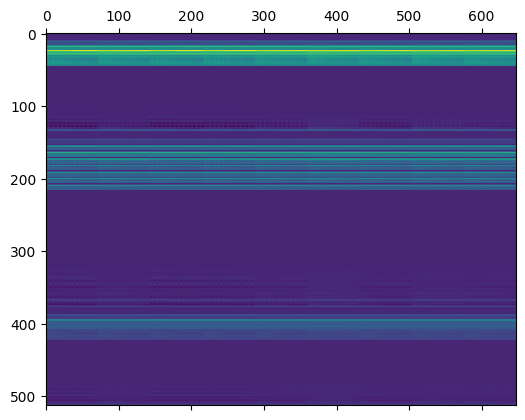

Flattening descriptors...
Scaling data...
Applying apply_pca...


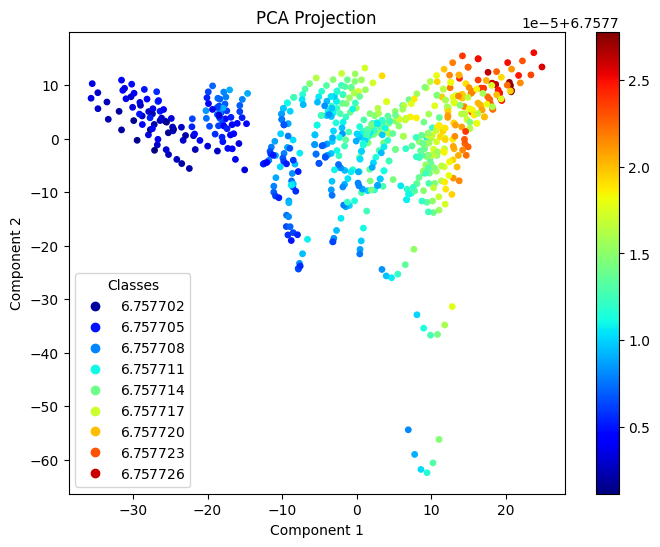

648it [00:00, 2660.89it/s]


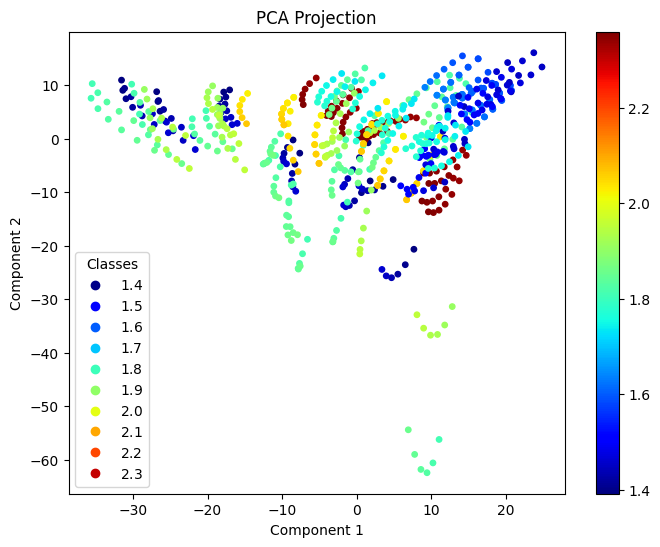

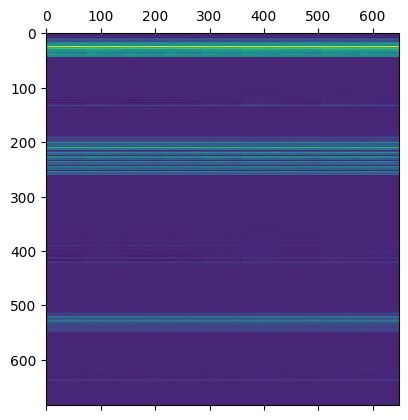

Flattening descriptors...
Scaling data...
Applying apply_pca...


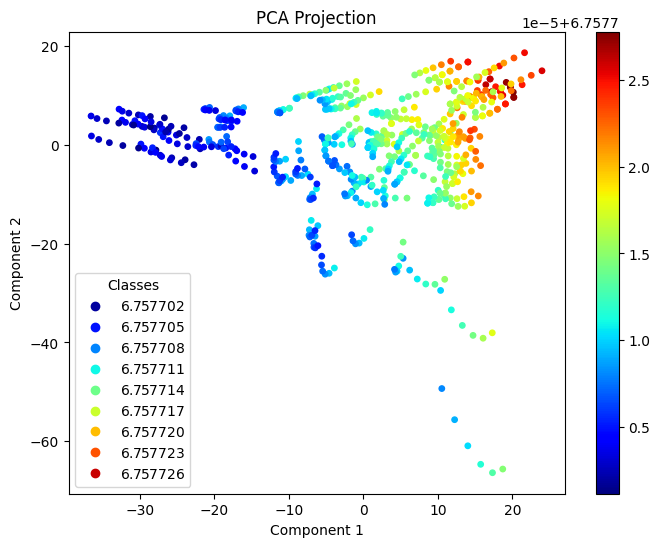

648it [00:00, 2038.87it/s]


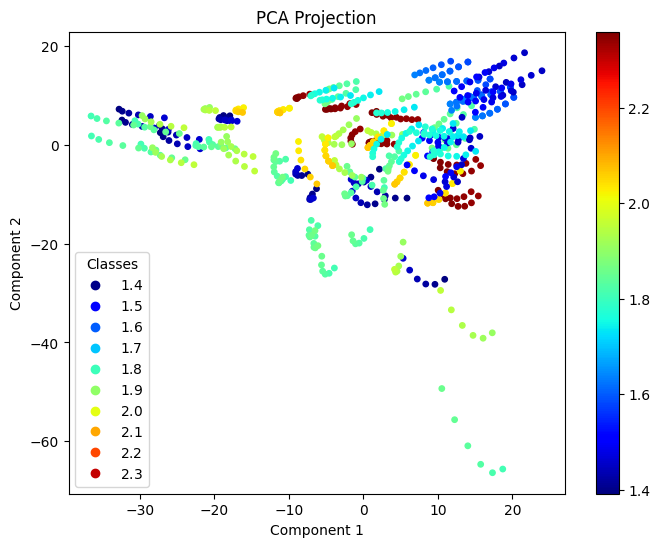

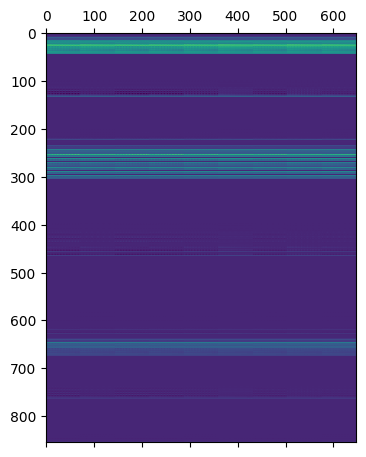

Flattening descriptors...
Scaling data...
Applying apply_pca...


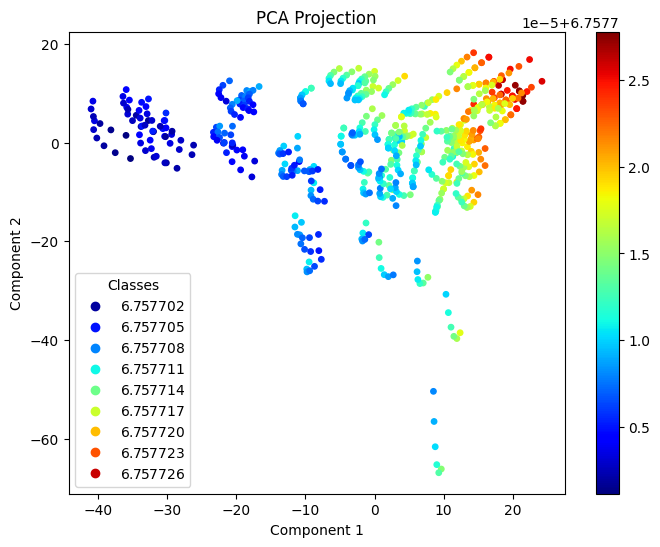

648it [00:00, 1678.18it/s]


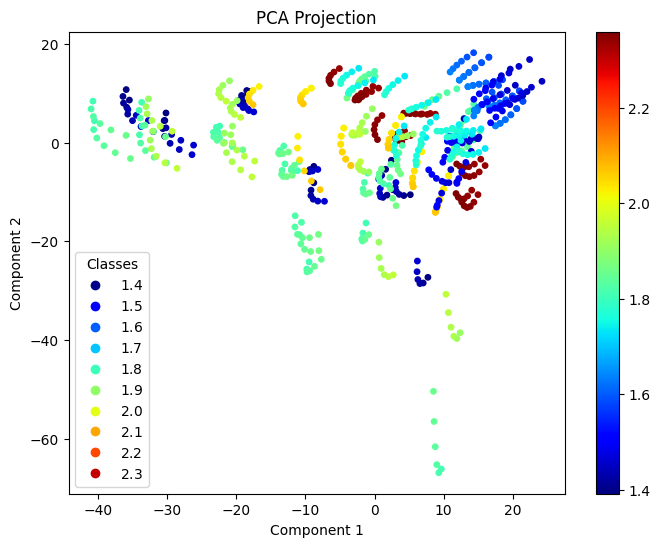

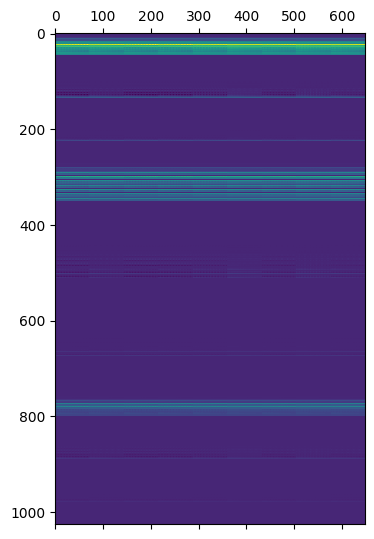

Flattening descriptors...
Scaling data...
Applying apply_pca...


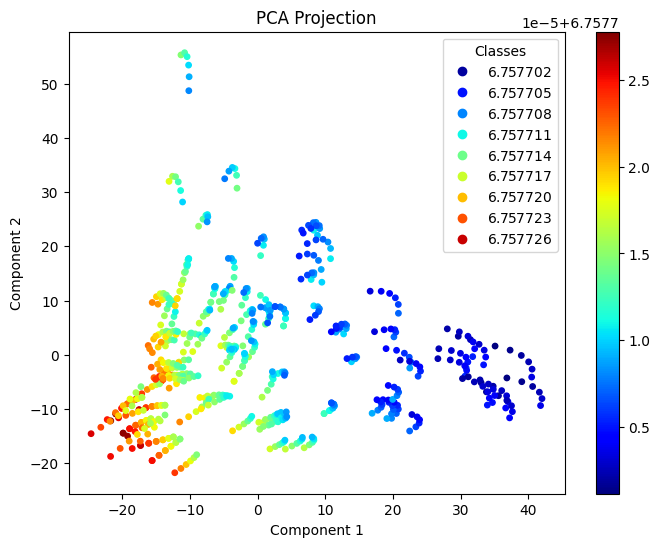

648it [00:00, 1331.20it/s]


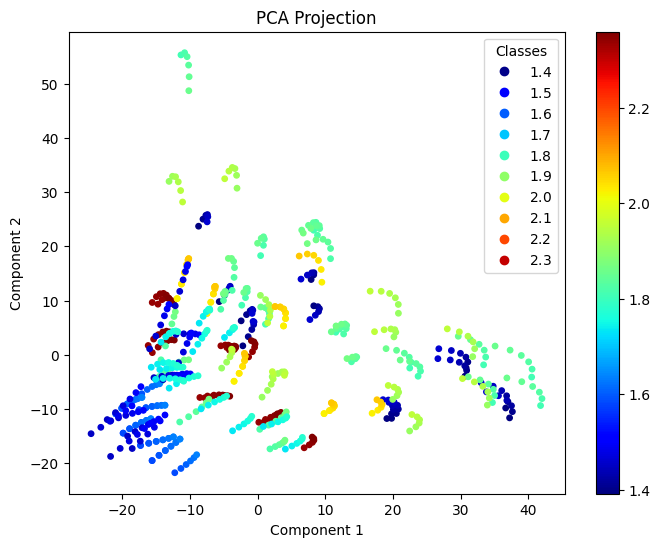

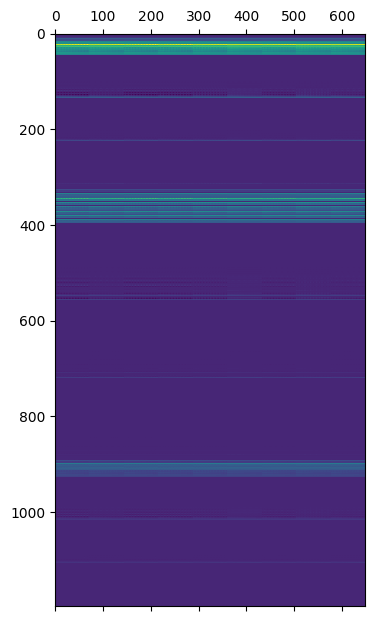

Flattening descriptors...
Scaling data...
Applying apply_pca...


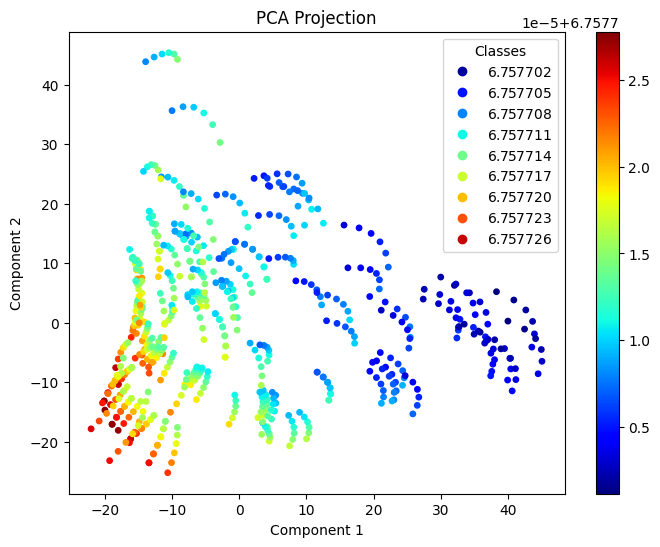

648it [00:00, 1125.81it/s]


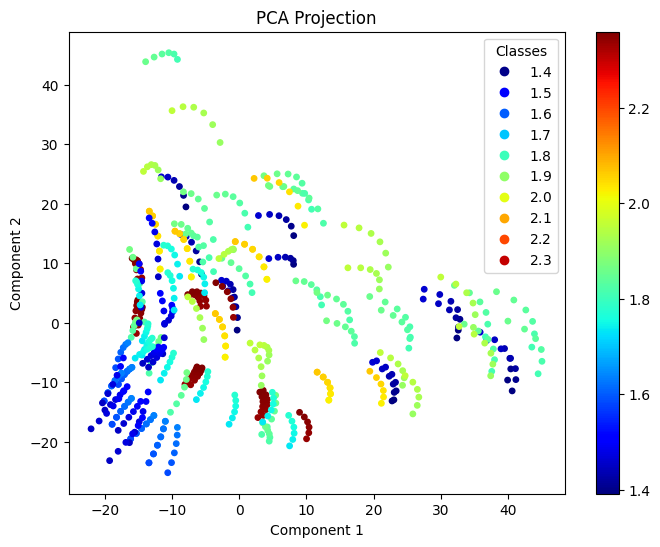

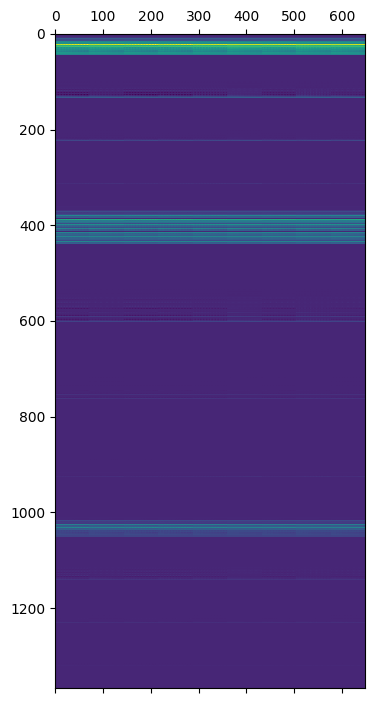

Flattening descriptors...
Scaling data...
Applying apply_pca...


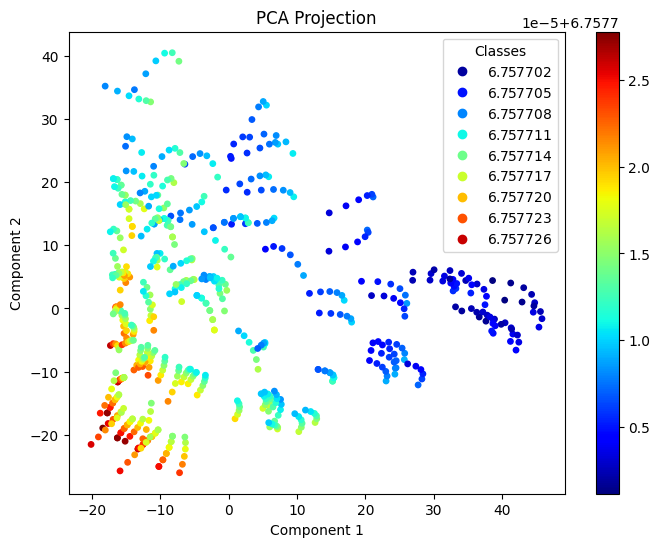

648it [00:00, 950.48it/s]


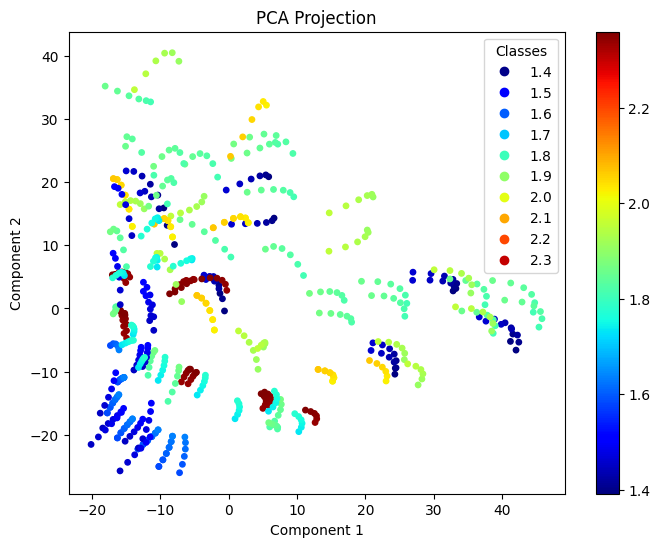

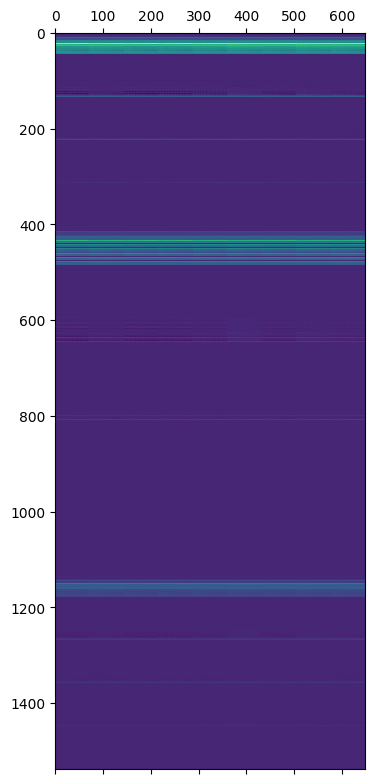

Flattening descriptors...
Scaling data...
Applying apply_pca...


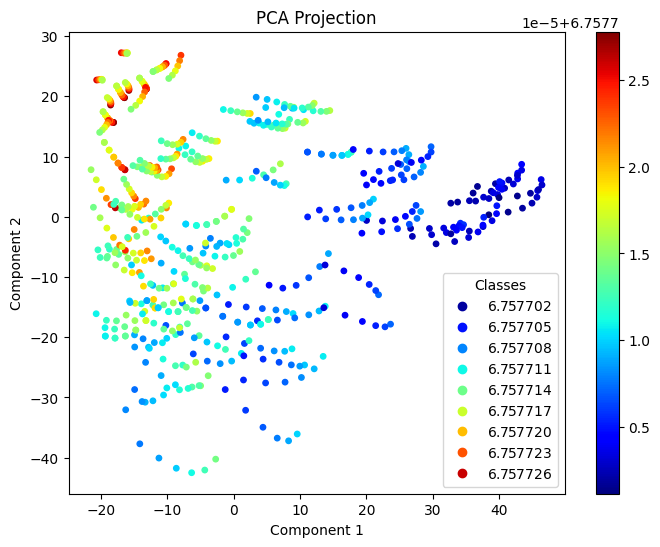

648it [00:00, 808.83it/s]


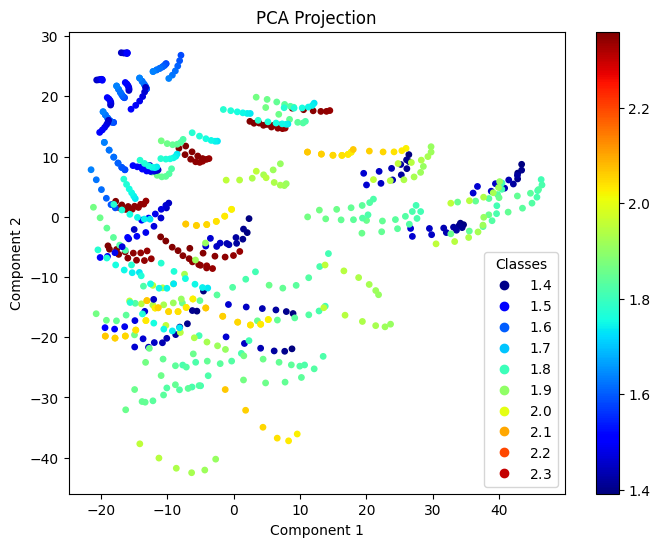

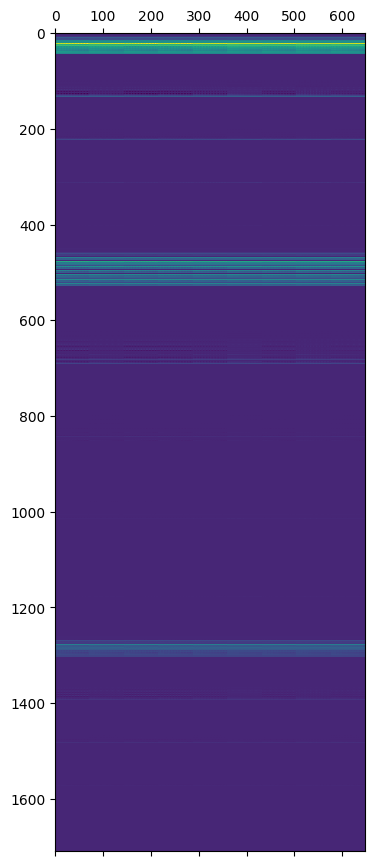

Flattening descriptors...
Scaling data...
Applying apply_pca...


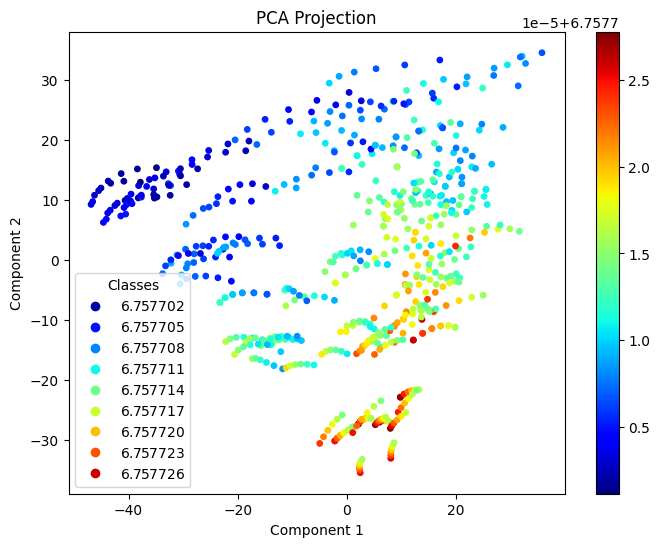

648it [00:00, 676.57it/s]


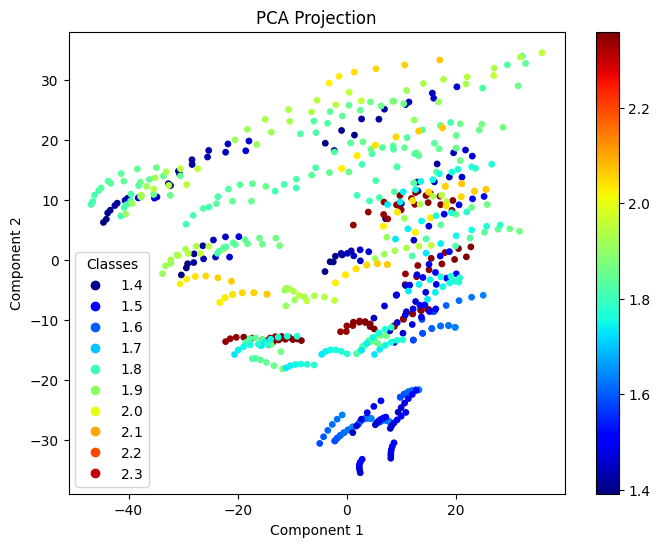

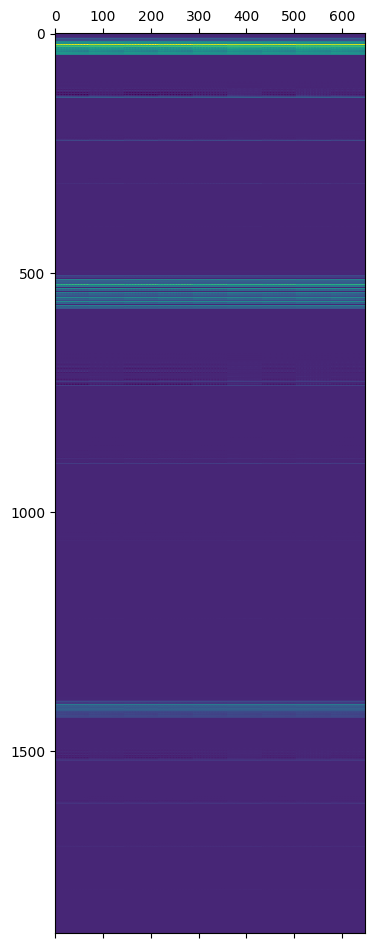

Flattening descriptors...
Scaling data...
Applying apply_pca...


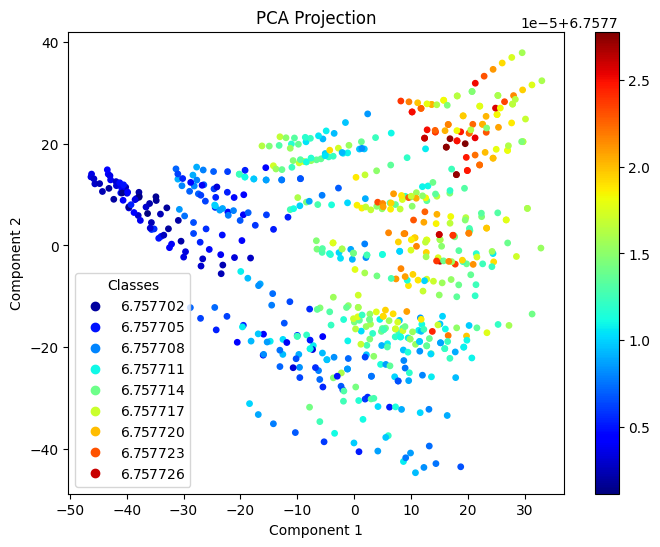

648it [00:01, 562.12it/s]


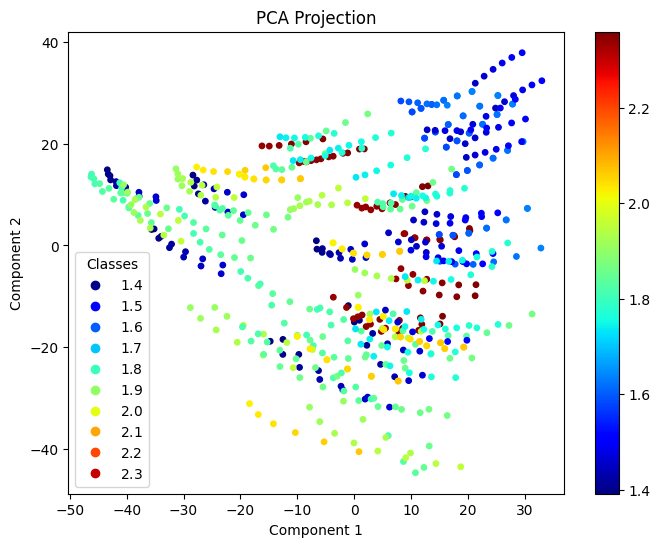

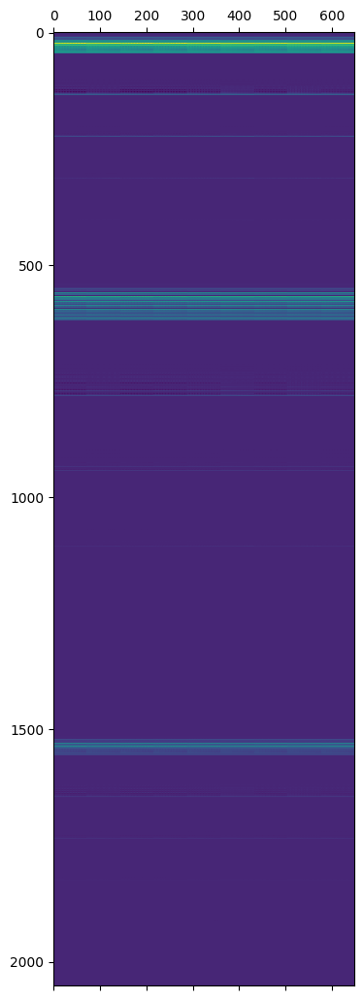

Flattening descriptors...
Scaling data...
Applying apply_pca...


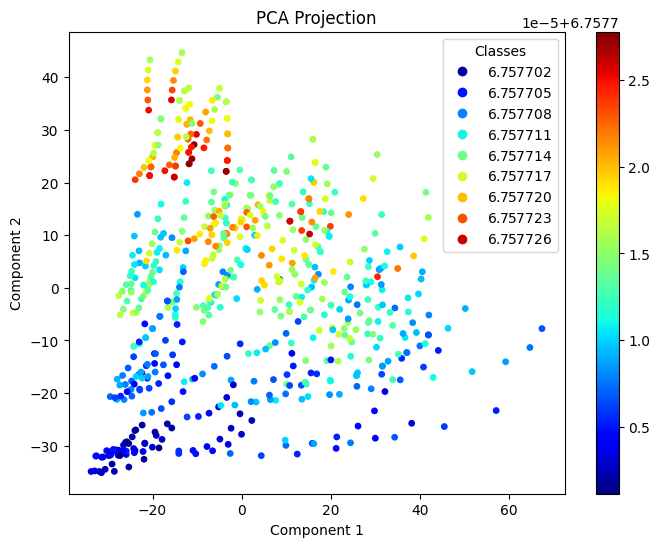

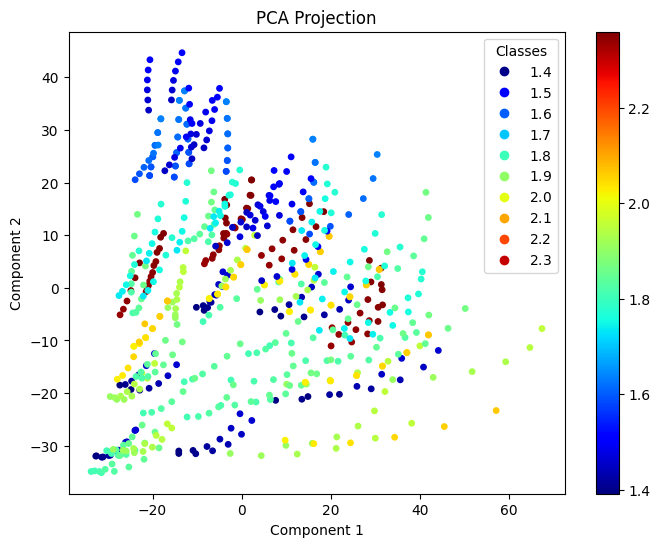

In [114]:
projections = []


for i in range(12):
    # coordinates = [sym_to_ase(_).get_positions() for _ in confs["C2"]]
    coordinates = [_.get_positions() for _ in all_atoms]
    coordinates = np.array(coordinates)
    C2_test_atoms = all_atoms[0]
    atomic_numbers = C2_test_atoms.get_atomic_numbers()
    atomic_numbers = np.array([atomic_numbers]*len(coordinates))
    atomic_numbers
    
    species = np.unique(np.concatenate([atomic_numbers]))
    # Apply PCA
    labels = None
    soap_descr, ase_atoms = compute_soap_descriptors(
        coordinates, atomic_numbers, species, 
        r_cut=20.0, n_max=9, l_max=i, sigma=1.0)
    
    # a_ = soap_descr.shape[1] // i 
    # b_ = soap_descr.shape[1] // a_
    # print(i // 2, i, a_,b_)
    # plt.matshow(soap_descr[0,:].reshape(a_, b_).T,
    #             cmap="cubehelix_r")
    # plt.colorbar()
    # plt.show()
    
    plt.matshow(soap_descr.T)
    plt.show()
    reduced_data_pca, model_pca = process_data(soap_descr, apply_pca, n_components=2)
    visualize_projection(reduced_data_pca,
                         [str(_) for _ in syms],
                         title="PCA Projection", 
                         c=np.log(np.abs(energies))
                        )
    # plt.clim(6.7535, 6.76)
    plt.show()
    visualize_projection(reduced_data_pca,
                         [str(_) for _ in syms],
                         title="PCA Projection", 
                         c=np.log(np.abs(rog))
                        )
    projections.append(reduced_data_pca)
    

In [128]:

# s = plt.scatter(df_["PCA1"], df_["PCA2"], c=df_["E"], s=1)
# for i, _ in enumerate(df_["syms"]):
#     if str(_) != "C1":
#         plt.text(df_["PCA1"].iloc[i], df_["PCA2"].iloc[i], _, alpha=0.4)
# plt.colorbar(s)
# plt.show()
# s = plt.scatter(df_["PCA1"], df_["PCA2"], c=df_["ROG"], s=1)
# for i, _ in enumerate(df_["syms"]):
#     if str(_) != "C1":
#         plt.text(df_["PCA1"].iloc[i], df_["PCA2"].iloc[i], _, alpha=0.4)
# plt.colorbar()
# plt.show()
# s = plt.scatter(df_["PCA1"], df_["PCA2"], c=df_["abp"], s=1)
# for i, _ in enumerate(df_["syms"]):
#     if str(_) != "C1":
#         plt.text(df_["PCA1"].iloc[i], df_["PCA2"].iloc[i], _, alpha=0.4)
# plt.colorbar()

# plt.show()
# s = plt.scatter(df_["PCA1"], df_["PCA2"], c=df_["com_dists"], s=1)
# for i, _ in enumerate(df_["syms"]):
#     if str(_) != "C1":
#         plt.text(df_["PCA1"].iloc[i], df_["PCA2"].iloc[i], _, alpha=0.4)
# plt.colorbar()

In [130]:
def annotate_mean(data, **kwargs):
    ax = plt.gca()
# df.keys()

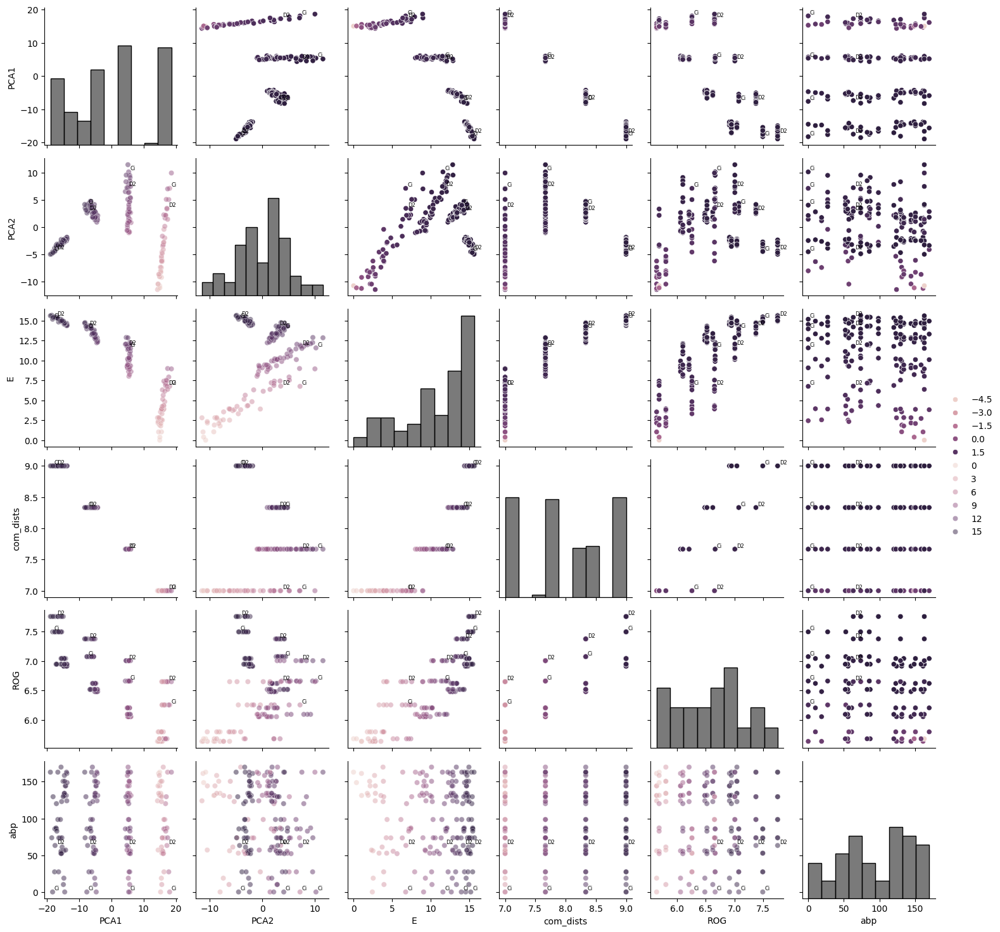

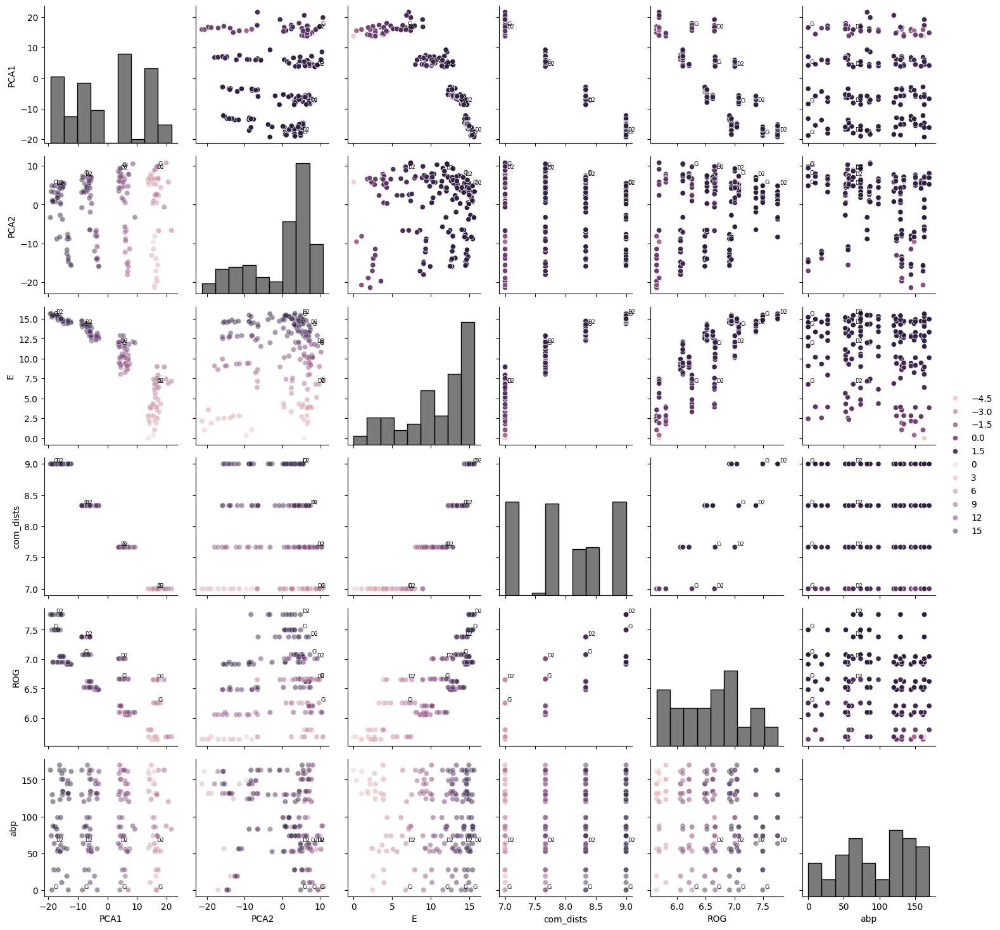

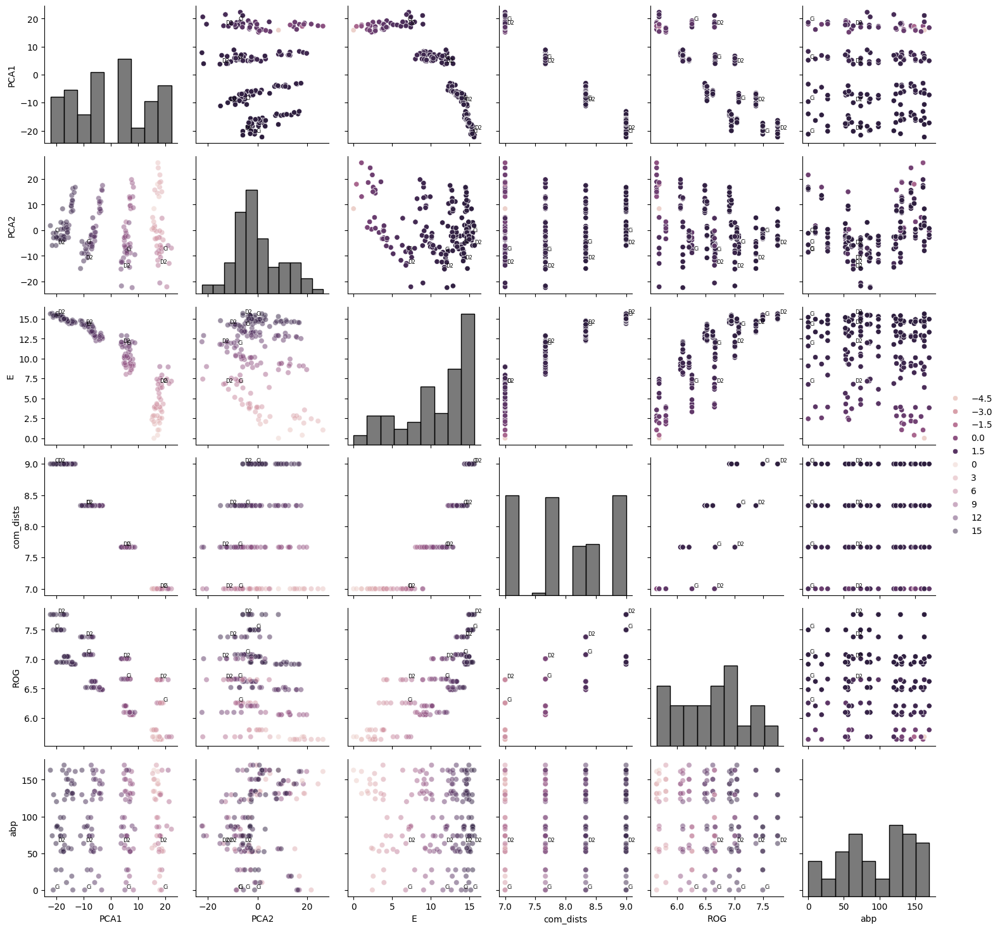

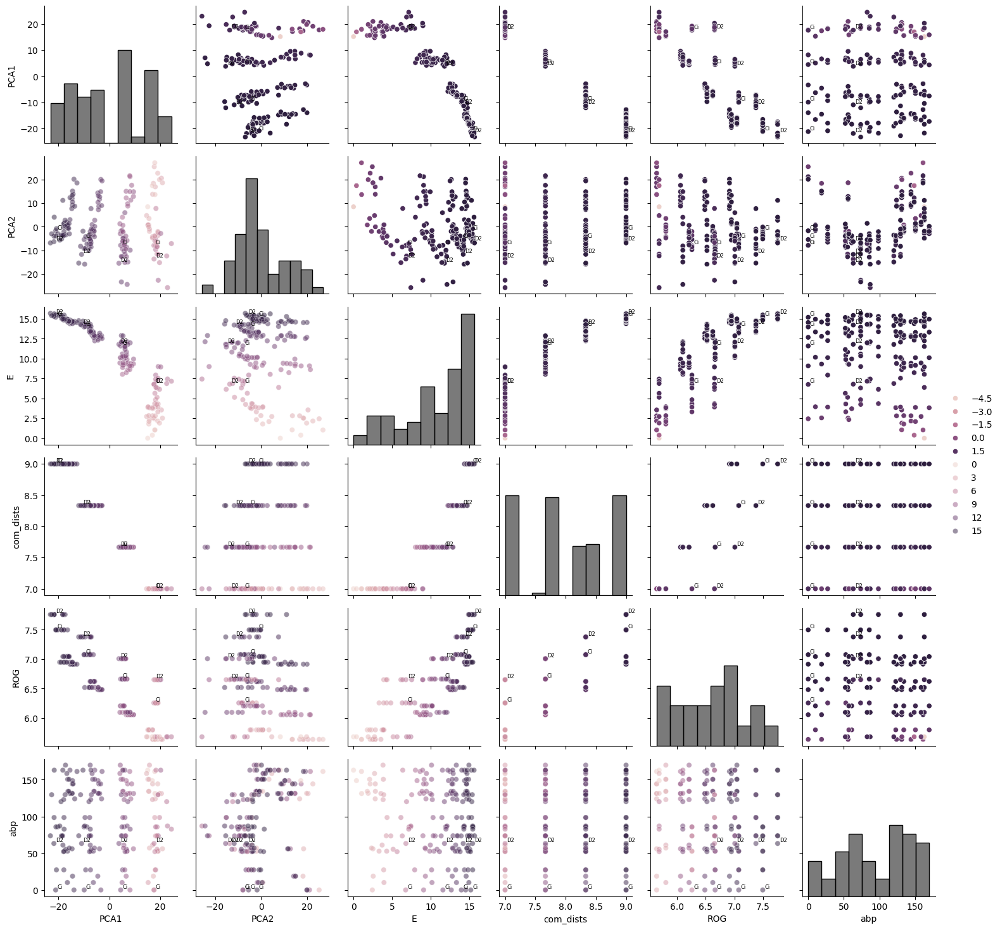

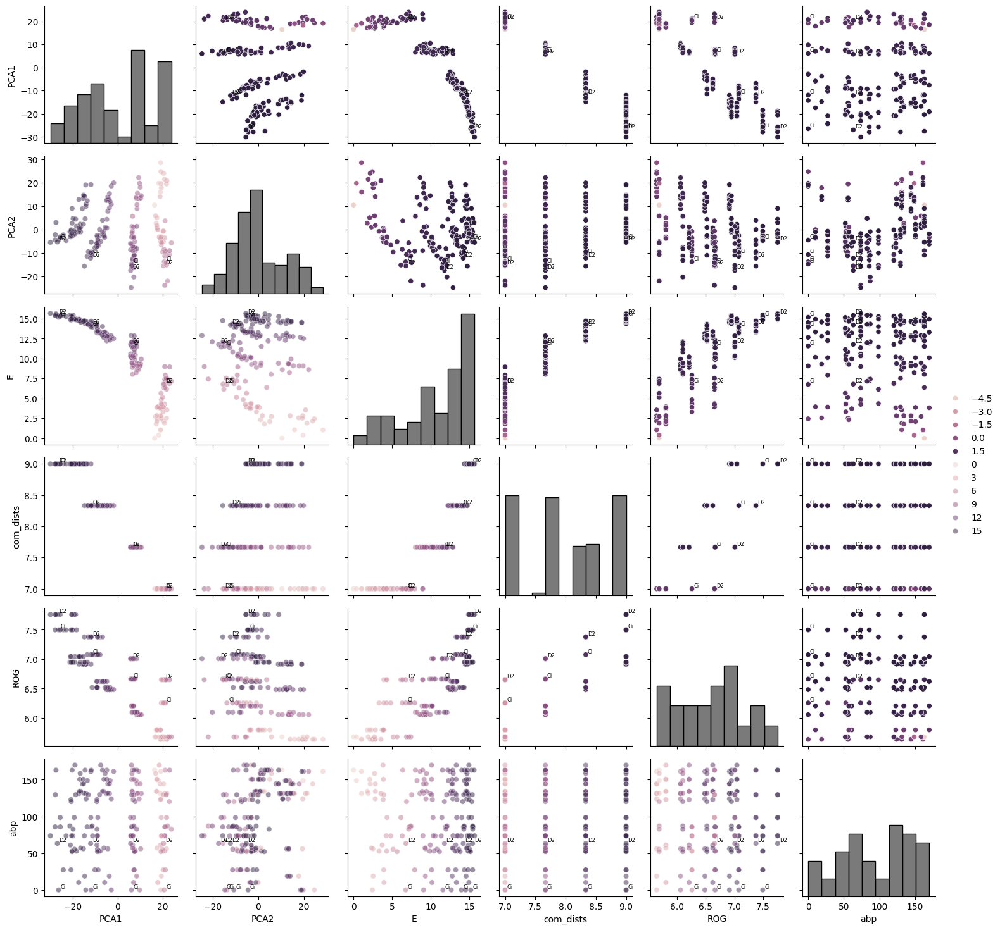

...

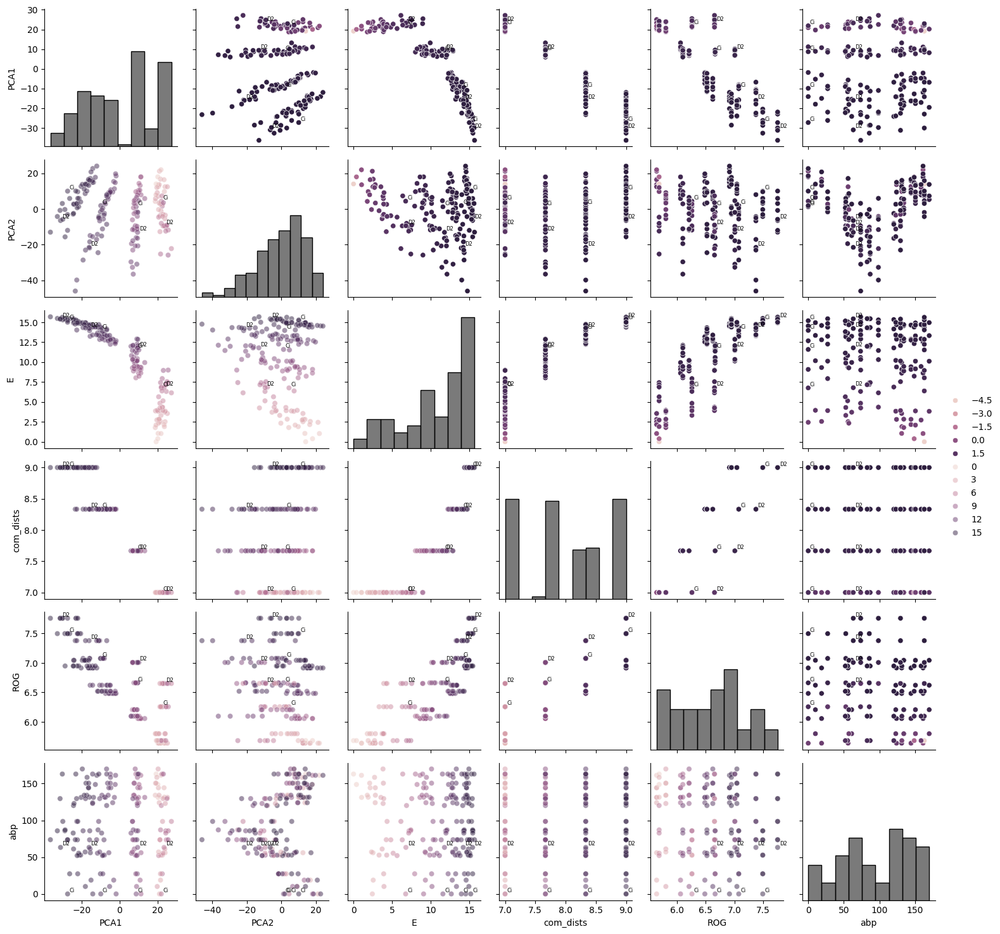

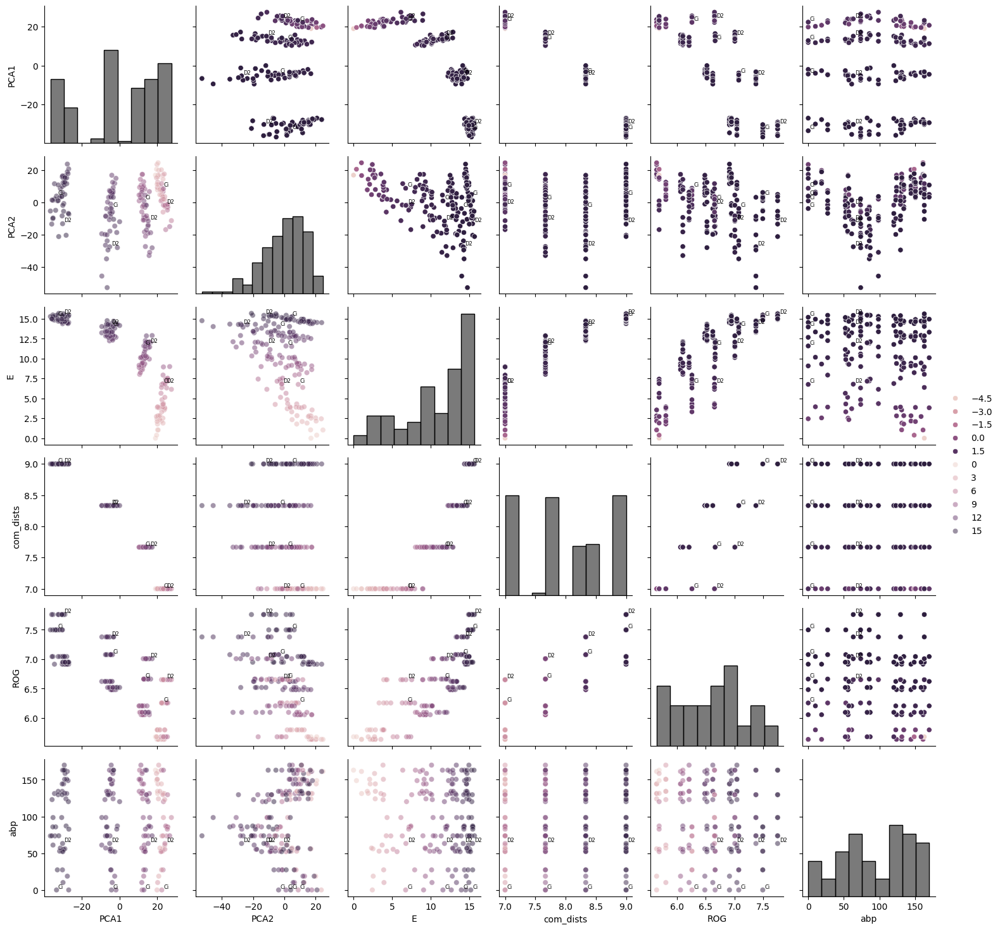

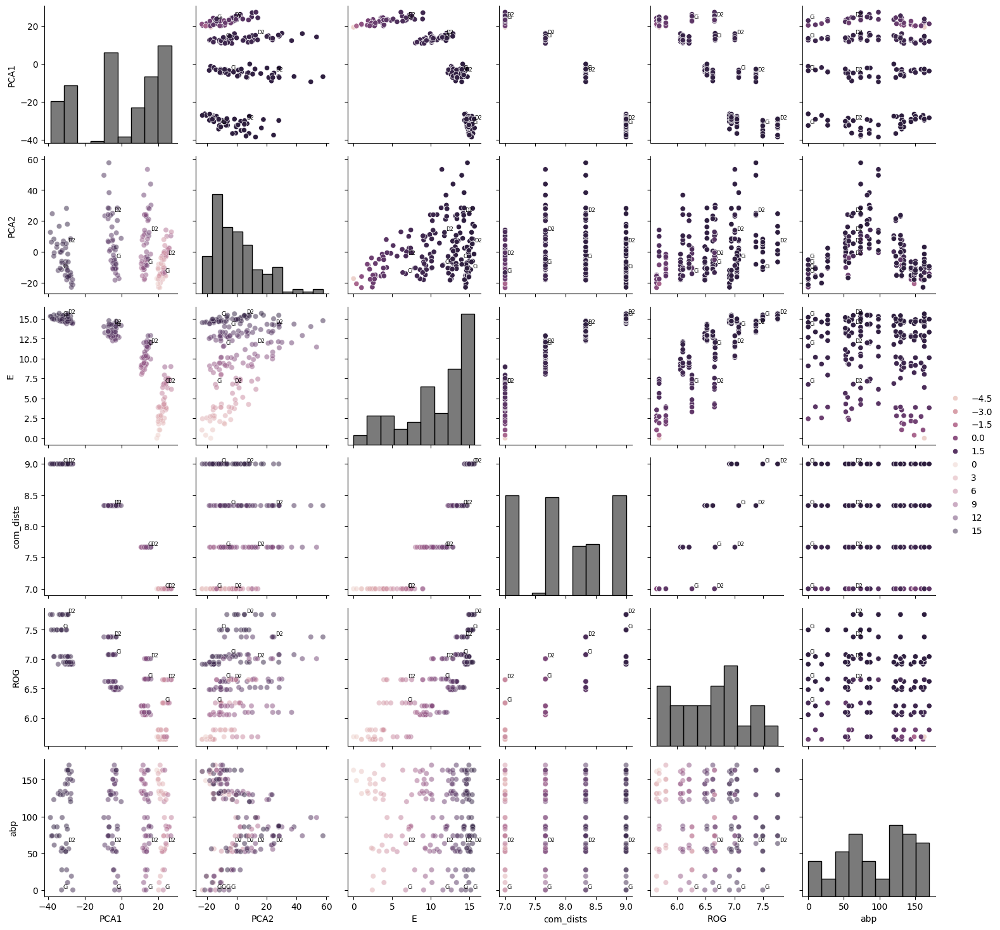

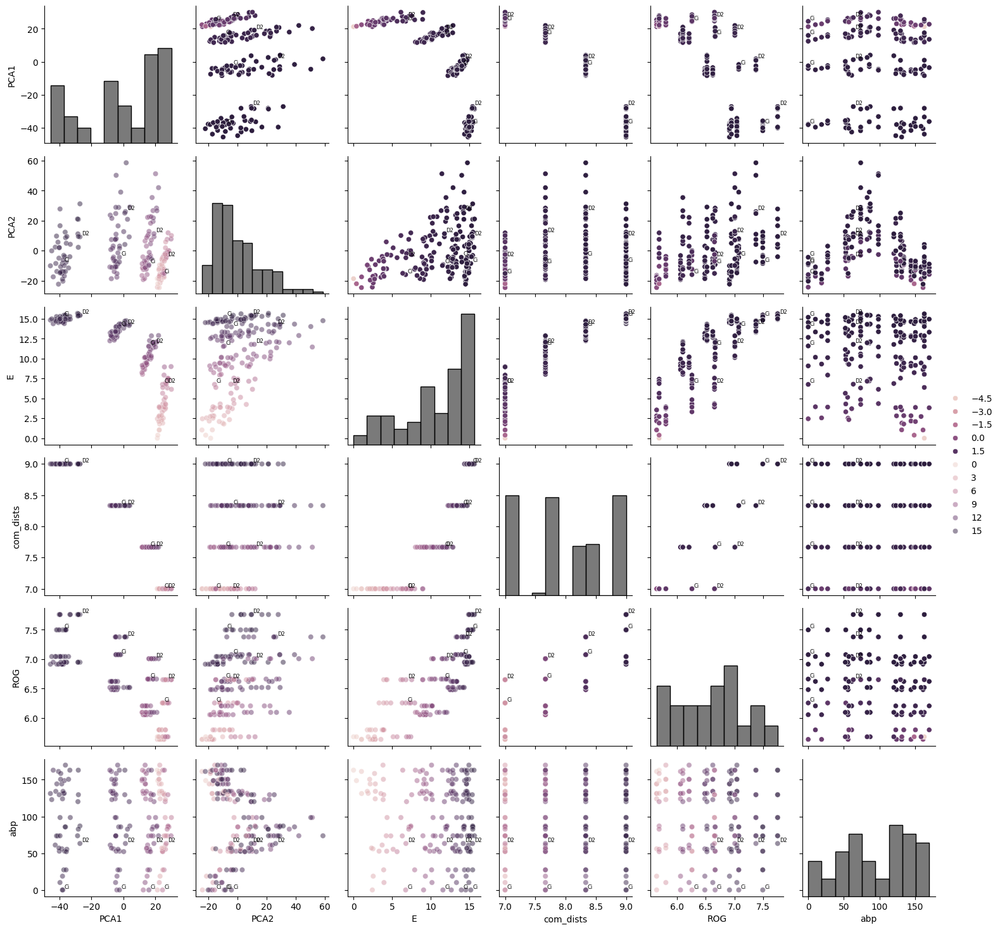

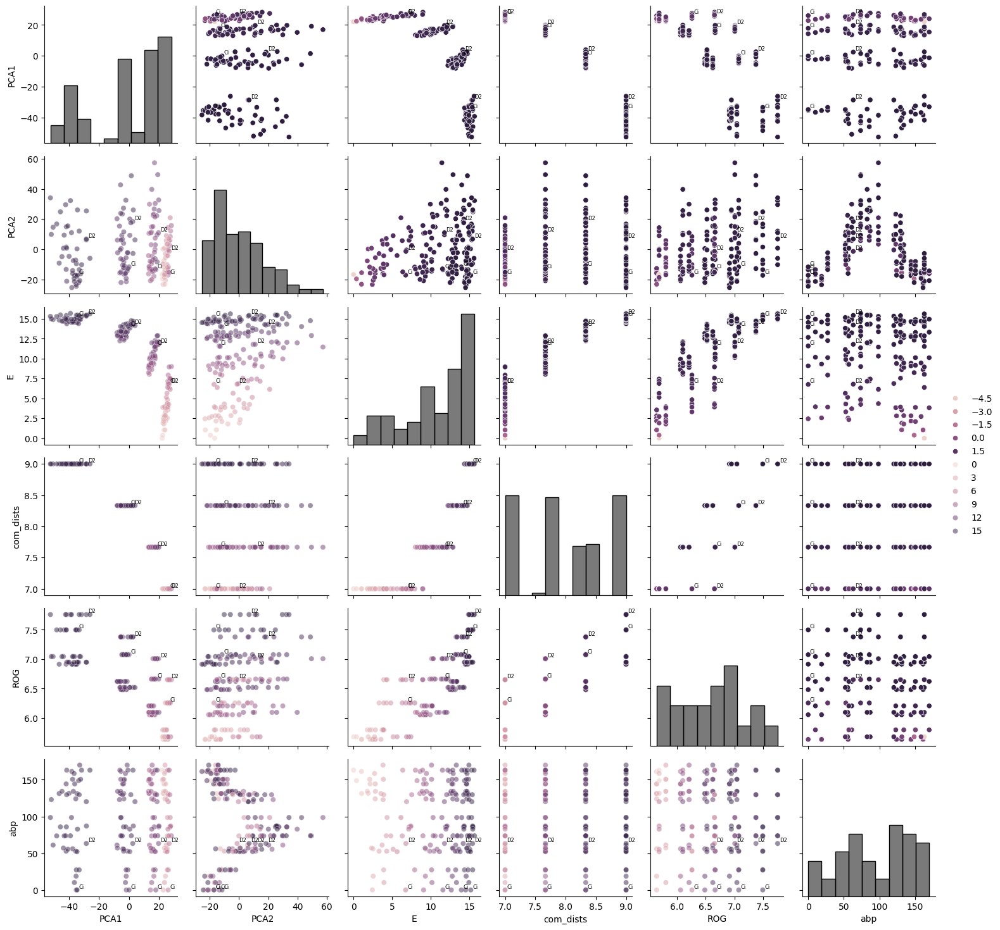

In [131]:
import seaborn as sns

N = 5
for N in range(12):
    df = pd.DataFrame(
        {
            "PCA1": projections[N][:, 0], 
         "PCA2": projections[N][:,1], 
            "com_dists":com_dists,
         "E": energies, "ROG":rog, "syms": syms, "abp": angles_betw_plane
        })
    # df["E"] = df["E"] - df["E"].min()
    # df_ = df[df["E"] > df["E"].median()]
    # df_["E"] = -np.log(df_["E"])
    df_ = df
    df_ = df_[df_["ROG"] > 10]
    df_ = df_[df_["abp"] != 0]
    df_ = df_.sort_values("E")
    df_
    
    
    df["syms"] = [str(_) for _ in df["syms"]]
    # df_ = df[df["E"] < -857.59]
    df_ = df[['PCA1', 'PCA2', 'E','com_dists', 'ROG', 'syms', 'abp']].copy()
    df_["E"] = (df_["E"] - df_["E"].min())*627.5
    df_ = df_[df_["E"] < 60]
    
    def annotate_points(df_):
        def annotate_points(a, b, **kwargs):
            # print(data)
            # print(_)
            ax = plt.gca()
            for i, (xx, yy) in enumerate(zip(a, b)):
                label = df_.iloc[i]['syms']  # annotate with island name
                if label != "C1":
                    ax.annotate(label,
                                xy=(xx, yy),
                                xytext=(2, 2),
                                textcoords='offset points',
                                fontsize=6,
                                alpha=1)
        return annotate_points
    
    
    g = sns.PairGrid(df_)
    # g.map(sns.scatterplot)
    g.map_diag(sns.histplot, hue=None, color=".3")
    g.map_upper(sns.scatterplot, hue=np.log(df_["E"]+0.01), alpha=1)
    g.map_lower(sns.scatterplot, hue=df_["E"], alpha=0.5)
    g.map_lower(annotate_points(df_))
    # g.map_lower(sns.scatterplot, hue=df_["E"], alpha=0.5)
    g.map_upper(annotate_points(df_))
    # g.pipe(annotate_labels) 
    g.add_legend()
# dir(g)

In [132]:
df_ = df_.sort_values("E")
df_

,PCA1,PCA2,E,com_dists,ROG,syms,abp
72,22.108120,-16.646139,0.000000,7.0,5.681724,C1,163.001304
76,22.411340,-19.535502,0.381759,7.0,5.681724,C1,148.779890
8,24.024988,-23.067979,1.032351,7.0,5.637845,C1,161.234122
3,23.405626,-15.427905,1.048352,7.0,5.637845,C1,131.236785
110,23.255490,-7.633323,1.787509,7.0,5.799253,C1,134.178144
...,...,...,...,...,...,...,...
101,-28.469917,25.411462,15.455386,9.0,6.948524,C1,87.046114
105,-34.428618,26.076229,15.467676,9.0,6.948524,C1,82.735872
68,-45.820254,24.807157,15.491449,9.0,7.498008,C1,85.808640
176,-26.114957,-5.931355,15.634871,9.0,7.759048,C1,162.994677


In [133]:
view_atoms(all_atoms[df_.index[-10]])

In [134]:

from statsmodels.base.model import LikelihoodModel
from statsmodels.regression.linear_model import OLS
from statsmodels.multivariate.manova import MANOVA
from statsmodels.multivariate.multivariate_ols import _MultivariateOLS

import statsmodels.multivariate.tests.results as path

formula = "PCA1 + PCA2 ~ E"
mod = _MultivariateOLS.from_formula(formula, data=df_)
res = mod.fit()
# dir(res)
# res.mv_test().summary_frame
# res.design_info
res.mv_test().summary_frame

Value Num DF Den DF     F Value Pr > F
Effect    Statistic                                                        
Intercept Wilks' lambda           0.359159      2  177.0  157.908742    0.0
          Pillai's trace          0.640841    2.0  177.0  157.908742    0.0
          Hotelling-Lawley trace   1.78428      2  177.0  157.908742    0.0
          Roy's greatest root      1.78428      2    177  157.908742    0.0
E         Wilks' lambda           0.326067      2  177.0  182.916736    0.0
          Pillai's trace          0.673933    2.0  177.0  182.916736    0.0
          Hotelling-Lawley trace  2.066856      2  177.0  182.916736    0.0
          Roy's greatest root     2.066856      2    177  182.916736    0.0

In [137]:
N = 5
formula = "PCA1  ~ E"
for N in range(12):
    df = pd.DataFrame(
        {
            "PCA1": projections[N][:, 0], 
         "PCA2": projections[N][:,1], 
            "com_dists":com_dists,
         "E": energies, "ROG":rog, "syms": syms, "abp": angles_betw_plane
        })
    # df["E"] = df["E"] - df["E"].min()
    # df_ = df[df["E"] > df["E"].median()]
    # df_["E"] = -np.log(df_["E"])
    df_ = df
    df_ = df_[df_["ROG"] > 10]
    df_ = df_[df_["abp"] != 0]
    df_ = df_.sort_values("E")

    df["syms"] = [str(_) for _ in df["syms"]]
    # df_ = df[df["E"] < -857.59]
    df_ = df[['PCA1', 'PCA2', 'E','com_dists', 'ROG', 'syms', 'abp']].copy()
    df_["E"] = (df_["E"] - df_["E"].min())*627.5
    # df_ = df_[df_["E"] < 30]
    
    ols = OLS.from_formula(formula, data=df_)
    print(ols.fit().summary())

                            OLS Regression Results                            
Dep. Variable:                   PCA1   R-squared:                       0.821
Model:                            OLS   Adj. R-squared:                  0.820
Method:                 Least Squares   F-statistic:                     816.9
Date:                Sat, 21 Jun 2025   Prob (F-statistic):           2.01e-68
Time:                        16:44:21   Log-Likelihood:                -546.05
No. Observations:                 180   AIC:                             1096.
Df Residuals:                     178   BIC:                             1102.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     27.0578      1.019     26.556      0.0

In [138]:
for N in range(12):
    df = pd.DataFrame(
        {
            "PCA1": projections[N][:, 0], 
         "PCA2": projections[N][:,1], 
            "com_dists":com_dists,
         "E": energies, "ROG":rog, "syms": syms, "abp": angles_betw_plane
        })
    # df["E"] = df["E"] - df["E"].min()
    # df_ = df[df["E"] > df["E"].median()]
    # df_["E"] = -np.log(df_["E"])
    df_ = df
    df_ = df_[df_["ROG"] > 10]
    df_ = df_[df_["abp"] != 0]
    df_ = df_.sort_values("E")

    df["syms"] = [str(_) for _ in df["syms"]]
    # df_ = df[df["E"] < -857.59]
    df_ = df[['PCA1', 'PCA2', 'E','com_dists', 'ROG', 'syms', 'abp']].copy()
    df_["E"] = (df_["E"] - df_["E"].min())*627.5
    # df_ = df_[df_["E"] < 30]
    
    formula = "PCA1 + PCA2 ~ E"
    mod = _MultivariateOLS.from_formula(formula, data=df_)
    res = mod.fit()
    # dir(res)
    # res.mv_test().summary_frame
    # res.design_info
    print(res.mv_test().summary_frame)

                                      Value Num DF Den DF      F Value Pr > F
Effect    Statistic                                                          
Intercept Wilks' lambda            0.015346      2  177.0  5678.355414    0.0
          Pillai's trace           0.984654    2.0  177.0  5678.355414    0.0
          Hotelling-Lawley trace  64.162208      2  177.0  5678.355414    0.0
          Roy's greatest root     64.162208      2    177  5678.355414    0.0
E         Wilks' lambda            0.013276      2  177.0  6577.636076    0.0
          Pillai's trace           0.986724    2.0  177.0  6577.636076    0.0
          Hotelling-Lawley trace  74.323571      2  177.0  6577.636076    0.0
          Roy's greatest root     74.323571      2    177  6577.636076    0.0
                                     Value Num DF Den DF     F Value Pr > F
Effect    Statistic                                                        
Intercept Wilks' lambda           0.201028      2  177.0  351.737743

In [139]:
for N in range(12):
    df = pd.DataFrame(
        {
            "PCA1": projections[N][:, 0], 
         "PCA2": projections[N][:,1], 
            "com_dists":com_dists,
         "E": energies, "ROG":rog, "syms": syms, "abp": angles_betw_plane
        })
    # df["E"] = df["E"] - df["E"].min()
    # df_ = df[df["E"] > df["E"].median()]
    # df_["E"] = -np.log(df_["E"])
    df_ = df
    df_ = df_[df_["ROG"] > 10]
    df_ = df_[df_["abp"] != 0]
    df_ = df_.sort_values("E")

    df["syms"] = [str(_) for _ in df["syms"]]
    # df_ = df[df["E"] < -857.59]
    df_ = df[['PCA1', 'PCA2', 'E','com_dists', 'ROG', 'syms', 'abp']].copy()
    df_["E"] = (df_["E"] - df_["E"].min())*627.5
    df_ = df_[df_["E"] < 30]
    
    formula = "PCA1 + PCA2 + ROG + com_dists + abp ~ E"
    mod = _MultivariateOLS.from_formula(formula, data=df_)
    res = mod.fit()
    # dir(res)
    # res.mv_test().summary_frame
    # res.design_info
    print(res.mv_test().summary_frame)

                                       Value Num DF Den DF       F Value  \
Effect    Statistic                                                        
Intercept Wilks' lambda             0.000423      5  174.0  82266.491127   
          Pillai's trace            0.999577    5.0  174.0  82266.491127   
          Hotelling-Lawley trace  2363.97963      5  174.0  82266.491127   
          Roy's greatest root     2363.97963      5    174  82266.491127   
E         Wilks' lambda             0.012503      5  174.0   2748.484383   
          Pillai's trace            0.987497    5.0  174.0   2748.484383   
          Hotelling-Lawley trace   78.979436      5  174.0   2748.484383   
          Roy's greatest root      78.979436      5    174   2748.484383   

                                 Pr > F  
Effect    Statistic                      
Intercept Wilks' lambda             0.0  
          Pillai's trace            0.0  
          Hotelling-Lawley trace    0.0  
          Roy's greatest root

In [140]:
x.shape

(15,)

In [141]:
# odr?

In [118]:
# from scipy import odr

# import numpy as np

# x = np.linspace(0.0, 5.0)

# y = 10.0 + 5.0 * x

# data = odr.Data(df_[["PCA1"]].to_numpy(), df_[["E"]].to_numpy())

# odr_obj = odr.ODR(data, odr.multilinear)

# output = odr_obj.run()

# print(output.beta)

from sklearn import linear_model

reg = linear_model.LinearRegression()
res = reg.fit(df_[["PCA1","PCA2"]].to_numpy(), df_[["E"]].to_numpy())
res.coef_, res.intercept_

(array([[-0.34276871,  0.0446444 ]]), array([8.19146325]))

In [119]:
import numpy as np
from sklearn.linear_model import SGDRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor

for N in range(12):
    df = pd.DataFrame(
        {
            "PCA1": projections[N][:, 0], 
         "PCA2": projections[N][:,1], 
            "com_dists":com_dists,
         "E": energies, "ROG":rog, "syms": syms, "abp": angles_betw_plane
        })
    # df["E"] = df["E"] - df["E"].min()
    # df_ = df[df["E"] > df["E"].median()]
    # df_["E"] = -np.log(df_["E"])
    df_ = df
    df_ = df_[df_["ROG"] > 10]
    df_ = df_[df_["abp"] != 0]
    df_ = df_.sort_values("E")

    df["syms"] = [str(_) for _ in df["syms"]]
    # df_ = df[df["E"] < -857.59]
    df_ = df[['PCA1', 'PCA2', 'E','com_dists', 'ROG', 'syms', 'abp']].copy()
    df_["E"] = (df_["E"] - df_["E"].min())*627.5
    df_ = df_[df_["E"] < 60]
    
    # formula = "PCA1 + PCA2 + ROG + com_dists + abp ~ E"
    # mod = _MultivariateOLS.from_formula(formula, data=df_)
    # res = mod.fit()
    # # dir(res)
    # # res.mv_test().summary_frame
    # # res.design_info
    # print(res.mv_test().summary_frame)

    rng = np.random.RandomState(10)
    
    X,y = df_[["PCA1",
               "PCA2",
               "com_dists","ROG", "abp"
              ]].to_numpy(), df_[["E"]].to_numpy()
    
    # Always scale the input. The most convenient way is to use a pipeline.
    
    reg1 = SGDRegressor(max_iter=10000, tol=1e-3)
    reg2 = linear_model.Ridge(alpha=0.1)
    reg3 = linear_model.Lasso(alpha=0.1)
    reg4 = MLPRegressor(random_state=0, max_iter=100000, tol=0.00001)
    # reg.fit(X,y)
    for reg in [reg1, reg2,reg3,reg4]:
        reg = make_pipeline(StandardScaler(),reg)
        reg.fit(X, y)
        yPred = reg.predict(X)
        MAE = np.mean(np.abs(yPred - y[:,0]))
        RMSE = np.sqrt(np.mean((yPred - y[:,0])**2))
        print(N,MAE,RMSE,)
    print()

/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


0 0.4917925772130814 0.6186983312315172
0 0.46177091589278896 0.5856782759158382
0 0.5302602795140342 0.6753569049004856
0 0.26344344107480805 0.371455839540923

1 0.5630501175559599 0.7167941370732567
1 0.5630662011140389 0.7166759152709467
1 0.5974451625335743 0.7653177049922637


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


1 0.23588555446138298 0.3345791758747981

2 0.4845023913404539 0.5994574192018219
2 0.4844212439041906 0.5994200396613362
2 0.49607956973159906 0.6263606838597803


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


2 0.1770558270139353 0.25042653489929245

3 0.4724422171044535 0.5884136886796301
3 0.47250941555120307 0.5883476029973667
3 0.4887975203788872 0.6176652809970264


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


3 0.2084463141492088 0.29539067972834887

4 0.5622467136993128 0.707616197679464
4 0.5622700422582286 0.707556058442278
4 0.5832720499617018 0.7371130924998622


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


4 0.19636618856931665 0.2689405548721676

5 0.5143432458939211 0.6455451687784309
5 0.5148037313962689 0.6454874281190908
5 0.5378090224291806 0.6777213833145134


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


5 0.16708353327090994 0.2251256904585804

6 0.5436144949879815 0.6921521376529344
6 0.5435412543667182 0.6920832978918254
6 0.5717442487037857 0.722346853390972


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


6 0.17486662000007522 0.23053657292403015

7 0.5223002238803046 0.6741412310449634
7 0.521596936041847 0.6740543884141047
7 0.5558466559763725 0.7063135090497812


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


7 0.15985844902919288 0.2189389398758921

8 0.49302387254673713 0.6433611328223274
8 0.49307393590378984 0.6433446750606809
8 0.5284284873021607 0.674966365616107


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


8 0.17550188807990233 0.23127792567590563

9 0.4974430356612108 0.6490520206900189
9 0.4976544166681521 0.6490014541026411
9 0.5277830420574529 0.6805753647189051


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


9 0.16678273755866677 0.23246591404284211

10 0.5802109867558849 0.7498534351714914
10 0.5797254452939401 0.7497205997599207
10 0.604979033740465 0.7794648331943446


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


10 0.22147639162040725 0.2979982790084894

11 0.5900923145447564 0.762681523001004
11 0.5900684325834928 0.762650044053503
11 0.6125362570961371 0.7963974199827859


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


11 0.2614235642649592 0.35481786074268606



In [120]:
N=0
for i in range(12):
    # coordinates = [sym_to_ase(_).get_positions() for _ in confs["C2"]]
    coordinates = [_.get_positions() for _ in all_atoms]
    coordinates = np.array(coordinates)
    
    atomic_numbers = all_atoms[0].get_atomic_numbers()
    atomic_numbers = np.array([atomic_numbers]*len(coordinates))
    atomic_numbers
    
    species = np.unique(np.concatenate([atomic_numbers]))
    # Apply PCA
    labels = None
    soap_descr, ase_atoms = compute_soap_descriptors(
        coordinates, atomic_numbers, species, 
        r_cut=20.0, n_max=9, l_max=i, sigma=1.0)

    rng = np.random.RandomState(10)

    df = pd.DataFrame(
        {
            "PCA1": projections[N][:, 0], 
         "PCA2": projections[N][:,1], 
            # "soap": soap_descr,
            "com_dists":com_dists,
         "E": energies, "ROG":rog, "syms": syms, "abp": angles_betw_plane
        })
    # df["E"] = df["E"] - df["E"].min()
    # df_ = df[df["E"] > df["E"].median()]
    # df_["E"] = -np.log(df_["E"])
    df_ = df
    df_ = df_[df_["ROG"] > 10]
    df_ = df_[df_["abp"] != 0]
    df_ = df_.sort_values("E")

    df["syms"] = [str(_) for _ in df["syms"]]
    # df_ = df[df["E"] < -857.59]
    df_ = df[['PCA1', 'PCA2', 'E','com_dists', 'ROG', 'syms', 'abp']].copy()
    df_["E"] = (df_["E"] - df_["E"].min())*627.5
    df_ = df_[df_["E"] < 60]
    
    X,y = soap_descr[df_[["E"]].index], df_[["E"]].to_numpy()
    # Always scale the input. The most convenient way is to use a pipeline.
    
    reg1 = SGDRegressor(max_iter=100000, tol=1e-3)
    reg2 = linear_model.Ridge(alpha=0.1)
    reg3 = linear_model.Lasso(alpha=0.1)
    reg4 = MLPRegressor(random_state=0, max_iter=100000, tol=0.00001)
    # reg.fit(X,y)
    for reg in [reg1, reg2,reg3,reg4]:
        reg = make_pipeline(StandardScaler(),reg)
        reg.fit(X, y)
        yPred = reg.predict(X)
        MAE = np.mean(np.abs(yPred - y[:,0]))
        RMSE = np.sqrt(np.mean((yPred - y[:,0])**2))
        print(reg, N,MAE,RMSE,)
    print()

648it [00:00, 5917.79it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.439e+00, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 0.22905632092345918 0.29485257581726765
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.15183524279855132 0.19911818911350487
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.26005271699848403 0.330316795725329
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.3285192367426574 0.4094289545951288



648it [00:00, 3729.39it/s]

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))])


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.306e+00, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


 0 0.23160521960369274 0.29459783424536345
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.11329273411707899 0.15183805062860586
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.25459666250649193 0.32089013913259384
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.18897770814719816 0.2636937051571204



648it [00:00, 2803.14it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.397e+00, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 26.63830244211753 33.90443707920577
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.05612516857953286 0.07259076218210292
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.2500521693862992 0.31817263456516987
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.15948980157667056 0.20656669051677987



648it [00:00, 2307.89it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 19687.227671164415 27121.75230185208
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.03784455097595348 0.049678232463008426
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.23182951344224906 0.2969180268420928


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.109e+00, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.10122956132837575 0.14776461828790877



648it [00:00, 1821.54it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 2575934174.3667006 3391678132.309028
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.020636154715876286 0.027257451485161375
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.2236893375614101 0.28924846393691855


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.080e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.06642066093856282 0.08993507382863937



648it [00:00, 1479.85it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 2365109352.9365373 2993055198.597964
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.01935160965474151 0.025505560816596027


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.080e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.22369026870587116 0.28924584426963473
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.0711774725106656 0.10263470289971831



648it [00:00, 1244.35it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 34744460966.06519 47908700985.2864
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.010958955069475185 0.014720213634961246


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.054e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.2245861264200498 0.2876363528388069
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.04625422666387781 0.06251545972905276



648it [00:00, 1048.69it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 55800705590.82856 76641886175.6811
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.009292264673001767 0.012268755632987944


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.054e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.2245861264200498 0.2876363528388069
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.07867211659604456 0.10316442131409066



648it [00:00, 892.75it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 21964438740.624725 30687937756.519703
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.006009778976988547 0.008070601751007546


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.212e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.22250721924980876 0.2835336019503367
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.053466164755051955 0.07190184425941985



648it [00:00, 753.79it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 34640523240.86264 46443634170.10703
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.005340810890008418 0.007123807773083609


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.212e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.22250721924980882 0.2835336019503367
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.08753003902373466 0.11753944242478363



648it [00:00, 662.50it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 184641773463.3827 239005271611.58954
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.004138313076832597 0.005712415615690282


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.157e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.22250247943778897 0.2835271285054845
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.09069657719927192 0.12317341189950605



648it [00:01, 527.05it/s]
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('sgdregressor', SGDRegressor(max_iter=100000))]) 0 201188800817.98398 261834822914.2087
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('ridge', Ridge(alpha=0.1))]) 0 0.004036638086056802 0.005510079676123249


/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.157e-01, tolerance: 6.894e-01
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1770: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Pipeline(steps=[('standardscaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.1))]) 0 0.22250248115421783 0.2835271293550564
Pipeline(steps=[('standardscaler', StandardScaler()),
                ('mlpregressor',
                 MLPRegressor(max_iter=100000, random_state=0, tol=1e-05))]) 0 0.0867890011577613 0.13487052966306626



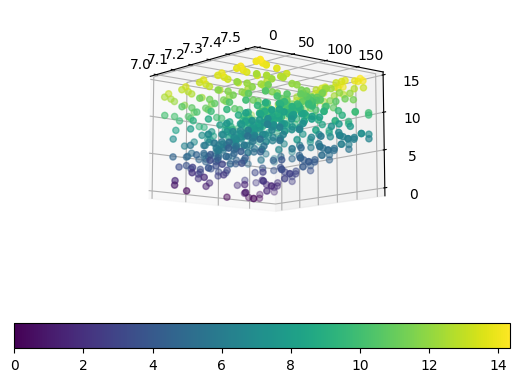

In [121]:
ax = plt.subplot(projection="3d")
_ = df_[df_["com_dists"] > 1] 
_ = _[_["abp"] > 1] 
s = ax.scatter( _["com_dists"],  _["abp"],  _["E"], c=_["E"])
cbar = plt.colorbar(s, orientation="horizontal")


ax.view_init(-10, -40, 0)

# plt.xlim(4.5,20.5)

648it [00:00, 5895.91it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


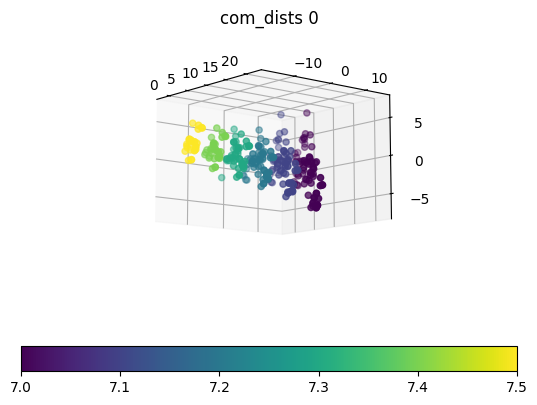

648it [00:00, 4500.12it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


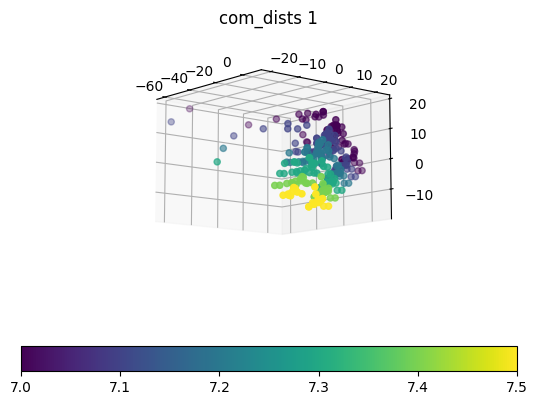

648it [00:00, 3473.24it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


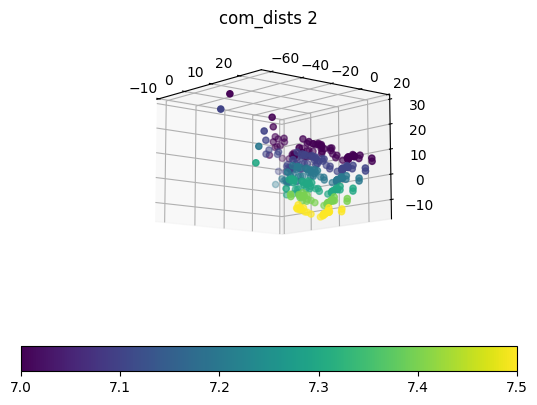

648it [00:00, 2676.91it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


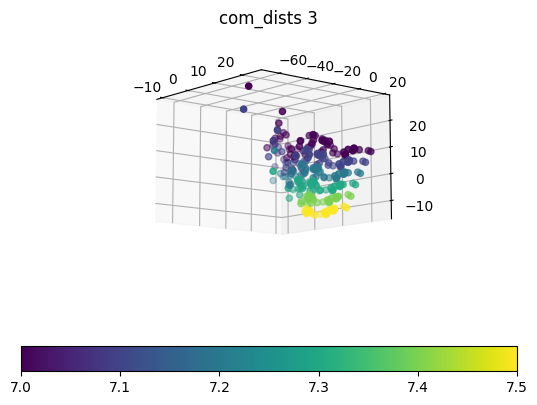

648it [00:00, 2072.36it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


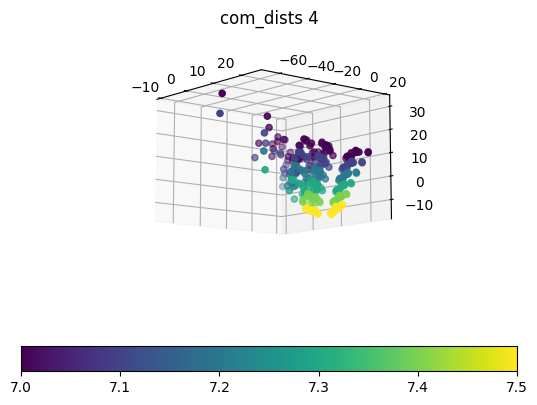

648it [00:00, 1686.31it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


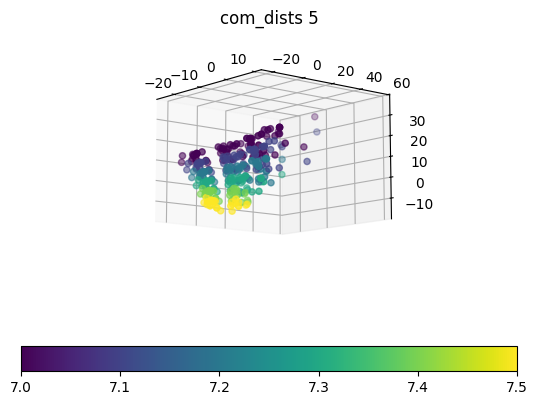

648it [00:00, 1290.74it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


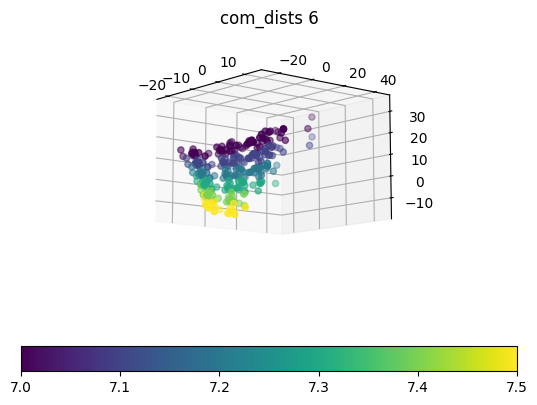

648it [00:00, 1104.75it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


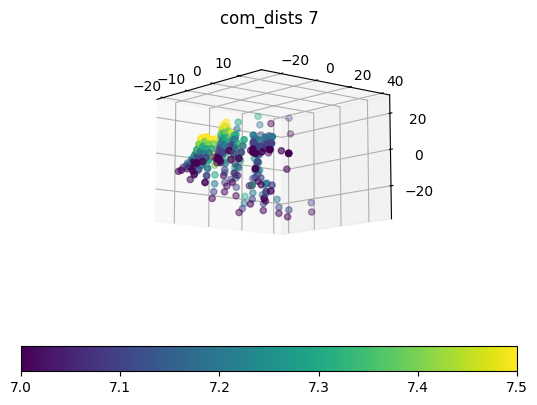

648it [00:00, 927.09it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


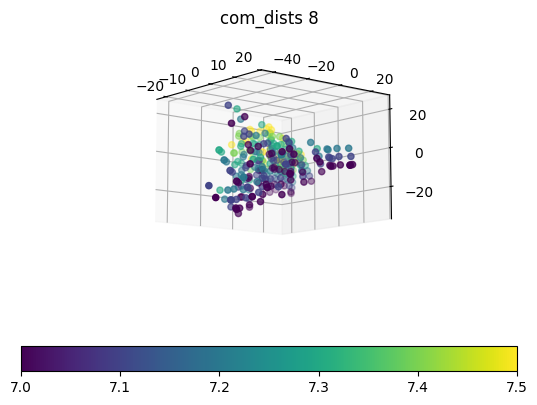

648it [00:00, 774.83it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


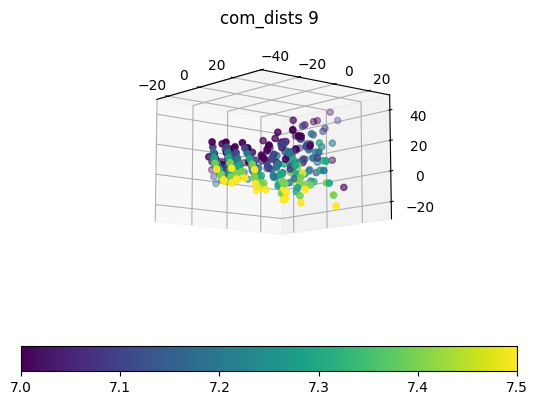

648it [00:00, 672.18it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


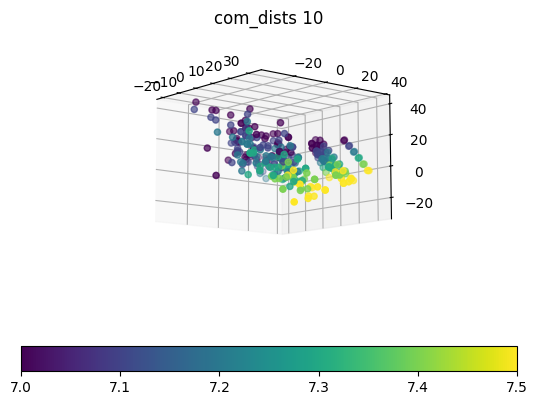

648it [00:01, 554.66it/s]


Flattening descriptors...
Scaling data...
Applying apply_pca...


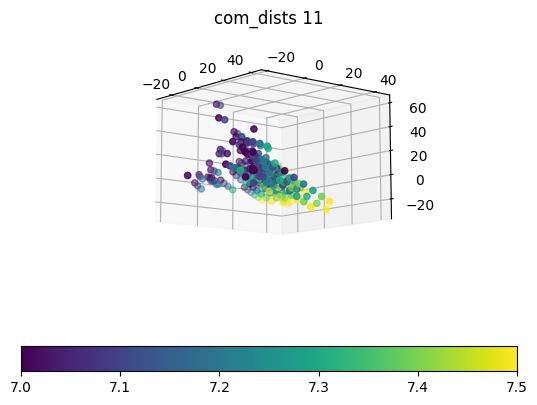

In [122]:
dfs = []
soaps = []
for i in range(12):
    # coordinates = [sym_to_ase(_).get_positions() for _ in confs["C2"]]
    coordinates = [_.get_positions() for _ in all_atoms]
    coordinates = np.array(coordinates)
    
    atomic_numbers = C2_test_atoms.get_atomic_numbers()
    atomic_numbers = np.array([atomic_numbers]*len(coordinates))
    atomic_numbers
    
    species = np.unique(np.concatenate([atomic_numbers]))
    # Apply PCA
    labels = None
    soap_descr, ase_atoms = compute_soap_descriptors(
        coordinates, atomic_numbers, species, 
        r_cut=20.0, n_max=9, l_max=i, sigma=1.0)

    # Function to apply PCA
    def apply_pca(data, n_components=3):
        """Apply PCA to the data."""
        pca = PCA(n_components=n_components)
        reduced_data = pca.fit_transform(data)
        return reduced_data, pca

    reduced_data_pca, model_pca = process_data(soap_descr, apply_pca, n_components=3)

    df = pd.DataFrame(
        {
            "PCA1": reduced_data_pca[:, 0], 
         "PCA2": reduced_data_pca[:,1], 
            "PCA3": reduced_data_pca[:,2], 
            # "soap": soap_descr,
            "com_dists":com_dists,
         "E": energies, "ROG":rog,
            # "syms": syms, 
            "abp": angles_betw_plane
        })

    dfs.append(df)
    soaps.append(soap_descr)

    for k in list(df.keys())[3:4]:
        
        ax = plt.subplot(projection="3d")
        ax.set_title(f"{k} {i}")
        df_ = df
        _ = df_[df_["com_dists"] > 1] 
        _ = _[_["abp"] > 1] 
        _ = _[_["E"] < _["E"].median() ] 
        s = ax.scatter( _["PCA1"],  _["PCA2"],  _["PCA3"], c=_[k])
        cbar = plt.colorbar(s, orientation="horizontal")
        ax.view_init(-10, -40, 0)
        plt.show()

In [125]:
from molzip import ZipClassifier, ZipRegressor

In [126]:
zr = ZipRegressor()

In [127]:
len(soaps[0])

648

In [128]:

# soap_bytes

In [129]:
len(soap_bytes)

648

In [130]:
_

,PCA1,PCA2,PCA3,com_dists,E,ROG,abp
0,-8.393163,20.836278,1.159138,7.0,-860.665220,4.022964,142.272121
1,-10.287701,22.798300,1.374584,7.0,-860.664117,4.022964,171.329593
2,-2.848390,18.721470,3.048149,7.0,-860.667396,4.022964,157.063683
3,6.815757,12.139152,3.937328,7.0,-860.672805,4.022964,127.311515
4,9.115133,9.819680,4.014179,7.0,-860.673458,4.022964,97.385738
...,...,...,...,...,...,...,...
643,-4.368881,-13.284826,1.205414,7.5,-860.668529,5.898483,85.095306
644,-1.338851,-14.175521,1.343457,7.5,-860.670801,5.898483,74.640164
645,-0.440086,-13.258680,1.520658,7.5,-860.672342,5.898483,59.341489
646,-1.217920,-12.596520,3.536237,7.5,-860.670753,5.898483,40.978119


In [131]:
dfs[i]

,PCA1,PCA2,PCA3,com_dists,E,ROG,abp
0,-8.393163,20.836278,1.159138,7.0,-860.665220,4.022964,142.272121
1,-10.287701,22.798300,1.374584,7.0,-860.664117,4.022964,171.329593
2,-2.848390,18.721470,3.048149,7.0,-860.667396,4.022964,157.063683
3,6.815757,12.139152,3.937328,7.0,-860.672805,4.022964,127.311515
4,9.115133,9.819680,4.014179,7.0,-860.673458,4.022964,97.385738
...,...,...,...,...,...,...,...
643,-4.368881,-13.284826,1.205414,7.5,-860.668529,5.898483,85.095306
644,-1.338851,-14.175521,1.343457,7.5,-860.670801,5.898483,74.640164
645,-0.440086,-13.258680,1.520658,7.5,-860.672342,5.898483,59.341489
646,-1.217920,-12.596520,3.536237,7.5,-860.670753,5.898483,40.978119


In [132]:
all_atoms

[Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(symbols='H10C5H10C5', pbc=False, calculator=XTB(...)),
 Atoms(s

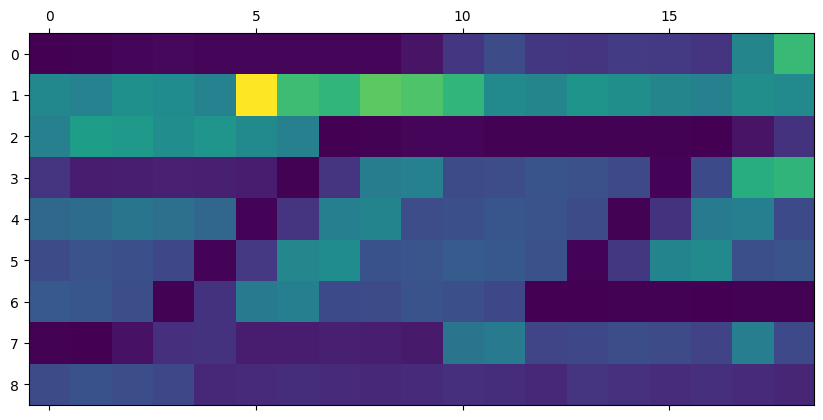

In [133]:
plt.matshow(soaps[0][0,:].reshape(9,19))

In [134]:
soaps[1][0,:].shape

(342,)

In [135]:
342/9

38.0

In [136]:
sc = StandardScaler()
soaps_ = sc.fit_transform(soaps[4])
soaps_.max()

9.655792645673078

In [137]:
108/9

12.0

In [138]:
def fig2img(fig,dpi=9):
    """Convert a Matplotlib figure to a PIL Image and return it"""
    import io
    buf = io.BytesIO()
    fig.savefig(buf, dpi=dpi, metadata=None, bbox_inches="tight")
    buf.seek(0)
    img = Image.open(buf)
    return img


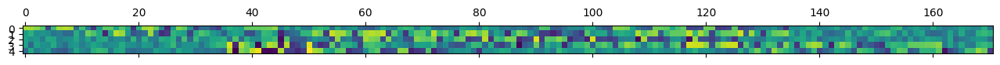

In [139]:
plt.matshow(soaps_[i,:].reshape(soaps_[i,:].shape[0]//(19*9), 9*19))
# plt.matshow(soaps_[i,:].reshape(19, soaps_[i,:].shape[0]//19))

In [140]:
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)
str(soaps_[i,:].reshape(19, soaps_[i,:].shape[0]//19))

'[[ 2.35614389e+00  2.33415173e+00  2.07242948e+00  1.47744036e+00\n  -1.84196209e+00  1.13427702e+00  2.31234891e+00  2.48142417e+00\n   2.37095364e+00 -9.47110491e-01  1.22108513e+00 -4.51140143e-01\n  -2.13805564e+00  1.99370848e-01  1.55952130e+00  1.55168308e+00\n   4.93233617e-01  1.43933019e+00  5.74558346e-01 -2.34294569e+00\n   7.58841449e-01  2.26441460e+00  2.43218055e+00  1.66798072e+00\n  -2.52504232e-01 -2.50062270e+00  2.65803700e-01  1.99487130e+00\n   1.60475942e+00  4.61564279e-02 -2.07713499e+00 -9.28732272e-01\n  -8.97168065e-01 -1.64435485e+00 -2.09133232e+00  2.34272462e-01\n   7.97124249e-01  5.68930856e-01  3.35579604e-01  1.63420451e+00\n   1.65116887e+00  1.66499035e+00  1.70105171e+00  1.77987002e+00\n   2.10984379e+00]\n [-6.01342956e-01  5.49523380e-01 -5.78941537e-01  6.23214427e-01\n  -4.84271219e-01 -6.51594497e-01  8.24479901e-01  1.08450827e+00\n   7.95491214e-01 -9.55128261e-01  6.83092074e-01 -5.32849886e-01\n  -8.09847863e-02  2.74950394e-01 -9.7977

In [141]:
# import PIL
# from PIL import Image
# # %matplotlib ipympl
# picture_bytes = []
# for i in tqdm(range(2)):
#     # plt.matshow(soaps_[i,:], cmap="binary", vmin=-10,vmax=10)
#     # plt.grid("off")
#     ax = plt.gca()
#     ax.set_frame_on(False)
#     spine_names = ('top','right', 'bottom', 'left')
#     for spine_name in spine_names:
#         ax.spines[spine_name].set_visible(False)
#     ax.axis('off')
#     fig = plt.gcf()
#     plt.show()
#     p = fig2img(fig, dpi=4)
#     p = str(p.tobytes())
#     picture_bytes.append(p)
#     plt.close()
# # p
    

In [142]:
# picture_bytes[0]
df_

,PCA1,PCA2,PCA3,com_dists,E,ROG,abp
0,-8.393163,20.836278,1.159138,7.0,-860.665220,4.022964,142.272121
1,-10.287701,22.798300,1.374584,7.0,-860.664117,4.022964,171.329593
2,-2.848390,18.721470,3.048149,7.0,-860.667396,4.022964,157.063683
3,6.815757,12.139152,3.937328,7.0,-860.672805,4.022964,127.311515
4,9.115133,9.819680,4.014179,7.0,-860.673458,4.022964,97.385738
...,...,...,...,...,...,...,...
643,-4.368881,-13.284826,1.205414,7.5,-860.668529,5.898483,85.095306
644,-1.338851,-14.175521,1.343457,7.5,-860.670801,5.898483,74.640164
645,-0.440086,-13.258680,1.520658,7.5,-860.672342,5.898483,59.341489
646,-1.217920,-12.596520,3.536237,7.5,-860.670753,5.898483,40.978119


In [143]:
_

,PCA1,PCA2,PCA3,com_dists,E,ROG,abp
0,-8.393163,20.836278,1.159138,7.0,-860.665220,4.022964,142.272121
1,-10.287701,22.798300,1.374584,7.0,-860.664117,4.022964,171.329593
2,-2.848390,18.721470,3.048149,7.0,-860.667396,4.022964,157.063683
3,6.815757,12.139152,3.937328,7.0,-860.672805,4.022964,127.311515
4,9.115133,9.819680,4.014179,7.0,-860.673458,4.022964,97.385738
...,...,...,...,...,...,...,...
643,-4.368881,-13.284826,1.205414,7.5,-860.668529,5.898483,85.095306
644,-1.338851,-14.175521,1.343457,7.5,-860.670801,5.898483,74.640164
645,-0.440086,-13.258680,1.520658,7.5,-860.672342,5.898483,59.341489
646,-1.217920,-12.596520,3.536237,7.5,-860.670753,5.898483,40.978119


In [144]:
df_ = dfs[i]
_ = df
# _ = df_[df_["com_dists"] > 1] 
# _ = _[_["abp"] > 1] 
# _ = _[_["E"] < _["E"].median() ] 
_["E"] = _["E"] - _["E"].min()
_ = _[_["E"] < .5]
_ = _.sample(len(_))
_

,PCA1,PCA2,PCA3,com_dists,E,ROG,abp
289,-12.036774,8.913447,15.925526,7.0,0.003914,6.170567,150.000000
76,6.179677,4.305203,15.144509,7.0,0.005807,10.366519,78.421700
136,18.414098,14.475002,-4.488481,7.5,0.013495,10.580269,78.421700
480,45.471586,-26.353185,-13.615101,7.4,0.018748,7.834755,111.230922
566,11.093383,24.874849,-9.143918,7.5,0.012599,4.520634,89.607325
...,...,...,...,...,...,...,...
419,-18.839627,29.483068,-9.649093,7.4,0.009758,5.083927,167.773483
332,40.940913,9.312735,-19.325192,7.3,0.008685,6.348176,120.000000
223,-28.822051,-30.686032,-5.053362,7.0,0.019646,6.724653,157.956294
452,-5.405206,-1.192245,8.696322,7.1,0.010264,7.634881,131.259318


In [145]:
soaps_ = soaps[0]
soaps_

array([[7.30541611e-02, 8.68894449e-01, 2.50489316e+00, 3.71411880e+00,
        2.56767812e+00, 2.45063833e+00, 2.77214663e+00, 2.68504170e+00,
        2.44917877e+00, 1.03344909e+01, 2.97927966e+01, 4.41751319e+01,
        3.05395508e+01, 2.91474984e+01, 3.29714664e+01, 3.19354543e+01,
        2.91301386e+01, 8.58881912e+01, 1.27350320e+02, 8.80409721e+01,
        8.40278926e+01, 9.50518223e+01, 9.20651539e+01, 8.39778469e+01,
        1.88828100e+02, 1.30542346e+02, 1.24591971e+02, 1.40937652e+02,
        1.36509183e+02, 1.24517766e+02, 9.02477123e+01, 8.61340453e+01,
        9.74342889e+01, 9.43727599e+01, 8.60827452e+01, 8.22078873e+01,
        9.29930437e+01, 9.00710652e+01, 8.21589256e+01, 1.05193145e+02,
        1.01887821e+02, 9.29376585e+01, 9.86863554e+01, 9.00174203e+01,
        8.21099930e+01, 4.31826850e-02, 8.28487533e-01, 2.30905367e+00,
        2.42939312e+00, 1.26008307e+00, 1.30663306e+00, 1.44039129e+00,
        1.36896194e+00, 1.22603559e+00, 5.13607914e-01, 9.853897

In [146]:
list(_["E"])[:N_fit]

[0.003914423808737411,
 0.0058069927820270095,
 0.013495307609446172,
 0.01874767130186683,
 0.012599181134191895,
 0.012332259542404245,
 0.0021138317385975824,
 0.017002508932023375,
 0.013208266436663507,
 0.013473094574919742,
 0.008601091704463215,
 0.02101183367062731,
 0.0033382246078872413,
 0.013007746828748168,
 0.007169655324787527,
 0.004724411937104378,
 0.014291941505916839,
 0.015620800215742747,
 0.01796153191162375,
 0.010123928160282958,
 0.011692442436356032,
 0.006389777083654735,
 0.012253766615117456,
 0.007654409033420961,
 0.01808296511194385]

In [157]:
len(soaps[i])

648

<Axes: >

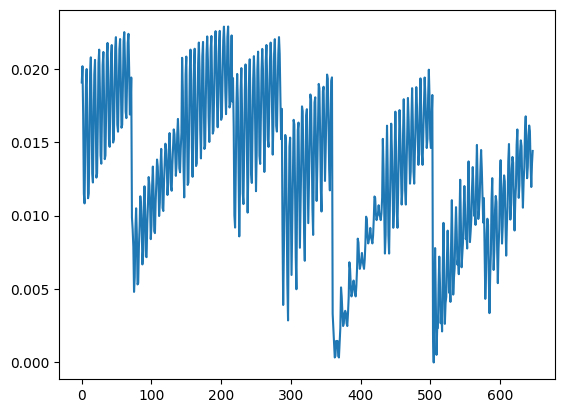

In [159]:
_["E"].plot()

In [194]:
soaps_

array([[ 7.30541611e-02,  8.68894449e-01,  2.50489316e+00,
         3.71411880e+00,  2.56767812e+00,  2.45063833e+00,
         2.77214663e+00,  2.68504170e+00,  2.44917877e+00,
         1.03344909e+01,  2.97927966e+01,  4.41751319e+01,
         3.05395508e+01,  2.91474984e+01,  3.29714664e+01,
         3.19354543e+01,  2.91301386e+01,  8.58881912e+01,
         1.27350320e+02,  8.80409721e+01,  8.40278926e+01,
         9.50518223e+01,  9.20651539e+01,  8.39778469e+01,
         1.88828100e+02,  1.30542346e+02,  1.24591971e+02,
         1.40937652e+02,  1.36509183e+02,  1.24517766e+02,
         9.02477123e+01,  8.61340453e+01,  9.74342889e+01,
         9.43727599e+01,  8.60827452e+01,  8.22078873e+01,
         9.29930437e+01,  9.00710652e+01,  8.21589256e+01,
         1.05193145e+02,  1.01887821e+02,  9.29376585e+01,
         9.86863554e+01,  9.00174203e+01,  8.21099930e+01,
         1.51633096e-07, -4.52734968e-07,  1.39110662e-06,
        -2.98143478e-06, -3.36068402e-06,  6.80299817e-0

In [223]:
projections[i]

array([[-2.68273006e+01,  8.73877994e+00],
       [-3.15437267e+01,  1.09033465e+01],
       [-1.78334914e+01,  8.67769499e+00],
       [ 1.81710637e+00, -7.92555127e+00],
       [ 7.68570732e+00, -2.06855029e+01],
       [-7.62935087e+00, -2.73604040e+00],
       [-2.66578037e+01,  6.91386467e+00],
       [-3.13763561e+01,  8.99464807e+00],
       [-1.70398171e+01,  9.07787707e+00],
       [ 1.54536660e+00, -8.04451326e-01],
       [ 4.89772486e+00, -7.67033757e+00],
       [-8.52781205e+00, -2.74619368e-01],
       [-2.65706584e+01,  7.08801708e+00],
       [-3.11362539e+01,  9.37358915e+00],
       [-1.83468730e+01,  7.34350624e+00],
       [ 6.45115576e-01, -1.01136944e+01],
       [ 6.52644206e+00, -2.35711370e+01],
       [-8.27286397e+00, -4.78948283e+00],
       [-2.63773263e+01,  5.09277258e+00],
       [-3.09442526e+01,  7.42569084e+00],
       [-1.75459284e+01,  7.74617598e+00],
       [ 3.79024679e-01, -3.57145614e+00],
       [ 3.53642493e+00, -8.92835236e+00],
       [-9.

/home/boittier/miniforge3/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


(648,)
(648,)
10 1.136030044730245 1.4402120126424125


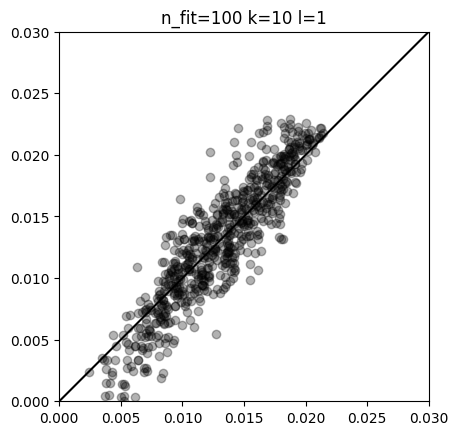

In [232]:

for N_fit in [100]:
    sc = StandardScaler()
    i = 1
    soaps_ = soaps[i] #projections[i] #soaps[i]
    
    df_ = dfs[i]
    _ = df_
    
    _["E"] = (_["E"] - _["E"].min())
    X_train_df = _.sample(N_fit, weights=abs(_["E"] - _["E"].mean()))
    X_train = [soaps_[i] for i in X_train_df.index] 
    y_train = X_train_df["E"]
    y_test = _.loc[~_.index.isin(X_train_df)]["E"]
    X_test =  [soaps_[i] for i in y_test.index]
    
    def make_str(_):
        return [str(x) for x in _]
    
    X_test = make_str(X_test)
    X_train = make_str(X_train)
    
    y_pred = zr.fit_predict(X_train , y_train, X_test , k=9).flatten()
    
    print( np.array(y_pred).shape)
    print(np.array(y_test).shape)

    MAE = np.mean(np.abs(y_pred -  y_test))
    RMSE = np.sqrt(np.mean((y_pred - y_test )**2))
    print( k,  627.5*MAE, 627.5*RMSE,)
    
    plt.title(f"n_fit={N_fit} k={k} l={i}")
    plt.scatter(y_pred ,  y_test, alpha=0.3, color="k")
    
    ax = plt.gca()
    ax.set_aspect("equal")
    ax.plot([0,1],[0,1],transform=ax.transAxes, color="k")
    for a in [ax.set_xlim, ax.set_ylim]:
        a(0, 0.03)
    plt.show()


In [486]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold
import statsmodels.api as sm

def evaluate_models(soaps, dfs, model_list, *,
                    i=1, N_fit=100, n_splits=5,
                    axes=None,
                    kcal_mol=True, plot=True, energy_key="E"):
    """
    Evaluate multiple models on SOAP + energy datasets using train/test or K-Fold CV.
    
    Uses statsmodels to compute R², RMSE, MAE, and returns a summary DataFrame.
    """
    df_ = dfs[i].copy()
    df_[energy_key] -= df_[energy_key].min()
    soaps_ = soaps[i]

    def compute_stats(y_true, y_pred, kcal_mol=True):
        residuals = y_true - y_pred
    
        mae = np.mean(np.abs(residuals))
        rmse = np.sqrt(np.mean(residuals**2))
        
        # Fit statsmodels for diagnostics
        model = sm.OLS(y_true, sm.add_constant(y_pred)).fit()
        
        if kcal_mol:
            mae *= 627.5
            rmse *= 627.5
    
        stats = {
            "MAE": mae,
            "RMSE": rmse,
            "R2": model.rsquared,
            "Adj_R2": model.rsquared_adj,
            "AIC": model.aic,
            "BIC": model.bic,
            "Skewness": pd.Series(residuals).skew(),
            "Kurtosis": pd.Series(residuals).kurtosis(),
            "Durbin_Watson": sm.stats.stattools.durbin_watson(residuals),
            "Max_Error": np.max(np.abs(residuals)),
            "Min_Error": np.min(np.abs(residuals)),
            "Condition_Number": model.condition_number
        }
    
        if kcal_mol:
            stats["Max_Error"] *= 627.5
            stats["Min_Error"] *= 627.5
    
        return stats

    def plot_preds(y_true, y_pred, title, c="k", ax=None):
        from cmap import Colormap
        cm = Colormap('crameri:berlin')  # case insensitive
        _cmap = cm.to_matplotlib()
        # plt.figure()
        ax = plt.gca() if ax is None else ax
        ax.set_title(title)
        ax.scatter(y_pred, y_true, alpha=0.3, c=c, cmap=_cmap)
        ax.set_aspect("equal")
        ax.plot([0, 1], [0, 1], transform=ax.transAxes, c="k")
        ax.set_xlim(0, 0.03)
        ax.set_ylim(0, 0.03)
        ax.set_xlabel("Predicted")
        ax.set_ylabel("True")
        # plt.show()

    def to_str(X): return [str(x) for x in X]

    results = []

    df_train = df_.sample(N_fit, weights=(df_[energy_key] - df_[energy_key].median())**2, random_state=42)
    df_test = df_.drop(df_train.index)

    X_train = np.array([soaps_[j] for j in df_train.index])
    y_train = df_train[energy_key].values
    X_test = np.array([soaps_[j] for j in df_test.index])
    y_test = df_test[energy_key].values

    for i, (name, model) in enumerate(model_list):
        if getattr(model, "can_handle_strings", False):
            X_train_ = to_str(X_train)
            X_test_ = to_str(X_test)
        else:
            X_train_ = X_train
            X_test_ = X_test

        model.fit(X_train_, y_train)
        y_pred = model.predict(X_test_)
        stats = compute_stats(y_test, y_pred)
        stats.update({"Model": name, "Split": "KFold" or f"Train={N_fit}"})
        results.append(stats)
        if plot:
            
            ax = axes[i] if axes else None
            plot_preds(y_test, y_pred, f"{name}", ax=ax, c=df_test["com_dists"])

    return pd.DataFrame(results)


In [462]:
import molzip
from molzip.regressor import ZipRegressor, regress

In [463]:
import gzip
import multiprocessing
from typing import Any, Iterable
from functools import partial
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold


class _ZipRegressor(object):
    def __init__(self, k=1) -> None:
        super().__init__()
        # self.compressor = compressor
        self.fitted = False
        self.k = k
        self.top_k_values = None
        self.top_k_dists = None
        self.n_props = None

    def fit_predict(
        self,
        X_train: Iterable[str],
        y_train: Iterable,
        X: Iterable[str],
        k: int = 25,
     ) -> np.ndarray:
        preds = []

        y_train = np.array(y_train)

        if len(y_train.shape) == 1:
            y_train = np.expand_dims(y_train, axis=1)

        cpu_count = multiprocessing.cpu_count()

        with multiprocessing.Pool(cpu_count) as p:
            preds = p.map(
                partial(
                    regress,
                    X_train=X_train,
                    y_train=y_train,
                    k=k,
                ),
                X,
            )

        return np.array(preds)

    def fit (
        self,
        X_train: Iterable[str],
        y_train: Iterable,
    ) -> np.ndarray:
        preds = []
        self.X_train = [str(_) for _ in X_train]
        self.y_train = np.array(y_train, dtype=float)
        return self.fit_predict(self.X_train, self.y_train, self.X_train, k=self.k).flatten()

    def predict (
        self,
        X: Iterable[str],
        k: int = 25,
    ) -> np.ndarray:
        return self.fit_predict(self.X_train, self.y_train, [str(_) for _ in X], k=self.k).flatten()



 

In [464]:
# SGDRegressor?

In [465]:
from sklearn.linear_model import Ridge
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler


from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, SGDRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C

k = 50

model_list = [
    ("gzKNN ($k="+str(2)+"$)", _ZipRegressor(k=2)),
    ("gzKNN ($k="+str(10)+"$)", _ZipRegressor(k=10)), 
    ("gzKNN ($k="+str(20)+"$)", _ZipRegressor(k=20)),
    ("gzKNN ($k="+str(50)+"$)", _ZipRegressor(k=50)),
    ("gzKNN ($k="+str(100)+"$)", _ZipRegressor(k=100)),
    ("gzKNN ($k="+str(200)+"$)", _ZipRegressor(k=200)),
    # 🔹 Linear and regularized models
    ("LinearRegression", make_pipeline(StandardScaler(), LinearRegression())),
    ("Ridge", make_pipeline(StandardScaler(), Ridge(alpha=1.0))),
    ("Lasso", make_pipeline(StandardScaler(), Lasso(alpha=0.0))),
    ("ElasticNet", make_pipeline(StandardScaler(), ElasticNet(alpha=0.0, l1_ratio=0.5))),
    # ("SGD", make_pipeline(StandardScaler(), SGDRegressor(max_iter=10000, tol=1e-3))),

    # 🔸 Kernel-based models
    ("SVR-RBF", make_pipeline(StandardScaler(), SVR(kernel='rbf', C=0.01, epsilon=0.0))),
    ("KernelRidge", make_pipeline(StandardScaler(), KernelRidge(alpha=0.0, kernel='rbf'))),

    # 🔹 Tree-based and ensemble models
    ("RandomForest", RandomForestRegressor(n_estimators=100, max_depth=10, random_state=42)),
    ("GradientBoosting", GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3)),
    ("AdaBoost", AdaBoostRegressor(n_estimators=100)),

    # 🔸 Neural net
    ("MLP", make_pipeline(StandardScaler(), MLPRegressor(hidden_layer_sizes=(64,64),
                                        early_stopping=True,
                                        max_iter=100000, random_state=42))),

    # 🔹 Gaussian process
    ("GPR", make_pipeline(StandardScaler(), 
        GaussianProcessRegressor(kernel=C(1.0) * RBF(length_scale=1.0), alpha=1e-6, random_state=42))),
]



In [488]:
import matplotlib.pyplot as plt

def create_model_mosaic(model_names, layout=None, figsize=(14, 8)):
    """
    Create a subplot mosaic with model names as semantic keys.
    
    Parameters:
    - model_names: list of strings, names of models (used as subplot keys)
    - layout: list of lists of strings, custom layout (optional)
    - figsize: size of the figure
    
    Returns:
    - fig: the matplotlib Figure
    - axes: dictionary of Axes objects keyed by model name
    """
    # If no custom layout is provided, build a default grid
    if layout is None:
        n_cols = 3
        rows = [
            model_names[i:i + n_cols]
            for i in range(0, len(model_names), n_cols)
        ]
    else:
        rows = layout
    
    fig, axes = plt.subplot_mosaic(rows, figsize=figsize, 
                                   # sharex=True, sharey=True
                                  )
    return fig, axes

In [467]:
model_names = [_[0] for _ in model_list]
model_names

['gzKNN ($k=2$)',
 'gzKNN ($k=10$)',
 'gzKNN ($k=20$)',
 'gzKNN ($k=50$)',
 'gzKNN ($k=100$)',
 'gzKNN ($k=200$)',
 'LinearRegression',
 'Ridge',
 'Lasso',
 'ElasticNet',
 'SVR-RBF',
 'KernelRidge',
 'RandomForest',
 'GradientBoosting',
 'AdaBoost',
 'MLP',
 'GPR']

In [468]:
figure_layout = [
['gzKNN ($k=2$)',
 'gzKNN ($k=10$)',
 'gzKNN ($k=20$)',
 'gzKNN ($k=50$)',
 'gzKNN ($k=100$)',
 'gzKNN ($k=200$)',],
    [ 'LinearRegression',
 'Ridge',
 'Lasso',
 'ElasticNet',
 'SVR-RBF',
 'KernelRidge',
],
    [ 'RandomForest',
     'GradientBoosting',
 'AdaBoost',
 'MLP',
 'GPR',
    "X"],
]



In [469]:
all_results = {}

In [470]:
# ! uv pip install cmap



/home/boittier/miniforge3/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/base.py:1363: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  return fit_method(estimator, *args, **kwargs)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider 

         MAE       RMSE            R2        Adj_R2          AIC          BIC  \
0   2.741881   3.330806  2.447806e-01  2.430873e-01 -3828.024994 -3819.815407   
1   2.594931   3.026368  2.196731e-01  2.179235e-01 -3813.373364 -3805.163778   
2   2.317828   2.761461  2.205170e-01  2.187693e-01 -3813.858124 -3805.648538   
3   1.991544   2.433357  2.134580e-01  2.116945e-01 -3809.819268 -3801.609681   
4   1.753375   2.195921  1.953133e-01  1.935091e-01 -3799.601807 -3791.392221   
5   1.978508   2.462194  1.110223e-16  1.110223e-16 -3704.250366 -3700.145572   
6   1.054622   1.370736  7.411780e-01  7.405977e-01 -4307.773780 -4299.564193   
7   1.674585   2.015414  4.673451e-01  4.661508e-01 -3984.437296 -3976.227709   
8   1.354168   1.668463  5.939097e-01  5.929992e-01 -4105.978863 -4097.769277   
9   1.354168   1.668463  5.939097e-01  5.929992e-01 -4105.978863 -4097.769277   
10  2.281341   2.739571  2.837772e-01  2.821713e-01 -3851.776623 -3843.567036   
11  2.717359   5.849371  2.2

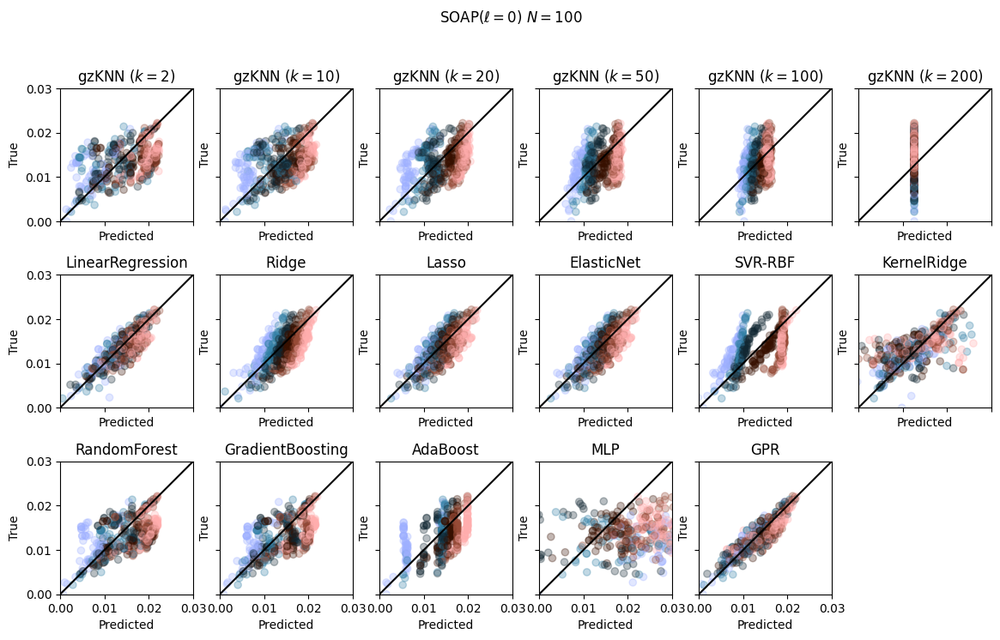

In [471]:
fig, axes = create_model_mosaic(model_names, layout=figure_layout)
NFIT = 100
ELL = 0
title = "SOAP($\\ell="+str(ELL)+"$) " "$N=$"+str(NFIT)
df_results = evaluate_models(
    soaps=soaps,
    dfs=dfs,
    model_list=model_list,
    N_fit=200,
    i=ELL,
    plot=True,
    axes=[axes[k] for k in model_names]
)
all_results[title] = df_results
print(df_results)

plt.suptitle(title)
axes["X"].set_axis_off()

In [473]:
soaps = []
for i in range(12):
    coordinates = [_.get_positions() for _ in all_atoms]
    coordinates = np.array(coordinates)
    
    atomic_numbers = C2_test_atoms.get_atomic_numbers()
    atomic_numbers = np.array([atomic_numbers]*len(coordinates))
    atomic_numbers
    
    species = np.unique(np.concatenate([atomic_numbers]))
    # Apply PCA
    labels = None
    soap_descr, ase_atoms = compute_soap_descriptors(
        coordinates, atomic_numbers, species, 
        r_cut=20.0, n_max=2, l_max=i, sigma=1.0)
    soaps.append(soap_descr)    

648it [00:00, 6678.96it/s]
648it [00:00, 6195.07it/s]
648it [00:00, 5814.95it/s]
648it [00:00, 5148.77it/s]
648it [00:00, 4558.32it/s]
648it [00:00, 3939.87it/s]
648it [00:00, 3458.25it/s]
648it [00:00, 2935.15it/s]
648it [00:00, 2667.42it/s]
648it [00:00, 2211.50it/s]
648it [00:00, 1949.70it/s]
648it [00:00, 1582.97it/s]


/home/boittier/miniforge3/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/base.py:1363: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  return fit_method(estimator, *args, **kwargs)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider 

,MAE,RMSE,R2,Adj_R2,AIC,BIC,Skewness,Kurtosis,Durbin_Watson,Max_Error,Min_Error,Condition_Number,Model,Split
0,2.741881,3.330806,2.447806e-01,2.430873e-01,-3828.024994,-3819.815407,0.524220,-0.395852,1.112994,7.242133,0.003554,1.748027e+02,gzKNN ($k=2$),KFold
1,2.594931,3.026368,2.196731e-01,2.179235e-01,-3813.373364,-3805.163778,0.601966,-0.607246,0.639863,6.595935,0.021225,1.984037e+02,gzKNN ($k=10$),KFold
2,2.317828,2.761461,2.205170e-01,2.187693e-01,-3813.858124,-3805.648538,0.416395,-0.645883,0.456300,5.830512,0.002644,2.233313e+02,gzKNN ($k=20$),KFold
3,1.991544,2.433357,2.134580e-01,2.116945e-01,-3809.819268,-3801.609681,0.150447,-0.416785,0.452394,6.193169,0.000399,2.868428e+02,gzKNN ($k=50$),KFold
4,1.753375,2.195921,1.953133e-01,1.935091e-01,-3799.601807,-3791.392221,0.030928,-0.311174,0.602709,6.425548,0.002051,4.746515e+02,gzKNN ($k=100$),KFold
5,1.978508,2.462194,1.110223e-16,1.110223e-16,-3704.250366,-3700.145572,-0.208267,0.020499,0.625545,7.901838,0.003468,4.798700e+16,gzKNN ($k=200$),KFold
6,1.054622,1.370736,7.411780e-01,7.405977e-01,-4307.773780,-4299.564193,-0.377354,0.256559,1.043055,5.529503,0.007215,2.483684e+02,LinearRegression,KFold
7,1.674585,2.015414,4.673451e-01,4.661508e-01,-3984.437296,-3976.227709,0.279352,-0.474139,0.449691,5.032151,0.010268,2.566221e+02,Ridge,KFold
8,1.354168,1.668463,5.939097e-01,5.929992e-01,-4105.978863,-4097.769277,0.111951,-0.262389,0.601328,5.571052,0.004079,2.651419e+02,Lasso,KFold
9,1.354168,1.668463,5.939097e-01,5.929992e-01,-4105.978863,-4097.769277,0.111951,-0.262389,0.601328,5.571052,0.004079,2.651419e+02,ElasticNet,KFold


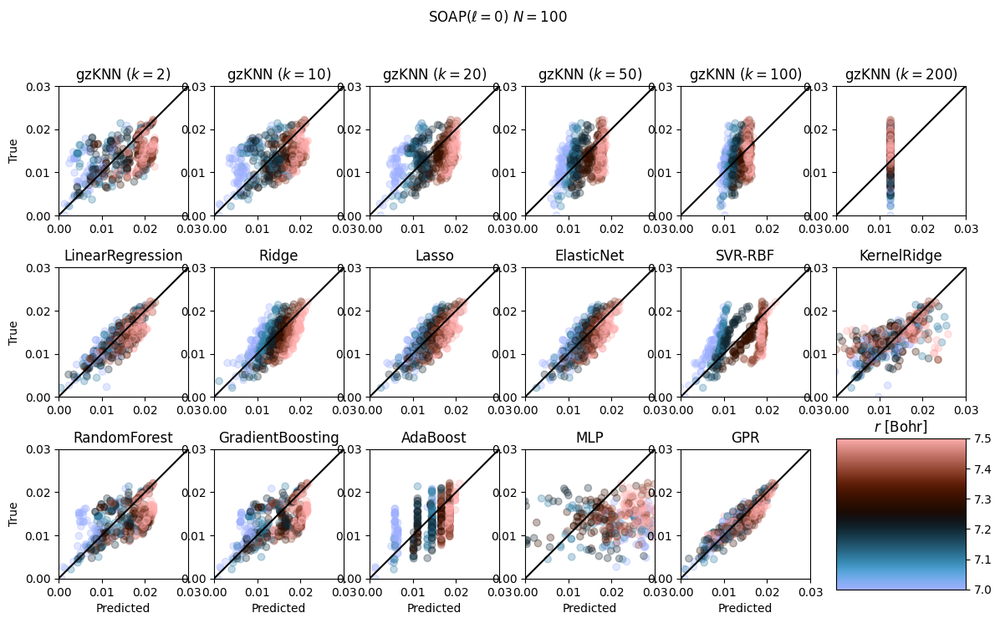

In [508]:
fig, axes = create_model_mosaic(model_names, layout=figure_layout)
NFIT = 100
ELL = 0
title = "SOAP($\\ell="+str(ELL)+"$) " "$N=$"+str(NFIT)
df_results = evaluate_models(
    soaps=soaps,
    dfs=dfs,
    model_list=model_list,
    N_fit=200,
    i=ELL,
    plot=True,
    axes=[axes[k] for k in model_names]
)
all_results[title] = df_results
for i, ax in enumerate(axes.values()):
    if not i in [0, 6, 12]:
        ax.set_ylabel("")
    if not i > 11:
        ax.set_xlabel("")
        
# Normalize to the range of your data
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
norm = mcolors.Normalize(vmin=min(dfs[ELL]["com_dists"]), vmax=max(dfs[ELL]["com_dists"]))
scmp = cm.ScalarMappable(norm=norm, cmap=cmap)
plt.suptitle(title)
plt.colorbar(scmp, cax=axes["X"])
axes["X"].set_title("$r$ [Bohr]")
df_results

/home/boittier/miniforge3/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/base.py:1363: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  return fit_method(estimator, *args, **kwargs)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider 

          MAE       RMSE            R2        Adj_R2          AIC  \
0    2.621330   3.219870  2.526638e-01  2.509881e-01 -3832.725918   
1    2.350585   2.827376  2.617601e-01  2.601049e-01 -3838.212309   
2    2.159289   2.599955  2.638169e-01  2.621662e-01 -3839.462190   
3    1.940649   2.362453  2.399734e-01  2.382693e-01 -3825.182409   
4    1.779329   2.190080  2.163006e-01  2.145434e-01 -3811.441282   
5    1.978508   2.462194  1.110223e-16  1.110223e-16 -3704.250366   
6    0.955422   1.264567  7.612847e-01  7.607494e-01 -4344.003007   
7    1.782724   2.144484  4.079873e-01  4.066599e-01 -3937.104117   
8    1.375008   1.685256  5.761518e-01  5.752015e-01 -4086.804604   
9    1.375008   1.685256  5.761518e-01  5.752015e-01 -4086.804604   
10   2.307786   2.878590  2.757302e-01  2.741062e-01 -3846.771242   
11   3.352898   5.453376  1.314918e-01  1.295445e-01 -3765.408642   
12   2.284564   2.791426  3.166034e-01  3.150711e-01 -3872.794955   
13   1.791099   2.236999  4.336464

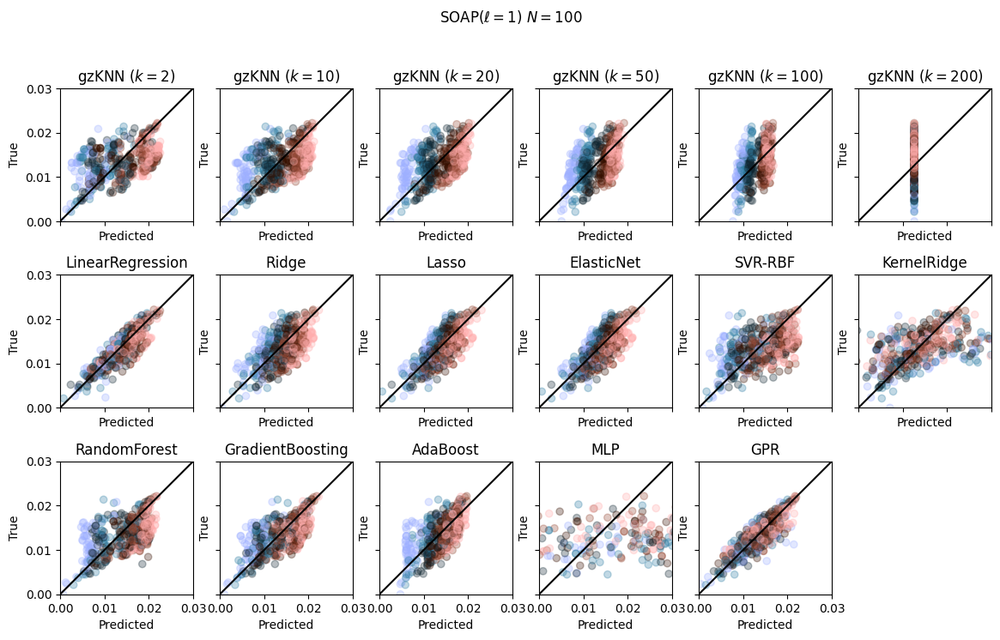

In [475]:
fig, axes = create_model_mosaic(model_names, layout=figure_layout)
NFIT = 100
ELL = 1
title = "SOAP($\\ell="+str(ELL)+"$) " "$N=$"+str(NFIT)
df_results = evaluate_models(
    soaps=soaps,
    dfs=dfs,
    model_list=model_list,
    N_fit=200,
    i=ELL,
    plot=True,
    axes=[axes[k] for k in model_names]
)
all_results[title] = df_results
print(df_results)

plt.suptitle(title)
axes["X"].set_axis_off()

/home/boittier/miniforge3/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/base.py:1363: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  return fit_method(estimator, *args, **kwargs)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider 

          MAE       RMSE            R2        Adj_R2          AIC  \
0    1.351696   1.888405  6.332523e-01  6.324300e-01 -4151.630668   
1    1.217471   1.607944  7.002708e-01  6.995988e-01 -4242.034749   
2    1.167618   1.512300  7.038510e-01  7.031870e-01 -4247.418240   
3    1.114257   1.387148  7.013811e-01  7.007116e-01 -4243.697391   
4    1.328550   1.549867  6.361199e-01  6.353040e-01 -4155.147382   
5    1.978508   2.462194  1.110223e-16  1.110223e-16 -3704.250366   
6    0.258762   0.328868  9.817054e-01  9.816644e-01 -5494.765921   
7    0.486160   0.585563  9.576735e-01  9.575786e-01 -5118.979498   
8    0.418574   0.529776  9.622635e-01  9.621789e-01 -5170.403804   
9    0.418574   0.529776  9.622635e-01  9.621789e-01 -5170.403804   
10   0.375632   0.481433  9.626117e-01  9.625279e-01 -5174.556951   
11   0.511064   0.798483  9.018021e-01  9.015820e-01 -4741.955710   
12   0.579185   0.739670  9.203875e-01  9.202090e-01 -4835.951844   
13   0.445088   0.581993  9.494363

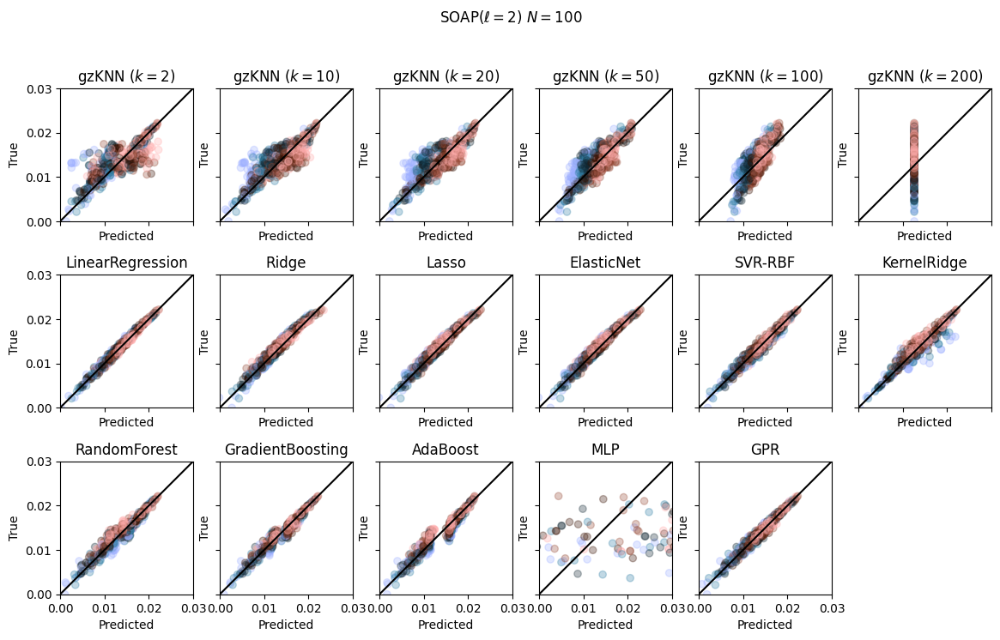

In [476]:
fig, axes = create_model_mosaic(model_names, layout=figure_layout)
NFIT = 100
ELL = 2
title = "SOAP($\\ell="+str(ELL)+"$) " "$N=$"+str(NFIT)
df_results = evaluate_models(
    soaps=soaps,
    dfs=dfs,
    model_list=model_list,
    N_fit=200,
    i=ELL,
    plot=True,
    axes=[axes[k] for k in model_names]
)
all_results[title] = df_results
print(df_results)

plt.suptitle(title)
axes["X"].set_axis_off()

/home/boittier/miniforge3/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/home/boittier/miniforge3/lib/python3.12/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/base.py:1363: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  return fit_method(estimator, *args, **kwargs)
/home/boittier/mmml/.venv/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:695: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_desce

          MAE       RMSE            R2        Adj_R2          AIC  \
0    1.243247   1.698701  7.102930e-01  7.096434e-01 -4257.270905   
1    1.007314   1.328162  7.694195e-01  7.689025e-01 -4359.535934   
2    0.963937   1.247966  7.761790e-01  7.756772e-01 -4372.865518   
3    0.921200   1.155354  7.821776e-01  7.816892e-01 -4385.036103   
4    1.180159   1.430440  7.673100e-01  7.667883e-01 -4355.456046   
5    1.978508   2.462194  1.110223e-16  1.110223e-16 -3704.250366   
6    0.266369   0.334231  9.810385e-01  9.809960e-01 -5478.724350   
7    0.437862   0.547350  9.583230e-01  9.582295e-01 -5125.906874   
8    0.401188   0.511086  9.614034e-01  9.613168e-01 -5160.306682   
9    0.401188   0.511086  9.614034e-01  9.613168e-01 -5160.306682   
10   0.347200   0.465210  9.638572e-01  9.637762e-01 -5189.735230   
11   0.534184   0.811807  9.094956e-01  9.092927e-01 -4778.506175   
12   0.567313   0.724688  9.226650e-01  9.224916e-01 -4848.955309   
13   0.424613   0.568076  9.512456

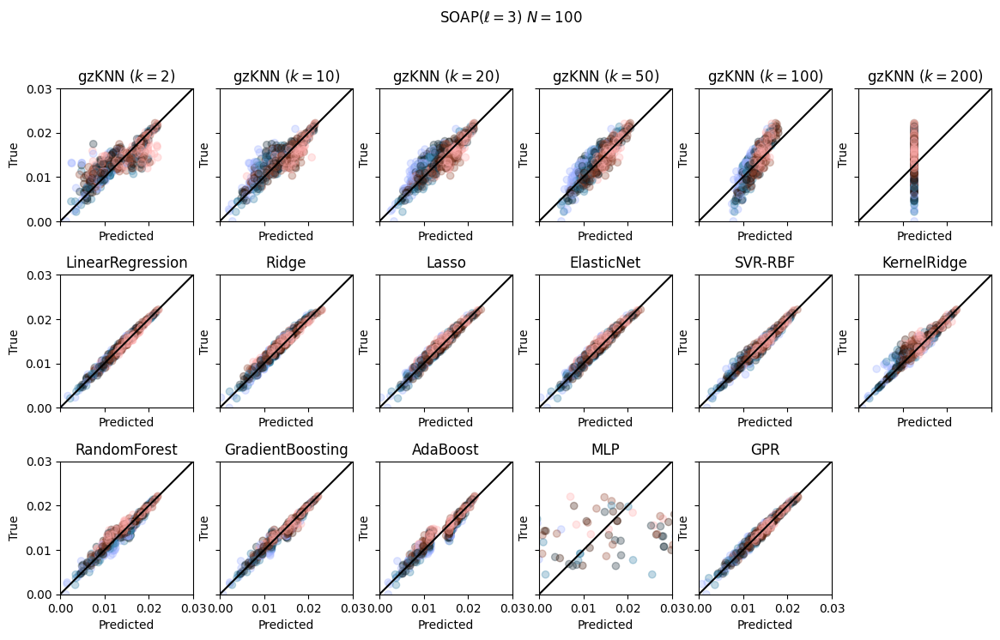

In [477]:
fig, axes = create_model_mosaic(model_names, layout=figure_layout)
NFIT = 100
ELL = 3
title = "SOAP($\\ell="+str(ELL)+"$) " "$N=$"+str(NFIT)
df_results = evaluate_models(
    soaps=soaps,
    dfs=dfs,
    model_list=model_list,
    N_fit=200,
    i=ELL,
    plot=True,
    axes=[axes[k] for k in model_names]
)
all_results[title] = df_results
print(df_results)

plt.suptitle(title)
axes["X"].set_axis_off()

# pycharmm

In [1]:
from mmml.pycharmmInterface.utils import get_Z_from_psf
Z = get_Z_from_psf()
Z

/home/boittier/mmml/mmml/data/top_all36_cgenff.rtf
/home/boittier/mmml/mmml/data/par_all36_cgenff.prm
CHARMM_HOME /home/boittier/mmml/setup/charmm
CHARMM_LIB_DIR /home/boittier/mmml/setup/charmm


[]

In [511]:
charmm_atoms = ase.Atoms(coor.get_positions().to_numpy())

,x,y,z
0,1.255316,-0.479749,0.030719
1,0.832034,-0.814266,-0.931494
2,2.135014,-1.107279,0.221413
3,1.581717,1.015396,-0.047784
4,2.278589,1.291238,0.763173
5,2.058026,1.306269,-0.990636
6,0.222949,1.683852,0.179778
7,0.302317,2.736310,0.481056
8,-0.355999,1.667951,-0.759573
9,-0.472440,0.803383,1.231029


In [ ]:
fig, axes = create_model_mosaic(model_names, layout=figure_layout)
NFIT = 100
ELL = 0
title = "SOAP($\\ell="+str(ELL)+"$) " "$N=$"+str(NFIT)
df_results = evaluate_models(
    soaps=soaps,
    dfs=dfs,
    model_list=model_list,
    N_fit=200,
    i=ELL,
    plot=True,
    axes=[axes[k] for k in model_names]
)
all_results[title] = df_results
print(df_results)

plt.suptitle(title)
axes["X"].set_axis_off()

In [ ]:
from pyscf.scf.chkfile import dump_scf
e_tot = 0.0 # just set e_tot to something so this can be written out
dump_scf(atoms.calc.mf.mol, "new_chk_file", e_tot, 0, 0,  0)

In [262]:
E = atoms.get_potential_energy()
F = atoms.get_forces()



******** <class 'pyscf.scf.uhf.UHF'> ********
method = UHF
initial guess = minao
damping factor = 0
level_shift factor = 0
DIIS = <class 'pyscf.scf.diis.CDIIS'>
diis_start_cycle = 1
diis_space = 8
diis_damp = 0
SCF conv_tol = 1e-09
SCF conv_tol_grad = None
SCF max_cycles = 50
direct_scf = True
direct_scf_tol = 1e-13
chkfile to save SCF result = /tmp/tmpz10dttrm
max_memory 4000 MB (current use 1959 MB)
number electrons alpha = 20  beta = 20
cond(S) = 39692.98832679919
Set gradient conv threshold to 3.16228e-05
    CPU time for init_direct_scf      0.00 sec, wall time      0.00 sec


<class 'pyscf.scf.uhf.UHF'> does not have attributes  todict


    CPU time for vj and vk     41.25 sec, wall time      2.11 sec
E1 = -633.8082280365389  Ecoul = 251.07861825674834
init E= -195.227563410913
    CPU time for initialize scf     44.93 sec, wall time      2.27 sec
  alpha nocc = 20  HOMO = -0.443315669569661  LUMO = 0.136196609758141
  beta  nocc = 20  HOMO = -0.443315657309424  LUMO = 0.136196596756076
  alpha mo_energy =
[-11.21392172 -11.21350768 -11.21342332 -11.21283014 -11.21270583
  -1.11372855  -0.95567579  -0.95558358  -0.77341985  -0.763637
  -0.64649893  -0.64307279  -0.56647266  -0.56517825  -0.47473952
  -0.47373539  -0.46731372  -0.46130649  -0.45542943  -0.44331567
   0.13619661   0.1607795    0.17691709   0.17827906   0.21101696
   0.21496728   0.22144431   0.22217099   0.2333833    0.27802542
   0.30955258   0.3184749    0.32394345   0.3596209    0.3945214
   0.40779152   0.41336397   0.41783836   0.45043288   0.4572459
   0.46275308   0.53608386   0.57382297   0.57831243   0.58505384
   0.59943      0.60202479   0.61

In [263]:
E

-5312.412590571525

In [108]:
F

array([[ 0.31617704,  0.0168057 , -0.03912709],
       [ 0.06380124,  0.21023259,  0.03912667],
       [-0.16209226, -0.1963437 ,  0.00215384],
       [ 0.07756548,  0.06929626, -0.42186498],
       [ 0.0673942 ,  0.21355962,  0.13884643],
       [-0.06429637, -0.24566381, -0.02706805],
       [-0.43002868,  0.07181934, -0.05116586],
       [ 0.11024654,  0.21546718,  0.10444875],
       [-0.00392071, -0.24644294, -0.07039166],
       [-0.12646422,  0.00959247,  0.29955794],
       [ 0.02049936,  0.21437593,  0.06960819],
       [ 0.0475742 , -0.1984028 , -0.15326824],
       [ 0.13360073, -0.17492472,  0.17652586],
       [ 0.00817417, -0.18873972,  0.00926872],
       [-0.05823073,  0.22936861, -0.07665052]])

In [109]:
from ase.optimize import BFGS
bfgs = BFGS(atoms)

bfgs.run(fmax=0.01)

print(atoms.calc.results)

      Step     Time          Energy          fmax
BFGS:    0 03:35:55    -5312.450917        0.438977


******** <class 'pyscf.scf.uhf.UHF'> ********
method = UHF
initial guess = minao
damping factor = 0
level_shift factor = 0
DIIS = <class 'pyscf.scf.diis.CDIIS'>
diis_start_cycle = 1
diis_space = 8
diis_damp = 0
SCF conv_tol = 1e-09
SCF conv_tol_grad = None
SCF max_cycles = 50
direct_scf = True
direct_scf_tol = 1e-13
chkfile to save SCF result = /tmp/tmpg3sclgg9
max_memory 4000 MB (current use 1797 MB)
number electrons alpha = 20  beta = 20
cond(S) = 43092.26148147879
Set gradient conv threshold to 3.16228e-05
    CPU time for init_direct_scf      0.35 sec, wall time      0.01 sec
    CPU time for vj and vk     40.25 sec, wall time      2.07 sec
E1 = -635.9295773102367  Ecoul = 252.2227394874754
init E= -195.242890548908
    CPU time for initialize scf     44.39 sec, wall time      2.26 sec
  alpha nocc = 20  HOMO = -0.4462381071062  LUMO = 0.142546380408187
  beta  nocc = 20  HOMO = 

In [110]:
view_atoms(atoms)

In [111]:
atoms

Atoms(symbols='CH2CH2CH2CH2CH2', pbc=False, calculator=PYSCF(...))

# vibrations

In [112]:
vib2 = Vibrations(atoms)
vib2.run()
vib2.summary()

---------------------
  #    meV     cm^-1
---------------------
  0    3.8i     30.5i
  1    1.2i      9.4i
  2    0.9i      7.0i
  3    0.5i      4.0i
  4    0.0i      0.0i
  5    0.0       0.2
  6    0.1       0.7
  7   31.3     252.3
  8   69.1     557.0
  9   76.0     613.3
 10   99.5     802.3
 11  104.2     840.8
 12  108.6     876.1
 13  118.4     954.9
 14  119.7     965.4
 15  121.6     980.4
 16  124.0    1000.4
 17  127.7    1030.4
 18  136.5    1101.0
 19  139.7    1126.7
 20  144.2    1163.4
 21  147.8    1192.4
 22  149.1    1202.9
 23  151.4    1220.9
 24  153.6    1238.9
 25  160.8    1296.6
 26  162.1    1307.4
 27  164.1    1323.6
 28  164.2    1324.1
 29  164.3    1325.3
 30  184.0    1483.8
 31  184.5    1487.8
 32  185.7    1497.9
 33  185.8    1498.9
 34  188.0    1516.3
 35  368.5    2972.2
 36  368.6    2972.6
 37  370.1    2985.2
 38  370.4    2987.2
 39  371.8    2999.1
 40  372.1    3001.4
 41  372.6    3005.5
 42  373.1    3009.3
 43  373.1    3009.4
 44  3

In [113]:
v2 = vib2.get_frequencies()
v2

array([0.00000000e+00+30.54904346j, 0.00000000e+00 +9.3787251j ,
       0.00000000e+00 +7.0248301j , 0.00000000e+00 +3.97305192j,
       0.00000000e+00 +0.03108765j, 1.70335755e-01 +0.j        ,
       7.26506972e-01 +0.j        , 2.52293006e+02 +0.j        ,
       5.56971392e+02 +0.j        , 6.13322886e+02 +0.j        ,
       8.02291553e+02 +0.j        , 8.40778983e+02 +0.j        ,
       8.76149992e+02 +0.j        , 9.54935979e+02 +0.j        ,
       9.65394664e+02 +0.j        , 9.80397950e+02 +0.j        ,
       1.00040190e+03 +0.j        , 1.03036710e+03 +0.j        ,
       1.10099567e+03 +0.j        , 1.12671708e+03 +0.j        ,
       1.16343089e+03 +0.j        , 1.19240133e+03 +0.j        ,
       1.20286450e+03 +0.j        , 1.22094046e+03 +0.j        ,
       1.23892309e+03 +0.j        , 1.29657222e+03 +0.j        ,
       1.30735054e+03 +0.j        , 1.32359192e+03 +0.j        ,
       1.32410475e+03 +0.j        , 1.32532670e+03 +0.j        ,
       1.48379272e+03 +0.

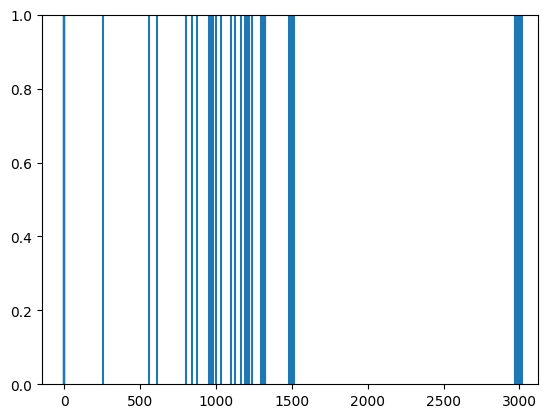

In [114]:
for a,b in zip(v2, np.ones_like(v2)):
    plt.axvline(a)

In [12]:
def plot_cutoff_schemes(
    ml_cutoff: float = 2.0,
    mm_switch_on: float = 5.0, 
    mm_cutoff: float = 0.01,
    r_range: tuple = (0, 20),
    num_points: int = 10000
):
    """
    Plot the ML and MM switching functions.
    
    Args:
        ml_cutoff: Distance where ML potential is cut off
        mm_switch_on: Distance where MM potential starts switching on
        mm_cutoff: Final cutoff for MM potential
        r_range: Tuple of (min_r, max_r) for plotting
        num_points: Number of points to plot
    """
    import matplotlib.pyplot as plt
    import numpy as np
    
    # Generate distance points
    r = np.linspace(r_range[0], r_range[1], num_points)
    distances = r
    # Calculate switching functions
    ml_cutoff_region = mm_switch_on - ml_cutoff
    ml_cutoff_distance = mm_switch_on - ml_cutoff

    switch_on2 = 1 - smooth_switch(r-4, x0=ml_cutoff_region, x1=mm_switch_on)
    switch_on = smooth_switch(r, x0=ml_cutoff_region, x1=mm_switch_on)
    switch_off = 1 - smooth_switch(r - mm_cutoff - mm_switch_on, x0=ml_cutoff_region, x1=mm_switch_on)
    
    ml_cutoff_fn = 1 - smooth_cutoff(r+1, cutoff=ml_cutoff_region)
    switch_off_ml = 1 - smooth_switch(r, x0=mm_switch_on-0.01, x1=mm_switch_on)
    cutoff = 1 - smooth_cutoff(distances, cutoff=ml_cutoff_distance)
    # Calculate combined switching functions
    mm_switching = switch_on * switch_off *switch_on2
    ml_switching = switch_off_ml 
    
    # Create the plot
    plt.figure(figsize=(10, 6))
    plt.plot(r, ml_switching, label='ML Potential', color='blue')
    plt.plot(r, mm_switching, label='MM Potential', color='red')
    
    # Add vertical lines for key distances
    plt.axvline(x=ml_cutoff, color='blue', linestyle='--', alpha=0.5, label='ML Cutoff')
    plt.axvline(x=mm_switch_on, color='red', linestyle='--', alpha=0.5, label='MM Switch-on')
    plt.axvline(x=mm_switch_on + mm_cutoff, color='red', linestyle=':', alpha=0.5, label='MM Cutoff')
    
    # Customize the plot
    plt.xlabel('Distance (Å)')
    plt.ylabel('Switching Function Value')
    plt.title('ML and MM Potential Switching Functions')
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.ylim(-0.1, 1.1)
    
    return plt

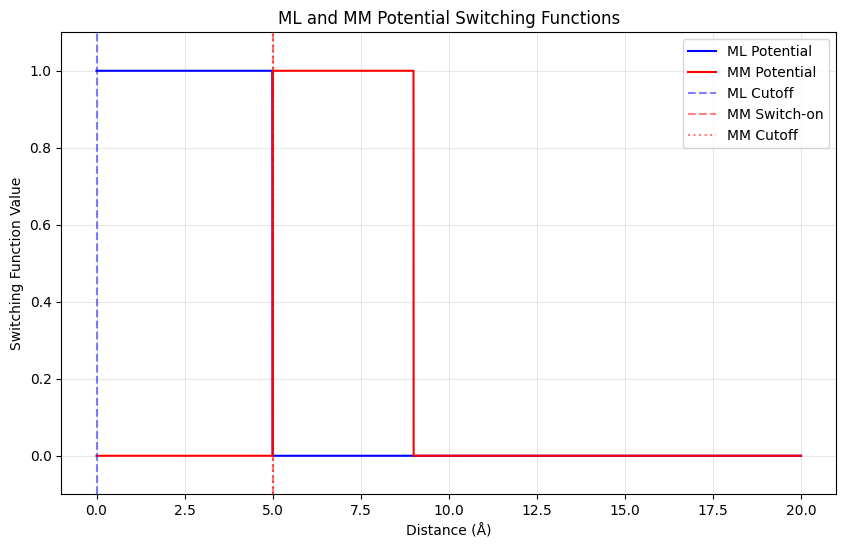

In [13]:
import matplotlib.pyplot as plt
fig = plot_cutoff_schemes(
    ml_cutoff=.001,
    mm_switch_on=5.0,
    mm_cutoff=.001
)
# plt.xlim(4.9, 5.2)
plt.show()

In [19]:
get_spherical_cutoff_calculator = setup_calculator(    
    ml_cutoff_distance=0.01,
    mm_switch_on=5.0,
    mm_cutoff=0.01,
    ep_scale=np.ones(161)*1
)


0 1


IndexError: list index out of range

In [ ]:
get_spherical_cutoff_calculator?

In [14]:

calculator, spherical_cutoff_calculator = get_spherical_cutoff_calculator(
    atomic_numbers[:10], 
     atom_positions[:10],    
    2,
    doML=True,
    doML_dimer=True,
    backprop=False,
    debug=False,
    # ep_scale=np.ones(161)*100000000

)

0 1


IndexError: list index out of range

  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

ModelOutput(energy=Array gpu:0 -33.920, forces=Array[10, 3] n=30 x∈[-0.036, 0.035] μ=-5.122e-10 σ=0.016 gpu:0, dH=Array gpu:0 -0.233, internal_E=Array gpu:0 -33.454, internal_F=Array[10, 3] n=30 x∈[-1.618, 1.420] μ=3.974e-09 σ=0.730 gpu:0, mm_E=Array gpu:0 -0.233, mm_F=Array[10, 3] n=30 x∈[-0.036, 0.035] μ=-5.122e-10 σ=0.016 gpu:0, ml_2b_E=Array gpu:0 0., ml_2b_F=Array gpu:0 0.)

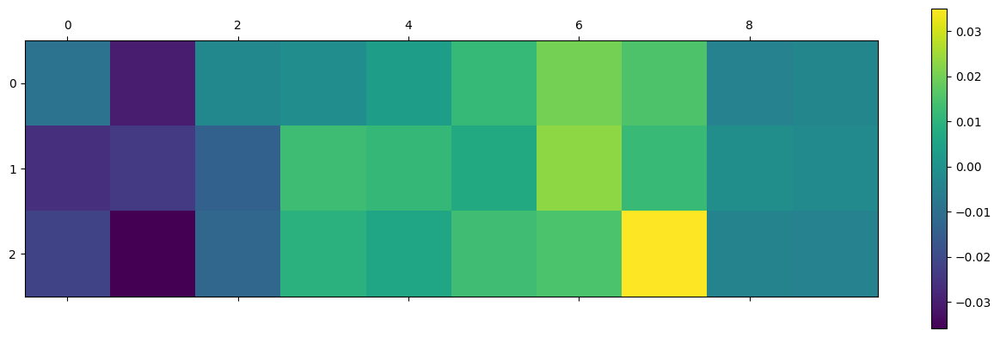

In [74]:
ase_atoms_with_calc = ase.Atoms(atomic_numbers[:10], atom_positions[:10] - atom_positions[:10].T.mean())
ase_atoms_with_calc.calc = calculator
print(ase_atoms_with_calc.get_potential_energy())
f1 = jnp.array(ase_atoms_with_calc.get_forces()).T
plt.matshow(f1)
plt.colorbar()
f1
ase_atoms_with_calc.calc.results["out"]

In [75]:
ase_atoms_with_calc.get_potential_energy()

Array gpu:0 -33.920

In [76]:
backprop_calculator, spherical_cutoff_calculator = get_spherical_cutoff_calculator(
    atomic_numbers[:10], 
     atom_positions[:10],    
    2,
    doML=True,
    doML_dimer=True,
    backprop=True,
    debug=False,
)

In [77]:
backprop_calculator

<__main__.setup_calculator.<locals>.AseDimerCalculator at 0x14d6da43fc80>

  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

Array[3, 10] n=30 x∈[-1.603, 1.373] μ=0. σ=0.730 gpu:0

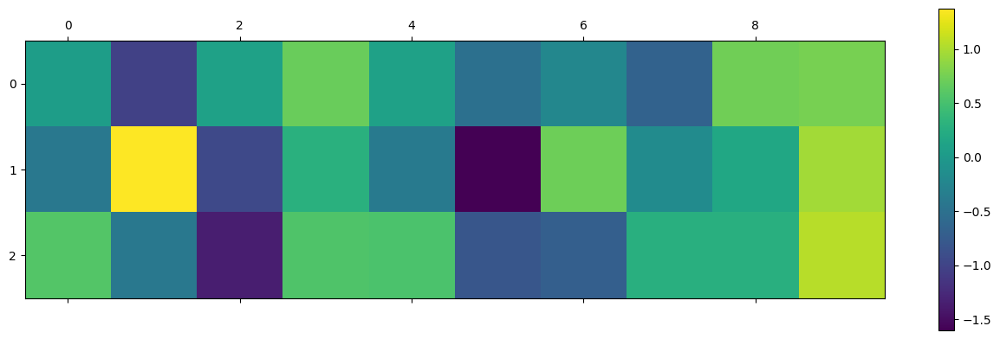

In [78]:
ase_atoms_with_bpcalc = ase.Atoms(atomic_numbers[:10], atom_positions[:10] - atom_positions[:10].T.mean())
ase_atoms_with_bpcalc.calc = backprop_calculator
f1 = jnp.array(ase_atoms_with_bpcalc.get_forces()).T
plt.matshow(f1)
plt.colorbar()
print(ase_atoms_with_bpcalc.get_potential_energy())
f1

In [79]:
ase_atoms_with_bpcalc.get_potential_energy()

Array gpu:0 -33.920

In [80]:
# xyz = pd.DataFrame(atom_positions, columns=["x", "y", "z"])
# coor.set_positions(xyz)
# energy.show()

In [81]:
backprop_calculator.get_potential_energy()

Array gpu:0 -33.920

In [82]:
# ase_atoms_with_calc = ase.Atoms(atomic_numbers, atom_positions - atom_positions.T.mean())
# ase_atoms_with_calc.calc = calculator
# print(ase_atoms_with_calc.get_potential_energy())

# df["filenames"] = df["key"].apply(lambda x: x.lower() + "_modified.pdb")
# df

# def add_out_pred(fn):
#     fn = data_path / "dcmk" / fn
#     pdb_data_mda = get_data_mda(fn)
#     atomic_numbers, atom_positions = (
#         pdb_data_mda["atomic_numbers"],
#         pdb_data_mda["atom_positions"],
#     )
    
#     ase_atoms_with_bpcalc.set_positions(atom_positions)
#     results = ase_atoms_with_calc.calc.results["out"]
#     return results

# all_output = {k: add_out_pred(k) for k in list(df["filenames"]) }


def plot_forces(results):
    print()
    f1 = jnp.array(results.mm_F).T
    plt.matshow(f1)
    plt.colorbar()
    print()
    f1 = jnp.array(results.internal_F).T
    plt.matshow(f1)
    print(results.energy)
    plt.colorbar()
    
    f1 = jnp.array(results.ml_2b_F).T
    plt.matshow(f1)
    plt.colorbar()
    
    f1 = jnp.array(results.forces).T
    plt.matshow(f1)
    plt.colorbar()

In [83]:
# print(ase_atoms_with_calc.get_potential_energy())



Array gpu:0 -33.920


ValueError: not enough values to unpack (expected 2, got 0)

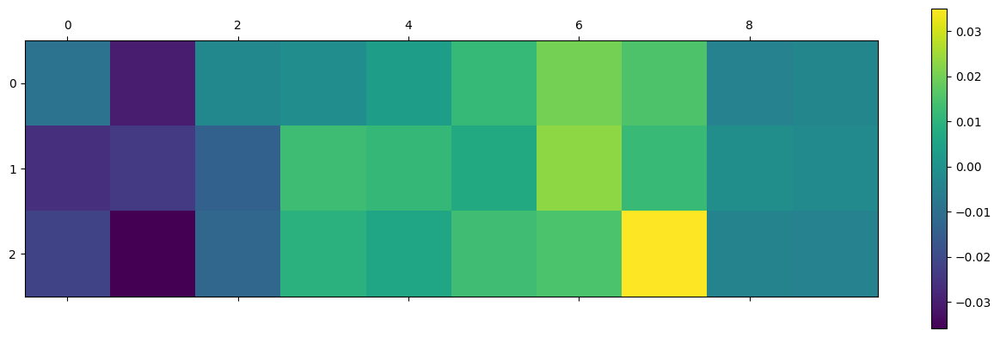

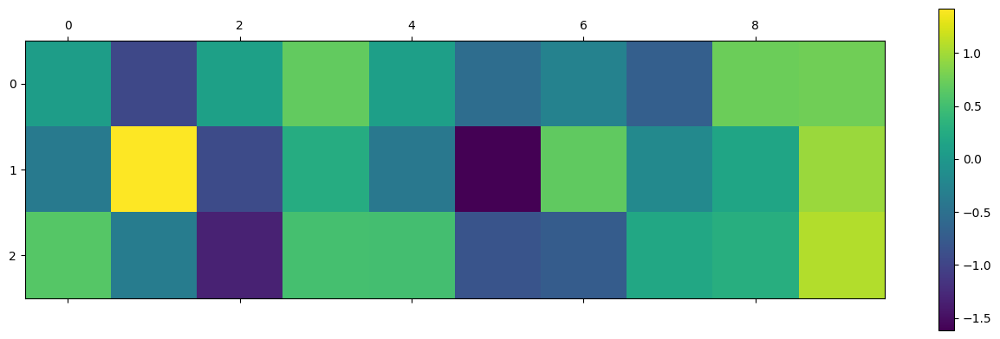

In [84]:
plot_forces(ase_atoms_with_calc.calc.results["out"])

In [ ]:
view_atoms(ase_atoms_with_calc)

In [ ]:
backprop_calculator.results

In [ ]:
# def add_e_pred(fn):
#     fn = data_path / "dcmk" / fn
#     pdb_data_mda = get_data_mda(fn)
#     atomic_numbers, atom_positions = (
#         pdb_data_mda["atomic_numbers"],
#         pdb_data_mda["atom_positions"],
#     )
    
#     ase_atoms_with_bpcalc.set_positions(atom_positions)
#     atomic_contribution = Eref[atomic_numbers].sum()
#     e_pred = ase_atoms_with_bpcalc.get_potential_energy()
#     e_pred = e_pred / ase.units.Hartree + atomic_contribution
#     return float(e_pred)

# df["cluster_energy_pred"] =  df["filenames"].apply(lambda x: add_e_pred(x))
# df

In [ ]:
# results = ase_atoms_with_calc.calc.results["out"]
# print(results)
# _ = (df["cluster_energy_pred"] - df["Cluster Energy"])*627.5
# _.mean()
# gt_z = (df["Cluster Energy"] - df["Cluster Energy"].mean())*627.5
# pred_z =  -(df["cluster_energy_pred"] - df["cluster_energy_pred"].mean())*627.5
# plt.scatter(gt_z, pred_z)
# ax  = plt.gca()
# # ax.transAxes
# plt.plot([0,1], [0,1], transform=ax.transAxes)
# ax.set_aspect("equal")
# # plt.xlim(df["cluster_energy_pred"].min(), df["cluster_energy_pred"].max())
# # plt.ylim(df["cluster_energy_pred"].min(), df["cluster_energy_pred"].max())

# DImers

In [86]:
dimers_data = np.load(Path("/pchem-data/meuwly/boittier/home/dcm_dimers_MP2_20999.npz"))
dimers_data["R"].shape

(20999, 10, 3)

In [87]:
# ase_atoms_with_calc.set_positions(dimers_data["R"][0])
# ase_atoms_with_calc.get_forces()
# results = ase_atoms_with_calc.calc.results["out"]
# print(results.forces)
# print(results.energy )
# print(results)
# print(ase_atoms_with_bpcalc.get_forces())
# print(ase_atoms_with_bpcalc.get_potential_energy())
?setup_calculator

Signature:
setup_calculator(
    ATOMS_PER_MONOMER: int = 5,
    N_MONOMERS: int = 2,
    ml_cutoff_distance: float = 2.0,
    mm_switch_on: float = 5.0,
    mm_cutoff: float = 1.0,
    doML: bool = True,
    doMM: bool = True,
    doML_dimer: bool = True,
    debug: bool = False,
    ep_scale=None,
    sig_scale=None,
)
Docstring: <no docstring>
File:      /tmp/ipykernel_435843/1877199386.py
Type:      function

In [88]:
import seaborn as sns



def objective(x0, plot=False):
    print(x0)
    # [1, 66, 138]
    ep_scale = np.ones(161)
    sig_scale = np.ones(161)
    
    ep_scale[66] = x0[1]
    ep_scale[138] = x0[2]
    sig_scale[66] = x0[3]
    sig_scale[138] = x0[4]

    if plot:
        fig = plot_cutoff_schemes(
            ml_cutoff=0.01,
            mm_switch_on=x0[0],
            mm_cutoff=0.01
        )
        # plt.xlim(4.9, 5.2)
        plt.show()
    
    get_spherical_cutoff_calculator = setup_calculator(    
        ml_cutoff_distance=0.01,
        mm_switch_on=x0[0],
        mm_cutoff=0.01,
        ep_scale=ep_scale,
        sig_scale=sig_scale
    )
    
    backprop_calculator, spherical_cutoff_calculator = get_spherical_cutoff_calculator(
        atomic_numbers[:10], 
         atom_positions[:10],    
        2,
        doML=True,
        doML_dimer=True,
        backprop=True,
        debug=False,
    )
    
    ase_atoms_with_bpcalc.calc = backprop_calculator
    c = ase_atoms_with_bpcalc
    # c = ase_atoms_with_calc
    
    outs = []
    forces_pred = []
    forces_true = []
    distances = []
    energy_pred = []
    energy_true = []
    co = 0

    import random
    random.seed(42)
    # List of items
    mm_switch_on = x0[0]

    # Randomly select 2 items without repetition
    selected_items = list(range(len(dimers_data["Z"])))
    selected_items = [i for i in selected_items if dimers_data["Z"][i][5] != 0]
    selected_items = random.sample(selected_items, 100)
    # selected_items = [i for i in selected_items if dimers_data["Z"][i][5] != 0]
    for i in selected_items:       
        distance = np.linalg.norm(dimers_data["R"][i][:5].T.mean() - dimers_data["R"][i][5:].T.mean())
        if distance > mm_switch_on:
            co += 1
            c.set_positions(dimers_data["R"][i][[0, 3, 4, 1, 2, 5, 8, 9, 6, 7]])
            distances.append([distance]*30)
            forces_true.append(jnp.array(dimers_data["F"][i]).flatten() )
            forces_pred.append(c.get_forces().flatten()  )
            Eref_add = Eref[c.get_atomic_numbers()].sum()
            energy_true.append([jnp.array(dimers_data["E"][i]).flatten()  ]*30)
            energy_pred.append([c.get_potential_energy()  ]*30)
            outs.append(c.calc.results["out"])
    
    
    r_key = "$r$"
    error_key = "error"
    se_key = "SE"
    abs_err_key = "abs$(error)$"
    F_true_key = "$F_{\\mathrm{True}}$"
    F_pred_key = "$F_{\\mathrm{pred}}$"
    absF_true_key = "abs($F_{\\mathrm{True}}$)"
    absF_pred_key = "abs($F_{\\mathrm{pred}}$)"
    epred_key = "Etrue"
    etrue_key = "Epred"
    
    __df__ = pd.DataFrame({r_key: np.array(distances).flatten(),
                           error_key: jnp.array(forces_pred).flatten() - jnp.array(forces_true).flatten(),
                           se_key: (jnp.array(forces_pred).flatten() - jnp.array(forces_true).flatten())**2,
                           abs_err_key: abs(jnp.array(forces_pred).flatten() - jnp.array(forces_true).flatten()), 
                          F_true_key : (jnp.array(forces_true).flatten()),
                          F_pred_key :  (jnp.array(forces_pred).flatten()), #(ase.units.kcal/ase.units.mol) ,
                          absF_true_key : abs(jnp.array(forces_true).flatten()),
                          absF_pred_key : abs(jnp.array(forces_pred).flatten()),
                          epred_key :np.array(energy_pred).flatten() - np.array(energy_pred).flatten().mean(),
                        etrue_key: np.array(energy_true).flatten() - np.array(energy_true).flatten().mean()
                          })



    
    if plot:    
        # Show the joint distribution using kernel density estimation
        g = sns.jointplot(
            data=__df__,
            x="Epred", y="Etrue", hue=r_key,
            # kind="kde",
        )
        
        plt.plot([-0.5,0.5], [-0.5,0.5], color="k", linestyle="--")
        plt.xlim(-0.5, 0.5)
        plt.ylim(-0.5, 0.5)
        
        
        
        # sns.regplot(
        #     data=__df__[__df__[r_key] < mm_switch_on],
        #     x=r_key, y=abs_err_key, 
        #     scatter=False, truncate=True, order=1, color=".2",
        # )
        
        plt.show()
        
        # Show the joint distribution using kernel density estimation
        g = sns.jointplot(
            data=__df__,
            x=r_key, y=abs_err_key, hue=absF_true_key,
            # kind="kde",
        )
        sns.regplot(
            data=__df__[__df__[r_key] < mm_switch_on],
            x=r_key, y=abs_err_key, 
            scatter=False, truncate=True, order=1, color=".2",
        )
        
        sns.regplot(
            data=__df__[__df__[r_key] > mm_switch_on],
            x=r_key, y=abs_err_key, 
            scatter=False, truncate=True, order=1, color=".3",
        )
        
        plt.xlim(0, 7)
        # plt.ylim(-2, 2)
        
        
        plt.show()
        
        
        
        g = sns.jointplot(
            data=__df__,
            x=r_key, y=F_true_key, hue=abs_err_key,
            # kind="kde",
        )
        
        sns.regplot(
            data=__df__,
            x=r_key, y=F_true_key,
            scatter=False, truncate=True, order=3, color=".2",
        )
        
        plt.show()
        
        g = sns.jointplot(
            data=__df__,
            x=F_true_key, y=F_pred_key, hue=r_key,
            alpha=0.5,
            # kind="kde",
        )
        
        plt.plot([-2,2], [-2, 2], color="k", linestyle="--", linewidth=0.5)
        
        plt.xlim(-2, 2)
        plt.ylim(-2, 2)
        
        plt.show()

    
    loss = __df__[se_key].mean() * 3 + (((  __df__["Epred"] - __df__["Etrue"])**2).mean() * 30) * 3
    print(loss)
    print(co)
    print((__df__[se_key].mean())**0.5)
    print((((  __df__["Epred"] - __df__["Etrue"])**2).mean() * 30) ** 0.5)
    return loss


[6, 1, 1, 1, 1]


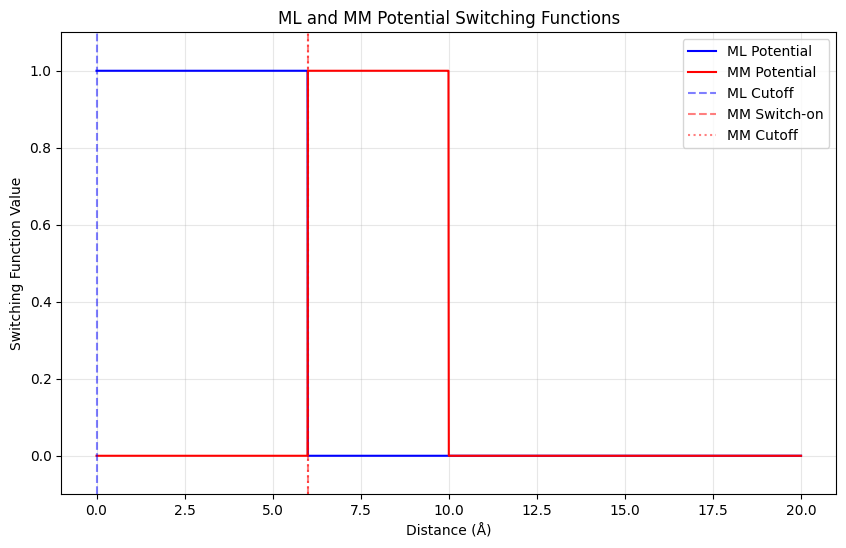

0 1


/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/orbax/checkpoint/type_handlers.py:1372: UserWarning: Couldn't find sharding info under RestoreArgs. Populating sharding info from sharding file. Please note restoration time will be slightly increased due to reading from file instead of directly from RestoreArgs. Note also that this option is unsafe when restoring on a different topology than the checkpoint was saved with.
  warnings.warn(


dict_keys(['opt_state', 'params', 'step'])


                                                 Model Attributes                                                  
┏━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃ charg… ┃ cutoff ┃ debug ┃ efa   ┃ featu… ┃ max_a… ┃ max_d… ┃ n_res ┃ natoms ┃ num_b… ┃ num_it… ┃ total… ┃ zbl   ┃
┡━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ False  │ 10.0   │ False │ False │ 128    │ 18     │ 0      │ 3     │ 10     │ 64     │ 5       │ 0      │ False │
└────────┴────────┴───────┴───────┴────────┴────────┴────────┴───────┴────────┴────────┴─────────┴────────┴───────┘

                                                  Last Checkpoint                                                  
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Checkpoint                                 ┃ name      ┃ epoch ┃ best_loss         ┃ Save Time                  ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ /pchem-data/meuwly/boittier/home/pycharmm… │ epoch-996 │ 996   │ Array gpu:0 0.001 │ 2025-04-09 00:25:43.147267 │
└────────────────────────────────────────────┴───────────┴───────┴───────────────────┴────────────────────────────┘

  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

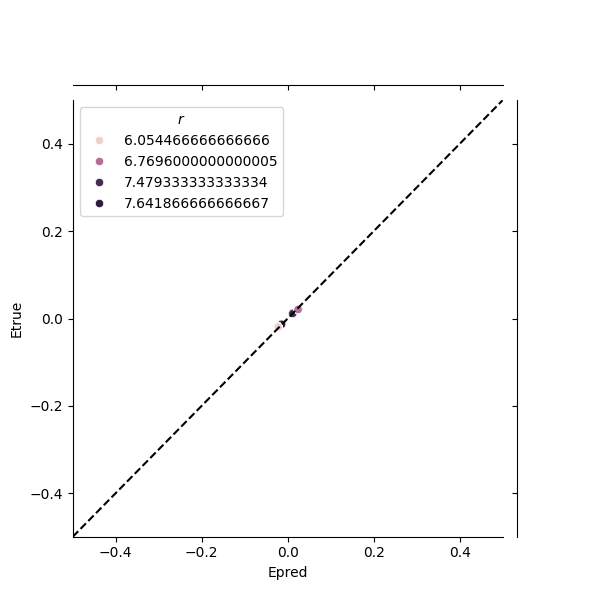

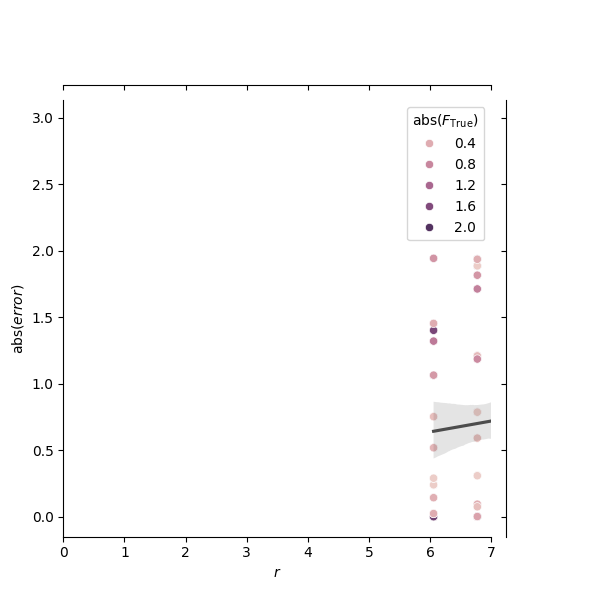

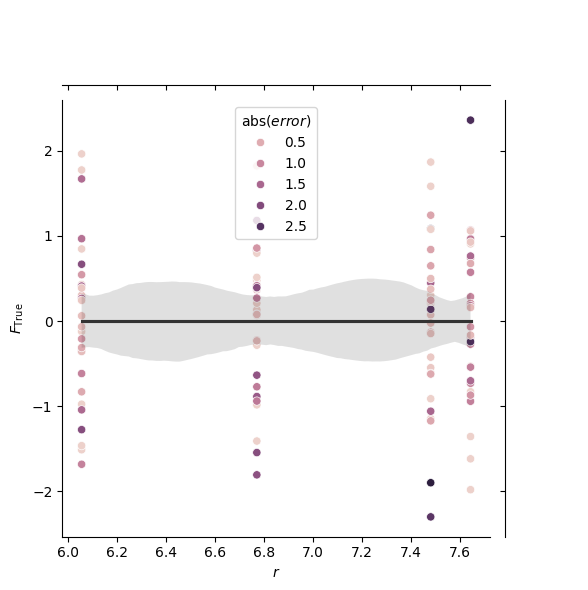

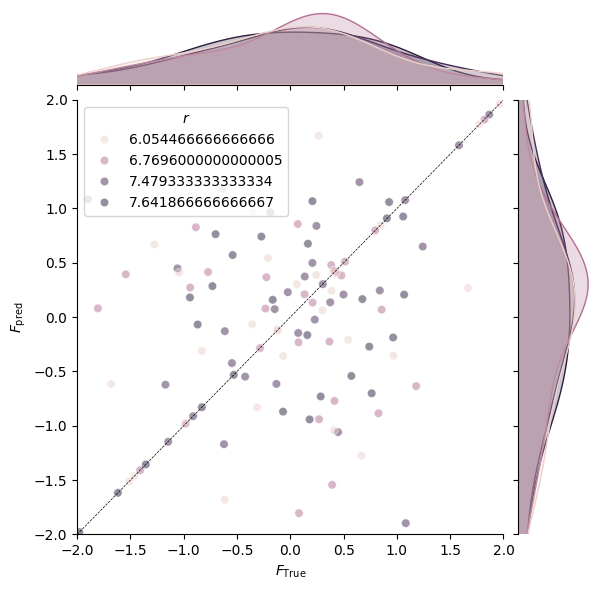

3.221887729082482
4
1.036244522098654
0.01264384361496126


3.221887729082482

In [89]:
objective([6, 1, 1, 1, 1], plot=True)


[4.00022052, 0.99998334, 0.999804, 1.09999745, 0.99998033]


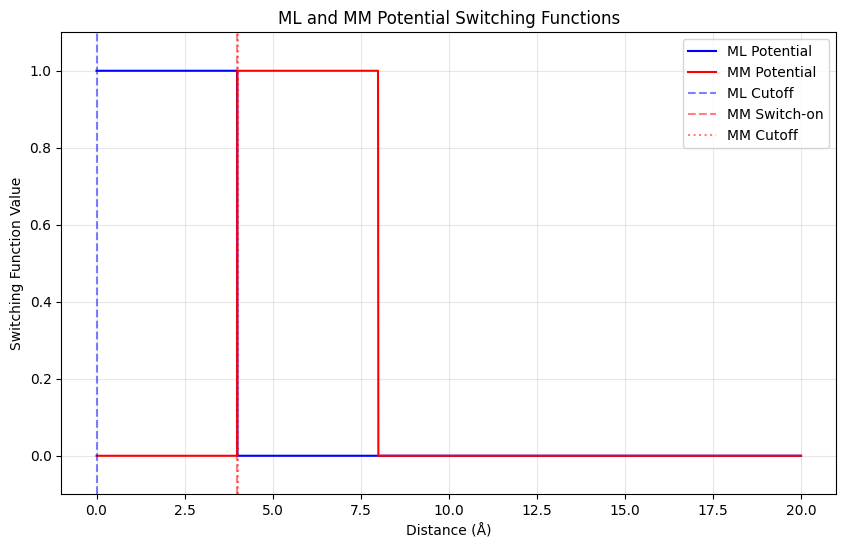

0 1


/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/orbax/checkpoint/type_handlers.py:1372: UserWarning: Couldn't find sharding info under RestoreArgs. Populating sharding info from sharding file. Please note restoration time will be slightly increased due to reading from file instead of directly from RestoreArgs. Note also that this option is unsafe when restoring on a different topology than the checkpoint was saved with.
  warnings.warn(


dict_keys(['opt_state', 'params', 'step'])


                                                 Model Attributes                                                  
┏━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃ charg… ┃ cutoff ┃ debug ┃ efa   ┃ featu… ┃ max_a… ┃ max_d… ┃ n_res ┃ natoms ┃ num_b… ┃ num_it… ┃ total… ┃ zbl   ┃
┡━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ False  │ 10.0   │ False │ False │ 128    │ 18     │ 0      │ 3     │ 10     │ 64     │ 5       │ 0      │ False │
└────────┴────────┴───────┴───────┴────────┴────────┴────────┴───────┴────────┴────────┴─────────┴────────┴───────┘

                                                  Last Checkpoint                                                  
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Checkpoint                                 ┃ name      ┃ epoch ┃ best_loss         ┃ Save Time                  ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ /pchem-data/meuwly/boittier/home/pycharmm… │ epoch-996 │ 996   │ Array gpu:0 0.001 │ 2025-04-09 00:25:43.147267 │
└────────────────────────────────────────────┴───────────┴───────┴───────────────────┴────────────────────────────┘

  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

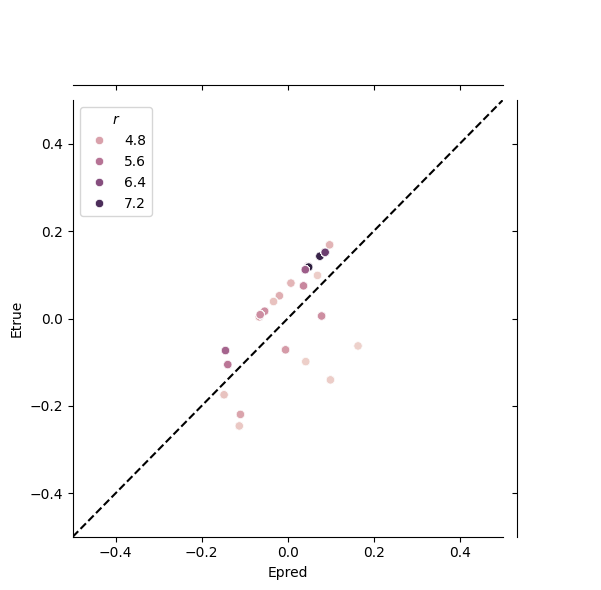

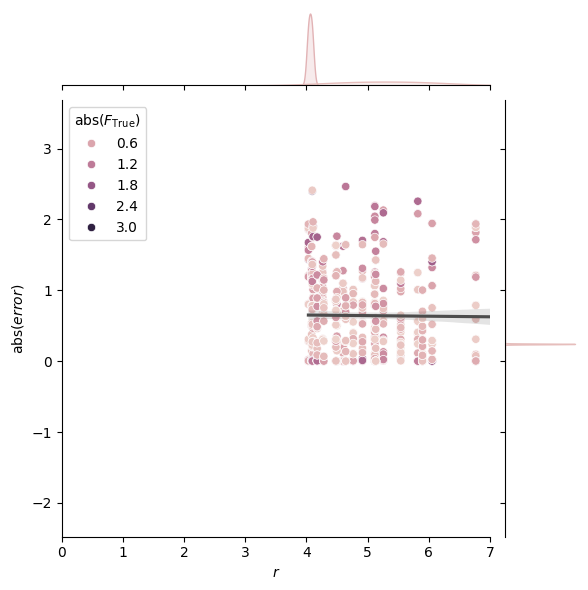

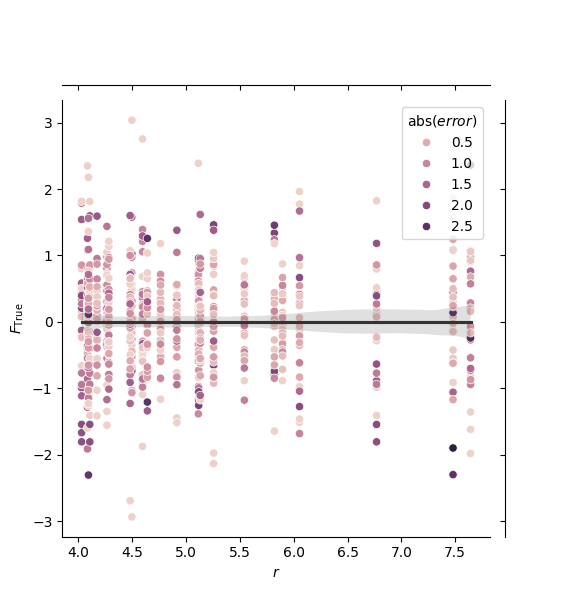

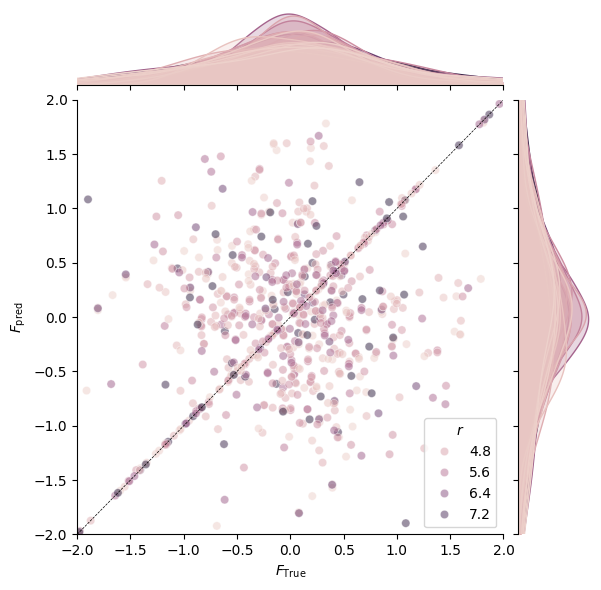

3.227265553548932
24
0.8826577042432445
0.5446747301430055


3.227265553548932

In [90]:
x0 = [4.00022052, 0.99998334, 0.999804,   1.09999745, 0.99998033]
objective(x0, plot=True)

In [ ]:
def create_initial_simplex(x0, delta=0.1):
    initial_simplex = np.zeros((len(x0) + 1, len(x0)))
    initial_simplex[0] = x0  # First point is x0
    for i in range(len(x0)):
        initial_simplex[i + 1] = x0.copy()
        initial_simplex[i + 1, i] += delta  # Add small step in dimension i
    return initial_simplex


def optimize_params_simplex(x0, bounds, 
loss, method="Nelder-Mead", maxiter=100, xatol=0.0001, fatol=0.0001):
    initial_simplex = create_initial_simplex(x0)
    res = minimize(
        loss,
        x0=x0,
        method="Nelder-Mead",
        bounds=bounds,
        options={
            "xatol": 0.001,  # Absolute tolerance on x
            "fatol": 0.001,  # Absolute tolerance on function value
            "initial_simplex": initial_simplex,
            "maxiter": 100,
        },
    )  # Initial simplex with steps of 0.0001

    print(res)
    return res
    
def get_bounds(x0, scale=0.9):
    b= [(x0[i] * (1-scale), x0[i] * (1+scale)) if x0[i] > 0 else (x0[i] * (1+scale), x0[i] * (1-scale)) 
    for i in range(len(x0)) ]
    return b

In [ ]:
x0 = [4,1,1,1,1]
bounds = get_bounds(x0)
bounds[0] = (2,6)
optimize_params_simplex(x0, get_bounds(x0), objective)

In [91]:
view_atoms(c)

NameError: name 'c' is not defined

In [92]:
# np.array(energy_true).flatten()[::30].mean()
# # Eref[]
__df__

NameError: name '__df__' is not defined

In [93]:
__df__.describe()

NameError: name '__df__' is not defined

In [94]:
s = plt.scatter(,
            , 
            facecolors='none', c=, alpha=0.5, cmap="plasma")

plt.colorbar(s)

SyntaxError: invalid syntax (1400000203.py, line 1)

In [95]:
len(distances)

NameError: name 'distances' is not defined

In [ ]:
for i in range(100):
    ase_atoms_with_bpcalc.set_positions(dimers_data["R"][-1*i][[0, 3, 4, 1, 2, 5, 8, 9, 6, 7]])
    # ase_atoms_with_calc.set_positions(dimers_data["R"][i][[0, 3, 4, 1, 2, 5, 8, 9, 6, 7]])
    # plt.scatter(jnp.array(dimers_data["F"][i]).flatten(), ase_atoms_with_calc.get_forces().flatten(), color="k", alpha=1)
    plt.scatter(jnp.array(dimers_data["F"][i]).flatten(), ase_atoms_with_bpcalc.get_forces().flatten(), color="r", alpha=0.4)

In [1373]:
setup_calculator?

Signature:
setup_calculator(
    ATOMS_PER_MONOMER: int = 5,
    N_MONOMERS: int = 2,
    ml_cutoff_distance: float = 2.0,
    mm_switch_on: float = 5.0,
    mm_cutoff: float = 1.0,
    doML: bool = True,
    doMM: bool = True,
    doML_dimer: bool = True,
    debug: bool = False,
    ep_scale=None,
    sig_scale=None,
)
Docstring: <no docstring>
File:      /tmp/ipykernel_387373/679687211.py
Type:      function

In [1372]:
import lovely_jax  as lj
lj.lovely(f1.T, depth=5)

Array[10, 3] n=30 x∈[-1.603, 1.373] μ=3.974e-09 σ=0.730 gpu:0
  Array[3] x∈[-0.416, 0.574] μ=0.070 σ=0.404 gpu:0 [0.052, -0.416, 0.574]
  Array[3] x∈[-1.025, 1.373] μ=-0.020 σ=1.017 gpu:0 [-1.025, 1.373, -0.409]
  Array[3] x∈[-1.351, 0.102] μ=-0.732 σ=0.613 gpu:0 [0.102, -0.946, -1.351]
  Array[3] x∈[0.286, 0.691] μ=0.508 σ=0.167 gpu:0 [0.691, 0.286, 0.548]
  Array[3] x∈[-0.376, 0.529] μ=0.085 σ=0.369 gpu:0 [0.101, -0.376, 0.529]
  Array[3] x∈[-1.603, -0.509] μ=-0.972 σ=0.463 gpu:0 [-0.509, -1.603, -0.803]
  Array[3] x∈[-0.700, 0.722] μ=-0.070 σ=0.592 gpu:0 [-0.231, 0.722, -0.700]
  Array[3] x∈[-0.671, 0.277] μ=-0.186 σ=0.387 gpu:0 [-0.671, -0.164, 0.277]
  Array[3] x∈[0.164, 0.732] μ=0.391 σ=0.246 gpu:0 [0.732, 0.164, 0.277]
  ...

In [96]:

# N_MONOMERS
get_spherical_cutoff_calculator = setup_calculator(    
    N_MONOMERS=20,
    ml_cutoff_distance=0.01,
    mm_switch_on=6.0,
    mm_cutoff=0.01,
    ep_scale=np.ones(161)*1
)

backprop_calculator, spherical_cutoff_calculator = get_spherical_cutoff_calculator(
    atomic_numbers, 
     atom_positions,    
    20,
    doML=True,
    doML_dimer=True,
    backprop=True,
    debug=False,
)

0 1
2 3
4 5
6 7
8 9
10 11
12 13
14 15
16 17
18 19


/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/orbax/checkpoint/type_handlers.py:1372: UserWarning: Couldn't find sharding info under RestoreArgs. Populating sharding info from sharding file. Please note restoration time will be slightly increased due to reading from file instead of directly from RestoreArgs. Note also that this option is unsafe when restoring on a different topology than the checkpoint was saved with.
  warnings.warn(


dict_keys(['opt_state', 'params', 'step'])


                                                 Model Attributes                                                  
┏━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃ charg… ┃ cutoff ┃ debug ┃ efa   ┃ featu… ┃ max_a… ┃ max_d… ┃ n_res ┃ natoms ┃ num_b… ┃ num_it… ┃ total… ┃ zbl   ┃
┡━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ False  │ 10.0   │ False │ False │ 128    │ 18     │ 0      │ 3     │ 10     │ 64     │ 5       │ 0      │ False │
└────────┴────────┴───────┴───────┴────────┴────────┴────────┴───────┴────────┴────────┴─────────┴────────┴───────┘

                                                  Last Checkpoint                                                  
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Checkpoint                                 ┃ name      ┃ epoch ┃ best_loss         ┃ Save Time                  ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ /pchem-data/meuwly/boittier/home/pycharmm… │ epoch-996 │ 996   │ Array gpu:0 0.001 │ 2025-04-09 00:25:43.147267 │
└────────────────────────────────────────────┴───────────┴───────┴───────────────────┴────────────────────────────┘

In [97]:
fn = data_path / "dcmk" / "100_lig_2_modified.pdb"

pdb_data_mda = get_data_mda(fn)
atomic_numbers, atom_positions = (
    pdb_data_mda["atomic_numbers"],
    pdb_data_mda["atom_positions"],
)
xyz = pd.DataFrame(atom_positions, columns=["x", "y", "z"])
coor.set_positions(xyz)
ase_atoms_with_bpcalc  =ase.Atoms(atomic_numbers,atom_positions)
ase_atoms_with_bpcalc.calc = backprop_calculator
# ase_atoms_with_bpcalc.set_positions(atom_positions)

/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/MDAnalysis/topology/PDBParser.py:331: UserWarning: Element information is missing, elements attribute will not be populated. If needed these can be guessed using MDAnalysis.topology.guessers.
  warnings.warn("Element information is missing, elements attribute "


# Forces

In [98]:
# plt.set_cmap('jet')
# from ase.calculators.test import gradient_test
# f, fn = gradient_test(ase_atoms_with_bpcalc, indices=np.arange(0,10,1))
# plt.matshow(np.array(ase_atoms_with_bpcalc.get_forces()).T)
# plt.colorbar()
# plt.matshow((f - jnp.array(fn)).T)
# plt.colorbar()


  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

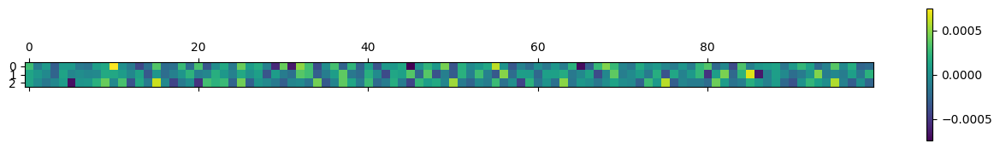

In [99]:
import ase.optimize as ase_opt
# Run structure optimization with BFGS.
_ = ase_opt.BFGS(ase_atoms_with_bpcalc).run(fmax=0.001,steps=20)
plt.matshow(np.array(ase_atoms_with_bpcalc.get_forces()).T)
plt.colorbar()

In [100]:
# import ase.optimize as ase_opt
# ase_atoms_with_calc.set_positions(ase_atoms_with_bpcalc.get_positions())
# # Run structure optimization with BFGS.
# _ = ase_opt.BFGS(ase_atoms_with_calc).run(fmax=0.001,steps=20)
# plt.matshow(np.array(ase_atoms_with_calc.get_forces()).T)
# plt.colorbar()

In [101]:
view_atoms(ase_atoms_with_bpcalc)

In [102]:
# view_atoms(ase_atoms_with_calc)

In [103]:
# f, jnp.array(fn)
0.1 / 1000

0.0001

In [104]:
# view_atoms(ase_atoms_with_calc)

In [105]:
import io
import ase
import ase.calculators.calculator as ase_calc
import ase.io as ase_io
from ase.md.velocitydistribution import MaxwellBoltzmannDistribution, Stationary, ZeroRotation
from ase.md.verlet import VelocityVerlet
import ase.optimize as ase_opt
import matplotlib.pyplot as plt
import py3Dmol

In [106]:
# Parameters.
temperature = 200.0
timestep_fs = 0.1
num_steps = 10_000

print(num_steps * timestep_fs / 1000, " ps")

atoms = ase_atoms_with_bpcalc

# Draw initial momenta.
MaxwellBoltzmannDistribution(atoms, temperature_K=temperature)
Stationary(atoms)  # Remove center of mass translation.
ZeroRotation(atoms)  # Remove rotations.

# Initialize Velocity Verlet integrator.
integrator = VelocityVerlet(atoms, timestep=timestep_fs*ase.units.fs)

# Run molecular dynamics.
frames = np.zeros((num_steps, len(atoms), 3))
dipoles = np.zeros((num_steps, 1, 3))
potential_energy = np.zeros((num_steps,))
kinetic_energy = np.zeros((num_steps,))
total_energy = np.zeros((num_steps,))
for i in range(num_steps):
  # Run 1 time step.
  integrator.run(1)
  # Save current frame and keep track of energies.
  frames[i] = atoms.get_positions()
  potential_energy[i] = atoms.get_potential_energy()
  kinetic_energy[i] = atoms.get_kinetic_energy()
  total_energy[i] = atoms.get_total_energy()
  # dipoles[i]=atoms.get_dipole_moment()
  # Occasionally print progress.q
  if i % 1000 == 0 and temperature < 300.0:
      temperature += i // 100
  else:
      temperature = 300.0
  if i % 1000 == 0:
      print(temperature)
      MaxwellBoltzmannDistribution(atoms, temperature_K=temperature)
      # Stationary(atoms)  # Remove center of mass translation.
  #     # ZeroRotation(atoms)  # Remove rotations.
  if i % 50 == 0:
      Stationary(atoms)  # Remove center of mass translation.
      print(f"step {i:5d} epot {potential_energy[i]: 5.3f} ekin {kinetic_energy[i]: 5.3f} etot {total_energy[i]: 5.3f}")

  if jnp.isnan(total_energy[i]) or total_energy[i] > 0:
      break



1.0  ps
200.0
step     0 epot -337.563 ekin  2.524 etot -335.039
step    50 epot -336.839 ekin  1.983 etot -334.856
step   100 epot -336.670 ekin  1.812 etot -334.858
step   150 epot -336.939 ekin  2.082 etot -334.858
step   200 epot -336.909 ekin  2.053 etot -334.856
step   250 epot -336.723 ekin  1.865 etot -334.857
step   300 epot -336.345 ekin  1.490 etot -334.855
step   350 epot -336.588 ekin  1.733 etot -334.855
step   400 epot -336.762 ekin  1.906 etot -334.855
step   450 epot -336.646 ekin  1.790 etot -334.856
step   500 epot -336.550 ekin  1.694 etot -334.856
step   550 epot -336.821 ekin  1.966 etot -334.855
step   600 epot -336.700 ekin  1.848 etot -334.853
step   650 epot -336.734 ekin  1.878 etot -334.856
step   700 epot -336.827 ekin  1.971 etot -334.856
step   750 epot -336.691 ekin  1.834 etot -334.857
step   800 epot -336.590 ekin  1.735 etot -334.855
step   850 epot -336.665 ekin  1.810 etot -334.855
step   900 epot -336.960 ekin  2.105 etot -334.855
step   950 epot -

In [120]:
# # Write structure to xyz file.
# xyz = io.StringIO()
# ase_io.write(xyz, atoms, format='xyz')

# # Visualize the structure with py3Dmol.
# view3d = py3Dmol.view()
# view3d.addModel(xyz.getvalue(), 'xyz')
# view3d.setStyle({'stick': {'radius': 0.05}, 'sphere': {'scale': 0.25}})
# # view3d.show()
# view3d.getModel().setCoordinates(frames[::10], 'array')
# view3d.animate({'loop': None, 'interval': 0.1})
# view3d.show()

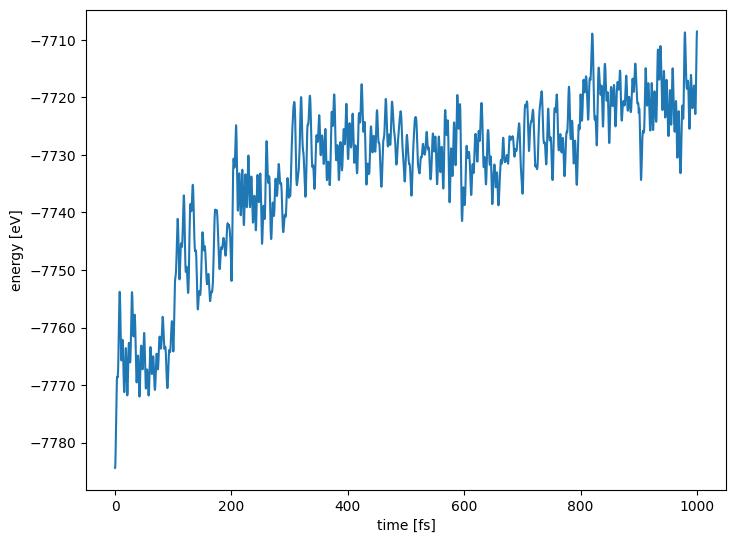

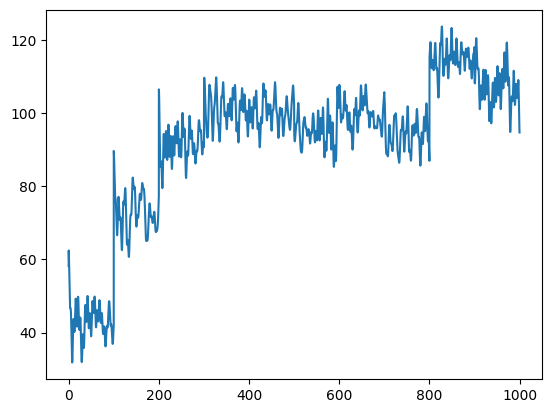

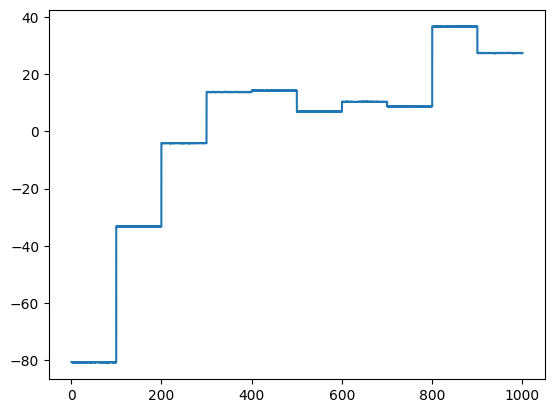

In [113]:
# %matplotlib inline
plt.subplots_adjust(left=0, right=1, bottom=0, top=1)
plt.xlabel('time [fs]')
plt.ylabel('energy [eV]')
time = np.arange(num_steps) * timestep_fs
plt.plot(time, potential_energy/ (ase.units.kcal/ase.units.mol), label='potential energy')
plt.show()
plt.plot(time, kinetic_energy / (ase.units.kcal/ase.units.mol), label='kinetic energy')
plt.show()
te = total_energy / (ase.units.kcal/ase.units.mol)
te -= te.mean()
plt.plot(time[10:], te[10:], label='total energy')
# plt.ylim(0, 1000)
plt.show()
# plt.legend()
# plt.grid()

(array([  1.,   5.,  39., 116., 211., 319., 190.,  83.,  23.,   3.]),
 array([-0.00425532, -0.00345576, -0.0026562 , -0.00185664, -0.00105708,
        -0.00025752,  0.00054204,  0.0013416 ,  0.00214116,  0.00294072,
         0.00374028]),
 <BarContainer object of 10 artists>)

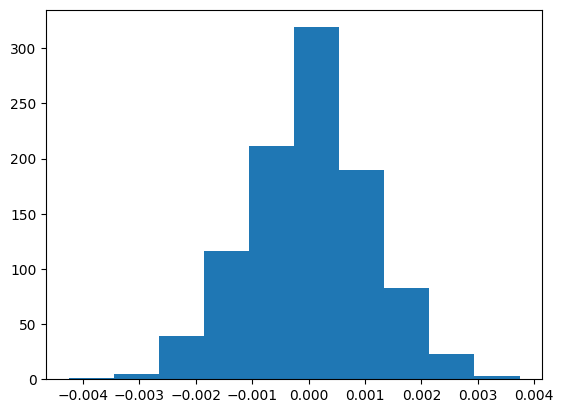

In [1424]:
plt.hist(total_energy[10:1000] - total_energy[10:1000].mean())

In [1432]:
# partition.neighbor_list?
    # ml_cutoff_distance=0.01,
    # mm_switch_on=6.0,
    # mm_cutoff=0.01,

CutoffParameters?

Init signature:
CutoffParameters(
    ml_cutoff: float = 2.0,
    mm_switch_on: float = 5.0,
    mm_cutoff: float = 1.0,
)
Docstring:      Parameters for ML and MM cutoffs and switching functions
Init docstring:
Args:
    ml_cutoff: Distance where ML potential is cut off
    mm_switch_on: Distance where MM potential starts switching on
    mm_cutoff: Final cutoff for MM potential
Type:           type
Subclasses:     

# JAX MD

In [468]:
from jax_md import partition
from jax_md import space
import jax.numpy as np
from jax import random
from jax import jit
from jax import lax
from jax import ops

import time

from jax_md import space, smap, energy, minimize, quantity, simulate

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import jax
import jax.numpy as jnp
import jax_md
import numpy as np

from ase.io import read as ase_read
from jax_md import units
from typing import Dict

# from so3lr import to_jax_md
# from so3lr import So3lrPotential

import time





In [494]:
# Using float32 for positions / velocities, but float64 for reductions.
# dtype = np.float64

fn = data_path / "dcmk" / "100_lig_80_modified.pdb"

pdb_data_mda = get_data_mda(fn)
atomic_numbers, atom_positions = (
    pdb_data_mda["atomic_numbers"],
    pdb_data_mda["atom_positions"],
)
# xyz = pd.DataFrame(at

R = atom_positions #ase_atoms_with_bpcalc.get_positions()


@jit
def jax_md_energy_fn(position, **kwargs):
  l_nbrs = nbrs.update(jnp.array(position))
  return spherical_cutoff_calculator(position, atomic_numbers, n_monomers=20, cutoff_params=CutoffParameters()).energy #* (ase.units.kcal/ase.units.mol)

BOXSIZE = 30
displacement, shift = space.periodic(BOXSIZE, wrapped=False)
_, dummy_shift = space.free()
# CUTOFF = BOXSIZE/2
neighbor_fn = partition.neighbor_list(displacement, None, 30/2, format=partition.Sparse, dtype=jnp.float64)

/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/MDAnalysis/topology/PDBParser.py:331: UserWarning: Element information is missing, elements attribute will not be populated. If needed these can be guessed using MDAnalysis.topology.guessers.
  warnings.warn("Element information is missing, elements attribute "
/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/jax/_src/numpy/lax_numpy.py:5191: FutureWarning: None encountered in jnp.array(); this is currently treated as NaN. In the future this will result in an error.
  return array(a, dtype=dtype, copy=bool(copy), order=order, device=device)


In [495]:
nbrs = neighbor_fn.allocate(R)
# R.shape, R

In [496]:
jax_md_grad_fn = jax.grad(jax_md_energy_fn)

jax_md_energy_fn(R)

  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

Array gpu:0 -334.582

In [497]:
jax_md_grad_fn(R)

Array[100, 3] n=300 (1.2Kb) x∈[-2.346, 2.541] μ=4.085e-07 σ=0.731 gpu:0

In [498]:
from jax_md import minimize

# init_fn, step_fn = minimize.fire_descent(jax_md_energy_fn, shift, dt_start=0.001, dt_max=0.001)
unwrapped_init_fn, unwrapped_step_fn = minimize.fire_descent(jax_md_energy_fn, shift, dt_start=0.001, dt_max=0.001)
unwrapped_step_fn = jit(unwrapped_step_fn)

In [499]:
try:
    del fire_state
except NameError:
    pass

fire_state = unwrapped_init_fn(R)

positions = []

for i in range(1000):

  positions += [fire_state.position]
  fire_state = jit(unwrapped_step_fn)(fire_state)

  if i % 100 == 0:
      print(i, float(jax_md_energy_fn(fire_state.position)), float(np.abs(np.array(jax_md_grad_fn(fire_state.position))).max()))

0 -334.58282470703125 2.540687084197998
100 -335.267822265625 2.082554817199707
200 -336.3533020019531 1.085610032081604
300 -337.0619201660156 0.7053488492965698
400 -337.4104919433594 0.37242990732192993
500 -337.4659729003906 0.5700389742851257
600 -337.49859619140625 0.36082589626312256
700 -337.5352478027344 0.17953252792358398
800 -337.5534973144531 0.06968457996845245
900 -337.5574035644531 0.12710171937942505


In [500]:
(positions[0] - positions[-1]).deeper

Array[100, 3] n=300 (1.2Kb) x∈[-0.108, 0.109] μ=1.603e-06 σ=0.038 gpu:0
  Array[3] x∈[-0.020, 0.015] μ=-0.002 σ=0.014 gpu:0 [-0.020, 0.015, -0.001]
  Array[3] x∈[-0.024, 0.039] μ=0.001 σ=0.027 gpu:0 [-0.012, 0.039, -0.024]
  Array[3] x∈[-0.063, -0.003] μ=-0.033 σ=0.024 gpu:0 [-0.063, -0.032, -0.003]
  Array[3] x∈[-0.039, 0.066] μ=0.022 σ=0.045 gpu:0 [0.066, -0.039, 0.039]
  Array[3] x∈[-0.011, 0.029] μ=0.012 σ=0.017 gpu:0 [0.029, 0.017, -0.011]
  Array[3] x∈[-0.005, 0.011] μ=0.002 σ=0.006 gpu:0 [0.011, -0.005, 0.001]
  Array[3] x∈[-0.040, 0.022] μ=-0.006 σ=0.026 gpu:0 [0.022, -0.040, 9.561e-05]
  Array[3] x∈[-0.044, 0.034] μ=-0.007 σ=0.032 gpu:0 [-0.044, 0.034, -0.013]
  Array[3] x∈[-0.059, 0.024] μ=-0.015 σ=0.034 gpu:0 [-0.059, 0.024, -0.011]
  ...

In [501]:
Z_ = atoms.get_atomic_numbers()
Z_comb = np.concatenate([Z_, Z_])
R_comb = np.stack([positions[0], positions[-1]], axis=0).reshape(200,3)
comb_atoms = ase.Atoms(Z_comb, R_comb)
# Write structure to xyz file.
xyz = io.StringIO()
ase_io.write(xyz, comb_atoms, format='xyz')
# Visualize the structure with py3Dmol.
view3d = py3Dmol.view()
view3d.addModel(xyz.getvalue(), 'xyz')
view3d.setStyle({'stick': {'radius': 0.15}, 'sphere': {'scale': 0.25}})
view3d.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [502]:
positions = fire_state.position
positions

Array[100, 3] n=300 (1.2Kb) x∈[-11.012, 17.411] μ=7.197 σ=7.154 gpu:0

In [503]:
# unit['temperature']
0.00005 * 1000

0.05

In [523]:

key = random.PRNGKey(0)
# dtype = np.float32
# Simulation parameters

timestep = 0.0001  # Time step in ps
nvt_cycles = 20 # Number of Cycles in the NPT.
nvt_steps = 100  # Number of NPT steps per cylce. The total number of MD steps equals npt_cylces * npt_steps

T_init = 10  # Initial temperature.
T_nvt = 300  # Target temperature. 

chain = 3  # Number of chains in the Nose-Hoover chain.
chain_steps = 2  # Number of steps per chain.
sy_steps = 3
thermo = 100 # * unit['temperature'] # Thermo value in the Nose-Hoover chain. 

# Set the temprature at initialization
if T_init is None:
    T_init = T_nvt 
else:
    T_init = T_init

# Dictionary with the NHC settings.
new_nhc_kwargs = {
    'chain_length': chain, 
    'chain_steps': chain_steps, 
    'sy_steps': sy_steps
}

# Convert to metal unit system.
unit = units.metal_unit_system()

timestep = timestep * unit['time']
T_init = T_init * unit['temperature']
T_nvt = T_nvt * unit['temperature']
rng_key = jax.random.PRNGKey(0)

# Some helper functions used throughout the example notebook.

# Default nose hoover chain parameters.
def default_nhc_kwargs(
    tau,
    overrides: Dict
) -> Dict:
    
    default_kwargs = {
        'chain_length': 3, 
        'chain_steps': 2, 
        'sy_steps': 3,
        # 'tau': tau
    }
    
    if overrides is None:
        return default_kwargs
  
    return {
      k: overrides.get(k, default_kwargs[k]) for k in default_kwargs
    }

/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/jax/_src/numpy/lax_numpy.py:183: UserWarning: Explicitly requested dtype float64 requested in asarray is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable. See https://github.com/jax-ml/jax#current-gotchas for more.
  return asarray(x, dtype=self.dtype)


In [524]:
# partition.neighbor_list?

In [526]:
ase_atoms_with_bpcalc.set_positions(fire_state.position)
ase_atoms_with_bpcalc.set_cell([30., 30., 30.])
ase_atoms_with_bpcalc.wrap()
view_atoms(ase_atoms_with_bpcalc)

In [527]:
ase_atoms_with_bpcalc.get_potential_energy()

Array gpu:0 -337.558

In [528]:
box = None
displacement, shift = jax_md.space.free()
masses = ase_atoms_with_bpcalc.get_masses()

BOXSIZE = 30.0
displacement, shift = space.periodic_general(BOXSIZE, wrapped=False)
# _, dummy_shift = space.free()
CUTOFF = BOXSIZE/2


box = jnp.array(
    [
        np.array(ase_atoms_with_bpcalc.get_cell())[0, 0]
    ]
)  

print('box =', box)

fractional_coordinates = False
box = None
# displacement, shift = jax_md.space.periodic_general(box=box, fractional_coordinates=fractional_coordinates, wrapped=False)

# positions_init = jnp.array(atoms.get_positions())
# if fractional_coordinates:
    # positions_init = positions_init / box

# displacement, shift = jax_md.space.periodic_general(None, fractional_coordinates=fractional_coordinates) #, wrapped=False)
displacement, shift = space.periodic_general(BOXSIZE, wrapped=False)
neighbor_fn = partition.neighbor_list(displacement, box, CUTOFF, format=partition.Sparse, 
                                      fractional_coordinates=fractional_coordinates)



box = Array[1] gpu:0 [30.000]


/pchem-data/meuwly/boittier/home/pycharmm_test/.venv/lib/python3.12/site-packages/jax/_src/numpy/lax_numpy.py:5191: FutureWarning: None encountered in jnp.array(); this is currently treated as NaN. In the future this will result in an error.
  return array(a, dtype=dtype, copy=bool(copy), order=order, device=device)


In [529]:
# # neighbor_fn = partition.neighbor_list(
# #     displacement,
# #     0,
# #     1,  # load the cutoff of the model from the MLFFPotential
# #     1,
# #     1.2,
# #     1.2,  # as buffer_size_multiplier
# #     1,
# #     fractional_coordinates=False,
# #     format=partition.NeighborListFormat(1),  # only sparse is supported in mlff
# #     )

# neighbor_fn = partition.neighbor_list(displacement, None, CUTOFF*100, format=partition.Sparse,     fractional_coordinates=True)

# nbrs = neighbor_fn.allocate(
#     fire_state.position,
#     box=box
# )

In [530]:
try:
    del step_nvt_fn
except NameError:
    pass

@jax.jit
def step_nvt_fn(i, state):
    
    state, nbrs, box, temp_i = state

    state = apply_fn(
        state, 
        neighbor=nbrs.idx, 
        kT=temp_i,
        # box=box
    )
    
    nbrs = nbrs.update(
        state.position, 
        neighbor=nbrs.idx, 
    )
    
    return state, nbrs, box, temp_i

In [531]:
jax_md_energy_fn(ase_atoms_with_bpcalc.get_positions())

  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

Array gpu:0 -337.558

In [532]:
# Track total time and step times averaged over cycle.
total_time = time.time()
positions_md = []

box = None # [30.0]
fractional_coordinates = False

try:
    del jax_md_energy_fn
except NameError:
    pass

@jit
def jax_md_energy_fn(position, **kwargs):
  # l_nbrs = nbrs.update(jnp.array(position))
  return spherical_cutoff_calculator(position, atomic_numbers, n_monomers=20, cutoff_params=CutoffParameters()).energy #/ (ase.units.kcal/ase.units.mol)

displacement, shift = space.periodic_general(BOXSIZE, wrapped=False)

# displacement, shift = jax_md.space.periodic_general(box=box, fractional_coordinates=fractional_coordinates, wrapped=False)
# Chosse Nose-Hoover thermostat.
init_fn, apply_fn = jax_md.simulate.nvt_nose_hoover(
    jax_md_energy_fn, 
    shift, 
    dt=timestep, 
    kT=T_init,
    # box=box,
    thermostat_kwargs=default_nhc_kwargs(jnp.array(thermo * timestep), new_nhc_kwargs)
)

apply_fn = jax.jit(apply_fn)
init_fn = jax.jit(init_fn)

# Initialize state using position and neigbhors structure relaxation.
state = init_fn(
    rng_key, 
    fire_state.position, 
    neighbor=nbrs.idx, 
    # box=box, 
    # neighbor_lr=nbrs_lr.idx,
    kT=T_init,
    mass=masses
)


print('Step\tKE\tPE\tTotal Energy\tTemperature\tH\ttime/steps')
print('-----------------------------------------------------------------------------------')
for i in range(3000):
    
    # print(temp_i)
    temp_i = 50.00 + i //10 # jnp.asarray(temp_i, dtype=jnp.float64)
    temp_i *= unit['temperature']
    # temp_i = 10.00 + i //20 
    old_time = time.time()
    # Do `nvt_steps` NVT steps.
    # box = jax.lax.stop_gradient(box)
    # kT = jax.lax.stop_gradient(kT)
    # mass = jax.lax.stop_gradient(mass)
    new_state,  nbrs, new_box, temp_i = jax.block_until_ready(
        jax.lax.fori_loop(
            0,
            nvt_steps,
            step_nvt_fn,
            (state,  nbrs, box, temp_i)  # carry state is tuple
        )
    )
    new_time = time.time()
    # Check for overflor of both sr and lr neighbors.
    # if nbrs.did_buffer_overflow:
    #     print('Neighbor list overflowed, reallocating.')
    #     nbrs = neighbor_fn.allocate(state.position, box = box)
        # if nbrs_lr.did_buffer_overflow:
        #     print('Long-range neighbor list also overflowed, reallocating.')
        #     nbrs_lr = neighbor_fn_lr.allocate(state.position, box = box)
    # else:
    state = new_state
    box = new_box
    
    # Calculate some quantities for printing
    KE = jax_md.quantity.kinetic_energy(
        momentum=state.momentum,
        mass=state.mass
    )
    PE = jax_md_energy_fn(
        state.position,
        neighbor=nbrs.idx,
        # neighbor_lr=nbrs_lr.idx, 
        # box=box
    )
    T = jax_md.quantity.temperature(
        momentum=state.momentum,
        mass = state.mass
    ) / unit['temperature']
    
    H = jax_md.simulate.nvt_nose_hoover_invariant(
        jax_md_energy_fn, 
        state, 
        kT=temp_i,
        neighbor=nbrs.idx,
        # neighbor_lr=nbrs_lr.idx, 
        # box=box
    )
    print(f'{i*nvt_steps}\t{KE:.2f}\t{float(PE):.2f}\t{float(KE+PE):.3f}\t{float(T):.1f}\t{float(H):.3f}\t{(new_time - old_time) / nvt_steps:.4f}')
    
    # if jnp.isnan(KE):
    #     break

    positions_md.append(np.array(state.position))
    # if jnp.isnan(KE):
    #     break

print('Total_time: ', time.time()-total_time)

  
 CHARMM>     read rtf card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf
 VOPEN> Attempting to open::/pchem-data/meuwly/boittier/home/charmm/toppar/top_all36_cgenff.rtf::
 MAINIO> Residue topology file being read from unit  91.
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *          CGENFF: TOPOLOGY FOR THE CHARMM GENERAL FORCE FIELD V. 4.6          *
 TITLE> *                    FOR SMALL MOLECULE DRUG DESIGN                            *
 TITLE> *  --------------------------------------------------------------------------  *
 TITLE> *

 DRUDES PARTICLES WILL BE GENERATED AUTOMATICALLY FOR ALL ATOMS WITH NON-ZERO ALPHA
 Thole-type dipole screening, Slater-Delta shape {S(u) = 1 - (1+u/2)*exp(-u)}, default radius =  1.300000
 VCLOSE: Closing unit   91 with status "KEEP"
  
 CHARMM>     
  
  
 CHARMM>     read param card -
 CHARMM>     name /pchem-data/meuwly/boittier/home/charmm/toppar/par_a

In [516]:
Z_ = ase_atoms_with_bpcalc.get_atomic_numbers()
Z_comb = np.concatenate([Z_, Z_])
R_comb = np.stack([fire_state.position, positions_md[-1]], axis=0).reshape(200,3)
comb_atoms = ase.Atoms(Z_comb, R_comb)
# Write structure to xyz file.
xyz = io.StringIO()
ase_io.write(xyz, comb_atoms, format='xyz')
# Visualize the structure with py3Dmol.
view3d = py3Dmol.view()
view3d.addModel(xyz.getvalue(), 'xyz')
view3d.setStyle({'stick': {'radius': 0.15}, 'sphere': {'scale': 0.25}})
view3d.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [533]:
ase_atoms_with_bpcalc.set_positions(fire_state.position)
# ase_atoms_with_bpcalc.set_cell([30., 30., 30.])
# ase_atoms_with_bpcalc.wrap()
view_atoms(ase_atoms_with_bpcalc)

In [534]:
state

NVTNoseHooverState(position=Array[100, 3] n=300 (1.2Kb) x∈[-13.880, 19.884] μ=7.203 σ=7.620 gpu:0, momentum=Array[100, 3] n=300 (1.2Kb) x∈[-3.979, 2.974] μ=-0.005 σ=0.859 gpu:0, force=Array[100, 3] n=300 (1.2Kb) x∈[-0.308, 0.249] μ=-7.472e-07 σ=0.084 gpu:0, mass=Array[100, 1] x∈[1.008, 35.450] μ=16.985 σ=15.602 gpu:0, chain=NoseHooverChain(position=Array[5] x∈[-17.149, 93.864] μ=24.072 σ=42.511 gpu:0 [-2.061, -6.980, 93.864, -17.149, 52.686], momentum=Array[5] x∈[-0.188, 0.029] μ=-0.041 σ=0.077 gpu:0 [-0.188, -0.033, 0.001, -0.014, 0.029], mass=Array[5] x∈[0.029, 8.705] μ=1.764 σ=3.470 gpu:0 [8.705, 0.029, 0.029, 0.029, 0.029], tau=Array gpu:0 0.982, kinetic_energy=Array gpu:0 4.589, degrees_of_freedom=300))

In [535]:
Z_ = atoms.get_atomic_numbers()
Z_comb = np.concatenate([Z_])
R_comb = np.stack([positions_md[-1]], axis=0).reshape(100,3)
comb_atoms = ase.Atoms(Z_comb, R_comb)
# Write structure to xyz file.
xyz = io.StringIO()
ase_io.write(xyz, comb_atoms, format='xyz')
# Visualize the structure with py3Dmol.
view3d = py3Dmol.view()
view3d.addModel(xyz.getvalue(), 'xyz')
view3d.setStyle({'stick': {'radius': 0.15}, 'sphere': {'scale': 0.25}})
view3d.show()

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [536]:
# Save the frames to xyz.
from ase.io import write
from ase import Atoms
atoms_traj = []


import os
os.remove("nvt_md_trajectory.xyz")

for positions in positions_md:
    atoms_traj.append(
        Atoms(numbers=np.array(atomic_numbers), positions=positions),
    )


for frame in atoms_traj:
    write( 
        'nvt_md_trajectory.xyz',
        frame,
        append=True
    )

In [521]:
np.linalg.norm(positions_md[-1] - positions_md[0])

4.6723347

In [522]:
len(atoms_traj)

107